# Exploratory Analysis

In this section we will clean and explore the data. This is done to ensure that we are using clean data for the upcoming analysis. The exploratory analysis is important so that we get a better understanding of our data, which will be useful for the analysis to come.

In [1]:
import pandas as pd
import numpy as np
import sys as sys
import matplotlib.pyplot as plt
import seaborn as sns
from bs4 import BeautifulSoup
from bs4 import Comment
import requests
import re
import warnings

warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", message="Dataset has 0 variance*", category=UserWarning)

## Data Cleaning for the Comments

In [36]:
df=pd.read_csv(r"C:\Users\gandj\OneDrive\Desktop\Case_Study\WWE\WWE_Comments.CSV").iloc[:,1:]
df['Date']=pd.to_datetime(df['Date'])
df['Date_Month']=pd.to_datetime(df['Date_Month'])
df.head()

,comment,Date,Date_Month,word_comment,word_comment_tag_words,Sentiment
0,The Rock showing up late and blowing it off li...,2024-04-05,2024-04-01,"['Rock', 'showing', 'late', 'blowing', 'like',...",['Rock'],Positive
1,The Rock showing up late is perfect for his ch...,2024-04-05,2024-04-01,"['Rock', 'showing', 'late', 'perfect', 'charac...",['Rock'],Positive
2,If Meltzer is reporting why AEW and Tony Kahn ...,2024-04-05,2024-04-01,"['Meltzer', 'reporting', 'AEW', 'Tony', 'Kahn'...","['Meltzer', 'AEW', 'Tony', 'Kahn']",Positive
3,047 Hes not taking a break after Mania hes CO...,2024-04-05,2024-04-01,"['047', 'Hes', 'taking', 'break', 'Mania', 'he...","['047', 'Hes', 'Mania', 'COMING', 'Mania']",Neutral
4,Oh roman leaving for a break after mania Woooo...,2024-04-05,2024-04-01,"['Oh', 'roman', 'leaving', 'break', 'mania', '...","['Oh', 'Woooooow']",Positive


In [37]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 68943 entries, 0 to 68942
Data columns (total 6 columns):
 #   Column                  Non-Null Count  Dtype         
---  ------                  --------------  -----         
 0   comment                 68834 non-null  object        
 1   Date                    68943 non-null  datetime64[ns]
 2   Date_Month              68943 non-null  datetime64[ns]
 3   word_comment            68943 non-null  object        
 4   word_comment_tag_words  68943 non-null  object        
 5   Sentiment               68943 non-null  object        
dtypes: datetime64[ns](2), object(4)
memory usage: 3.2+ MB


In [38]:
df.isnull().sum()

comment                   109
Date                        0
Date_Month                  0
word_comment                0
word_comment_tag_words      0
Sentiment                   0
dtype: int64

In [39]:
#as we can see these comments do not provide any input, because there are not any
df[df['comment'].isna()]

,comment,Date,Date_Month,word_comment,word_comment_tag_words,Sentiment
303,NaN,2024-04-05,2024-04-01,[],[],Neutral
671,NaN,2024-04-04,2024-04-01,[],[],Neutral
1316,NaN,2024-04-01,2024-04-01,[],[],Neutral
1804,NaN,2024-03-31,2024-03-01,[],[],Neutral
1996,NaN,2024-03-30,2024-03-01,[],[],Neutral
...,...,...,...,...,...,...
67443,NaN,2023-03-15,2023-03-01,[],[],Neutral
67893,NaN,2023-03-12,2023-03-01,[],[],Neutral
68152,NaN,2023-03-10,2023-03-01,[],[],Neutral
68529,NaN,2023-03-08,2023-03-01,[],[],Neutral


In [40]:
df=df.dropna()
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 68834 entries, 0 to 68942
Data columns (total 6 columns):
 #   Column                  Non-Null Count  Dtype         
---  ------                  --------------  -----         
 0   comment                 68834 non-null  object        
 1   Date                    68834 non-null  datetime64[ns]
 2   Date_Month              68834 non-null  datetime64[ns]
 3   word_comment            68834 non-null  object        
 4   word_comment_tag_words  68834 non-null  object        
 5   Sentiment               68834 non-null  object        
dtypes: datetime64[ns](2), object(4)
memory usage: 3.7+ MB


In [41]:
df['Date_Week']=df['Date'].apply(lambda x: pd.to_datetime(x).to_period('W').to_timestamp())
df.head()

,comment,Date,Date_Month,word_comment,word_comment_tag_words,Sentiment,Date_Week
0,The Rock showing up late and blowing it off li...,2024-04-05,2024-04-01,"['Rock', 'showing', 'late', 'blowing', 'like',...",['Rock'],Positive,2024-04-01
1,The Rock showing up late is perfect for his ch...,2024-04-05,2024-04-01,"['Rock', 'showing', 'late', 'perfect', 'charac...",['Rock'],Positive,2024-04-01
2,If Meltzer is reporting why AEW and Tony Kahn ...,2024-04-05,2024-04-01,"['Meltzer', 'reporting', 'AEW', 'Tony', 'Kahn'...","['Meltzer', 'AEW', 'Tony', 'Kahn']",Positive,2024-04-01
3,047 Hes not taking a break after Mania hes CO...,2024-04-05,2024-04-01,"['047', 'Hes', 'taking', 'break', 'Mania', 'he...","['047', 'Hes', 'Mania', 'COMING', 'Mania']",Neutral,2024-04-01
4,Oh roman leaving for a break after mania Woooo...,2024-04-05,2024-04-01,"['Oh', 'roman', 'leaving', 'break', 'mania', '...","['Oh', 'Woooooow']",Positive,2024-04-01


## Data Cleaning for Wrestler Count

In [42]:
df_count=pd.read_csv(r"C:\Users\gandj\OneDrive\Desktop\Case_Study\WWE\WWE_Counts.CSV").iloc[:,1:]
df_count['Date']=pd.to_datetime(df_count['Date'])
df_count['Date_Month']=pd.to_datetime(df_count['Date_Month'])
df_count.head()

,Sentiment,Wrestler,Date,Date_Month,Count
0,Positive,Roman Reigns,2024-04-05,2024-04-01,34
1,Neutral,Roman Reigns,2024-04-05,2024-04-01,34
2,Negative,Roman Reigns,2024-04-05,2024-04-01,33
3,Positive,The Rock,2024-04-05,2024-04-01,32
4,Positive,Cody Rhodes,2024-04-05,2024-04-01,24


In [43]:
df_count.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119093 entries, 0 to 119092
Data columns (total 5 columns):
 #   Column      Non-Null Count   Dtype         
---  ------      --------------   -----         
 0   Sentiment   119093 non-null  object        
 1   Wrestler    35894 non-null   object        
 2   Date        119093 non-null  datetime64[ns]
 3   Date_Month  119093 non-null  datetime64[ns]
 4   Count       119093 non-null  int64         
dtypes: datetime64[ns](2), int64(1), object(2)
memory usage: 4.5+ MB


In [44]:
#as we can see, these rows do not provide any information and can be dropped
df_count[df_count['Wrestler'].isna()]

,Sentiment,Wrestler,Date,Date_Month,Count
10,Positive,NaN,2024-04-05,2024-04-01,11
13,Positive,NaN,2024-04-05,2024-04-01,8
14,Positive,NaN,2024-04-05,2024-04-01,7
18,Neutral,NaN,2024-04-05,2024-04-01,6
20,Positive,NaN,2024-04-05,2024-04-01,6
...,...,...,...,...,...
119085,Neutral,NaN,2023-03-05,2023-03-01,1
119087,Neutral,NaN,2023-03-05,2023-03-01,1
119090,Neutral,NaN,2023-03-05,2023-03-01,1
119091,Neutral,NaN,2023-03-05,2023-03-01,1


In [45]:
df_count.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119093 entries, 0 to 119092
Data columns (total 5 columns):
 #   Column      Non-Null Count   Dtype         
---  ------      --------------   -----         
 0   Sentiment   119093 non-null  object        
 1   Wrestler    35894 non-null   object        
 2   Date        119093 non-null  datetime64[ns]
 3   Date_Month  119093 non-null  datetime64[ns]
 4   Count       119093 non-null  int64         
dtypes: datetime64[ns](2), int64(1), object(2)
memory usage: 4.5+ MB


In [46]:
df_count['Date_Week']=df_count['Date'].apply(lambda x: pd.to_datetime(x).to_period('W').to_timestamp())
df_count.head()

,Sentiment,Wrestler,Date,Date_Month,Count,Date_Week
0,Positive,Roman Reigns,2024-04-05,2024-04-01,34,2024-04-01
1,Neutral,Roman Reigns,2024-04-05,2024-04-01,34,2024-04-01
2,Negative,Roman Reigns,2024-04-05,2024-04-01,33,2024-04-01
3,Positive,The Rock,2024-04-05,2024-04-01,32,2024-04-01
4,Positive,Cody Rhodes,2024-04-05,2024-04-01,24,2024-04-01


## Exploratory Analysis Comments

In [47]:
df.head()

,comment,Date,Date_Month,word_comment,word_comment_tag_words,Sentiment,Date_Week
0,The Rock showing up late and blowing it off li...,2024-04-05,2024-04-01,"['Rock', 'showing', 'late', 'blowing', 'like',...",['Rock'],Positive,2024-04-01
1,The Rock showing up late is perfect for his ch...,2024-04-05,2024-04-01,"['Rock', 'showing', 'late', 'perfect', 'charac...",['Rock'],Positive,2024-04-01
2,If Meltzer is reporting why AEW and Tony Kahn ...,2024-04-05,2024-04-01,"['Meltzer', 'reporting', 'AEW', 'Tony', 'Kahn'...","['Meltzer', 'AEW', 'Tony', 'Kahn']",Positive,2024-04-01
3,047 Hes not taking a break after Mania hes CO...,2024-04-05,2024-04-01,"['047', 'Hes', 'taking', 'break', 'Mania', 'he...","['047', 'Hes', 'Mania', 'COMING', 'Mania']",Neutral,2024-04-01
4,Oh roman leaving for a break after mania Woooo...,2024-04-05,2024-04-01,"['Oh', 'roman', 'leaving', 'break', 'mania', '...","['Oh', 'Woooooow']",Positive,2024-04-01


Text(0.5, 1.0, 'Sentiment Development of YouTube Comments Broken Down by Months')

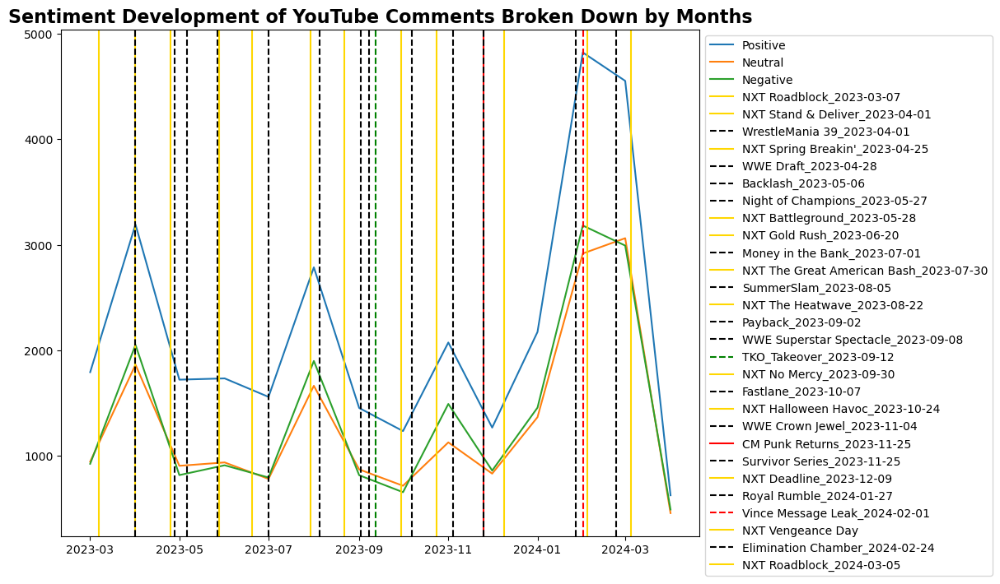

In [119]:
sent_trend=df.groupby(['Date_Month','Sentiment'])['comment'].count().to_frame().reset_index()

plt.figure(figsize=(10,8))
pos_com=sent_trend[sent_trend['Sentiment']=='Positive']
neu_com=sent_trend[sent_trend['Sentiment']=='Neutral']
neg_com=sent_trend[sent_trend['Sentiment']=='Negative']

plt.plot(pos_com['Date_Month'], pos_com['comment'], label='Positive')
plt.plot(neu_com['Date_Month'], neu_com['comment'], label='Neutral')
plt.plot(neg_com['Date_Month'], neg_com['comment'], label='Negative')
plt.axvline(pd.to_datetime('2023-03-07'),c='gold',label='NXT Roadblock_2023-03-07')
plt.axvline(pd.to_datetime('2023-04-01'),c='gold',label='NXT Stand & Deliver_2023-04-01')
plt.axvline(pd.to_datetime('2023-04-01'),ls='--',c='black',label='WrestleMania 39_2023-04-01')
plt.axvline(pd.to_datetime('2023-04-25'),c='gold',label="NXT Spring Breakin'_2023-04-25")
plt.axvline(pd.to_datetime('2023-04-28'),ls='--',c='black',label='WWE Draft_2023-04-28')
plt.axvline(pd.to_datetime('2023-05-06'),ls='--',c='black',label='Backlash_2023-05-06')
plt.axvline(pd.to_datetime('2023-05-27'),ls='--',c='black',label='Night of Champions_2023-05-27')
plt.axvline(pd.to_datetime('2023-05-28'),c='gold',label="NXT Battleground_2023-05-28")
plt.axvline(pd.to_datetime('2023-06-20'),c='gold',label="NXT Gold Rush_2023-06-20")
plt.axvline(pd.to_datetime('2023-07-01'),ls='--',c='black',label='Money in the Bank_2023-07-01')
plt.axvline(pd.to_datetime('2023-07-30'),c='gold',label="NXT The Great American Bash_2023-07-30")
plt.axvline(pd.to_datetime('2023-08-05'),ls='--',c='black',label='SummerSlam_2023-08-05')
plt.axvline(pd.to_datetime('2023-08-22'),c='gold',label="NXT The Heatwave_2023-08-22")
plt.axvline(pd.to_datetime('2023-09-02'),ls='--',c='black',label='Payback_2023-09-02')
plt.axvline(pd.to_datetime('2023-09-08'),ls='--',c='black',label='WWE Superstar Spectacle_2023-09-08')
plt.axvline(pd.to_datetime('2023-09-12'),ls='--',c='green',label='TKO_Takeover_2023-09-12')
plt.axvline(pd.to_datetime('2023-09-30'),c='gold',label="NXT No Mercy_2023-09-30")
plt.axvline(pd.to_datetime('2023-10-07'),ls='--',c='black',label='Fastlane_2023-10-07')
plt.axvline(pd.to_datetime('2023-10-24'),c='gold',label="NXT Halloween Havoc_2023-10-24")
plt.axvline(pd.to_datetime('2023-11-04'),ls='--',c='black',label='WWE Crown Jewel_2023-11-04')
plt.axvline(pd.to_datetime('2023-11-25'),c='red',label='CM Punk Returns_2023-11-25')
plt.axvline(pd.to_datetime('2023-11-25'),ls='--',c='black',label='Survivor Series_2023-11-25')
plt.axvline(pd.to_datetime('2023-12-09'),c='gold',label="NXT Deadline_2023-12-09")
plt.axvline(pd.to_datetime('2024-01-27'),ls='--',c='black',label='Royal Rumble_2024-01-27')
plt.axvline(pd.to_datetime('2024-02-01'),ls='--',c='red',label='Vince Message Leak_2024-02-01')
plt.axvline(pd.to_datetime('2024-02-04'),c='gold',label="NXT Vengeance Day")
plt.axvline(pd.to_datetime('2024-02-24'),ls='--',c='black',label='Elimination Chamber_2024-02-24')
plt.axvline(pd.to_datetime('2024-03-05'),c='gold',label='NXT Roadblock_2024-03-05')
plt.legend(bbox_to_anchor=(1,1))
plt.title('Sentiment Development of YouTube Comments Broken Down by Months',size=16,fontweight='bold')

We can observe the biggest peak in all sentiment categories around 2024-02-01. This was the time when Vince McMahon's text messages were leaked. Other big events that increased the number of comments were the return of CM Punk and the Crown Jewel and Elimination Chamber PPVs.

## Exploratory Analysis Wrestler Counts 

In [15]:
df_count

,Sentiment,Wrestler,Date,Date_Month,Count,Date_Week
0,Positive,Roman Reigns,2024-04-05,2024-04-01,34,2024-04-01
1,Neutral,Roman Reigns,2024-04-05,2024-04-01,34,2024-04-01
2,Negative,Roman Reigns,2024-04-05,2024-04-01,33,2024-04-01
3,Positive,The Rock,2024-04-05,2024-04-01,32,2024-04-01
4,Positive,Cody Rhodes,2024-04-05,2024-04-01,24,2024-04-01
...,...,...,...,...,...,...
119088,Neutral,Sami Zayn,2023-03-05,2023-03-01,1,2023-02-27
119089,Neutral,Roman Reigns,2023-03-05,2023-03-01,1,2023-02-27
119090,Neutral,NaN,2023-03-05,2023-03-01,1,2023-02-27
119091,Neutral,NaN,2023-03-05,2023-03-01,1,2023-02-27


In [16]:
#overall count for positive comments
Wrest_pos_count=df_count[df_count['Sentiment']=='Positive'].groupby(['Wrestler'])['Count'].sum().to_frame().reset_index().sort_values(
    'Count',ascending=False).head(25)

#overall count for neutral comments
Wrest_neu_count=df_count[df_count['Sentiment']=='Neutral'].groupby(['Wrestler'])['Count'].sum().to_frame().reset_index().sort_values(
    'Count',ascending=False).head(25)

#overall count for neutral comments
Wrest_neg_count=df_count[df_count['Sentiment']=='Negative'].groupby(['Wrestler'])['Count'].sum().to_frame().reset_index().sort_values(
    'Count',ascending=False).head(25)

Wrest_pos_count

,Wrestler,Count
498,Roman Reigns,5487
647,WWE,5229
140,Cody Rhodes,4192
596,The Rock,2866
112,CM Punk,2329
347,LA Knight,2059
655,WrestleMania,1812
532,Seth Rollins,1770
641,Vince McMahon,1667
305,John Cena,1450


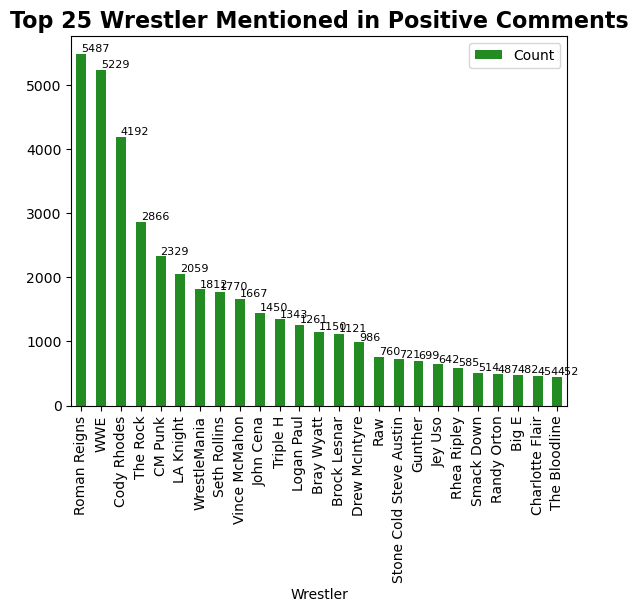

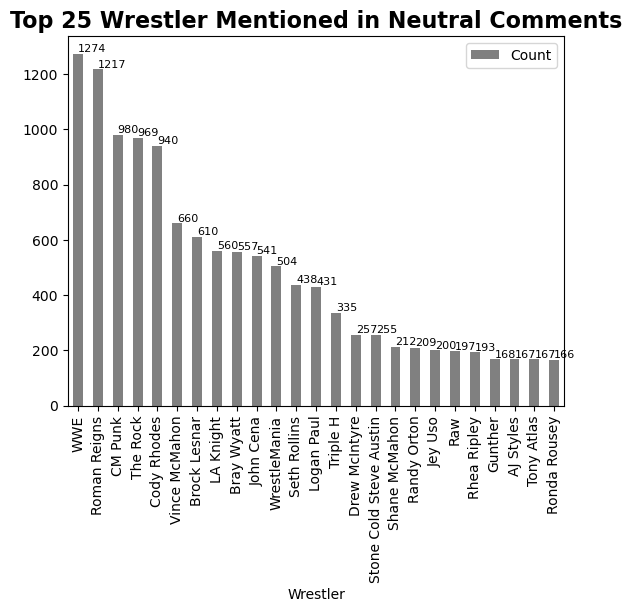

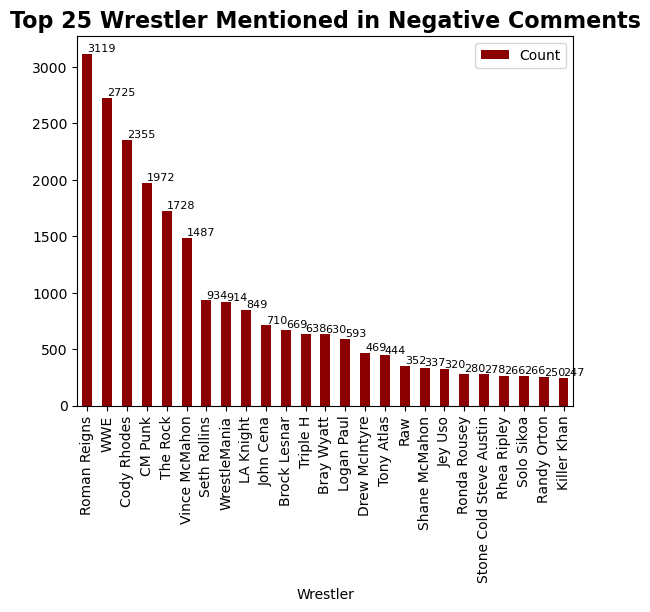

In [17]:
sent_score=['Positive','Neutral','Negative']

def color_bar(sent):
    if x == 'Positive':
        return 'forestgreen'
    elif x == 'Neutral':
        return 'grey'
    else:
        return 'darkred'

for x in sent_score:
    Wrest_sent_count=df_count[df_count['Sentiment']==x].groupby(['Wrestler'])['Count'].sum().to_frame().reset_index().sort_values(
    'Count',ascending=False).set_index('Wrestler').head(25)
    
    ax=Wrest_sent_count.plot(kind='bar',color=color_bar(x)).patches
    for y in ax:
        yval=y.get_height()
        plt.text(y.get_x() + y.get_width()/2.0, yval, round(yval, 2), va='bottom',size=8)
    plt.title('Top 25 Wrestler Mentioned in {} Comments'.format(x),size=16,fontweight='bold')

In [18]:
Wrest_pos_count
Wrest_pos_count

,Wrestler,Count
498,Roman Reigns,5487
647,WWE,5229
140,Cody Rhodes,4192
596,The Rock,2866
112,CM Punk,2329
347,LA Knight,2059
655,WrestleMania,1812
532,Seth Rollins,1770
641,Vince McMahon,1667
305,John Cena,1450


In [19]:
def transform_overall_df(df):
    Wrest_pos_count=df[df['Sentiment']=='Positive'].groupby(['Wrestler'])['Count'].sum().to_frame(
        ).reset_index().sort_values(
        'Count',ascending=False).rename(columns={'Count':'Positive_Count'})

    #overall count for neutral comments
    Wrest_neu_count=df[df['Sentiment']=='Neutral'].groupby(['Wrestler'])['Count'].sum().to_frame(
        ).reset_index().sort_values(
        'Count',ascending=False).rename(columns={'Count':'Neutral_Count'})

    #overall count for neutral comments
    Wrest_neg_count=df[df['Sentiment']=='Negative'].groupby(['Wrestler'])['Count'].sum().to_frame(
        ).reset_index().sort_values(
        'Count',ascending=False).rename(columns={'Count':'Negative_Count'})

    df_sent_count=Wrest_pos_count.merge(Wrest_neu_count,how='left',on='Wrestler')
    df_sent_count=df_sent_count.merge(Wrest_neg_count,how='left',on='Wrestler')

    replace_col=['Positive_Count','Neutral_Count','Negative_Count']
    for na in replace_col:
        df_sent_count[na]=df_sent_count[na].fillna(0)
        df_sent_count[na]=df_sent_count[na].astype(int)

    return df_sent_count

def transformation_month_df(df):
    Wrest_pos_count=df_count[df_count['Sentiment']=='Positive'].groupby(['Wrestler','Date_Month'])['Count'].sum().to_frame(
        ).reset_index().sort_values(
        'Count',ascending=False).rename(columns={'Count':'Positive_Count'})

    #overall count for neutral comments
    Wrest_neu_count=df_count[df_count['Sentiment']=='Neutral'].groupby(['Wrestler','Date_Month'])['Count'].sum().to_frame(
        ).reset_index().sort_values(
        'Count',ascending=False).rename(columns={'Count':'Neutral_Count'})

    #overall count for neutral comments
    Wrest_neg_count=df_count[df_count['Sentiment']=='Negative'].groupby(['Wrestler','Date_Month'])['Count'].sum().to_frame(
        ).reset_index().sort_values(
        'Count',ascending=False).rename(columns={'Count':'Negative_Count'})

    df_sent_month_count=Wrest_pos_count.merge(Wrest_neu_count,how='left',on=['Wrestler','Date_Month'])
    df_sent_month_count=df_sent_month_count.merge(Wrest_neg_count,how='left',on=['Wrestler','Date_Month'])

    replace_col=['Positive_Count','Neutral_Count','Negative_Count']
    for na in replace_col:
        df_sent_month_count[na]=df_sent_month_count[na].fillna(0)
        df_sent_month_count[na]=df_sent_month_count[na].astype(int)

    return df_sent_month_count

def transformation_day_df(df):
    Wrest_pos_count=df_count[df_count['Sentiment']=='Positive'].groupby(['Wrestler','Date'])['Count'].sum().to_frame(
        ).reset_index().sort_values(
        'Count',ascending=False).rename(columns={'Count':'Positive_Count'})

    #overall count for neutral comments
    Wrest_neu_count=df_count[df_count['Sentiment']=='Neutral'].groupby(['Wrestler','Date'])['Count'].sum().to_frame(
        ).reset_index().sort_values(
        'Count',ascending=False).rename(columns={'Count':'Neutral_Count'})

    #overall count for neutral comments
    Wrest_neg_count=df_count[df_count['Sentiment']=='Negative'].groupby(['Wrestler','Date'])['Count'].sum().to_frame(
        ).reset_index().sort_values(
        'Count',ascending=False).rename(columns={'Count':'Negative_Count'})

    df_sent_day_count=Wrest_pos_count.merge(Wrest_neu_count,how='left',on=['Wrestler','Date'])
    df_sent_day_count=df_sent_day_count.merge(Wrest_neg_count,how='left',on=['Wrestler','Date'])

    replace_col=['Positive_Count','Neutral_Count','Negative_Count']
    for na in replace_col:
        df_sent_day_count[na]=df_sent_day_count[na].fillna(0)
        df_sent_day_count[na]=df_sent_day_count[na].astype(int)

    return df_sent_day_count

<Axes: xlabel='Wrestler'>

<Figure size 1200x1000 with 0 Axes>

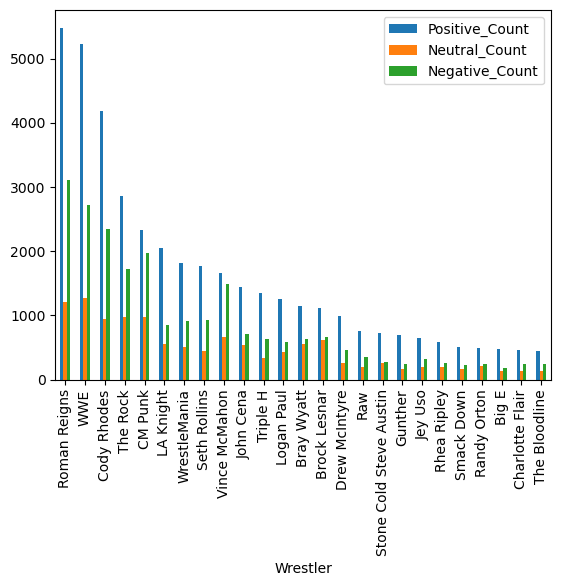

In [20]:
overall_df_count=transform_overall_df(df_count).set_index('Wrestler')
plt.figure(figsize=(12,10))
overall_df_count.head(25).plot(kind='bar')

In [21]:
def comment_break_down_month(df):
    month_df_count=transformation_month_df(df)
    month_df_count['Comment_Sum']=month_df_count['Positive_Count']+month_df_count['Neutral_Count']+month_df_count['Negative_Count']

    plt.figure(figsize=(8,14))
    plt.subplot(5,1,1)
    top_25_overall=list(month_df_count.groupby(['Wrestler'])['Comment_Sum'].sum().sort_values(
        ascending=False).head(25).to_frame().reset_index()['Wrestler'].unique())
    sns.lineplot(x='Date_Month',y='Comment_Sum',hue='Wrestler'
                 ,palette=['black','red','blue','gold','forestgreen','olivedrab','lime','coral','dimgray',
                          'sienna','navy','plum','darkviolet','deepskyblue','darkorange','deeppink',
                          'cadetblue','saddlebrown','teal','lightpink','midnightblue','rosybrown',
                          'green','violet','royalblue'],data=month_df_count[month_df_count['Wrestler'].isin(top_25_overall)])
    plt.legend(bbox_to_anchor=(1,1))
    plt.title('Top 25 Mentioned Wrestlers in a Year',size=12,fontweight='bold')

    plt.subplot(5,1,2)
    top_25_pos=list(month_df_count.groupby(['Wrestler'])['Positive_Count'].sum().sort_values(
        ascending=False).head(25).to_frame().reset_index()['Wrestler'].unique())
    sns.lineplot(x='Date_Month',y='Positive_Count',hue='Wrestler'
                 ,palette=['black','red','blue','gold','forestgreen','olivedrab','lime','coral','dimgray',
                          'sienna','navy','plum','darkviolet','deepskyblue','darkorange','deeppink',
                          'cadetblue','saddlebrown','teal','lightpink','midnightblue','rosybrown',
                          'green','violet','royalblue'],data=month_df_count[month_df_count['Wrestler'].isin(top_25_pos)])
    plt.title('Top 25 Positively Mentioned Wrestlers in a Year',size=12,fontweight='bold')
    plt.legend().remove()

    plt.subplot(5,1,3)
    top_25_neu=list(month_df_count.groupby(['Wrestler'])['Neutral_Count'].sum().sort_values(
        ascending=False).head(25).to_frame().reset_index()['Wrestler'].unique())
    sns.lineplot(x='Date_Month',y='Neutral_Count',hue='Wrestler'
                 ,palette=['black','red','blue','gold','forestgreen','olivedrab','lime','coral','dimgray',
                          'sienna','navy','plum','darkviolet','deepskyblue','darkorange','deeppink',
                          'cadetblue','saddlebrown','teal','lightpink','midnightblue','rosybrown',
                          'green','violet','royalblue'],data=month_df_count[month_df_count['Wrestler'].isin(top_25_pos)])
    plt.title('Top 25 Neutral Mentioned Wrestlers in a Year',size=12,fontweight='bold')
    plt.legend().remove()

    plt.subplot(5,1,4)
    top_25_neg=list(month_df_count.groupby(['Wrestler'])['Negative_Count'].sum().sort_values(
        ascending=False).head(25).to_frame().reset_index()['Wrestler'].unique())
    sns.lineplot(x='Date_Month',y='Negative_Count',hue='Wrestler'
                 ,palette=['black','red','blue','gold','forestgreen','olivedrab','lime','coral','dimgray',
                          'sienna','navy','plum','darkviolet','deepskyblue','darkorange','deeppink',
                          'cadetblue','saddlebrown','teal','lightpink','midnightblue','rosybrown',
                          'green','violet','royalblue'],data=month_df_count[month_df_count['Wrestler'].isin(top_25_pos)])
    plt.title('Top 25 Negative Mentioned Wrestlers in a Year',size=12,fontweight='bold')
    plt.legend().remove()

    plt.subplot(5,1,5)
    name_wrestler=input('Name of the Wrestler (please check for spelling; e.g. The Rock): ')
    top_25pos=month_df_count[month_df_count['Wrestler'].isin(top_25_pos)]
    sns.lineplot(x='Date_Month',y='Positive_Count',hue='Wrestler'
                 ,palette=['forestgreen'],markers=True,data=top_25pos[top_25pos['Wrestler']==name_wrestler])
    top_25neu=month_df_count[month_df_count['Wrestler'].isin(top_25_neu)]
    sns.lineplot(x='Date_Month',y='Neutral_Count',hue='Wrestler'
                 ,palette=['gray'],markers=True,data=top_25neu[top_25neu['Wrestler']==name_wrestler])
    top_25neg=month_df_count[month_df_count['Wrestler'].isin(top_25_neg)]
    sns.lineplot(x='Date_Month',y='Negative_Count',hue='Wrestler'
                 ,palette=['red'],markers=True,data=top_25neg[top_25neg['Wrestler']==name_wrestler])
    plt.legend(bbox_to_anchor=(1,1))
    plt.title('Number of Overall, Positive, Neutral and Negative Comments for {} over a Year'.format(
        name_wrestler),size=12,fontweight='bold')

    #allows us to adjust the space between the different graphs
    plt.subplots_adjust(hspace=0.5)

Name of the Wrestler (please check for spelling; e.g. The Rock): AJ Styles


C:\Users\gandj\AppData\Local\Temp\ipykernel_18896\1591104368.py:53: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.lineplot(x='Date_Month',y='Positive_Count',hue='Wrestler'
C:\Users\gandj\AppData\Local\Temp\ipykernel_18896\1591104368.py:59: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.lineplot(x='Date_Month',y='Negative_Count',hue='Wrestler'


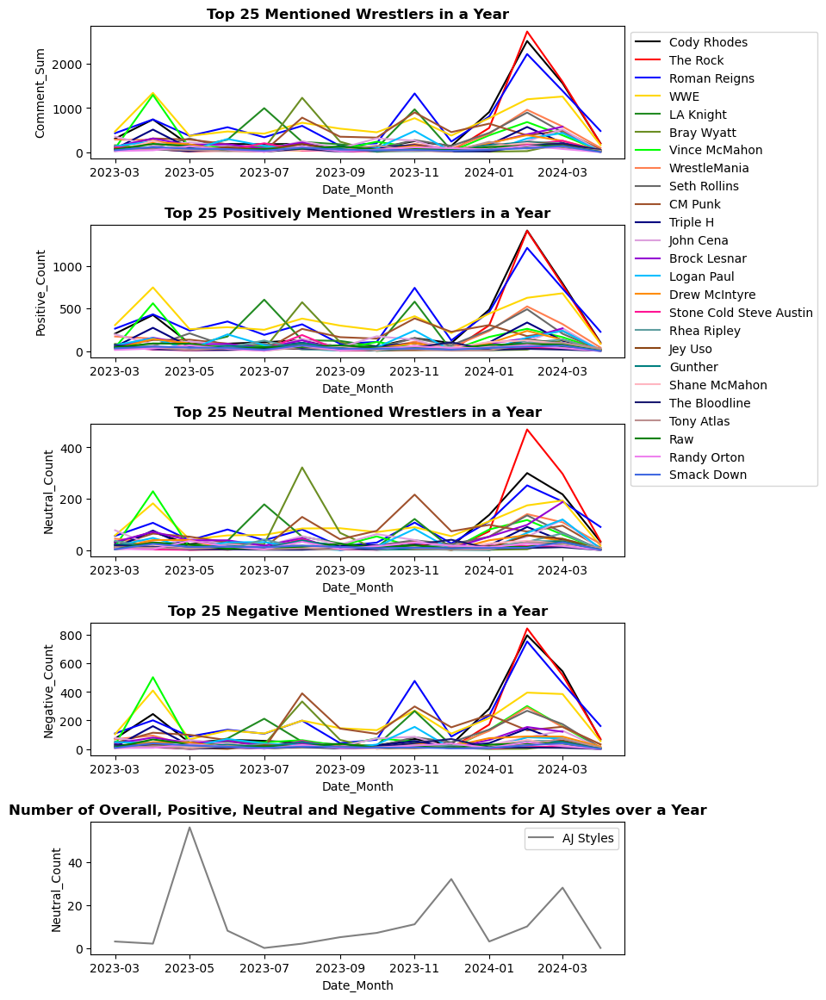

In [22]:
comment_break_down_month(df_count)

In [23]:
def comment_break_down_day(df):
    month_df_count=transformation_day_df(df)
    month_df_count['Comment_Sum']=month_df_count['Positive_Count']+month_df_count['Neutral_Count']+month_df_count['Negative_Count']

    plt.figure(figsize=(8,14))
    plt.subplot(5,1,1)
    top_25_overall=list(month_df_count.groupby(['Wrestler'])['Comment_Sum'].sum().sort_values(
        ascending=False).head(25).to_frame().reset_index()['Wrestler'].unique())
    sns.lineplot(x='Date',y='Comment_Sum',hue='Wrestler'
                 ,palette=['black','red','blue','gold','forestgreen','olivedrab','lime','coral','dimgray',
                          'sienna','navy','plum','darkviolet','deepskyblue','darkorange','deeppink',
                          'cadetblue','saddlebrown','teal','lightpink','midnightblue','rosybrown',
                          'green','violet','royalblue'],data=month_df_count[month_df_count['Wrestler'].isin(top_25_overall)])
    plt.legend(bbox_to_anchor=(1,1))
    plt.title('Top 25 Mentioned Wrestlers in a Year',size=12,fontweight='bold')

    plt.subplot(5,1,2)
    top_25_pos=list(month_df_count.groupby(['Wrestler'])['Positive_Count'].sum().sort_values(
        ascending=False).head(25).to_frame().reset_index()['Wrestler'].unique())
    sns.lineplot(x='Date',y='Positive_Count',hue='Wrestler'
                 ,palette=['black','red','blue','gold','forestgreen','olivedrab','lime','coral','dimgray',
                          'sienna','navy','plum','darkviolet','deepskyblue','darkorange','deeppink',
                          'cadetblue','saddlebrown','teal','lightpink','midnightblue','rosybrown',
                          'green','violet','royalblue'],data=month_df_count[month_df_count['Wrestler'].isin(top_25_pos)])
    plt.title('Top 25 Positively Mentioned Wrestlers in a Year',size=12,fontweight='bold')
    plt.legend().remove()

    plt.subplot(5,1,3)
    top_25_neu=list(month_df_count.groupby(['Wrestler'])['Neutral_Count'].sum().sort_values(
        ascending=False).head(25).to_frame().reset_index()['Wrestler'].unique())
    sns.lineplot(x='Date',y='Neutral_Count',hue='Wrestler'
                 ,palette=['black','red','blue','gold','forestgreen','olivedrab','lime','coral','dimgray',
                          'sienna','navy','plum','darkviolet','deepskyblue','darkorange','deeppink',
                          'cadetblue','saddlebrown','teal','lightpink','midnightblue','rosybrown',
                          'green','violet','royalblue'],data=month_df_count[month_df_count['Wrestler'].isin(top_25_pos)])
    plt.title('Top 25 Neutral Mentioned Wrestlers in a Year',size=12,fontweight='bold')
    plt.legend().remove()

    plt.subplot(5,1,4)
    top_25_neg=list(month_df_count.groupby(['Wrestler'])['Negative_Count'].sum().sort_values(
        ascending=False).head(25).to_frame().reset_index()['Wrestler'].unique())
    sns.lineplot(x='Date',y='Negative_Count',hue='Wrestler'
                 ,palette=['black','red','blue','gold','forestgreen','olivedrab','lime','coral','dimgray',
                          'sienna','navy','plum','darkviolet','deepskyblue','darkorange','deeppink',
                          'cadetblue','saddlebrown','teal','lightpink','midnightblue','rosybrown',
                          'green','violet','royalblue'],data=month_df_count[month_df_count['Wrestler'].isin(top_25_pos)])
    plt.title('Top 25 Negative Mentioned Wrestlers in a Year',size=12,fontweight='bold')
    plt.legend().remove()

    plt.subplot(5,1,5)
    name_wrestler=input('Name of the Wrestler (please check for spelling; e.g. The Rock): ')
    top_25pos=month_df_count[month_df_count['Wrestler'].isin(top_25_pos)]
    sns.lineplot(x='Date',y='Positive_Count',hue='Wrestler'
                 ,palette=['forestgreen'],markers=True,data=top_25pos[top_25pos['Wrestler']==name_wrestler])
    top_25neu=month_df_count[month_df_count['Wrestler'].isin(top_25_neu)]
    sns.lineplot(x='Date',y='Neutral_Count',hue='Wrestler'
                 ,palette=['gray'],markers=True,data=top_25neu[top_25neu['Wrestler']==name_wrestler])
    top_25neg=month_df_count[month_df_count['Wrestler'].isin(top_25_neg)]
    sns.lineplot(x='Date',y='Negative_Count',hue='Wrestler'
                 ,palette=['red'],markers=True,data=top_25neg[top_25neg['Wrestler']==name_wrestler])
    plt.legend(bbox_to_anchor=(1,1))
    plt.title('Number of Overall, Positive, Neutral and Negative Comments for {} over a Year'.format(
        name_wrestler),size=12,fontweight='bold')

    #allows us to adjust the space between the different graphs
    plt.subplots_adjust(hspace=0.5)

Name of the Wrestler (please check for spelling; e.g. The Rock): AJ Styles


C:\Users\gandj\AppData\Local\Temp\ipykernel_18896\1125804459.py:53: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.lineplot(x='Date',y='Positive_Count',hue='Wrestler'
C:\Users\gandj\AppData\Local\Temp\ipykernel_18896\1125804459.py:59: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.lineplot(x='Date',y='Negative_Count',hue='Wrestler'


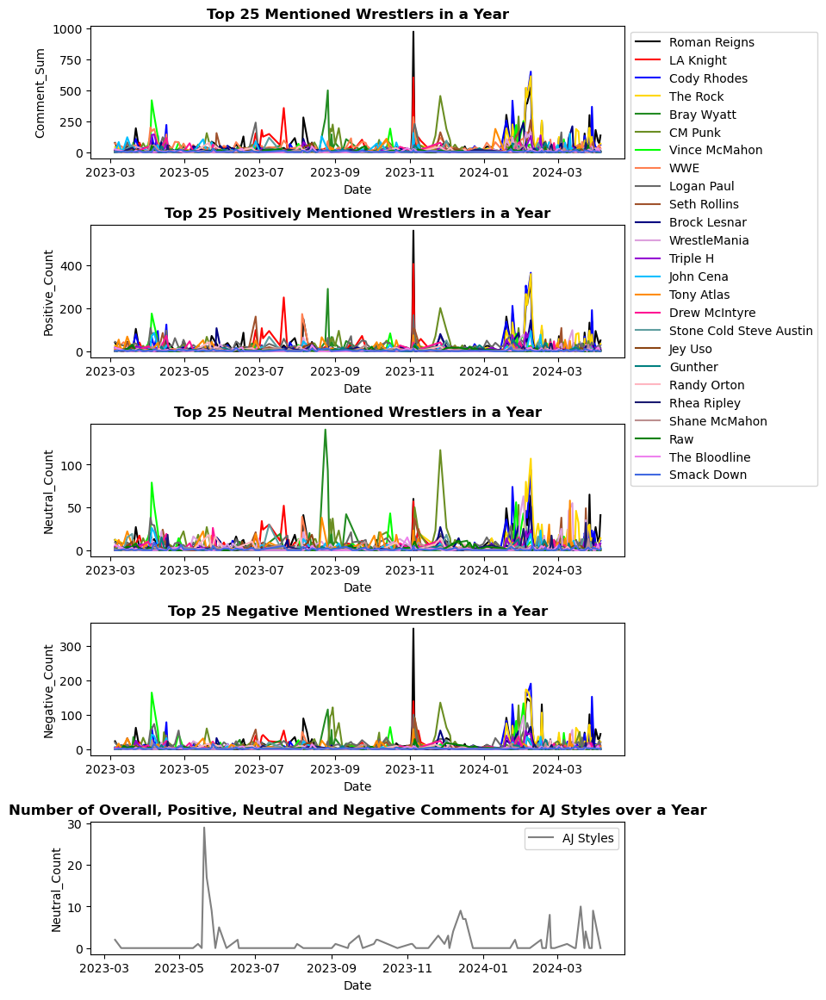

In [24]:
comment_break_down_day(df_count)

## Creating a data frame with the match results

The next thing we need to know is the type of match and the bouts. From here we will add information about whether it was a title match and the dates.

In [25]:
data=requests.get('http://www.profightdb.com/cards/wwe-cards-pg1-no-2.html?order=&type=').text
soup=BeautifulSoup(data,'html.parser')
table=soup.find('div', class_='table-wrapper')
links=[]
if table:
    link_ele=table.find_all('a',href=re.compile(r'^/cards/wwe/'))
    for x in link_ele:
        links.append(x['href'])

In [32]:
links

['/cards/wwe/monday-night-raw-52687.html',
 '/cards/wwe/main-event-taping-52686.html',
 '/cards/wwe/speed-4-taping-52685.html',
 '/cards/wwe/speed-3-taping-52664.html',
 '/cards/wwe/friday-night-smackdown-52655.html',
 '/cards/wwe/monday-night-raw-52634.html',
 '/cards/wwe/main-event-taping-52633.html',
 '/cards/wwe/wrestlemania-xl---night-2-52628.html',
 '/cards/wwe/wrestlemania-xl---night-1-52613.html',
 '/cards/wwe/speed-2-taping-52603.html']

In [ ]:
test=pd.read_html('http://www.profightdb.com/cards/wwe/friday-night-smackdown---wrestlemania-smackdown-52602.html')[1]
test.drop(columns=['no.','rating'],inplace=True)
test

In [ ]:
len(test['match'].iloc[2])

In [ ]:
#adjsuting the match type
def match_type(row):
    match = row['match']
    match_2 = row['match.2']
    
    #how to lookup if a value is in a PandasSeries included
    if '&' in match:
        return 'Tag Team'
    elif '&' in match_2:
        return '6 Tag Team'
    elif ',' in match_2 and len(match_2.split(',')) == 2:
        return 'Triple Threat'
    elif ',' in match_2 and 2 < len(match_2.split(',')) <= 4:
        return 'Fatal Fourway'
    elif ',' in match_2 and 4 < len(match_2.split(',')) <=26:
        return 'Battle Royal/Andre The Giant Memorial'
    elif ',' in match_2 and len(match_2.split(',')) ==30:
        return 'Battle Royal/Andre The Giant Memorial Battle Royal'
    else:
        return 'Single Match'

#getting the match duration in seconds
def match_duration(row):
    if pd.isna(row['duration']):
        return np.nan
    else:
        return int(row['duration'].split(':')[0])*60 + int(row['duration'].split(':')[1])

#getting the championship status
def champion_status(title):
    if '(title change)' in title:
        return 'new champion'
    elif '(2016)' in title:
        steps=title.split('(')
        if len(steps) >2:
            step=steps[2]
            if 'title change)' in step:
                return 'new champion'
            else:
                return 'still champion'
        else:
            return 'still champion'
    elif 'No Title Match' in title:
        return 'No Title Match'
    else:
        return 'still champion'

In [ ]:
#this for-loop will get us all the match cards that took place in 
wp_link=[]
for x in range(1,31):
    data=requests.get('http://www.profightdb.com/cards/wwe-cards-pg{}-no-2.html?order=&type='.format(x)).text
    soup=BeautifulSoup(data,'html.parser')
    table=soup.find('div', class_='table-wrapper')
    if table:
        link_ele=table.find_all('a',href=re.compile(r'^/cards/wwe/'))
        for x in link_ele:
            wp_link.append(x['href'])
wp_links=wp_link[6:]

match_card1=pd.read_html(
'http://www.profightdb.com/cards/wwe/friday-night-smackdown---wrestlemania-smackdown-52602.html')[1]
match_card1['match type']=match_card1.apply(match_type,axis=1)
match_card1['match duration_sec']=match_card1.apply(match_duration,axis=1)
match_card1['rating']=match_card1['rating'].fillna('-')
match_card1['title(s)']=match_card1['title(s)'].fillna('No Title Match')
match_card1.drop(columns=['no.','duration'],inplace=True)
match_card1['match.1'].replace({'def.':'victory','def. (pin)':'pinfall',
                               'def. (sub)':'submission','def. (DQ)':'DQ'},inplace=True)
match_card1.rename(columns={'match':'winner','match.1':'win_through','match.2':'loser'},inplace=True)
match_card1['winner'].replace({'A.J. Styles': 'AJ Styles'}, inplace=True)
match_card1['loser'].replace({'A.J. Styles': 'AJ Styles'}, inplace=True)
date=pd.read_html(
    'http://www.profightdb.com/cards/wwe/friday-night-smackdown---wrestlemania-smackdown-52602.html'
    )[0].iloc[0,0].split(',')[1]
match_card1['card_date']=pd.to_datetime(date)
match_card1['card_date_month']=pd.to_datetime(date).to_period('M').to_timestamp()
df_match_card=match_card1

for x in wp_links:
    match_card=pd.read_html(
    'http://www.profightdb.com{}'.format(x))[1]
    match_card['match type']=match_card.apply(match_type,axis=1)
    match_card['match duration_sec']=match_card.apply(match_duration,axis=1)
    match_card['rating']=match_card['rating'].fillna('-')
    match_card['title(s)']=match_card['title(s)'].fillna('No Title Match')
    match_card.drop(columns=['no.','duration'],inplace=True)
    match_card['match.1'].replace({'def.':'victory','def. (pin)':'pinfall',
                                   'def. (sub)':'submission','def. (DQ)':'DQ'},inplace=True)
    match_card.rename(columns={'match':'winner','match.1':'win_through','match.2':'loser'},inplace=True)
    match_card['winner'].replace({'A.J. Styles': 'AJ Styles'}, inplace=True)
    match_card['loser'].replace({'A.J. Styles': 'AJ Styles'}, inplace=True)
    date=pd.read_html('http://www.profightdb.com{}'.format(x))[0].iloc[0,0].split(',')[1]
    match_card['card_date']=pd.to_datetime(date)
    match_card['card_date_month']=pd.to_datetime(date).to_period('M').to_timestamp()
    df_match_card=pd.concat([df_match_card,match_card])

df_match_card

In [76]:
#df_match_card.to_csv('match_card.csv')
df_match_card=pd.read_csv(r"C:\Users\gandj\OneDrive\Desktop\Case_Study\WWE\match_card.csv").iloc[:,1:]
df_match_card

,winner,win_through,loser,match type,title(s),rating,match duration_sec,card_date,card_date_month,champion_status
0,Bronson Reed,victory,"Akira Tozawa, Angel, Apollo Crews, Ashante ""Th...",Battle Royal/Andre The Giant Memorial,No Title Match,-,609,2024-04-05,2024-04-01,No Title Match
1,Elektra Lopez,pinfall,Zelina Vega,Single Match,No Title Match,-,158,2024-04-05,2024-04-01,No Title Match
2,Pete Dunne & Tyler Bate,pinfall,Austin Theory & Grayson Waller,Tag Team,No Title Match,-,447,2024-04-05,2024-04-01,No Title Match
3,Jey Uso,DQ,Solo Sikoa,Single Match,No Title Match,-,394,2024-04-05,2024-04-01,No Title Match
4,Chelsea Green,pinfall,Natalya,Single Match,No Title Match,-,307,2024-04-01,2024-04-01,No Title Match
...,...,...,...,...,...,...,...,...,...,...
1724,Roman Reigns (c),victory,Sami Zayn,Single Match,WWE Undisputed Universal Title,-,2163,2023-03-04,2023-03-01,still champion
1725,Rhea Ripley,submission,Liv Morgan,Single Match,No Title Match,-,484,2023-03-03,2023-03-01,No Title Match
1726,Dominik Mysterio,pinfall,Santos Escobar,Single Match,No Title Match,-,515,2023-03-03,2023-03-01,No Title Match
1727,Shayna Baszler,submission,Tegan Nox,Single Match,No Title Match,-,121,2023-03-03,2023-03-01,No Title Match


In [77]:
#as we can see we have null values, lets see how we can replace these null values
df_match_card.isnull().sum()

winner                0
win_through           0
loser                 0
match type            0
title(s)              0
rating                0
match duration_sec    0
card_date             0
card_date_month       0
champion_status       0
dtype: int64

In [78]:
titles=list(df_match_card[df_match_card['match duration_sec'].isna()]['title(s)'].unique())
titles

[]

In [79]:
from statistics import mode
#when we can not use the mode for the particular title match, we use the overall mode
stand_dur_val = round(df_match_card['match duration_sec'].describe().iloc[4])
for title in titles:
    title_filter = df_match_card['title(s)'] == title
    if title_filter.any():  # Check if any value is True
        mode_val = None #we assume before the loop is executed model_val is equal to None, so we can check if it is after
        ##the loop still None
        filtered_data = df_match_card[(title_filter) & (~pd.isna(df_match_card['match duration_sec']))]
        if not filtered_data.empty:  # Check if the filtered DataFrame is not empty
            mode_val = round(filtered_data['match duration_sec'].agg(mode))
        if mode_val is not None: #Check if model_val is still None
            df_match_card.loc[title_filter, 'match duration_sec'] = df_match_card.loc[
                title_filter, 'match duration_sec'].fillna(mode_val)
        else: #else we fill the NaN values with the overall mode when we were able to generate any
            df_match_card.loc[title_filter, 'match duration_sec'] = stand_dur_val
    else: #the same here
        df_match_card.loc[title_filter, 'match duration_sec'] = stand_dur_val

In [80]:
df_match_card.isnull().sum()

winner                0
win_through           0
loser                 0
match type            0
title(s)              0
rating                0
match duration_sec    0
card_date             0
card_date_month       0
champion_status       0
dtype: int64

In [81]:
#here I had to make an addtional cleaning attempt to fix the data type and string values
df_match_card['match duration_sec']=df_match_card['match duration_sec'].astype(int)
df_match_card['winner'].replace({'A.J. Styles':'AJ Styles'},inplace=True)
df_match_card['loser'].replace({'A.J. Styles':'AJ Styles'},inplace=True)
df_match_card

,winner,win_through,loser,match type,title(s),rating,match duration_sec,card_date,card_date_month,champion_status
0,Bronson Reed,victory,"Akira Tozawa, Angel, Apollo Crews, Ashante ""Th...",Battle Royal/Andre The Giant Memorial,No Title Match,-,609,2024-04-05,2024-04-01,No Title Match
1,Elektra Lopez,pinfall,Zelina Vega,Single Match,No Title Match,-,158,2024-04-05,2024-04-01,No Title Match
2,Pete Dunne & Tyler Bate,pinfall,Austin Theory & Grayson Waller,Tag Team,No Title Match,-,447,2024-04-05,2024-04-01,No Title Match
3,Jey Uso,DQ,Solo Sikoa,Single Match,No Title Match,-,394,2024-04-05,2024-04-01,No Title Match
4,Chelsea Green,pinfall,Natalya,Single Match,No Title Match,-,307,2024-04-01,2024-04-01,No Title Match
...,...,...,...,...,...,...,...,...,...,...
1724,Roman Reigns (c),victory,Sami Zayn,Single Match,WWE Undisputed Universal Title,-,2163,2023-03-04,2023-03-01,still champion
1725,Rhea Ripley,submission,Liv Morgan,Single Match,No Title Match,-,484,2023-03-03,2023-03-01,No Title Match
1726,Dominik Mysterio,pinfall,Santos Escobar,Single Match,No Title Match,-,515,2023-03-03,2023-03-01,No Title Match
1727,Shayna Baszler,submission,Tegan Nox,Single Match,No Title Match,-,121,2023-03-03,2023-03-01,No Title Match


In [82]:
#here we filter all values from the "loser" where a "(c)" was included 
df_match_card[df_match_card['loser'].str.endswith('(c)')].head(5)

,winner,win_through,loser,match type,title(s),rating,match duration_sec,card_date,card_date_month,champion_status
252,Asuka & Kairi Sane,pinfall,Katana Chance (c) & Kayden Carter (c),Tag Team,WWE Womens Tag Team Championship (title change),-,543,2024-01-26,2024-01-01,new champion
302,Shotzi,DQ,Iyo Sky (c),Single Match,WWE Women's Championship (2016),-,620,2024-01-14,2024-01-01,still champion
333,Shotzi,DQ,Iyo Sky (c),Single Match,WWE Women's Championship (2016),-,620,2024-01-07,2024-01-01,still champion
396,Shotzi,DQ,Iyo Sky (c),Single Match,WWE Women's Championship (2016),-,620,2023-12-28,2023-12-01,still champion
444,Katana Chance & Kayden Carter,pinfall,Chelsea Green (c) & Piper Niven (c),Tag Team,WWE Womens Tag Team Championship (title change),-,576,2023-12-18,2023-12-01,new champion


In [83]:
df_match_card['title(s)'].unique()

array(['No Title Match', 'WWE Intercontinental Championship',
       'WWE Raw Tag Team Championship WWE Smackdown Womens Championship',
       "WWE Women's World Title",
       'WWE Raw Tag Team Championship WWE Smackdown Tag Team Championship',
       'WWE Womens Tag Team Championship',
       'WWE Championship WWE Universal Championship',
       'WWE United States Championship',
       'WWE Womens Tag Team Championship (title change)',
       'WWE World Heavyweight Championship',
       "WWE Women's Championship (2016)",
       'NXT North American Championship',
       'WWE United States Championship (title change)',
       "NXT Women's Title",
       'WWE Raw Tag Team Championship WWE Smackdown Tag Team Championship (title change)',
       "WWE Women's Championship (2016) (title change)",
       'WWE Undisputed Universal Title',
       "NXT Women's Tag Team Titles WWE Womens Tag Team Championship (title change)",
       "WWE Smackdown Women's Title",
       'WWE World Heavyweight Ch

In [84]:
#here we apply the def function champion_status to create the the values still champion, new champion or no title match
df_match_card['champion_status']=df_match_card['title(s)'].apply(champion_status)
df_match_card.head()

NameError: name 'champion_status' is not defined

Let's put that all in one def function to make it easier to get a Data Frame.

In [85]:
#for PowerBI
def mach_card_df(max_pages):
    import pandas as pd
    import numpy as np
    import sys as sys
    import matplotlib.pyplot as plt
    import seaborn as sns
    from bs4 import BeautifulSoup
    from bs4 import Comment
    import requests
    import re
    from statistics import mode
    
    def match_type(row):
        match = row['match']
        match_2 = row['match.2']
        match_type=row['match type']
        
        #adding the correct match types
        if '&' in match and len(match.split('&')) ==2:
            return 'Tag Team'
        elif '&' in match and len(match.split('&')) ==3:
            return '6 Tag Team'
        elif '&' in match_2 and len(match.split('&'))==4:
            return '3 Way Tag Team'
        elif ',' in match_2 and len(match_2.split(',')) == 2:
            return 'Triple Threat'
        elif ',' in match_2 and len(match_2.split(',')) ==3:
            return 'Fatal Fourway'
        elif ',' in match_2 and len(match_2.split(',')) ==5:
            return 'Elimination Chamber/Gauntlet Match'
        elif ',' in match_2 and len(match_2.split(',')) <= 8:
            return 'Money in the Bank'
        elif ',' in match_2 and len(match_2.split(',')) <=26:
            return 'Battle Royal/Andre The Giant Memorial'
        elif ',' in match_2 and len(match_2.split(',')) ==29:
            return 'Royal Rumble'
        else:
            return 'Single Match'

    #getting the match duration in seconds
    def match_duration(row):
        if pd.isna(row['duration']):
            return np.nan
        else:
            return int(row['duration'].split(':')[0])*60 + int(row['duration'].split(':')[1])

    #getting the championship status
    def champion_status(title):
        if '(title change)' in title:
            return 'new champion'
        elif '(2016)' in title:
            steps=title.split('(')
            if len(steps) >2:
                step=steps[2]
                if 'title change)' in step:
                    return 'new champion'
                else:
                    return 'still champion'
            else:
                return 'still champion'
        elif 'No Title Match' in title:
            return 'No Title Match'
        else:
            return 'still champion'
        
    def champ(row):
        title=row['title(s)']
        wrestler=row['winner']
        other_wrestler=row['loser']
        champ_status=row['champion_status']
        if 'No Title Match' in title:
            return 'No Champion'
        else:
            if '(c)' in wrestler and champ_status =='still champion':
                return wrestler.split('(')[0]
            elif '(c)' in other_wrestler and champ_status =='new champion':
                return wrestler.split('(')[0]
            else:
                return other_wrestler.split('(')[0]
    
    #this for-loop will get us all the match cards that took place in
    num=max_pages
    num=int(num)
    wp_links=[]
    for x in range(1,num):
        data=requests.get('http://www.profightdb.com/cards/wwe-cards-pg{}-no-2.html?order=&type='.format(x)).text
        soup=BeautifulSoup(data,'html.parser')
        table=soup.find('div', class_='table-wrapper')
        if table:
            link_ele=table.find_all('a',href=re.compile(r'^/cards/wwe/'))
            for x in link_ele:
                wp_links.append(x['href'])
    #wp_links=wp_link[6:]

    match_card1=pd.read_html(
    'http://www.profightdb.com/cards/wwe/friday-night-smackdown---wrestlemania-smackdown-52602.html')[1]
    match_card1['match type']=match_card1.apply(match_type,axis=1)
    match_card1['match duration_sec']=match_card1.apply(match_duration,axis=1)
    match_card1['rating']=match_card1['rating'].fillna('-')
    match_card1['title(s)']=match_card1['title(s)'].fillna('No Title Match')
    match_card1.drop(columns=['no.','duration'],inplace=True)
    match_card1['match.1'].replace({'def.':'victory','def. (pin)':'pinfall',
                                   'def. (sub)':'submission','def. (DQ)':'DQ'},inplace=True)
    match_card1.rename(columns={'match':'winner','match.1':'win_through','match.2':'loser'},inplace=True)
    match_card1['winner'].replace({'A.J. Styles': 'AJ Styles'}, inplace=True)
    match_card1['loser'].replace({'A.J. Styles': 'AJ Styles'}, inplace=True)
    date=pd.read_html(
        'http://www.profightdb.com/cards/wwe/friday-night-smackdown---wrestlemania-smackdown-52602.html'
        )[0].iloc[0,0].split(',')[1]
    match_card1['card_date']=pd.to_datetime(date)
    match_card1['card_date_month']=pd.to_datetime(date).to_period('M').to_timestamp()
    df_match_card=match_card1

    for x in wp_links:
        match_card=pd.read_html(
        'http://www.profightdb.com{}'.format(x))[1]
        match_card['match type']=match_card.apply(match_type,axis=1)
        match_card['match duration_sec']=match_card.apply(match_duration,axis=1)
        match_card['rating']=match_card['rating'].fillna('-')
        match_card['title(s)']=match_card['title(s)'].fillna('No Title Match')
        match_card.drop(columns=['no.','duration'],inplace=True)
        match_card['match.1'].replace({'def.':'victory','def. (pin)':'pinfall',
                                       'def. (sub)':'submission','def. (DQ)':'DQ'},inplace=True)
        match_card.rename(columns={'match':'winner','match.1':'win_through','match.2':'loser'},inplace=True)
        match_card['winner'].replace({'A.J. Styles': 'AJ Styles'}, inplace=True)
        match_card['loser'].replace({'A.J. Styles': 'AJ Styles'}, inplace=True)
        date=pd.read_html('http://www.profightdb.com{}'.format(x))[0].iloc[0,0].split(',')[1]
        match_card['card_date']=pd.to_datetime(date)
        match_card['card_date_month']=pd.to_datetime(date).to_period('M').to_timestamp()
        df_match_card=pd.concat([df_match_card,match_card])
    
    #when we can not use the mode for the particular title match, we use the overall mode
    stand_dur_val = round(df_match_card['match duration_sec'].describe().iloc[4])
    titles=list(df_match_card['title(s)'].unique())
    for title in titles:
        title_filter = df_match_card['title(s)'] == title
        if title_filter.any():  # Check if any value is True
            mode_val = None #we assume before the loop is executed model_val is equal to None, so we can check if it is after
            ##the loop still None
            filtered_data = df_match_card[(title_filter) & (~pd.isna(df_match_card['match duration_sec']))]
            if not filtered_data.empty:  # Check if the filtered DataFrame is not empty
                mode_val = round(filtered_data['match duration_sec'].agg(mode))
            if mode_val is not None: #Check if model_val is still None
                df_match_card.loc[title_filter, 'match duration_sec'] = df_match_card.loc[
                    title_filter, 'match duration_sec'].fillna(mode_val)
            else: #else we fill the NaN values with the overall mode when we were able to generate any
                df_match_card.loc[title_filter, 'match duration_sec'] = stand_dur_val
        else: #the same here
            df_match_card.loc[title_filter, 'match duration_sec'] = stand_dur_val
    df_match_card['match duration_sec']=df_match_card['match duration_sec'].astype(int)
    df_match_card['champion_status'] = df_match_card['title(s)'].apply(champion_status)
    df_match_card['champion']=df_match_card.apply(champ,axis=1)
    df_match_card['card_date_week']=df_match_card['card_date'].apply(lambda x:pd.to_datetime(x).to_period('W').to_timestamp())
    return df_match_card

df_match_card=mach_card_df(input('Please enter the number of the last page number: '))

KeyboardInterrupt: Interrupted by user

In [154]:
#for Python
def mach_card_df(max_pages):
    import pandas as pd
    import numpy as np
    import sys as sys
    import matplotlib.pyplot as plt
    import seaborn as sns
    from bs4 import BeautifulSoup
    from bs4 import Comment
    import requests
    import re
    from statistics import mode
    
    def match_type(row):
        match = row['match']
        match_2 = row['match.2']
        match_type=row['match type']
        
        #adding the correct match types
        if '&' in match and len(match.split('&')) ==2:
            return 'Tag Team'
        elif '&' in match and len(match.split('&')) ==3:
            return '6 Tag Team'
        elif '&' in match_2 and len(match.split('&'))==4:
            return '3 Way Tag Team'
        elif ',' in match_2 and len(match_2.split(',')) == 2:
            return 'Triple Threat'
        elif ',' in match_2 and len(match_2.split(',')) ==3:
            return 'Fatal Fourway'
        elif ',' in match_2 and len(match_2.split(',')) ==5:
            return 'Elimination Chamber/Gauntlet Match'
        elif ',' in match_2 and len(match_2.split(',')) <= 8:
            return 'Money in the Bank'
        elif ',' in match_2 and len(match_2.split(',')) <=26:
            return 'Battle Royal/Andre The Giant Memorial'
        elif ',' in match_2 and len(match_2.split(',')) ==29:
            return 'Royal Rumble'
        else:
            return 'Single Match'

    #getting the match duration in seconds
    def match_duration(row):
        if pd.isna(row['duration']):
            return np.nan
        else:
            return int(row['duration'].split(':')[0])*60 + int(row['duration'].split(':')[1])

    #getting the championship status
    def champion_status(title):
        if '(title change)' in title:
            return 'new champion'
        elif '(2016)' in title:
            steps=title.split('(')
            if len(steps) >2:
                step=steps[2]
                if 'title change)' in step:
                    return 'new champion'
                else:
                    return 'still champion'
            else:
                return 'still champion'
        elif 'No Title Match' in title:
            return 'No Title Match'
        else:
            return 'still champion'
        
    def champ(row):
        title=row['title(s)']
        wrestler=row['winner']
        other_wrestler=row['loser']
        champ_status=row['champion_status']
        win=row['win_through']
        if 'No Title Match' in title:
            return 'No Champion'
        else:
            if champ_status =='still champion' or win=='DQ':
                return wrestler
            elif champ_status =='new champion':
                return wrestler
            else:
                return other_wrestler
            
    def name_clean_winner(row):
        wrestler=row['winner']
        if '(c)' in wrestler:
            wrestler_parts=wrestler.split('(')
            if len(wrestler_parts) <= 2:
                return wrestler.split('(')[0].split('\xa0')[0]
            else:
                wrst=[]
                wrst.append(wrestler.split("(")[0].split('\xa0')[0])
                wrst.append(wrestler.split('(')[1].split('&')[1].split('\xa0')[0])
                return wrst
        elif '(c)' not in wrestler and '&' not in wrestler and len(wrestler)<=250:
            return wrestler
        else:
            if '&' in wrestler:
                tag_parts=wrestler.split('&')
                if len(tag_parts) <3:
                    tag_team_win=[]
                    tag_team_win.append(tag_parts[0].strip())
                    tag_team_win.append(tag_parts[1].strip())
                    return tag_team_win
                else:
                    tag_team_win=[]
                    for x in range(0,len(tag_parts)):
                        tag_team_win.append(tag_parts[x].strip())
                    return tag_team_win
            else:
                tag_parts=wrestler.split('&')
                tag_team_win=[]
                for x in range(0,len(tag_parts)):
                    tag_team_win.append(tag_parts[x].strip())
                return tag_team_win
    
    #this def function includes other 
    def name_clean_loser(row):
        other_wrestler=row['loser']
        if '(c)' in other_wrestler:
            other_wrestler_parts=other_wrestler.split('(')
            if len(other_wrestler_parts) <= 2:
                return other_wrestler.split('(')[0].split('\xa0')[0]
            else:
                wrst_other=[]
                wrst_other.append(other_wrestler.split("(")[0].split('\xa0')[0])
                wrst_other.append(other_wrestler.split('(')[1].split('&')[1].split('\xa0')[0])
                return wrst_other
        elif '(c)' not in other_wrestler and '&' not in other_wrestler and len(other_wrestler)<=250:
            return other_wrestler
        else:
            if '&' in other_wrestler:
                tag_parts=other_wrestler.split('&')
                if len(tag_parts) <3:
                    tag_team_loss=[]
                    tag_team_loss.append(tag_parts[0].strip())
                    tag_team_loss.append(tag_parts[1].strip())
                    return tag_team_loss
                else:
                    tag_team_loss_6=[]
                    for x in range(0,len(tag_parts)):
                        tag_team_loss_6.append(tag_parts[x].strip())
                    return tag_team_loss_6
            elif ',' in other_wrestler:
                new_wrest=[]
                wrest=other_wrestler.split(',')
                for w in wrest:
                    w=w.strip()
                    new_wrest.append(w)
                return new_wrest
            else:
                tag_parts=other_wrestler.split('&')
                tag_team_loss_6=[]
                for x in range(0,len(tag_parts)):
                    tag_team_loss_6.append(tag_parts[x].strip())
                return tag_team_loss_6
    
    #this for-loop will get us all the match cards that took place in
    num=max_pages
    num=int(num)
    wp_links=[]
    for x in range(1,num):
        data=requests.get('http://www.profightdb.com/cards/wwe-cards-pg{}-no-2.html?order=&type='.format(x)).text
        soup=BeautifulSoup(data,'html.parser')
        table=soup.find('div', class_='table-wrapper')
        if table:
            link_ele=table.find_all('a',href=re.compile(r'^/cards/wwe/'))
            for x in link_ele:
                wp_links.append(x['href'])
    #wp_links=wp_link[6:]

    match_card1=pd.read_html(
    'http://www.profightdb.com/cards/wwe/friday-night-smackdown---wrestlemania-smackdown-52602.html')[1]
    match_card1['match type']=match_card1.apply(match_type,axis=1)
    match_card1['match duration_sec']=match_card1.apply(match_duration,axis=1)
    match_card1['rating']=match_card1['rating'].fillna('-')
    match_card1['title(s)']=match_card1['title(s)'].fillna('No Title Match')
    match_card1.drop(columns=['no.','duration'],inplace=True)
    match_card1['match.1'].replace({'def.':'victory','def. (pin)':'pinfall',
                                   'def. (sub)':'submission','def. (DQ)':'DQ'},inplace=True)
    match_card1.rename(columns={'match':'winner','match.1':'win_through','match.2':'loser'},inplace=True)
    date=pd.read_html(
        'http://www.profightdb.com/cards/wwe/friday-night-smackdown---wrestlemania-smackdown-52602.html'
        )[0].iloc[0,0].split(',')[1]
    match_card1['card_date']=pd.to_datetime(date)
    match_card1['card_date_month']=pd.to_datetime(date).to_period('M').to_timestamp()
    match_card1['winner'].replace({'A.J. Styles': 'AJ Styles','L.A. Knight':'LA Knight'}, inplace=True)
    match_card1['loser'].replace({'A.J. Styles': 'AJ Styles','L.A. Knight':'LA Knight'}, inplace=True)
    df_match_card=match_card1

    for x in wp_links:
        match_card=pd.read_html(
        'http://www.profightdb.com{}'.format(x))[1]
        match_card['match type']=match_card.apply(match_type,axis=1)
        match_card['match duration_sec']=match_card.apply(match_duration,axis=1)
        match_card['rating']=match_card['rating'].fillna('-')
        match_card['title(s)']=match_card['title(s)'].fillna('No Title Match')
        match_card.drop(columns=['no.','duration'],inplace=True)
        match_card['match.1'].replace({'def.':'victory','def. (pin)':'pinfall',
                                       'def. (sub)':'submission','def. (DQ)':'DQ'},inplace=True)
        match_card.rename(columns={'match':'winner','match.1':'win_through','match.2':'loser'},inplace=True)
        match_card['winner'].replace({'A.J. Styles': 'AJ Styles','L.A. Knight':'LA Knight'}, inplace=True)
        match_card['loser'].replace({'A.J. Styles': 'AJ Styles','L.A. Knight':'LA Knight'}, inplace=True)
        date=pd.read_html('http://www.profightdb.com{}'.format(x))[0].iloc[0,0].split(',')[1]
        match_card['card_date']=pd.to_datetime(date)
        match_card['card_date_month']=pd.to_datetime(date).to_period('M').to_timestamp()
        df_match_card=pd.concat([df_match_card,match_card])
    
    #when we can not use the mode for the particular title match, we use the overall mode
    stand_dur_val = round(df_match_card['match duration_sec'].describe().iloc[4])
    titles=list(df_match_card['title(s)'].unique())
    for title in titles:
        title_filter = df_match_card['title(s)'] == title
        if title_filter.any():  # Check if any value is True
            mode_val = None #we assume before the loop is executed model_val is equal to None, so we can check if it is after
            ##the loop still None
            filtered_data = df_match_card[(title_filter) & (~pd.isna(df_match_card['match duration_sec']))]
            if not filtered_data.empty:  # Check if the filtered DataFrame is not empty
                mode_val = round(filtered_data['match duration_sec'].agg(mode))
            if mode_val is not None: #Check if model_val is still None
                df_match_card.loc[title_filter, 'match duration_sec'] = df_match_card.loc[
                    title_filter, 'match duration_sec'].fillna(mode_val)
            else: #else we fill the NaN values with the overall mode when we were able to generate any
                df_match_card.loc[title_filter, 'match duration_sec'] = stand_dur_val
        else: #the same here
            df_match_card.loc[title_filter, 'match duration_sec'] = stand_dur_val
    df_match_card['match duration_sec']=df_match_card['match duration_sec'].astype(int)
    df_match_card['winner']=df_match_card.apply(name_clean_winner,axis=1)
    df_match_card['loser']=df_match_card.apply(name_clean_loser,axis=1)
    df_match_card['champion_status'] = df_match_card['title(s)'].apply(champion_status)
    df_match_card['champion']=df_match_card.apply(champ,axis=1)
    df_match_card['card_date_week']=df_match_card['card_date'].apply(lambda x:pd.to_datetime(x).to_period('W').to_timestamp())
    return df_match_card

df_match_card=mach_card_df(input('Please enter the number of the last page number: '))

Please enter the number of the last page number: 25


In [110]:
df_match_card

,winner,win_through,loser,match type,title(s),rating,match duration_sec,card_date,card_date_month,champion_status
0,Bronson Reed,victory,"Akira Tozawa, Angel, Apollo Crews, Ashante ""Th...",Battle Royal/Andre The Giant Memorial,No Title Match,-,609,2024-04-05,2024-04-01,No Title Match
1,Elektra Lopez,pinfall,Zelina Vega,Single Match,No Title Match,-,158,2024-04-05,2024-04-01,No Title Match
2,Pete Dunne & Tyler Bate,pinfall,Austin Theory & Grayson Waller,Tag Team,No Title Match,-,447,2024-04-05,2024-04-01,No Title Match
3,Jey Uso,DQ,Solo Sikoa,Single Match,No Title Match,-,394,2024-04-05,2024-04-01,No Title Match
4,Chelsea Green,pinfall,Natalya,Single Match,No Title Match,-,307,2024-04-01,2024-04-01,No Title Match
...,...,...,...,...,...,...,...,...,...,...
1724,Roman Reigns (c),victory,Sami Zayn,Single Match,WWE Undisputed Universal Title,-,2163,2023-03-04,2023-03-01,still champion
1725,Rhea Ripley,submission,Liv Morgan,Single Match,No Title Match,-,484,2023-03-03,2023-03-01,No Title Match
1726,Dominik Mysterio,pinfall,Santos Escobar,Single Match,No Title Match,-,515,2023-03-03,2023-03-01,No Title Match
1727,Shayna Baszler,submission,Tegan Nox,Single Match,No Title Match,-,121,2023-03-03,2023-03-01,No Title Match


In [170]:
#df_match_card.to_csv('match_card.csv')
df_match_card=pd.read_csv(r"C:\Users\gandj\OneDrive\Desktop\Case_Study\WWE\match_card.csv").iloc[:,1:]

In [171]:
def match_type(row):
        match = row['winner']
        match_2 = row['loser']
        date=row['card_date']
        match_type=row['match type']
        #how to lookup if a value is in a PandasSeries included
        if '&' in match and len(match.split('&')) ==2:
            return 'Tag Team'
        elif '&' in match and len(match.split('&')) ==3:
            return '6 Tag Team'
        elif '&' in match_2 and len(match.split('&'))==4:
            return '3 Way Tag Team'
        elif ',' in match_2 and len(match_2.split(',')) == 2:
            return 'Triple Threat'
        elif ',' in match_2 and 2 > len(match_2.split(',')) <= 4:
            return 'Fatal Fourway'
        elif ',' in match_2 and len(match_2.split(',')) <= 10 and date=='2023-07-01':
            return 'Money in the Bank'
        elif ',' in match_2 and len(match_2.split(',')) == 5:
            return 'Elimination Chamber'
        elif ',' in match_2 and len(match_2.split(',')) <=26:
            return 'Battle Royal/Andre The Giant Memorial'
        elif ',' in match_2 and len(match_2.split(',')) ==29:
            return 'Royal Rumble'
        else:
            return 'Single Match'
df_match_card['match type']=df_match_card.apply(match_type,axis=1)
df_match_card.iloc[99,3]=df_match_card.iloc[99,3].replace('Elimination Chamber','Gauntlet Match')

In [172]:
df_match_card[df_match_card['match type']=='Gauntlet Match']

,winner,win_through,loser,match type,title(s),rating,match duration_sec,card_date,card_date_month,champion_status
99,Sami Zayn,pinfall,"Bronson Reed, Chad Gable, JD McDonagh, Ricoche...",Gauntlet Match,No Title Match,-,2485,2024-03-11,2024-03-01,No Title Match


In [173]:
len(df_match_card[df_match_card['card_date']=='2023-07-01'].iloc[0,2].split(','))
df_match_card[df_match_card['card_date']=='2023-07-01']

,winner,win_through,loser,match type,title(s),rating,match duration_sec,card_date,card_date_month,champion_status
1174,Damian Priest,victory,"Butch, L.A. Knight, Logan Paul, Ricochet, Sant...",Money in the Bank,No Title Match,****½,1227,2023-07-01,2023-07-01,No Title Match
1175,Liv Morgan & Raquel Rodriguez,pinfall,Ronda Rousey (c) & Shayna Baszler (c),Tag Team,WWE Womens Tag Team Championship (title change),**¾,542,2023-07-01,2023-07-01,new champion
1176,Gunther (c),submission,Matt Riddle,Single Match,WWE Intercontinental Championship,**¾,464,2023-07-01,2023-07-01,still champion
1177,Cody Rhodes,pinfall,Dominik Mysterio,Single Match,No Title Match,***,518,2023-07-01,2023-07-01,No Title Match
1178,Iyo Sky,victory,"Bayley, Becky Lynch, Trish Stratus, Zelina Veg...",Money in the Bank,No Title Match,****,1084,2023-07-01,2023-07-01,No Title Match
1179,Seth Rollins (c),pinfall,Finn Bálor,Single Match,WWE World Heavyweight Championship,***½,751,2023-07-01,2023-07-01,still champion
1180,Jey Uso & Jimmy Uso,pinfall,Roman Reigns & Solo Sikoa,Tag Team,No Title Match,****½,1925,2023-07-01,2023-07-01,No Title Match


In [174]:
def champ(row):
    title=row['title(s)']
    wrestler=row['winner']
    other_wrestler=row['loser']
    champ_status=row['champion_status']
    win=row['win_through']
    if 'No Title Match' in title:
        return 'No Champion'
    else:
        if '(c)' in wrestler and champ_status =='still champion' or win=='DQ':
            return wrestler.split('(')[0]
        elif '(c)' in other_wrestler and champ_status =='new champion':
            return wrestler.split('(')[0]
        else:
            return other_wrestler.split('(')[0]

In [175]:
df_match_card['champion']=df_match_card.apply(champ,axis=1)
df_match_card[(df_match_card['champion']!='No Champion') & (df_match_card['champion_status']=='still champion')]

,winner,win_through,loser,match type,title(s),rating,match duration_sec,card_date,card_date_month,champion_status,champion
13,Gunther (c),victory,"Dominik Mysterio, Jey Uso, Shinsuke Nakamura",Battle Royal/Andre The Giant Memorial,WWE Intercontinental Championship,-,1012,2024-03-31,2024-03-01,still champion,Gunther
14,Damian Priest (c) & Finn Bálor (c),victory,Kofi Kingston & Xavier Woods,Tag Team,WWE Raw Tag Team Championship WWE Smackdown Wo...,-,346,2024-03-31,2024-03-01,still champion,Damian Priest
16,Rhea Ripley (c),victory,"Natalya, Shayna Baszler",Triple Threat,WWE Women's World Title,-,865,2024-03-31,2024-03-01,still champion,Rhea Ripley
21,Damian Priest (c) & Finn Bálor (c),victory,Kofi Kingston & Xavier Woods,Tag Team,WWE Raw Tag Team Championship WWE Smackdown Ta...,-,1065,2024-03-30,2024-03-01,still champion,Damian Priest
23,Gunther (c),victory,"Dominik Mysterio, Jey Uso, Shinsuke Nakamura",Battle Royal/Andre The Giant Memorial,WWE Intercontinental Championship,-,1012,2024-03-30,2024-03-01,still champion,Gunther
...,...,...,...,...,...,...,...,...,...,...,...
1708,Austin Theory (c),victory,Seth Rollins,Single Match,WWE United States Championship,-,964,2023-03-05,2023-03-01,still champion,Austin Theory
1716,Austin Theory (c),victory,Seth Rollins,Single Match,WWE United States Championship,-,964,2023-03-04,2023-03-01,still champion,Austin Theory
1717,Charlotte Flair (c),victory,Shayna Baszler,Single Match,WWE Smackdown Women's Title,-,609,2023-03-04,2023-03-01,still champion,Charlotte Flair
1722,Ricochet,DQ,Gunther (c),Single Match,WWE Intercontinental Championship,-,1012,2023-03-04,2023-03-01,still champion,Ricochet


In [176]:
def name_clean_winner(row):
    wrestler=row['winner']
    if '(c)' in wrestler:
        wrestler_parts=wrestler.split('(')
        if len(wrestler_parts) <= 2:
            return wrestler.split('(')[0].split('\xa0')[0]
        else:
            wrst=[]
            wrst.append(wrestler.split("(")[0].split('\xa0')[0])
            wrst.append(wrestler.split('(')[1].split('&')[1].split('\xa0')[0])
            return wrst
    elif '(c)' not in wrestler and '&' not in wrestler and len(wrestler)<=250:
        return wrestler
    else:
        if '&' in wrestler:
            tag_parts=wrestler.split('&')
            if len(tag_parts) <3:
                tag_team_win=[]
                tag_team_win.append(tag_parts[0].strip())
                tag_team_win.append(tag_parts[1].strip())
                return tag_team_win
            else:
                tag_team_win=[]
                for x in range(0,len(tag_parts)):
                    tag_team_win.append(tag_parts[x].strip())
                return tag_team_win
        else:
            tag_parts=wrestler.split('&')
            tag_team_win=[]
            for x in range(0,len(tag_parts)):
                tag_team_win.append(tag_parts[x].strip())
            return tag_team_win

In [177]:
#this def function includes others
def name_clean_loser(row):
    other_wrestler=row['loser']
    if '(c)' in other_wrestler:
        other_wrestler_parts=other_wrestler.split('(')
        if len(other_wrestler_parts) <= 2:
            return other_wrestler.split('(')[0].split('\xa0')[0]
        else:
            wrst_other=[]
            wrst_other.append(other_wrestler.split("(")[0].split('\xa0')[0])
            wrst_other.append(other_wrestler.split('(')[1].split('&')[1].split('\xa0')[0])
            return wrst_other
    elif '(c)' not in other_wrestler and '&' not in other_wrestler and len(other_wrestler)<=250:
        return other_wrestler
    else:
        if '&' in other_wrestler:
            tag_parts=other_wrestler.split('&')
            if len(tag_parts) <3:
                tag_team_loss=[]
                tag_team_loss.append(tag_parts[0].strip())
                tag_team_loss.append(tag_parts[1].strip())
                return tag_team_loss
            else:
                tag_team_loss_6=[]
                for x in range(0,len(tag_parts)):
                    tag_team_loss_6.append(tag_parts[x].strip())
                return tag_team_loss_6
        elif ',' in other_wrestler:
            new_wrest=[]
            wrest=other_wrestler.split(',')
            for w in wrest:
                w=w.strip()
                new_wrest.append(w)
            return new_wrest
        else:
            tag_parts=other_wrestler.split('&')
            tag_team_loss_6=[]
            for x in range(0,len(tag_parts)):
                tag_team_loss_6.append(tag_parts[x].strip())
            return tag_team_loss_6

In [178]:
def champ(row):
    title=row['title(s)']
    wrestler=row['winner']
    other_wrestler=row['loser']
    champ_status=row['champion_status']
    win=row['win_through']
    if 'No Title Match' in title:
        return 'No Champion'
    else:
        if champ_status =='still champion' or win=='DQ':
            return wrestler
        elif champ_status =='new champion':
            return wrestler
        else:
            return other_wrestler

In [179]:
df_match_card['winner']=df_match_card.apply(name_clean_winner,axis=1)
df_match_card['loser']=df_match_card.apply(name_clean_loser,axis=1)
df_match_card['champion']=df_match_card.apply(champ,axis=1)
df_match_card['card_date_week']=df_match_card['card_date'].apply(lambda x:pd.to_datetime(x).to_period('W').to_timestamp())
df_match_card['winner'].replace({'A.J. Styles':'AJ Styles','L.A. Knight':'LA Knight'},inplace=True)
df_match_card['loser'].replace({'A.J. Styles':'AJ Styles','L.A. Knight':'LA Knight'},inplace=True)
df_match_card[df_match_card['match type']=='3 Way Tag Team']
#df_match_card.to_csv('match_card_final.csv')

,winner,win_through,loser,match type,title(s),rating,match duration_sec,card_date,card_date_month,champion_status,champion,card_date_week
6,"[Damian Priest, Dominik Mysterio, Finn Bálor, ...",pinfall,"[Johnny Gargano, Kofi Kingston, Tommaso Ciampa...",3 Way Tag Team,No Title Match,-,293,2024-04-01,2024-04-01,No Title Match,No Champion,2024-04-01
48,"[Kofi Kingston, R-Truth, The Miz, Xavier Woods]",victory,"[Damian Priest, Dominik Mysterio, Finn Bálor, ...",3 Way Tag Team,No Title Match,-,550,2024-03-24,2024-03-01,No Title Match,No Champion,2024-03-18
56,"[Kofi Kingston, R-Truth, The Miz, Xavier Woods]",victory,"[Damian Priest, Dominik Mysterio, Finn Bálor, ...",3 Way Tag Team,No Title Match,-,550,2024-03-23,2024-03-01,No Title Match,No Champion,2024-03-18
136,"[Johnny Gargano, R-Truth, The Miz, Tommaso Cia...",victory,"[Damian Priest, Dominik Mysterio, Finn Bálor, ...",3 Way Tag Team,No Title Match,-,550,2024-03-03,2024-03-01,No Title Match,No Champion,2024-02-26
141,"[Johnny Gargano, R-Truth, The Miz, Tommaso Cia...",victory,"[Damian Priest, Dominik Mysterio, Finn Bálor, ...",3 Way Tag Team,No Title Match,-,550,2024-03-02,2024-03-01,No Title Match,No Champion,2024-02-26
170,"[Damian Priest, Dominik Mysterio, Finn Bálor, ...",pinfall,"[Johnny Gargano, R-Truth, The Miz, Tommaso Cia...",3 Way Tag Team,No Title Match,***¾,940,2024-02-19,2024-02-01,No Title Match,No Champion,2024-02-19
437,"[Bianca BelAir, Michin, Shotzi, Zelina Vega]",pinfall,"[Asuka, Bayley, Iyo Sky, Kairi Sane]",3 Way Tag Team,No Title Match,-,763,2023-12-22,2023-12-01,No Title Match,No Champion,2023-12-18
472,"[Bianca BelAir, Michin, Shotzi, Zelina Vega]",victory,"[Asuka, Bayley, Iyo Sky, Kairi Sane]",3 Way Tag Team,No Title Match,-,550,2023-12-15,2023-12-01,No Title Match,No Champion,2023-12-11
572,"[Becky Lynch, Bianca BelAir, Charlotte Flair, ...",pinfall,"[Asuka, Bayley, Iyo Sky, Kairi Sane]",3 Way Tag Team,No Title Match,-,2016,2023-11-25,2023-11-01,No Title Match,No Champion,2023-11-20
818,"[Cody Rhodes, Jey Uso, John Cena, L.A. Knight]",victory,"[Dominik Mysterio, Finn Bálor, Jimmy Uso, Solo...",3 Way Tag Team,No Title Match,-,550,2023-10-06,2023-10-01,No Title Match,No Champion,2023-10-02


## Getting insights from the new Data Frame
- Number of Wins
- Number of Losses
- Number of Title Matches
    - Single Titles
    - Tag Team Titles
- Average Match Duration based on the calendar week
- Column => "card_date_week"

In [180]:
#explode() counts for every single value
win_count= df_match_card.explode('winner')
df_win_count=win_count.groupby(['card_date_week','title(s)','champion_status','match type','winner'])['win_through'].count(
).reset_index().rename(columns={'title(s)':'Title Match','champion_status':'Champion Status',
                                'match type':'Match Type','winner':'Wrestler',
                                'win_through':'Number of Wins'})
df_win_count

,card_date_week,Title Match,Champion Status,Match Type,Wrestler,Number of Wins
0,2023-02-27,No Title Match,No Title Match,6 Tag Team,Asuka,2
1,2023-02-27,No Title Match,No Title Match,6 Tag Team,Braun Strowman,2
2,2023-02-27,No Title Match,No Title Match,6 Tag Team,Candice LeRae,2
3,2023-02-27,No Title Match,No Title Match,6 Tag Team,Drew McIntyre,1
4,2023-02-27,No Title Match,No Title Match,6 Tag Team,Mia Yim,2
...,...,...,...,...,...,...
1657,2024-04-01,No Title Match,No Title Match,Single Match,Seth Rollins,1
1658,2024-04-01,No Title Match,No Title Match,Tag Team,Ivy Nile,1
1659,2024-04-01,No Title Match,No Title Match,Tag Team,Maxxine Dupri,1
1660,2024-04-01,No Title Match,No Title Match,Tag Team,Pete Dunne,1


In [181]:
#here we just did a test run

#test=df_win_count[df_win_count['Wrestler']=='Asuka']
test=df_win_count

test['Number of Single Wins']=test.apply(
    lambda x: x.loc['Number of Wins'] if x.loc['Match Type']=='Single Match' else 0,axis=1)

test['Number of Triple Threat Wins']=test.apply(
    lambda x: x.loc['Number of Wins'] if x.loc['Match Type']=='Triple Threat' else 0,axis=1)

test['Number of Fata Fourway Wins']=test.apply(
    lambda x: x.loc['Number of Wins'] if x.loc['Match Type']=='Fatal Fourway' else 0,axis=1)

test['Number of Tag Team Wins']=test.apply(
    lambda x: x.loc['Number of Wins'] if x.loc['Match Type']=='6 Tag Team' or x.loc['Match Type']=='Tag Team' 
    and x.loc['Match Type']=='3 Way Tag Team' else 0,axis=1)

test['Number of Single Title Wins']=test.apply(lambda x: x.loc['Number of Wins'] if x.loc['Champion Status']=='new champion'
                                              and x.loc['Match Type']=='Single Match' and x.loc['Title Match']!='No Title Match'
                                               else 0,axis=1)

test['Number of Tag Team Title Wins']=test.apply(lambda x: x.loc['Number of Wins'] if x.loc['Champion Status']=='new champion'
                                              and x.loc['Match Type']=='Tag Team' or x.loc['Match Type']=='6 Tag Team'
                                            and x.loc['Title Match']!='No Title Match' else 0,axis=1)

def title_clean(title):
    if '(title change)' in title:
        return title.split('(')[0].strip()
    else:
        return title
        
test['Title Match']=test['Title Match'].apply(title_clean)

test['Number of Single Title Defenses']=test.apply(
                                            lambda x: x.loc['Number of Wins'] if x.loc['Champion Status']=='still champion'
                                              and x.loc['Match Type']=='Single Match' and x.loc['Title Match']!='No Title Match'
                                               else 0,axis=1)

test['Number of Tag Team Title Defenses']=test.apply(
                                            lambda x: x.loc['Number of Wins'] if x.loc['Champion Status']=='still champion'
                                              and x.loc['Match Type']=='Tag Team' or x.loc['Match Type']=='6 Tag Team'
                                            and x.loc['Match Type']=='3 Way Tag Team'
                                            and x.loc['Title Match']!='No Title Match' else 0,axis=1)

test['Royal Rumble Win']=test.apply(
                                    lambda x: x.loc['Number of Wins'] if x.loc['Match Type']=='Royal Rumble' else 0,axis=1)

test['Money in the Bank Win']=test.apply(
                                    lambda x: x.loc['Number of Wins'] if x.loc['Match Type']=='Money in the Bank' else 0,
                                    axis=1)

test

,card_date_week,Title Match,Champion Status,Match Type,Wrestler,Number of Wins,Number of Single Wins,Number of Triple Threat Wins,Number of Fata Fourway Wins,Number of Tag Team Wins,Number of Single Title Wins,Number of Tag Team Title Wins,Number of Single Title Defenses,Number of Tag Team Title Defenses,Royal Rumble Win,Money in the Bank Win
0,2023-02-27,No Title Match,No Title Match,6 Tag Team,Asuka,2,0,0,0,2,0,0,0,0,0,0
1,2023-02-27,No Title Match,No Title Match,6 Tag Team,Braun Strowman,2,0,0,0,2,0,0,0,0,0,0
2,2023-02-27,No Title Match,No Title Match,6 Tag Team,Candice LeRae,2,0,0,0,2,0,0,0,0,0,0
3,2023-02-27,No Title Match,No Title Match,6 Tag Team,Drew McIntyre,1,0,0,0,1,0,0,0,0,0,0
4,2023-02-27,No Title Match,No Title Match,6 Tag Team,Mia Yim,2,0,0,0,2,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1657,2024-04-01,No Title Match,No Title Match,Single Match,Seth Rollins,1,1,0,0,0,0,0,0,0,0,0
1658,2024-04-01,No Title Match,No Title Match,Tag Team,Ivy Nile,1,0,0,0,0,0,0,0,0,0,0
1659,2024-04-01,No Title Match,No Title Match,Tag Team,Maxxine Dupri,1,0,0,0,0,0,0,0,0,0,0
1660,2024-04-01,No Title Match,No Title Match,Tag Team,Pete Dunne,1,0,0,0,0,0,0,0,0,0,0


In [182]:
#getting all the wins
win_count= df_match_card.explode('winner')
df_win_count=win_count.groupby(['card_date_week','title(s)','champion_status','match type','winner'])['win_through'].count(
).reset_index().rename(columns={'title(s)':'Title Match','champion_status':'Champion Status',
                                'match type':'Match Type','winner':'Wrestler',
                                'win_through':'Number of Wins'})


df_win_count['Number of Single Wins']=df_win_count.apply(
    lambda x: x.loc['Number of Wins'] if x.loc['Match Type']=='Single Match' else 0,axis=1)

df_win_count['Number of Triple Threat Wins']=df_win_count.apply(
    lambda x: x.loc['Number of Wins'] if x.loc['Match Type']=='Triple Threat' else 0,axis=1)

df_win_count['Number of Fata Fourway Wins']=df_win_count.apply(
    lambda x: x.loc['Number of Wins'] if x.loc['Match Type']=='Fatal Fourway' else 0,axis=1)

df_win_count['Number of Tag Team Wins']=df_win_count.apply(
    lambda x: x.loc['Number of Wins'] if x.loc['Match Type']=='6 Tag Team' or x.loc['Match Type']=='Tag Team' 
    or x.loc['Match Type']=='3 Way Tag Team' else 0,axis=1)

df_win_count['Number of Single Title Wins']=df_win_count.apply(
                                            lambda x: x.loc['Number of Wins'] if x.loc['Champion Status']=='new champion'
                                            and x.loc['Match Type']=='Single Match'
                                            and x.loc['Title Match']!='No Title Match'
                                            else 0,axis=1)

df_win_count['Number of Tag Team Title Wins']=df_win_count.apply(
                                            lambda x: x.loc['Number of Wins'] if x.loc['Champion Status']=='new champion'
                                            and x.loc['Match Type']=='Tag Team' or x.loc['Match Type']=='6 Tag Team'
                                            and x.loc['Title Match']!='No Title Match' else 0,axis=1)

def title_clean(title):
    if '(title change)' in title:
        return title.split('(')[0].strip()
    else:
        return title
        
df_win_count['Title Match']=df_win_count['Title Match'].apply(title_clean)

df_win_count['Number of Single Title Defenses']=df_win_count.apply(
                                            lambda x: x.loc['Number of Wins'] if x.loc['Champion Status']=='still champion'
                                            and x.loc['Match Type']=='Single Match'
                                            and x.loc['Title Match']!='No Title Match'
                                            else 0,axis=1)

df_win_count['Number of Tag Team Title Defenses']=df_win_count.apply(
                                            lambda x: x.loc['Number of Wins'] if x.loc['Champion Status']=='still champion'
                                            and x.loc['Match Type']=='Tag Team' or x.loc['Match Type']=='6 Tag Team'
                                            or x.loc['Match Type']=='3 Way Tag Team'
                                            and x.loc['Title Match']!='No Title Match' else 0,axis=1)

df_win_count['Royal Rumble Win']=df_win_count.apply(
                                    lambda x: x.loc['Number of Wins'] if x.loc['Match Type']=='Royal Rumble' else 0,axis=1)

df_win_count['Money in the Bank Win']=df_win_count.apply(
                                    lambda x: x.loc['Number of Wins'] if x.loc['Match Type']=='Money in the Bank' else 0,
                                    axis=1)

df_win_count

,card_date_week,Title Match,Champion Status,Match Type,Wrestler,Number of Wins,Number of Single Wins,Number of Triple Threat Wins,Number of Fata Fourway Wins,Number of Tag Team Wins,Number of Single Title Wins,Number of Tag Team Title Wins,Number of Single Title Defenses,Number of Tag Team Title Defenses,Royal Rumble Win,Money in the Bank Win
0,2023-02-27,No Title Match,No Title Match,6 Tag Team,Asuka,2,0,0,0,2,0,0,0,2,0,0
1,2023-02-27,No Title Match,No Title Match,6 Tag Team,Braun Strowman,2,0,0,0,2,0,0,0,2,0,0
2,2023-02-27,No Title Match,No Title Match,6 Tag Team,Candice LeRae,2,0,0,0,2,0,0,0,2,0,0
3,2023-02-27,No Title Match,No Title Match,6 Tag Team,Drew McIntyre,1,0,0,0,1,0,0,0,1,0,0
4,2023-02-27,No Title Match,No Title Match,6 Tag Team,Mia Yim,2,0,0,0,2,0,0,0,2,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1657,2024-04-01,No Title Match,No Title Match,Single Match,Seth Rollins,1,1,0,0,0,0,0,0,0,0,0
1658,2024-04-01,No Title Match,No Title Match,Tag Team,Ivy Nile,1,0,0,0,1,0,0,0,0,0,0
1659,2024-04-01,No Title Match,No Title Match,Tag Team,Maxxine Dupri,1,0,0,0,1,0,0,0,0,0,0
1660,2024-04-01,No Title Match,No Title Match,Tag Team,Pete Dunne,1,0,0,0,1,0,0,0,0,0,0


In [183]:
#getting all the loss
loss_count= df_match_card.explode('loser')
df_loss_count=loss_count.groupby(['card_date_week','title(s)','champion_status','match type','loser'])['win_through'].count(
).reset_index().rename(columns={'title(s)':'Title Match','champion_status':'Champion Status',
                                'match type':'Match Type','loser':'Wrestler',
                                'win_through':'Number of Losses'})


df_loss_count['Number of Single Losses']=df_loss_count.apply(
    lambda x: x.loc['Number of Losses'] if x.loc['Match Type']=='Single Match' else 0,axis=1)

df_loss_count['Number of Triple Threat Losses']=df_loss_count.apply(
    lambda x: x.loc['Number of Losses'] if x.loc['Match Type']=='Triple Threat' else 0,axis=1)

df_loss_count['Number of Fata Fourway Losses']=df_loss_count.apply(
    lambda x: x.loc['Number of Losses'] if x.loc['Match Type']=='Fatal Fourway' else 0,axis=1)

df_loss_count['Number of Tag Team Losses']=df_loss_count.apply(
    lambda x: x.loc['Number of Losses'] if x.loc['Match Type']=='6 Tag Team' or x.loc['Match Type']=='Tag Team' 
    or x.loc['Match Type']=='3 Way Tag Team' else 0,axis=1)

df_loss_count['Number of Single Title Losses']=df_loss_count.apply(
                                            lambda x: x.loc['Number of Losses'] if x.loc['Champion Status']=='new champion'
                                            and x.loc['Match Type']=='Single Match'
                                            and x.loc['Title Match']!='No Title Match'
                                            else 0,axis=1)

df_loss_count['Number of Tag Team Title Losses']=df_loss_count.apply(
                                            lambda x: x.loc['Number of Losses'] if x.loc['Champion Status']=='new champion'
                                            and x.loc['Match Type']=='Tag Team' or x.loc['Match Type']=='6 Tag Team'
                                            and x.loc['Title Match']!='No Title Match' else 0,axis=1)

def title_clean(title):
    if '(title change)' in title:
        return title.split('(')[0].strip()
    else:
        return title
        
df_loss_count['Title Match']=df_loss_count['Title Match'].apply(title_clean)

df_loss_count

,card_date_week,Title Match,Champion Status,Match Type,Wrestler,Number of Losses,Number of Single Losses,Number of Triple Threat Losses,Number of Fata Fourway Losses,Number of Tag Team Losses,Number of Single Title Losses,Number of Tag Team Title Losses
0,2023-02-27,No Title Match,No Title Match,6 Tag Team,Bayley,2,0,0,0,2,0,0
1,2023-02-27,No Title Match,No Title Match,6 Tag Team,Dakota Kai,2,0,0,0,2,0,0
2,2023-02-27,No Title Match,No Title Match,6 Tag Team,Giovanni Vinci,2,0,0,0,2,0,0
3,2023-02-27,No Title Match,No Title Match,6 Tag Team,Gunther,2,0,0,0,2,0,0
4,2023-02-27,No Title Match,No Title Match,6 Tag Team,Iyo Sky,2,0,0,0,2,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...
1914,2024-04-01,No Title Match,No Title Match,Single Match,Zelina Vega,1,1,0,0,0,0,0
1915,2024-04-01,No Title Match,No Title Match,Tag Team,Austin Theory,1,0,0,0,1,0,0
1916,2024-04-01,No Title Match,No Title Match,Tag Team,Candice LeRae,1,0,0,0,1,0,0
1917,2024-04-01,No Title Match,No Title Match,Tag Team,Grayson Waller,1,0,0,0,1,0,0


In [184]:
#combining the win with the loss df count
df_final_count=df_win_count.merge(df_loss_count,how='left',on=
                                  ['card_date_week','Title Match','Champion Status','Match Type','Wrestler'])

adjust_col=list(df_final_count.columns[5:])
for x in adjust_col:
    df_final_count[x]=df_final_count[x].fillna(0).astype(int)

df_final_count['Overall Number of Matches']=df_final_count['Number of Wins'] + df_final_count['Number of Losses']

df_final_count.head()

,card_date_week,Title Match,Champion Status,Match Type,Wrestler,Number of Wins,Number of Single Wins,Number of Triple Threat Wins,Number of Fata Fourway Wins,Number of Tag Team Wins,...,Royal Rumble Win,Money in the Bank Win,Number of Losses,Number of Single Losses,Number of Triple Threat Losses,Number of Fata Fourway Losses,Number of Tag Team Losses,Number of Single Title Losses,Number of Tag Team Title Losses,Overall Number of Matches
0,2023-02-27,No Title Match,No Title Match,6 Tag Team,Asuka,2,0,0,0,2,...,0,0,0,0,0,0,0,0,0,2
1,2023-02-27,No Title Match,No Title Match,6 Tag Team,Braun Strowman,2,0,0,0,2,...,0,0,0,0,0,0,0,0,0,2
2,2023-02-27,No Title Match,No Title Match,6 Tag Team,Candice LeRae,2,0,0,0,2,...,0,0,0,0,0,0,0,0,0,2
3,2023-02-27,No Title Match,No Title Match,6 Tag Team,Drew McIntyre,1,0,0,0,1,...,0,0,0,0,0,0,0,0,0,1
4,2023-02-27,No Title Match,No Title Match,6 Tag Team,Mia Yim,2,0,0,0,2,...,0,0,0,0,0,0,0,0,0,2


In [185]:
#creating a def function to get all previous steps in one
def final_win_loss_count(df):
    
    def title_clean(title):
        if '(title change)' in title:
            return title.split('(')[0].strip()
        else:
            return title
        
    #getting all the wins
    win_count= df_match_card.explode('winner')
    df_win_count=win_count.groupby(['card_date_week','title(s)','champion_status','match type','winner'])['win_through'].count(
    ).reset_index().rename(columns={'title(s)':'Title Match','champion_status':'Champion Status',
                                    'match type':'Match Type','winner':'Wrestler',
                                    'win_through':'Number of Wins'})


    df_win_count['Number of Single Wins']=df_win_count.apply(
        lambda x: x.loc['Number of Wins'] if x.loc['Match Type']=='Single Match' else 0,axis=1)

    df_win_count['Number of Triple Threat Wins']=df_win_count.apply(
        lambda x: x.loc['Number of Wins'] if x.loc['Match Type']=='Triple Threat' else 0,axis=1)

    df_win_count['Number of Fata Fourway Wins']=df_win_count.apply(
        lambda x: x.loc['Number of Wins'] if x.loc['Match Type']=='Fatal Fourway' else 0,axis=1)

    df_win_count['Number of Tag Team Wins']=df_win_count.apply(
        lambda x: x.loc['Number of Wins'] if x.loc['Match Type']=='6 Tag Team' or x.loc['Match Type']=='Tag Team' 
        or x.loc['Match Type']=='3 Way Tag Team' else 0,axis=1)

    df_win_count['Number of Single Title Wins']=df_win_count.apply(
                                                lambda x: x.loc['Number of Wins'] if x.loc['Champion Status']=='new champion'
                                                and x.loc['Match Type']=='Single Match'
                                                and x.loc['Title Match']!='No Title Match'
                                                else 0,axis=1)

    df_win_count['Number of Tag Team Title Wins']=df_win_count.apply(
                                                lambda x: x.loc['Number of Wins'] if x.loc['Champion Status']=='new champion'
                                                and x.loc['Match Type']=='Tag Team' or x.loc['Match Type']=='6 Tag Team'
                                                and x.loc['Title Match']!='No Title Match' else 0,axis=1)

    df_win_count['Title Match']=df_win_count['Title Match'].apply(title_clean)

    df_win_count['Number of Single Title Defenses']=df_win_count.apply(
                                                lambda x: x.loc['Number of Wins'] if x.loc['Champion Status']=='still champion'
                                                and x.loc['Match Type']=='Single Match'
                                                and x.loc['Title Match']!='No Title Match'
                                                else 0,axis=1)

    df_win_count['Number of Tag Team Title Defenses']=df_win_count.apply(
                                                lambda x: x.loc['Number of Wins'] if x.loc['Champion Status']=='still champion'
                                                and x.loc['Match Type']=='Tag Team' or x.loc['Match Type']=='6 Tag Team'
                                                or x.loc['Match Type']=='3 Way Tag Team'
                                                and x.loc['Title Match']!='No Title Match' else 0,axis=1)

    df_win_count['Royal Rumble Win']=df_win_count.apply(
                                        lambda x: x.loc['Number of Wins'] if x.loc['Match Type']=='Royal Rumble' else 0,axis=1)

    df_win_count['Money in the Bank Win']=df_win_count.apply(
                                        lambda x: x.loc['Number of Wins'] if x.loc['Match Type']=='Money in the Bank' else 0,
                                        axis=1)

    
    #getting all the loss
    loss_count= df_match_card.explode('loser')
    df_loss_count=loss_count.groupby(['card_date_week','title(s)','champion_status','match type','loser'])['win_through'].count(
    ).reset_index().rename(columns={'title(s)':'Title Match','champion_status':'Champion Status',
                                    'match type':'Match Type','loser':'Wrestler',
                                    'win_through':'Number of Losses'})


    df_loss_count['Number of Single Losses']=df_loss_count.apply(
        lambda x: x.loc['Number of Losses'] if x.loc['Match Type']=='Single Match' else 0,axis=1)

    df_loss_count['Number of Triple Threat Losses']=df_loss_count.apply(
        lambda x: x.loc['Number of Losses'] if x.loc['Match Type']=='Triple Threat' else 0,axis=1)

    df_loss_count['Number of Fata Fourway Losses']=df_loss_count.apply(
        lambda x: x.loc['Number of Losses'] if x.loc['Match Type']=='Fatal Fourway' else 0,axis=1)

    df_loss_count['Number of Tag Team Losses']=df_loss_count.apply(
        lambda x: x.loc['Number of Losses'] if x.loc['Match Type']=='6 Tag Team' or x.loc['Match Type']=='Tag Team' 
        or x.loc['Match Type']=='3 Way Tag Team' else 0,axis=1)

    df_loss_count['Number of Single Title Losses']=df_loss_count.apply(
                                                lambda x: x.loc['Number of Losses'] if x.loc['Champion Status']=='new champion'
                                                and x.loc['Match Type']=='Single Match'
                                                and x.loc['Title Match']!='No Title Match'
                                                else 0,axis=1)

    df_loss_count['Number of Tag Team Title Losses']=df_loss_count.apply(
                                                lambda x: x.loc['Number of Losses'] if x.loc['Champion Status']=='new champion'
                                                and x.loc['Match Type']=='Tag Team' or x.loc['Match Type']=='6 Tag Team'
                                                and x.loc['Title Match']!='No Title Match' else 0,axis=1)

    df_loss_count['Title Match']=df_loss_count['Title Match'].apply(title_clean)
    
    df_final_count=df_win_count.merge(df_loss_count,how='left',on=
                                  ['card_date_week','Title Match','Champion Status','Match Type','Wrestler'])

    adjust_col=list(df_final_count.columns[5:])
    for x in adjust_col:
        df_final_count[x]=df_final_count[x].fillna(0).astype(int)

    df_final_count['Overall Number of Matches']=df_final_count['Number of Wins'] + df_final_count['Number of Losses']
    
    return df_final_count

In [186]:
df_final_count=final_win_loss_count(df_match_card)
df_final_count.head()

,card_date_week,Title Match,Champion Status,Match Type,Wrestler,Number of Wins,Number of Single Wins,Number of Triple Threat Wins,Number of Fata Fourway Wins,Number of Tag Team Wins,...,Royal Rumble Win,Money in the Bank Win,Number of Losses,Number of Single Losses,Number of Triple Threat Losses,Number of Fata Fourway Losses,Number of Tag Team Losses,Number of Single Title Losses,Number of Tag Team Title Losses,Overall Number of Matches
0,2023-02-27,No Title Match,No Title Match,6 Tag Team,Asuka,2,0,0,0,2,...,0,0,0,0,0,0,0,0,0,2
1,2023-02-27,No Title Match,No Title Match,6 Tag Team,Braun Strowman,2,0,0,0,2,...,0,0,0,0,0,0,0,0,0,2
2,2023-02-27,No Title Match,No Title Match,6 Tag Team,Candice LeRae,2,0,0,0,2,...,0,0,0,0,0,0,0,0,0,2
3,2023-02-27,No Title Match,No Title Match,6 Tag Team,Drew McIntyre,1,0,0,0,1,...,0,0,0,0,0,0,0,0,0,1
4,2023-02-27,No Title Match,No Title Match,6 Tag Team,Mia Yim,2,0,0,0,2,...,0,0,0,0,0,0,0,0,0,2


Next, we will merge the number of positive, neutral and negative comments, with the type and outcome of the matches.

In [187]:
df_count

,Sentiment,Wrestler,Date,Date_Month,Count,Date_Week
0,Positive,Roman Reigns,2024-04-05,2024-04-01,34,2024-04-01
1,Neutral,Roman Reigns,2024-04-05,2024-04-01,34,2024-04-01
2,Negative,Roman Reigns,2024-04-05,2024-04-01,33,2024-04-01
3,Positive,The Rock,2024-04-05,2024-04-01,32,2024-04-01
4,Positive,Cody Rhodes,2024-04-05,2024-04-01,24,2024-04-01
...,...,...,...,...,...,...
119088,Neutral,Sami Zayn,2023-03-05,2023-03-01,1,2023-02-27
119089,Neutral,Roman Reigns,2023-03-05,2023-03-01,1,2023-02-27
119090,Neutral,NaN,2023-03-05,2023-03-01,1,2023-02-27
119091,Neutral,NaN,2023-03-05,2023-03-01,1,2023-02-27


In [188]:
df_count['Positive Count'] = df_count.apply(lambda x: x['Count'] if x['Sentiment'] == 'Positive' else 0, axis=1)
df_count['Neutral Count'] = df_count.apply(lambda x: x['Count'] if x['Sentiment'] == 'Neutral' else 0, axis=1)
df_count['Negative Count'] = df_count.apply(lambda x: x['Count'] if x['Sentiment'] == 'Negative' else 0, axis=1)
df_count.drop(columns=['Count','Sentiment'],inplace=True)
df_count.head()

,Wrestler,Date,Date_Month,Date_Week,Positive Count,Neutral Count,Negative Count
0,Roman Reigns,2024-04-05,2024-04-01,2024-04-01,34,0,0
1,Roman Reigns,2024-04-05,2024-04-01,2024-04-01,0,34,0
2,Roman Reigns,2024-04-05,2024-04-01,2024-04-01,0,0,33
3,The Rock,2024-04-05,2024-04-01,2024-04-01,32,0,0
4,Cody Rhodes,2024-04-05,2024-04-01,2024-04-01,24,0,0


In [190]:
df_count.rename(columns={'Date_Week':'card_date_week'},inplace=True)
df_total=df_final_count.merge(df_count[['card_date_week','Date_Month','Wrestler','Positive Count',
                                       'Neutral Count','Negative Count']],
                                'left',['card_date_week','Wrestler'])

df_total['Date_Month']=df_total['Date_Month'].apply(lambda x: 'No Comment' if pd.isna(x) else x.date())
df_total['Positive Count']=df_total['Positive Count'].apply(lambda x: 0 if pd.isna(x) else int(x))
df_total['Neutral Count']=df_total['Neutral Count'].apply(lambda x: 0 if pd.isna(x) else int(x))
df_total['Negative Count']=df_total['Negative Count'].apply(lambda x: 0 if pd.isna(x) else int(x))

#df_total.to_csv('Number_of_Wins_Losses_Sentiment_Count.csv')
df_total

,card_date_week,Title Match,Champion Status,Match Type,Wrestler,Number of Wins,Number of Single Wins,Number of Triple Threat Wins,Number of Fata Fourway Wins,Number of Tag Team Wins,...,Number of Triple Threat Losses,Number of Fata Fourway Losses,Number of Tag Team Losses,Number of Single Title Losses,Number of Tag Team Title Losses,Overall Number of Matches,Date_Month,Positive Count,Neutral Count,Negative Count
0,2023-02-27,No Title Match,No Title Match,6 Tag Team,Asuka,2,0,0,0,2,...,0,0,0,0,0,2,2023-03-01,1,0,0
1,2023-02-27,No Title Match,No Title Match,6 Tag Team,Braun Strowman,2,0,0,0,2,...,0,0,0,0,0,2,No Comment,0,0,0
2,2023-02-27,No Title Match,No Title Match,6 Tag Team,Candice LeRae,2,0,0,0,2,...,0,0,0,0,0,2,No Comment,0,0,0
3,2023-02-27,No Title Match,No Title Match,6 Tag Team,Drew McIntyre,1,0,0,0,1,...,0,0,0,0,0,1,2023-03-01,3,0,0
4,2023-02-27,No Title Match,No Title Match,6 Tag Team,Drew McIntyre,1,0,0,0,1,...,0,0,0,0,0,1,2023-03-01,0,0,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5950,2024-04-01,No Title Match,No Title Match,Single Match,Seth Rollins,1,1,0,0,0,...,0,0,0,0,0,1,2024-04-01,1,0,0
5951,2024-04-01,No Title Match,No Title Match,Tag Team,Ivy Nile,1,0,0,0,1,...,0,0,0,0,0,1,No Comment,0,0,0
5952,2024-04-01,No Title Match,No Title Match,Tag Team,Maxxine Dupri,1,0,0,0,1,...,0,0,0,0,0,1,2024-04-01,0,1,0
5953,2024-04-01,No Title Match,No Title Match,Tag Team,Pete Dunne,1,0,0,0,1,...,0,0,0,0,0,1,No Comment,0,0,0


## Exploratory Analysis of Match Outcomes Combined with Sentiment Count

In [132]:
df_total=pd.read_csv(
    r"C:\Users\gandj\OneDrive\Desktop\Case_Study\WWE\Number_of_Wins_Losses_Sentiment_Count.csv").iloc[:,1:]
df_total.head()

,card_date_week,Title Match,Champion Status,Match Type,Wrestler,Number of Wins,Number of Single Wins,Number of Triple Threat Wins,Number of Fata Fourway Wins,Number of Tag Team Wins,...,Number of Triple Threat Losses,Number of Fata Fourway Losses,Number of Tag Team Losses,Number of Single Title Losses,Number of Tag Team Title Losses,Overall Number of Matches,Date_Month,Positive Count,Neutral Count,Negative Count
0,2023-02-27,No Title Match,No Title Match,6 Tag Team,Asuka,2,0,0,0,2,...,0,0,0,0,0,2,2023-03-01,1,0,0
1,2023-02-27,No Title Match,No Title Match,6 Tag Team,Braun Strowman,2,0,0,0,2,...,0,0,0,0,0,2,No Comment,0,0,0
2,2023-02-27,No Title Match,No Title Match,6 Tag Team,Candice LeRae,2,0,0,0,2,...,0,0,0,0,0,2,No Comment,0,0,0
3,2023-02-27,No Title Match,No Title Match,6 Tag Team,Drew McIntyre,1,0,0,0,1,...,0,0,0,0,0,1,2023-03-01,3,0,0
4,2023-02-27,No Title Match,No Title Match,6 Tag Team,Drew McIntyre,1,0,0,0,1,...,0,0,0,0,0,1,2023-03-01,0,0,3


In [133]:
df_total_month=df_total.groupby(['Date_Month','Wrestler'])[['Number of Wins', 'Number of Single Wins',
       'Number of Triple Threat Wins', 'Number of Fata Fourway Wins',
       'Number of Tag Team Wins', 'Number of Single Title Wins',
       'Number of Tag Team Title Wins', 'Number of Single Title Defenses',
       'Number of Tag Team Title Defenses', 'Royal Rumble Win',
       'Money in the Bank Win', 'Number of Losses', 'Number of Single Losses',
       'Number of Triple Threat Losses', 'Number of Fata Fourway Losses',
       'Number of Tag Team Losses', 'Number of Single Title Losses',
       'Number of Tag Team Title Losses','Positive Count','Neutral Count','Negative Count']].sum().reset_index()
df_total_month.head(3)

,Date_Month,Wrestler,Number of Wins,Number of Single Wins,Number of Triple Threat Wins,Number of Fata Fourway Wins,Number of Tag Team Wins,Number of Single Title Wins,Number of Tag Team Title Wins,Number of Single Title Defenses,...,Number of Losses,Number of Single Losses,Number of Triple Threat Losses,Number of Fata Fourway Losses,Number of Tag Team Losses,Number of Single Title Losses,Number of Tag Team Title Losses,Positive Count,Neutral Count,Negative Count
0,2023-03-01,Asuka,23,3,0,0,20,0,0,0,...,0,0,0,0,0,0,0,16,1,2
1,2023-03-01,Austin Theory,38,34,4,0,0,0,0,26,...,4,4,0,0,0,0,0,43,7,21
2,2023-03-01,Becky Lynch,15,10,0,0,5,0,0,0,...,0,0,0,0,0,0,0,10,5,6


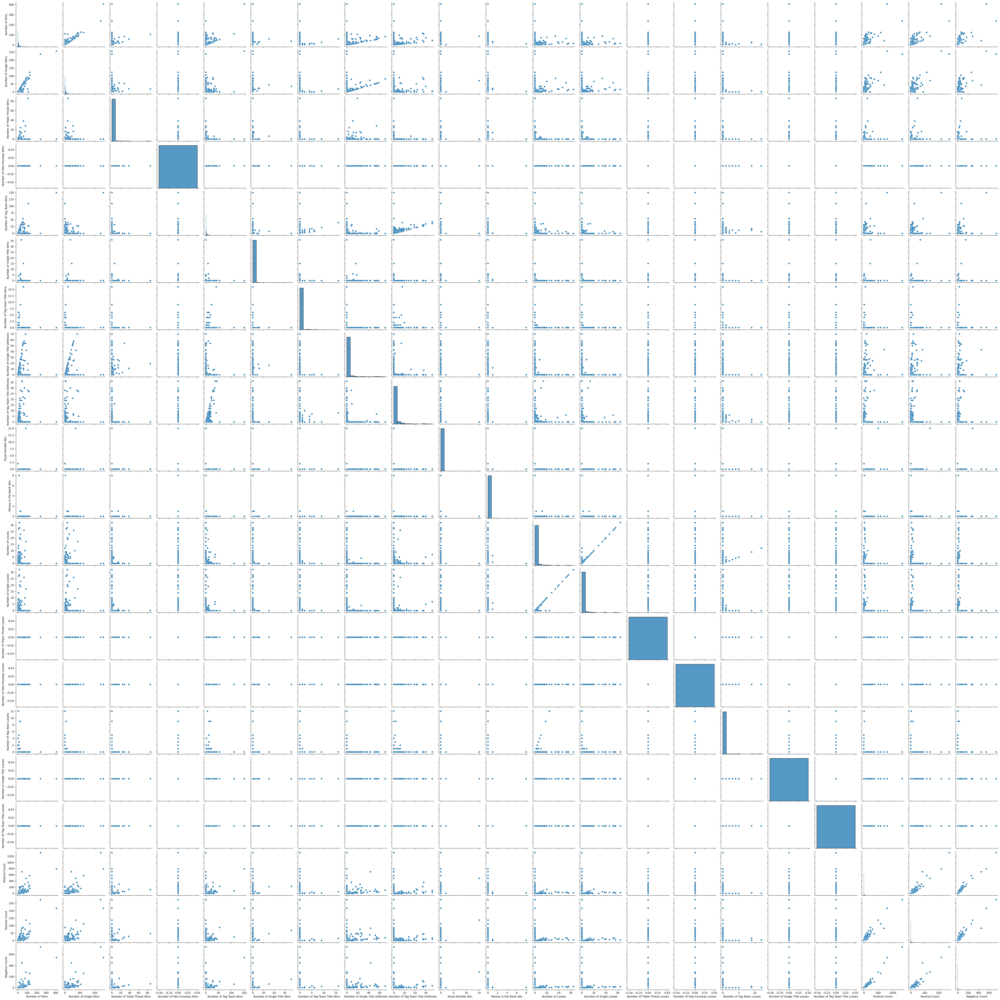

In [134]:
#the sns.pairplot allows us to get within one graph an overview of the whole data and its distribution
sns.pairplot(df_total_month)

When we look at the pairplot graph, we can see that not all features follow a linear trend, and all of them do not have a normal distribution. Therefore, we will select as correlation method, the Spearman's Rank-Order Correlation.

In [135]:
df_total_month.head()

,Date_Month,Wrestler,Number of Wins,Number of Single Wins,Number of Triple Threat Wins,Number of Fata Fourway Wins,Number of Tag Team Wins,Number of Single Title Wins,Number of Tag Team Title Wins,Number of Single Title Defenses,...,Number of Losses,Number of Single Losses,Number of Triple Threat Losses,Number of Fata Fourway Losses,Number of Tag Team Losses,Number of Single Title Losses,Number of Tag Team Title Losses,Positive Count,Neutral Count,Negative Count
0,2023-03-01,Asuka,23,3,0,0,20,0,0,0,...,0,0,0,0,0,0,0,16,1,2
1,2023-03-01,Austin Theory,38,34,4,0,0,0,0,26,...,4,4,0,0,0,0,0,43,7,21
2,2023-03-01,Becky Lynch,15,10,0,0,5,0,0,0,...,0,0,0,0,0,0,0,10,5,6
3,2023-03-01,Bobby Lashley,13,13,0,0,0,0,0,0,...,0,0,0,0,0,0,0,6,1,4
4,2023-03-01,Braun Strowman,21,9,0,0,12,0,0,0,...,9,0,0,0,9,0,0,20,16,26


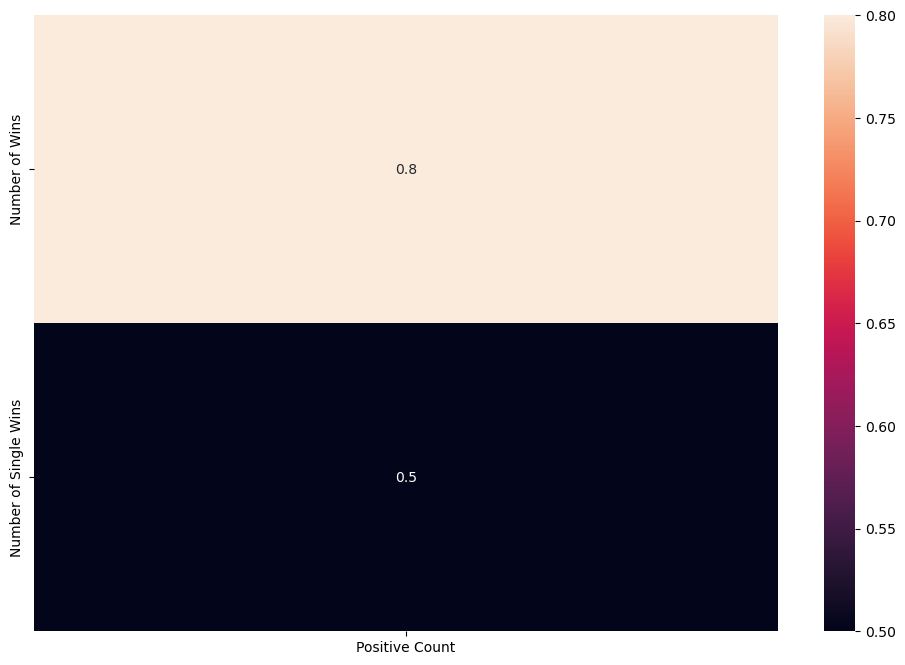

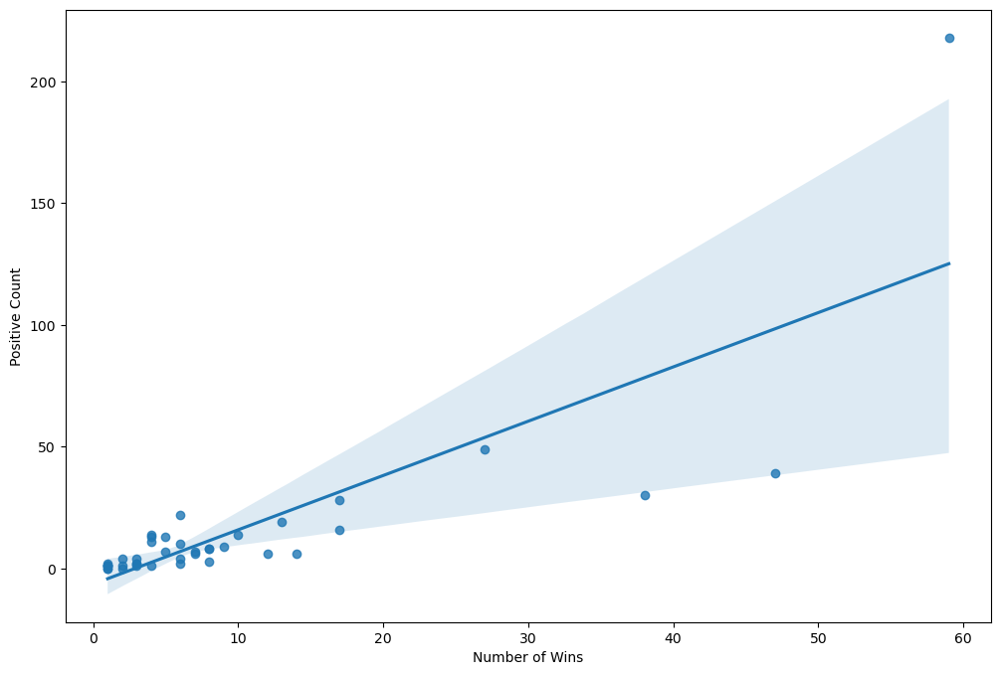

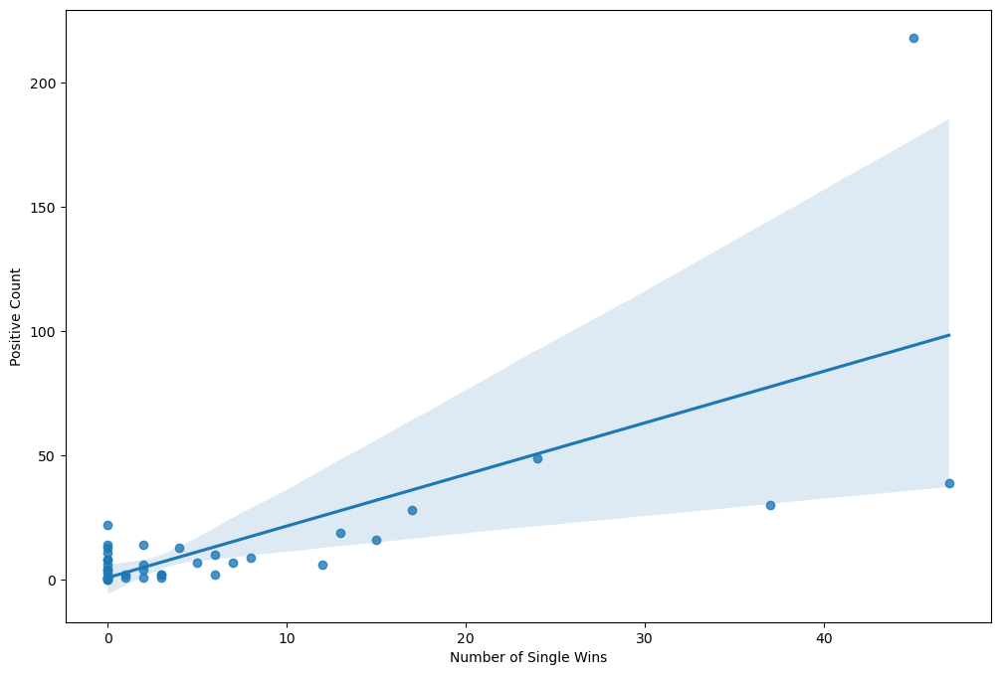

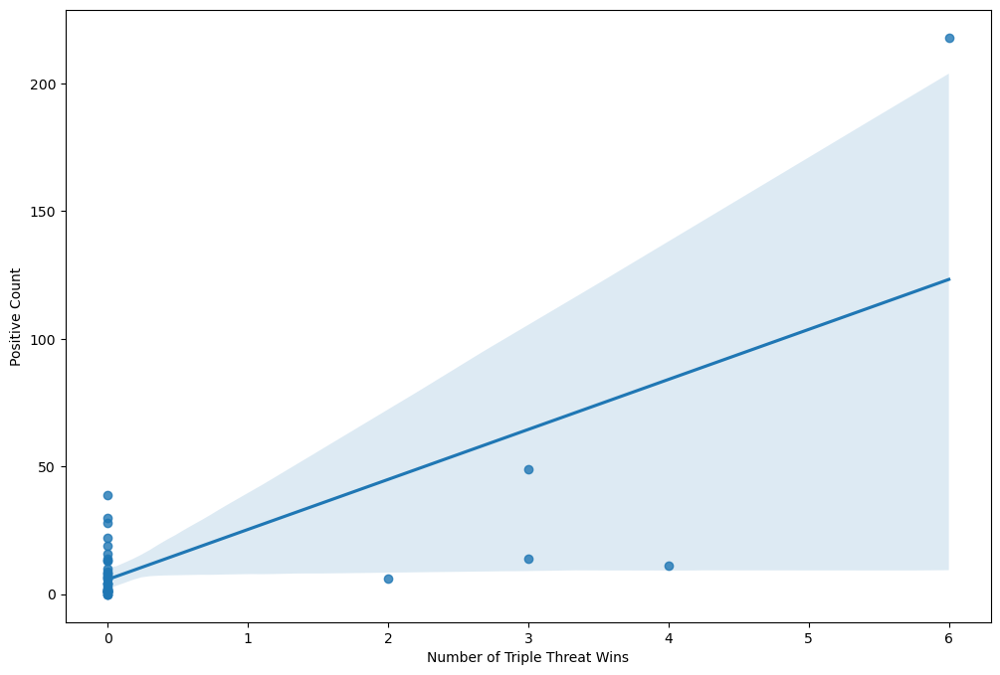

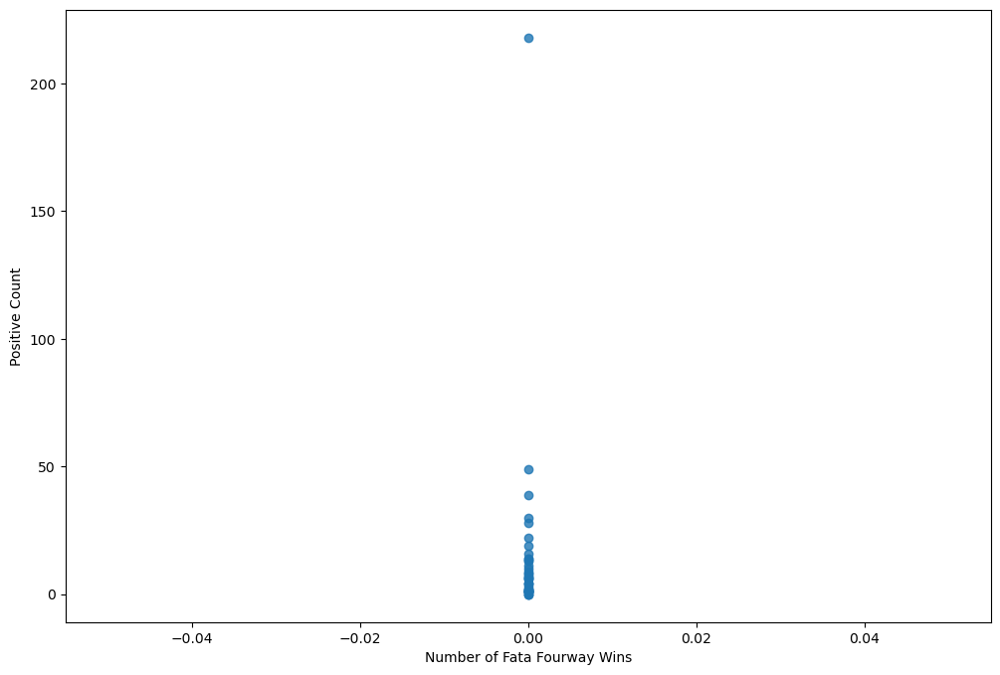

...

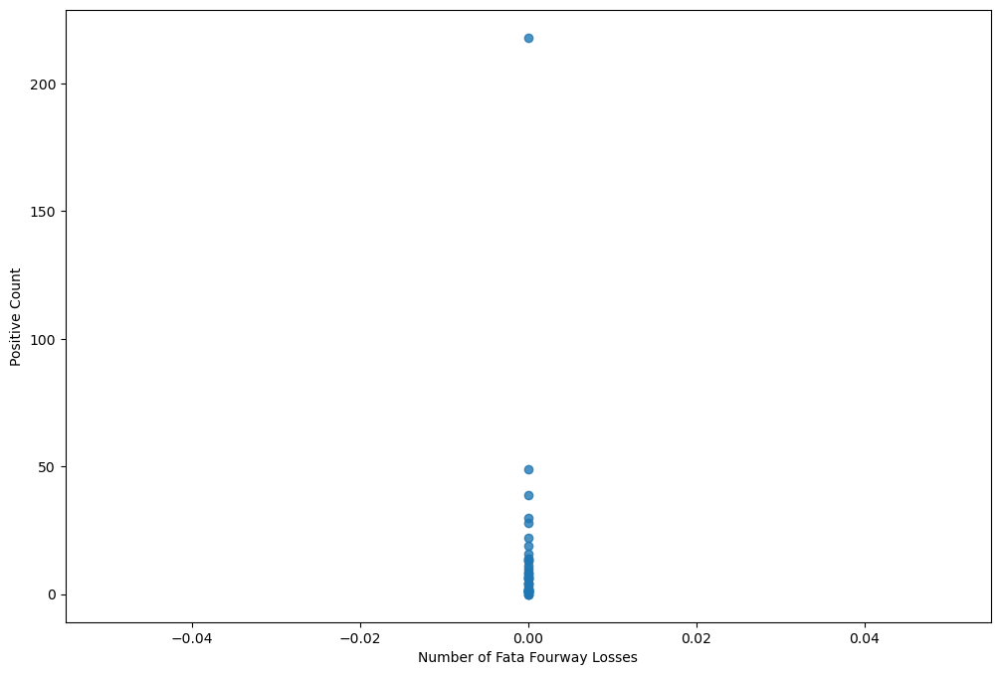

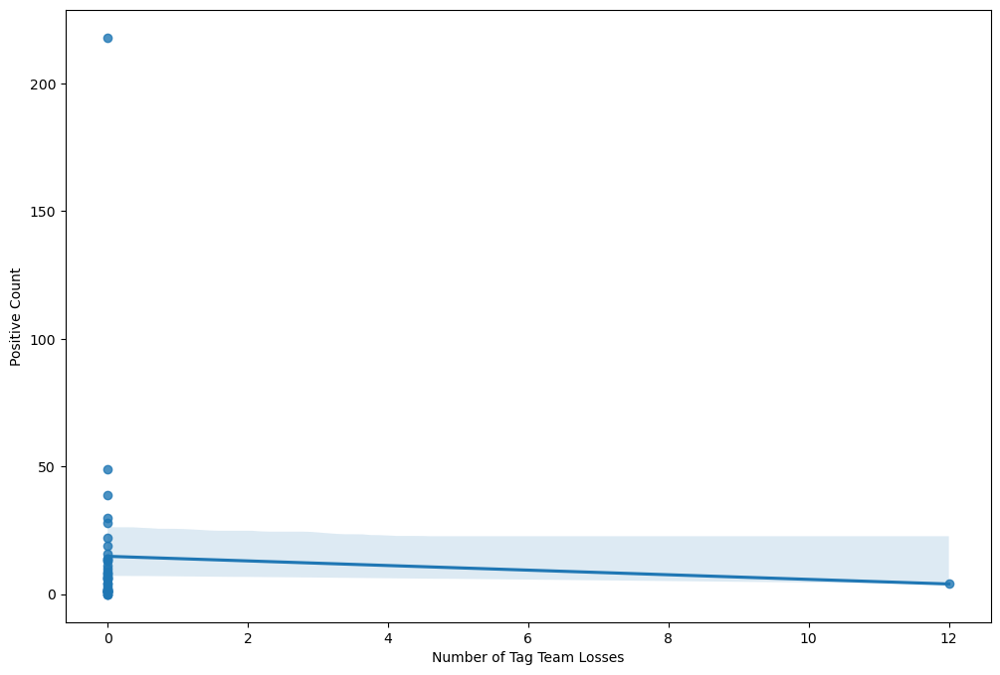

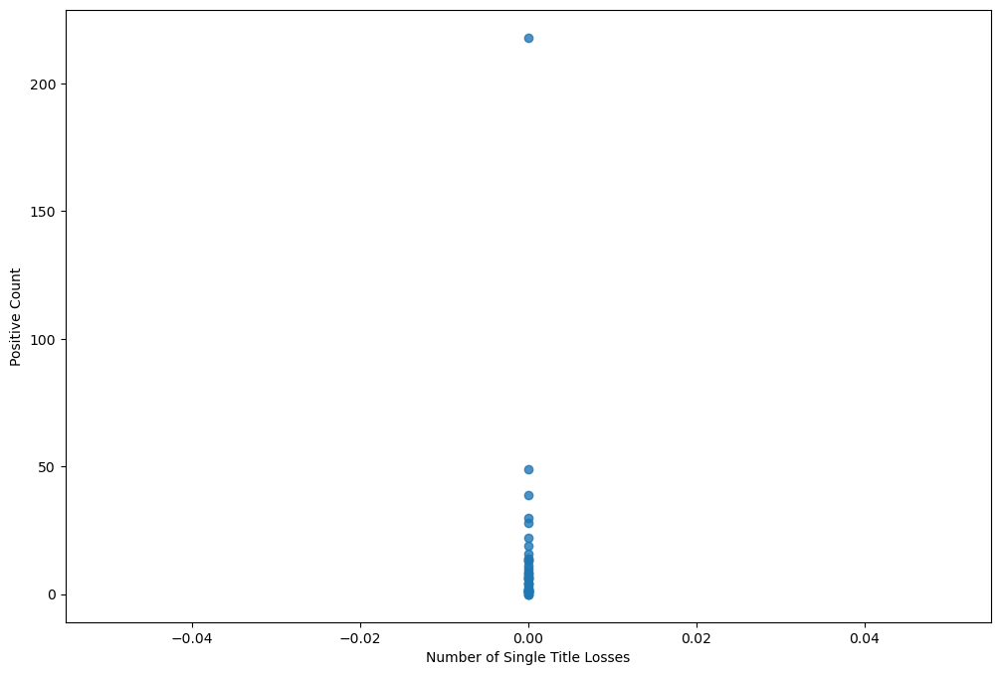

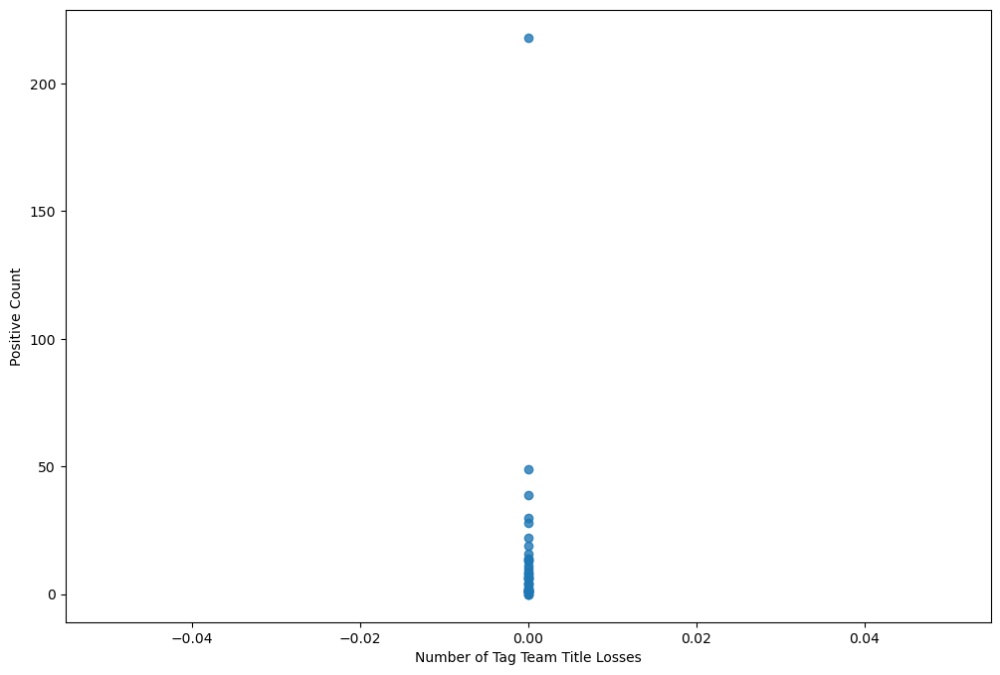

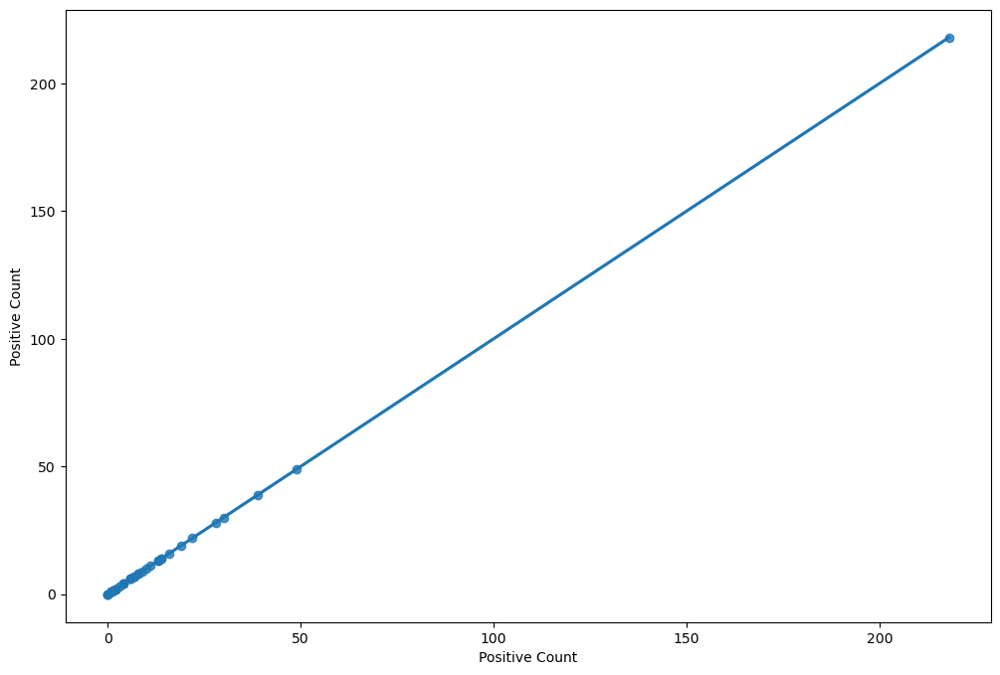

In [136]:
from scipy.stats import spearmanr

plt.figure(figsize=(12,8))
dev_com=df_total_month[(df_total_month['Date_Month']=='2023-05-01')].loc[:,:'Positive Count']
if dev_com.empty:
    print('empty')
else:
    matrix=round(dev_com.drop(columns=['Date_Month','Wrestler']).corr(method='spearman'),1).fillna(0)['Positive Count'].reset_index().set_index('index')
    filtered_matrix=matrix[(matrix['Positive Count'] >= 0.5) & (matrix['Positive Count'] <= 0.9)]
    
sns.heatmap(filtered_matrix, annot=True,)
plt.ylabel('')

check=list(matrix.reset_index()['index'])

for x in check:
    plt.figure(figsize=(12,8))
    joinplot=sns.regplot(x=x,y='Positive Count',data=dev_com)
    #plt.title('Reg plot for {} and {} Comments in {}'.format(x,sent,time_period),size=12,fontweight='bold')

Available time span from 2023-03-01 until 2024-04-01: 2023-08-01


C:\Users\gandj\AppData\Local\Temp\ipykernel_6228\3005203077.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(12,8))


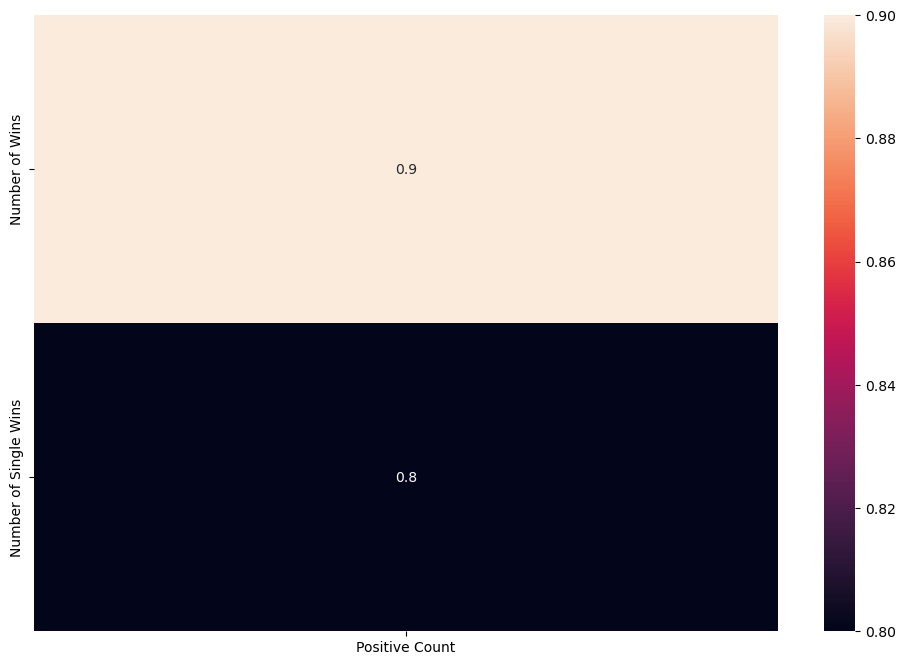

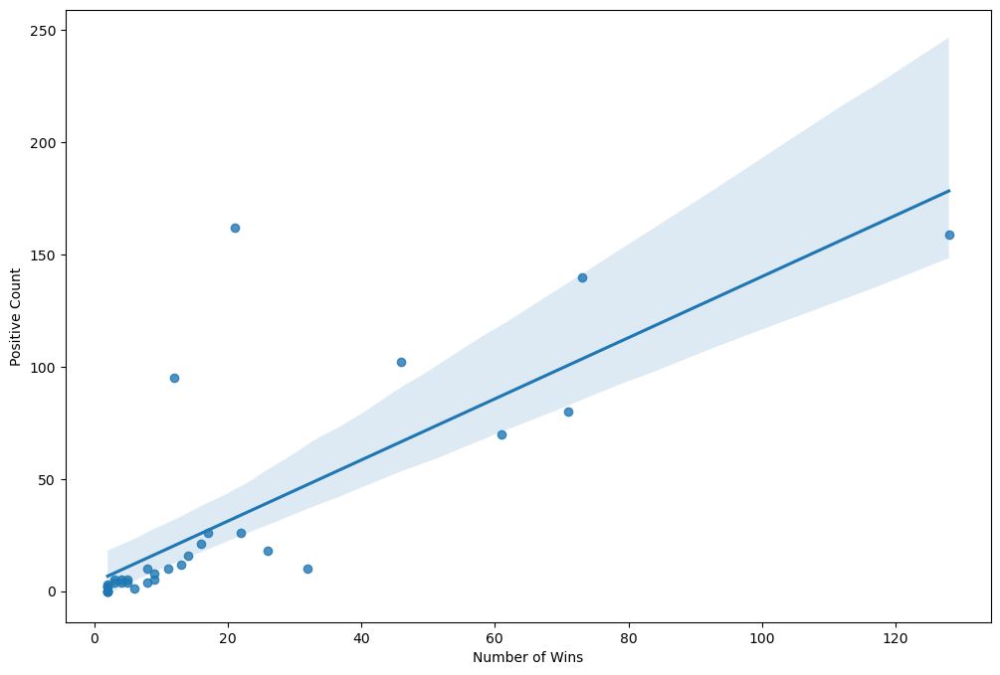

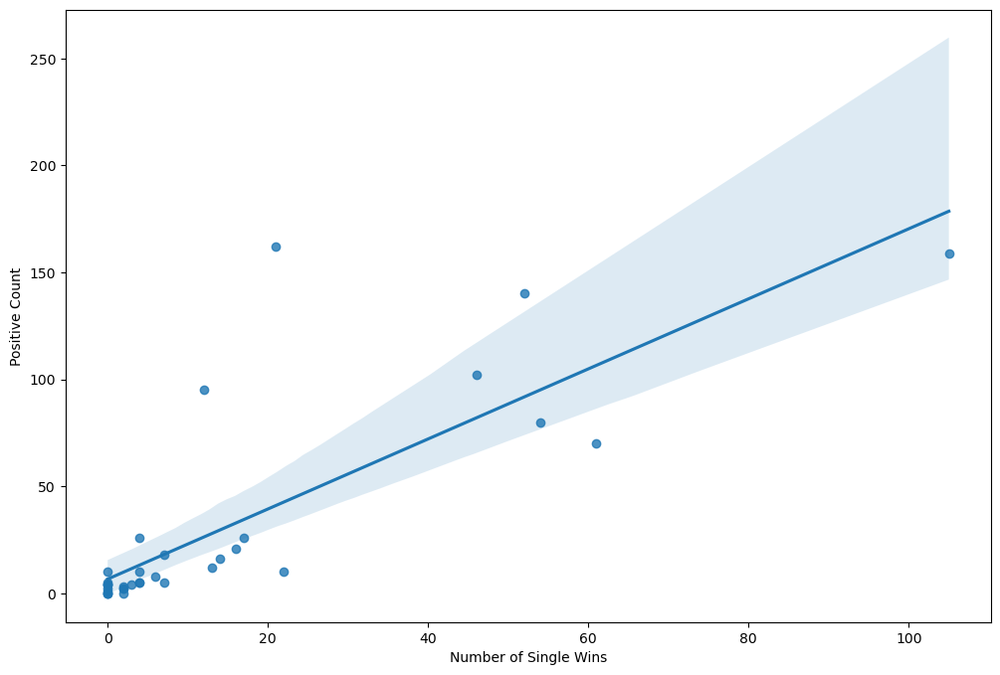

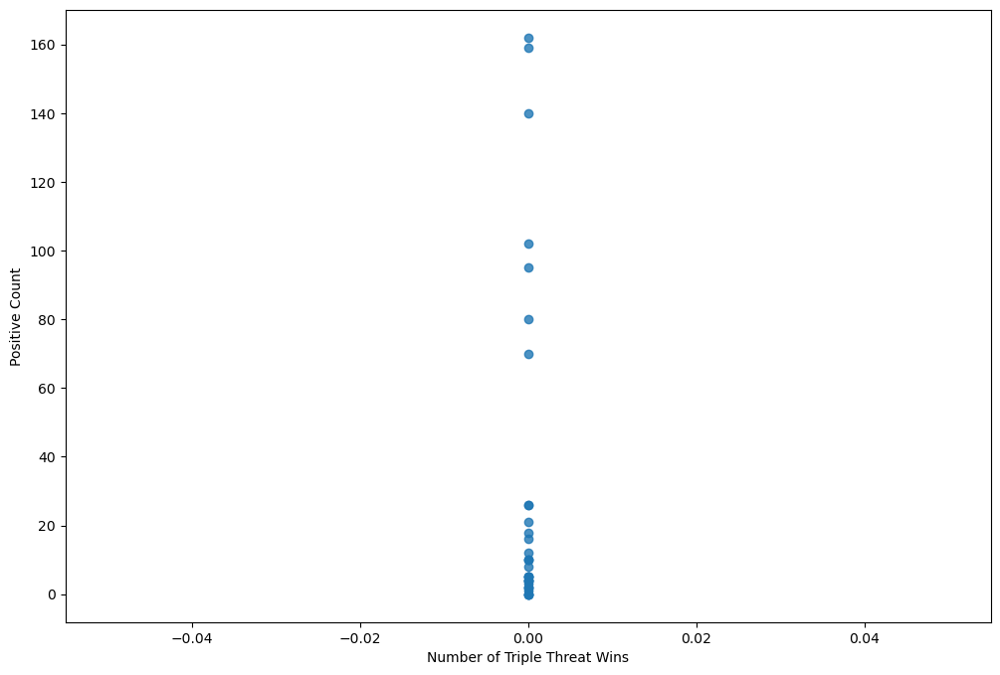

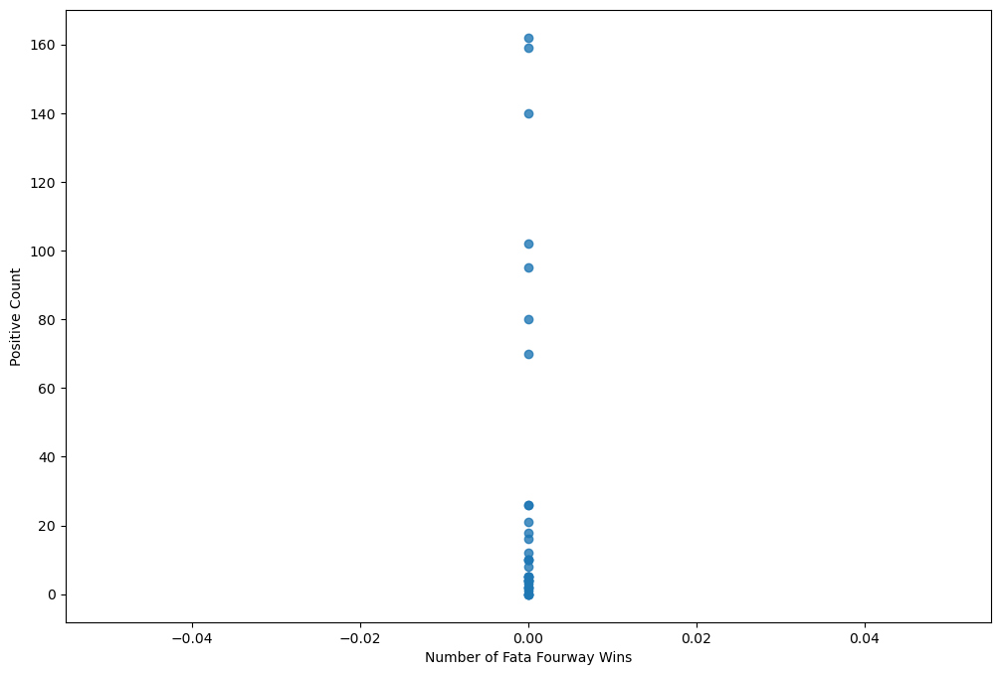

...

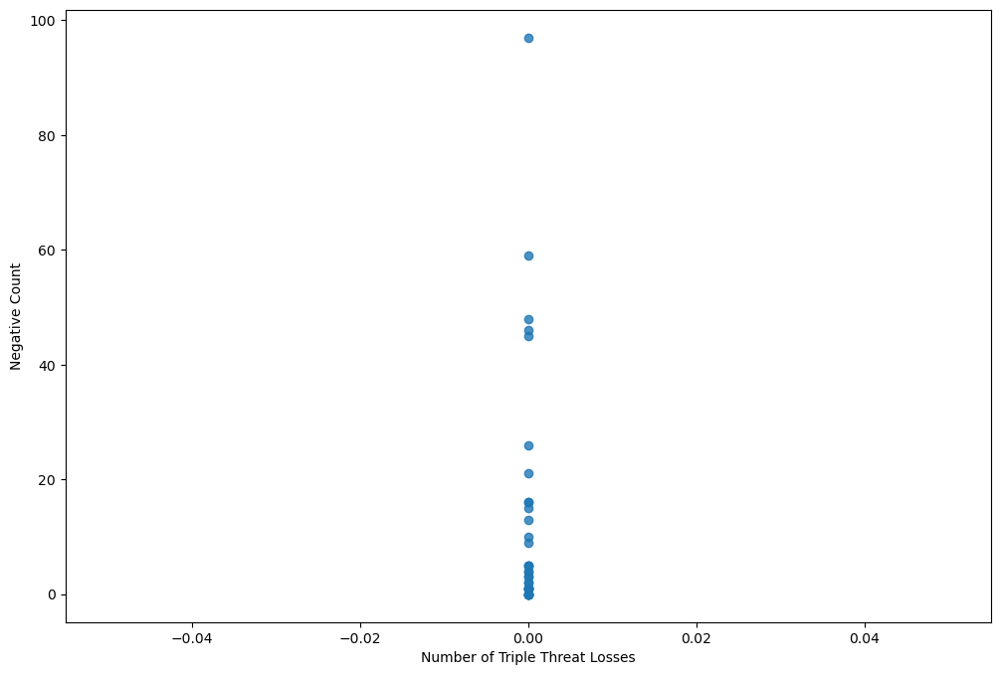

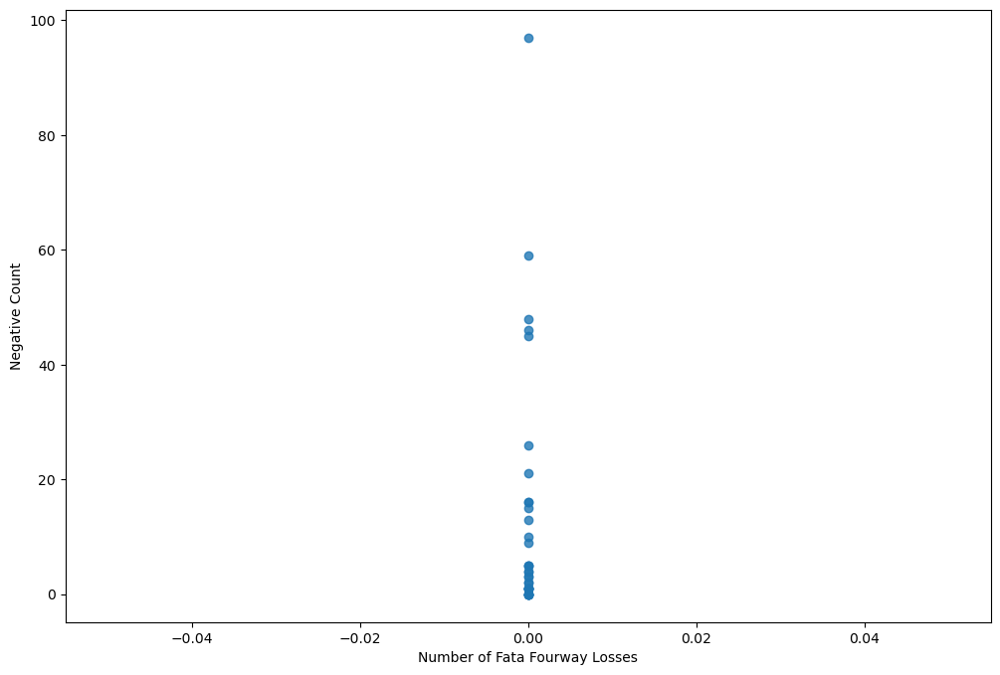

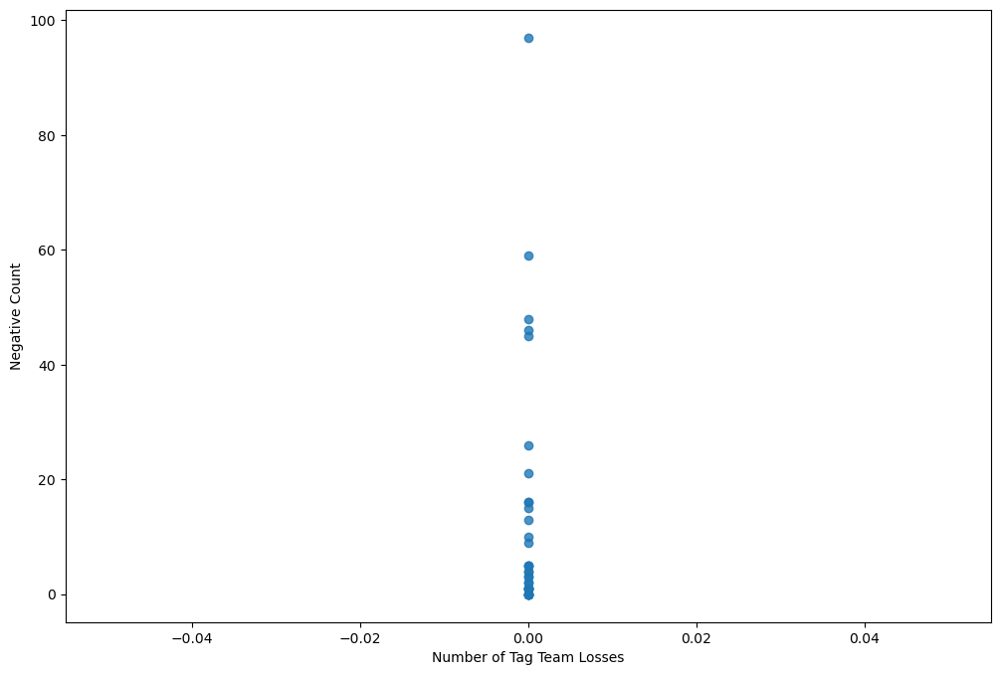

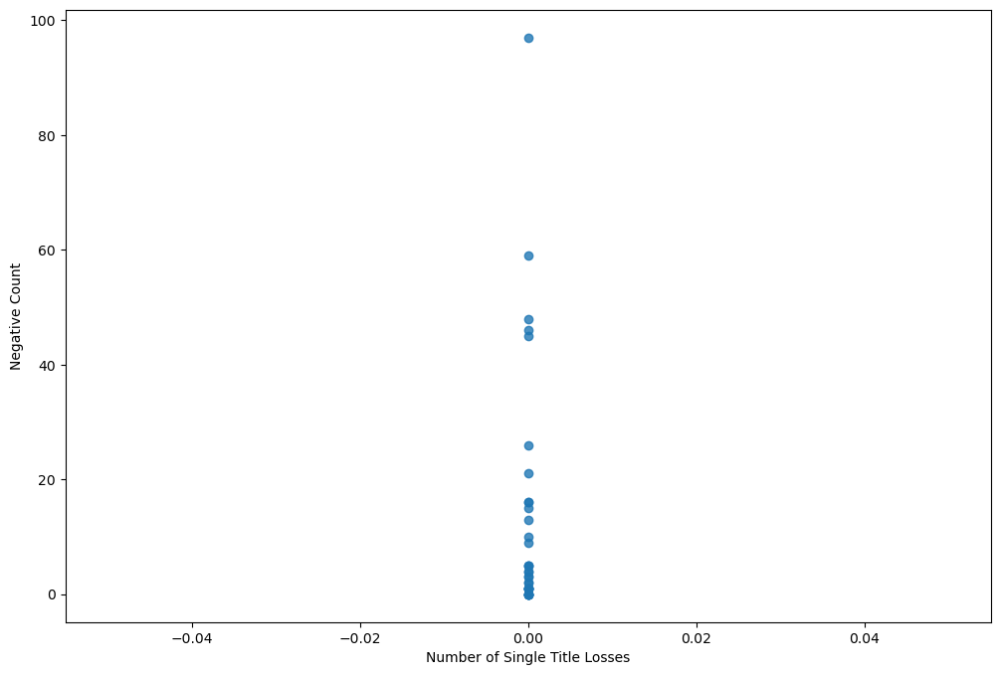

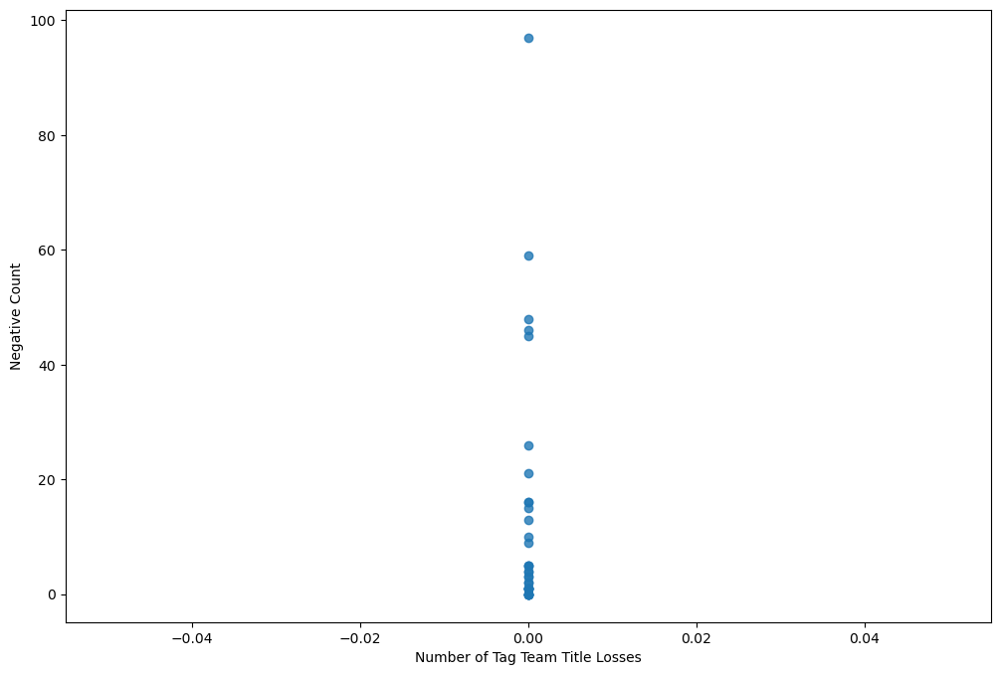

In [137]:
from scipy.stats import spearmanr

sentiment=['Positive Count','Negative Count']
time_period=str(input('Available time span from 2023-03-01 until 2024-04-01: '))

for sent in sentiment:
    if sent == 'Positive Count':
        plt.figure(figsize=(12,8))
        dev_com=df_total_month[(df_total_month['Date_Month']==time_period)].loc[:,:sent].drop(columns=['Royal Rumble Win',
                                                                                                      'Money in the Bank Win'])
        if dev_com.empty:
            print('empty')
        else:
            matrix=round(dev_com.drop(columns=['Date_Month','Wrestler']).corr(method='spearman'),1).fillna(0)[sent].reset_index().set_index('index')
            filtered_matrix=matrix[(matrix[sent] >= 0.5) & (matrix[sent] <= 0.9)]
    else:
        plt.figure(figsize=(12,8))
        dev_com=df_total_month[(df_total_month['Date_Month']==time_period)].loc[:,:sent].drop(columns=['Positive Count',
                                                                                                         'Neutral Count',
                                                                                                      'Royal Rumble Win',
                                                                                                      'Money in the Bank Win'])
        if dev_com.empty:
            print('empty')
        else:
            matrix=round(dev_com.drop(columns=['Date_Month','Wrestler']).corr(method='spearman'),1).fillna(0)[sent].reset_index().set_index('index')
            filtered_matrix=matrix[(matrix[sent] >= 0.5) & (matrix[sent] <= 0.9)]
    
    sns.heatmap(filtered_matrix, annot=True,)
    plt.ylabel('')

    check=list(matrix.reset_index()['index'][:-1])

    for x in check:
        plt.figure(figsize=(12,8))
        joinplot=sns.regplot(x=x,y=sent,data=dev_com)
        #plt.title('Reg plot for {} and {} Comments in {}'.format(x,sent,time_period),size=12,fontweight='bold')

When analysing the corrleation levels between Sentiment Count and the features one thing becomes obvious, number of wins, single wins and single title defences correlated with any sentiment strongly. What does that mean? WWE fans respond negatively to wins of a wrestler, because they do not like the wrestler, they do not like how the wrestler is used in the story etc. vice versa for the other sentiments.

Next, lets check how the sentiment behaves based on the different dates and features.

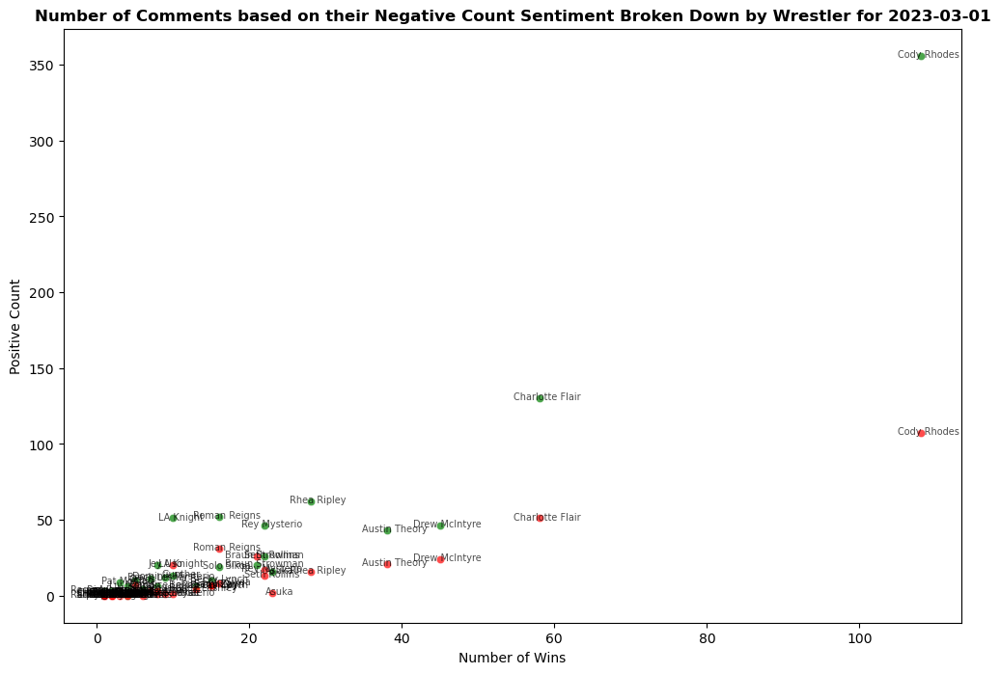

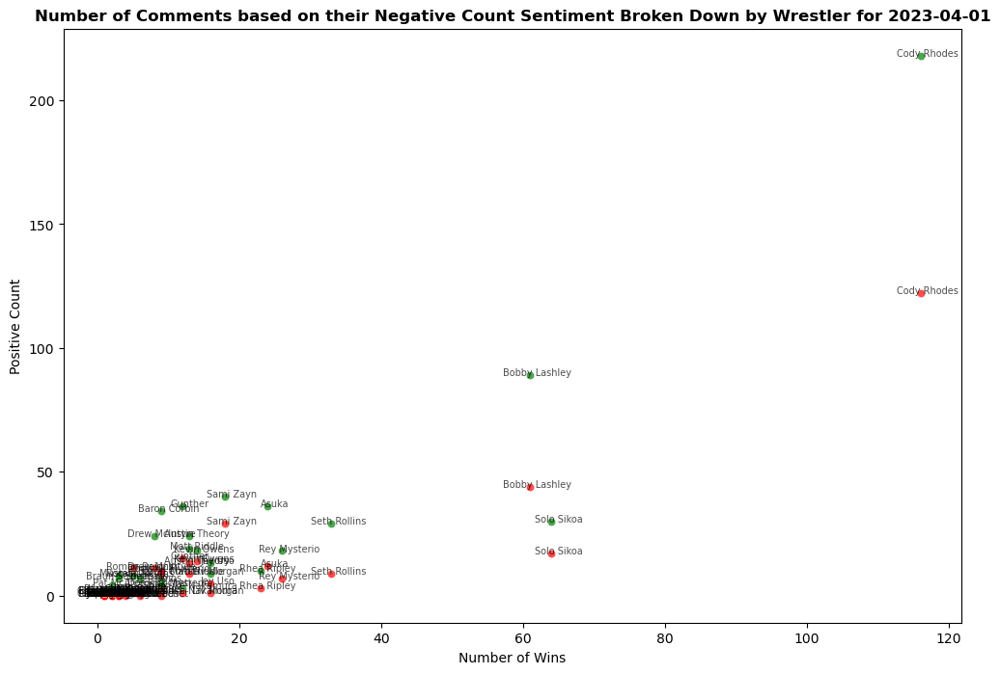

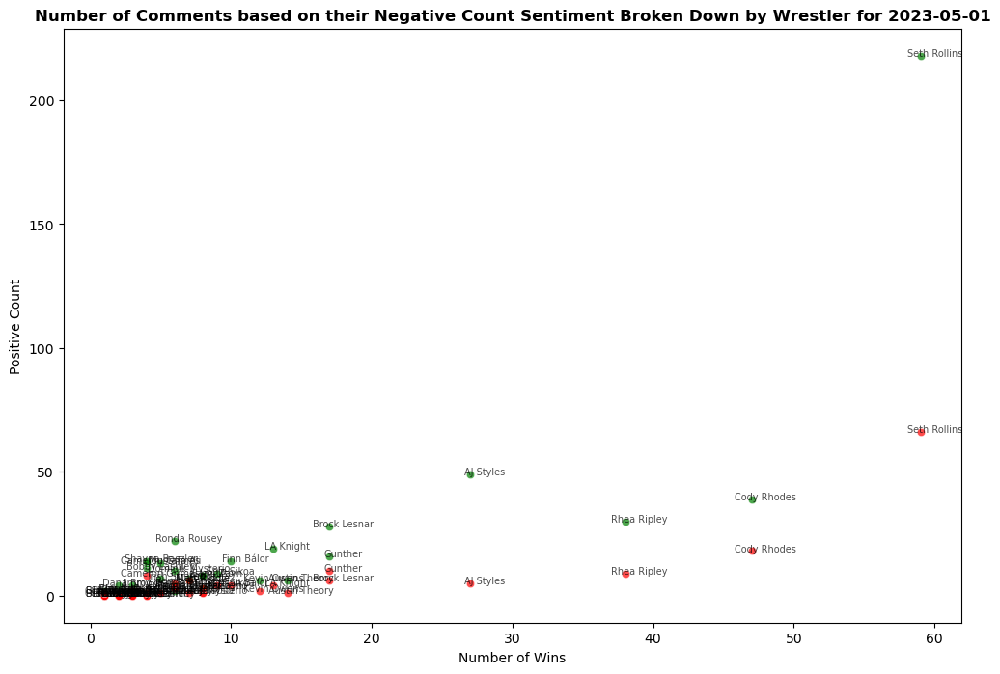

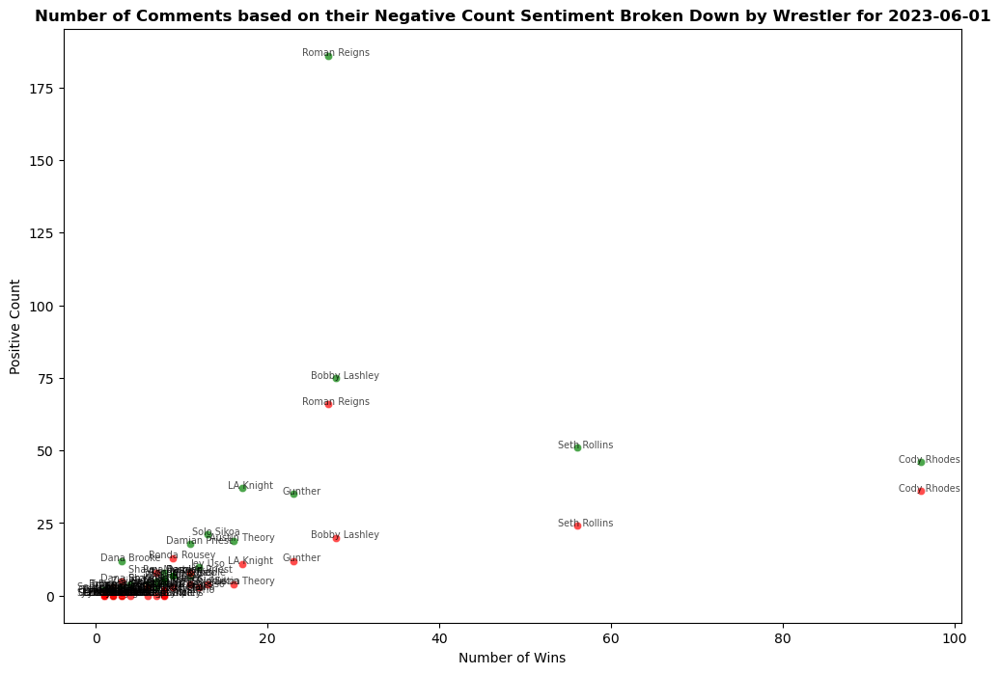

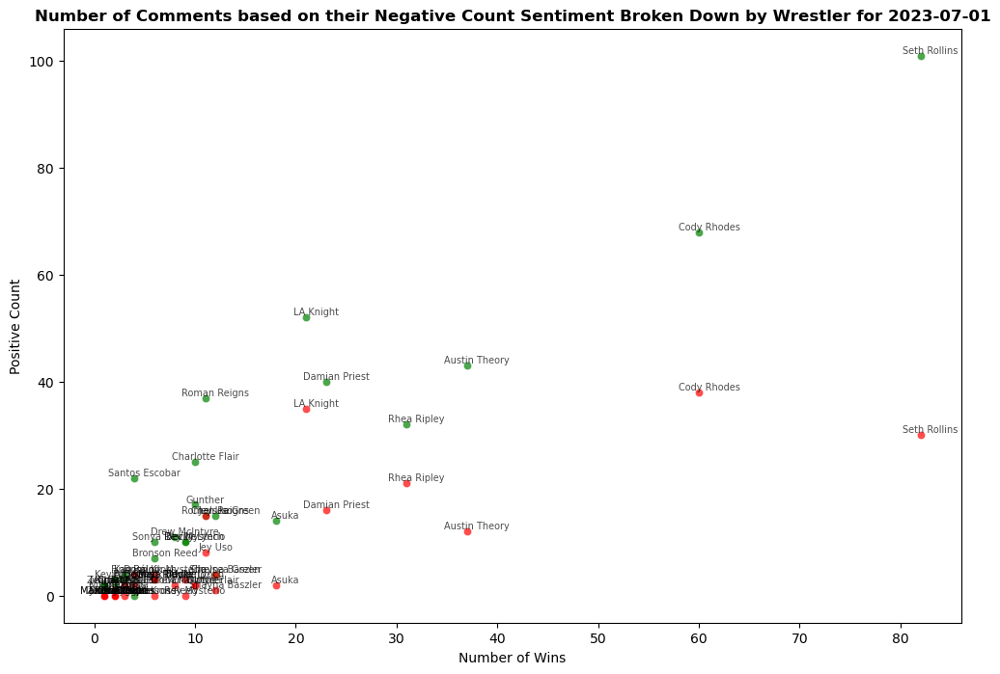

...

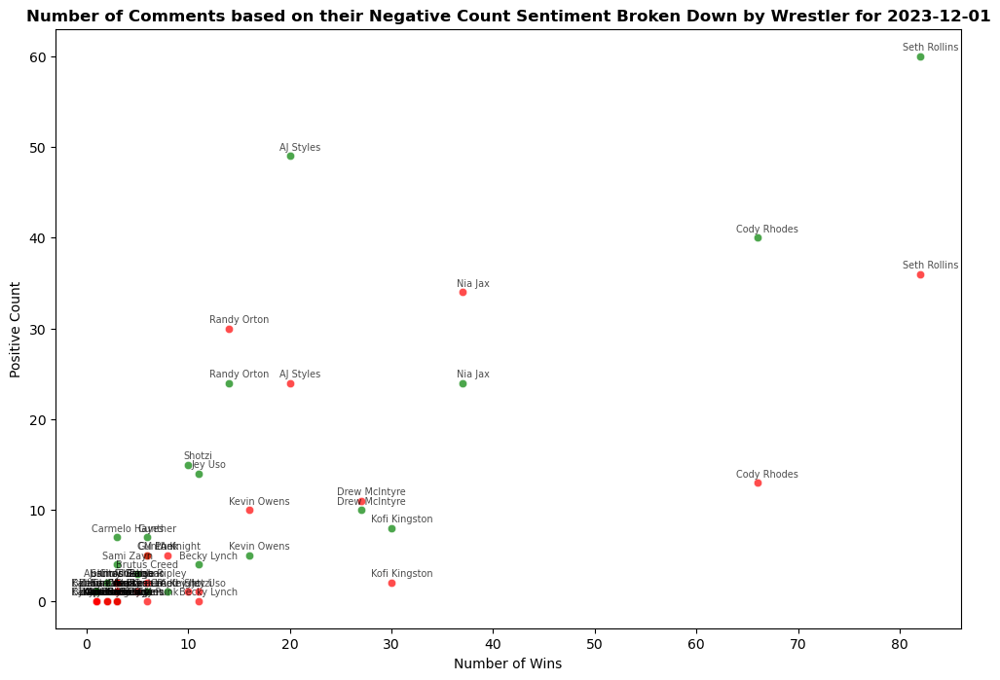

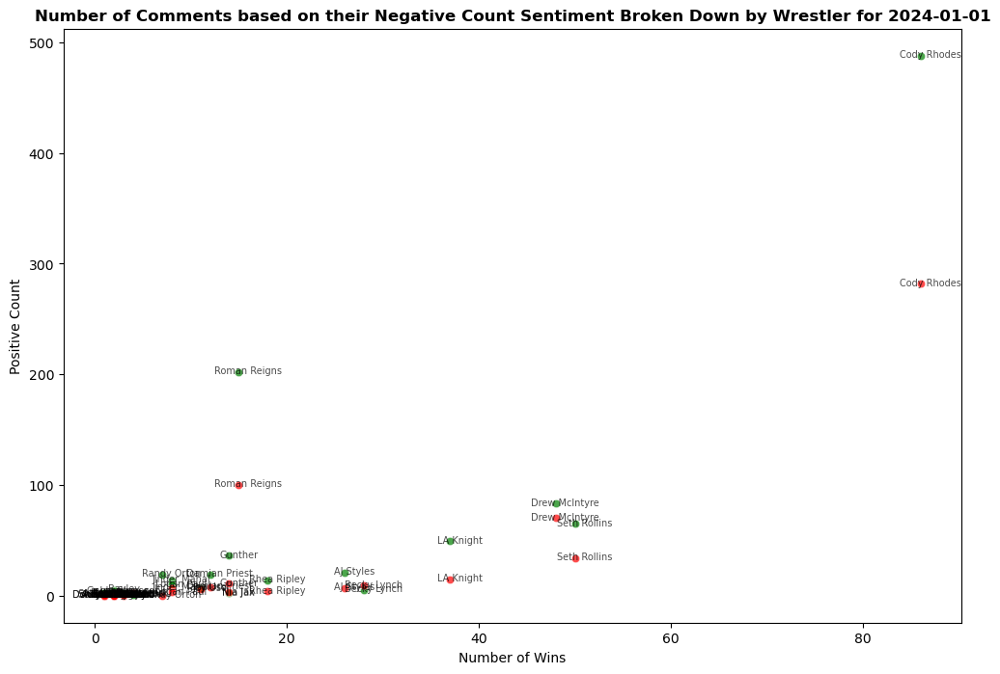

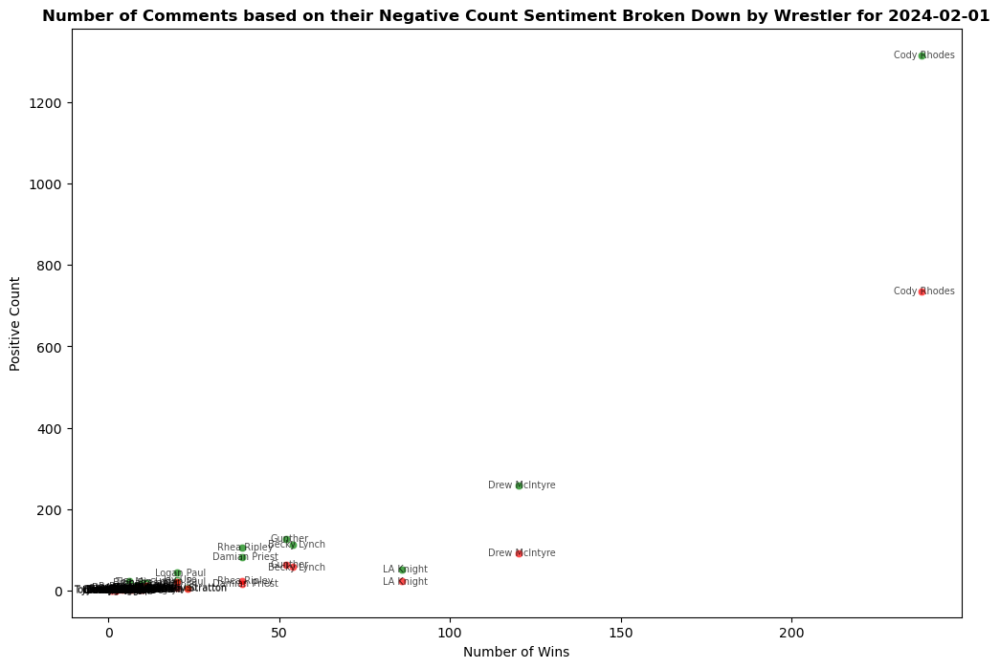

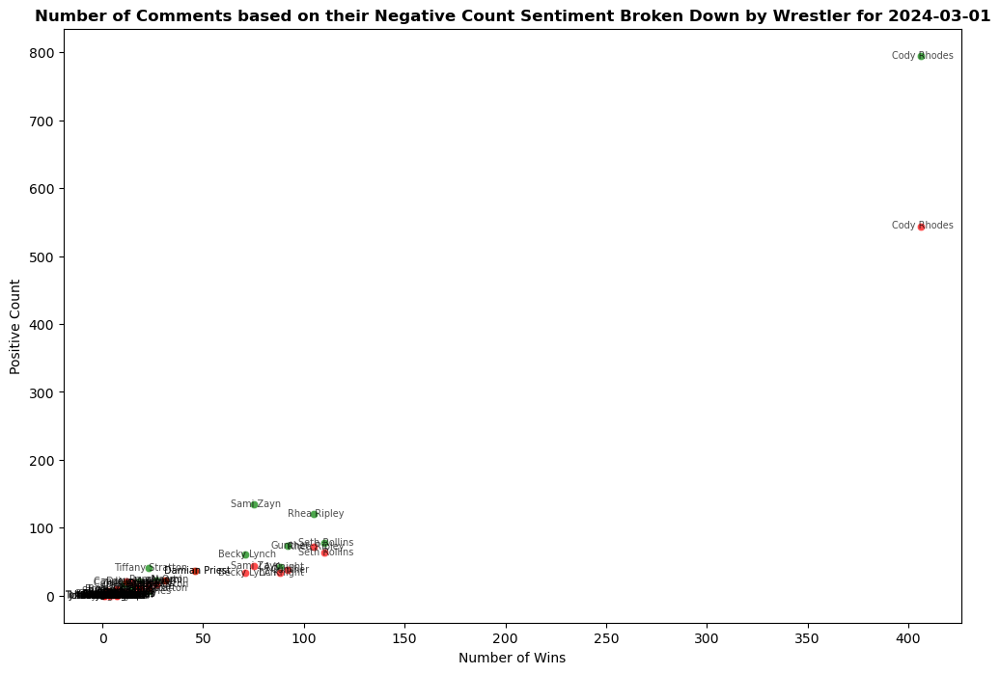

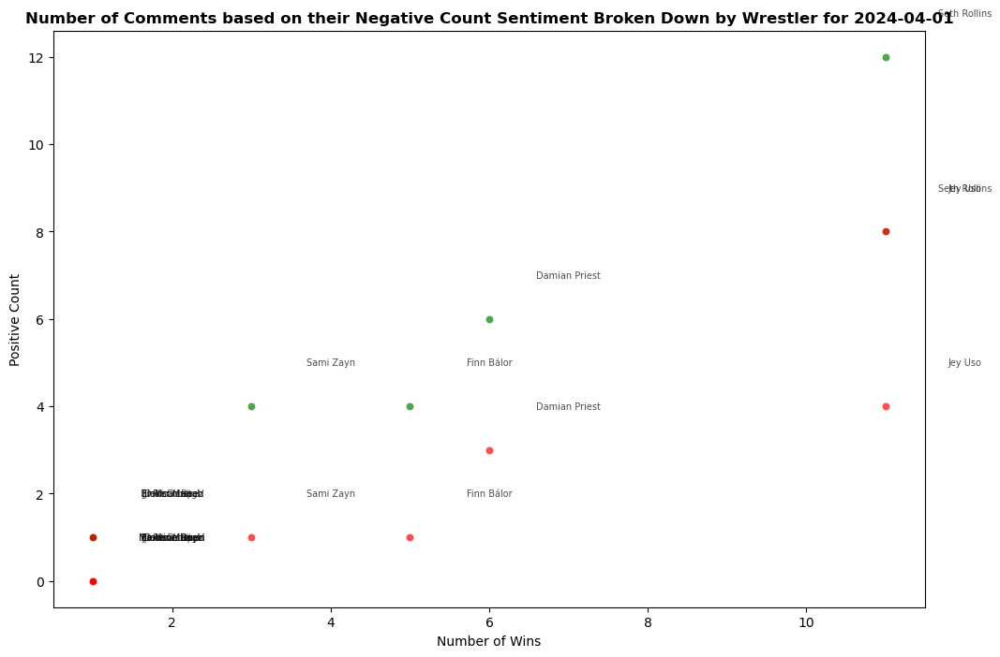

In [138]:
sentiments=['Positive Count','Negative Count']
dates=list(df_total_month['Date_Month'].unique())[:-1]

for d in dates:
    plt.figure(figsize=(12,8))
    dev_com=df_total_month[(df_total_month['Date_Month']==d)]
    for sent in sentiments:
        if sent == 'Positive Count':
            color='Green'
        elif sent == 'Neutral Count':
            color='Gray'
        else:
            color='Red'
        scatter_plot=sns.scatterplot(x='Number of Wins', y=sent, color=color,alpha=0.7,data=dev_com)
        for line in range(0, dev_com.shape[0]):
            wrestler='{}'.format(dev_com['Wrestler'].iloc[line])
            scatter_plot.text(dev_com['Number of Wins'].iloc[line], #x-value coordinate
                              dev_com[sent].iloc[line], #y-value coordinate
                              wrestler, #value that will be placed on the data point
                              horizontalalignment='center', 
                              verticalalignment='center', 
                              fontsize=7,
                              position=(dev_com['Number of Wins'].iloc[line]+1,dev_com[sent].iloc[line]+1),
                              color='black',
                              alpha=0.7)
        plt.title('Number of Comments based on their {} Sentiment Broken Down by Wrestler for {}'.format(sent,d),
                  size=12,fontweight='bold')

C:\Users\gandj\AppData\Local\Temp\ipykernel_6228\1803609290.py:25: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(10,6))


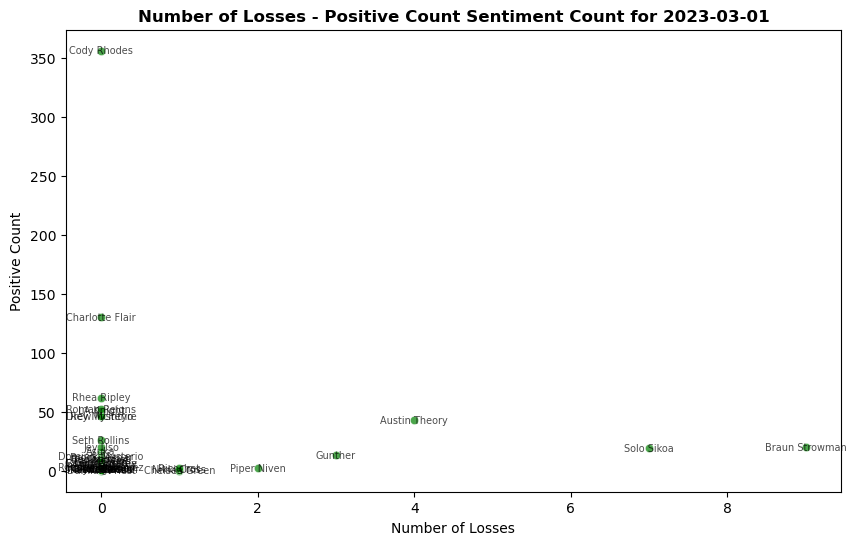

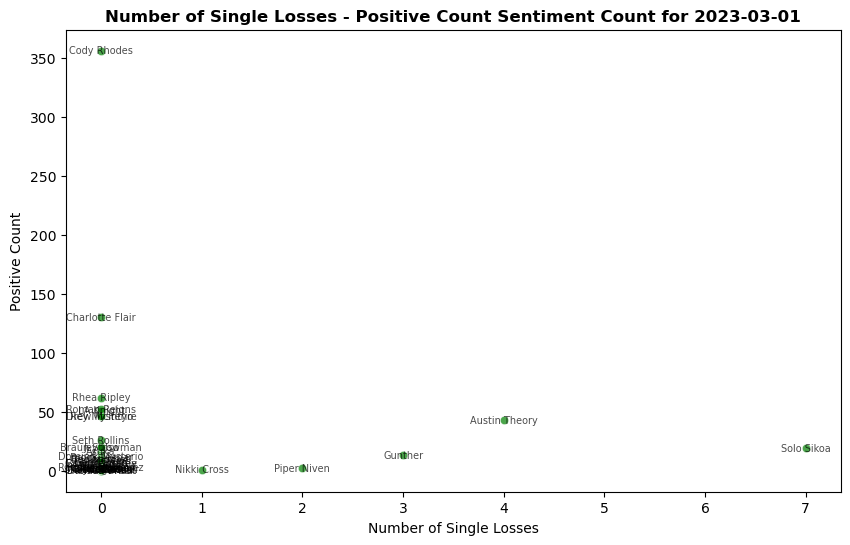

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

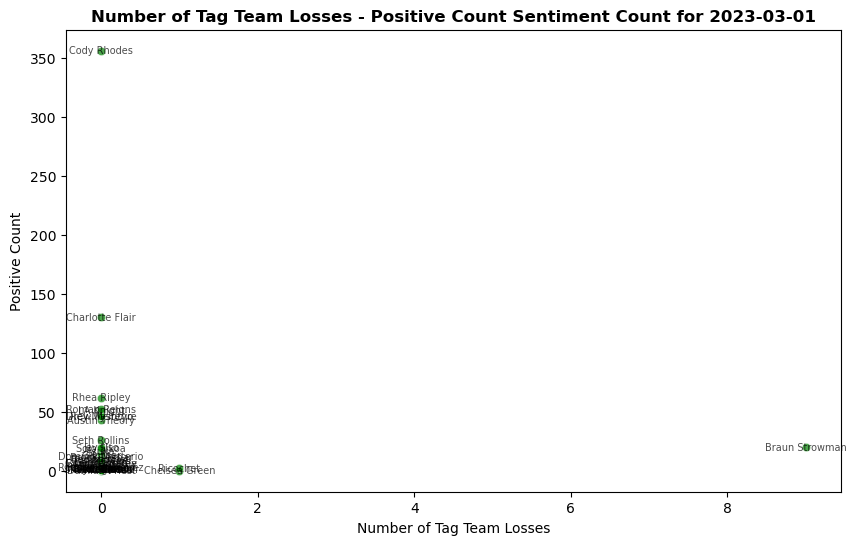

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

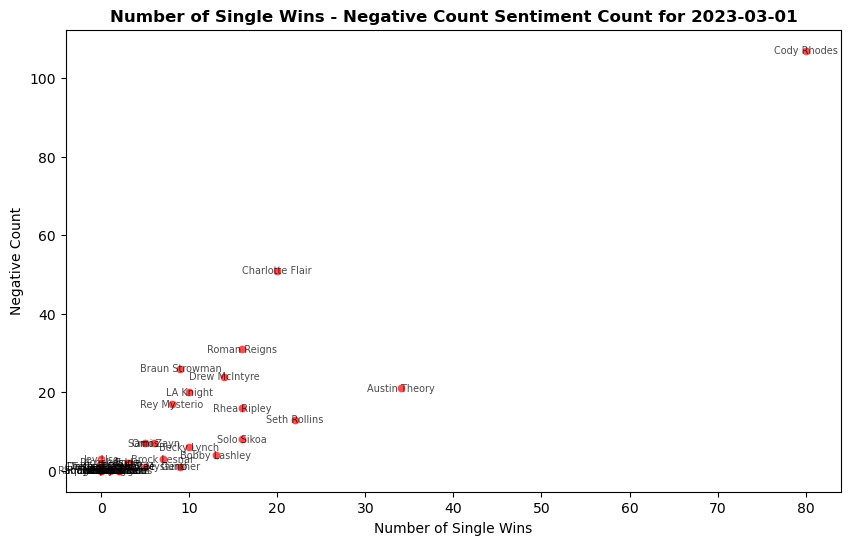

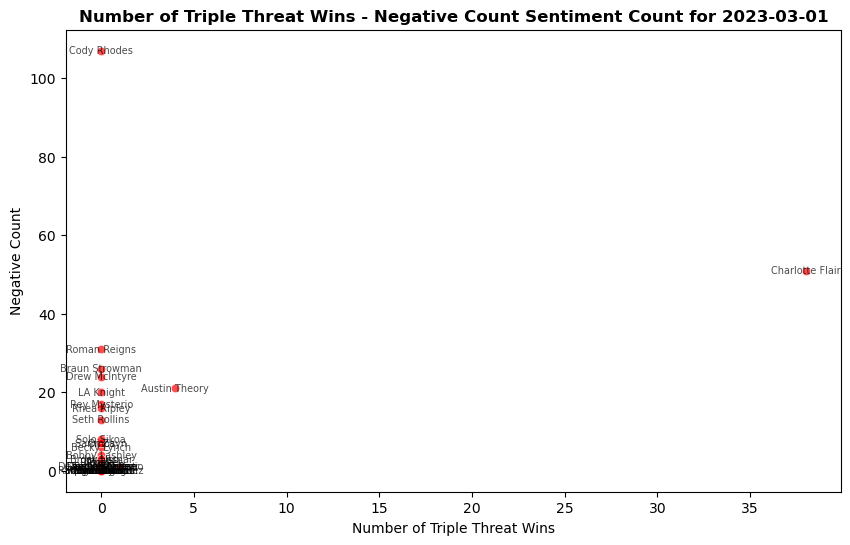

<Figure size 1000x600 with 0 Axes>

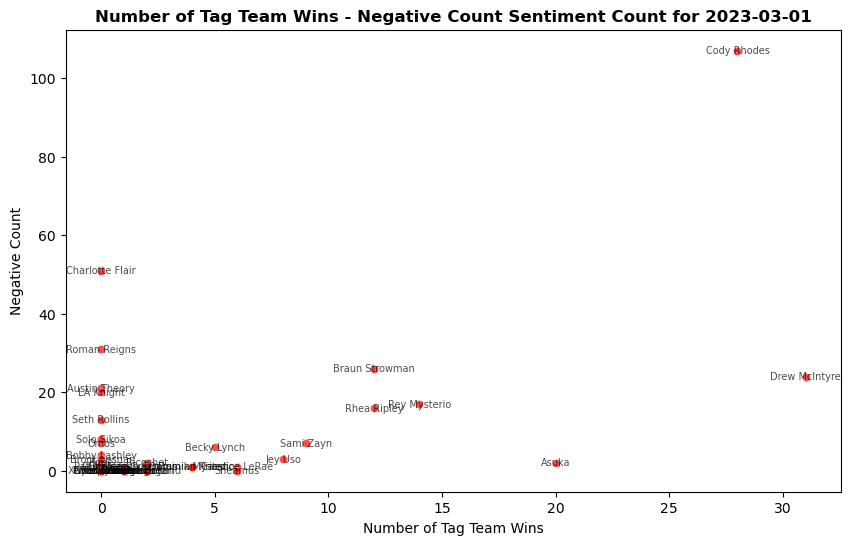

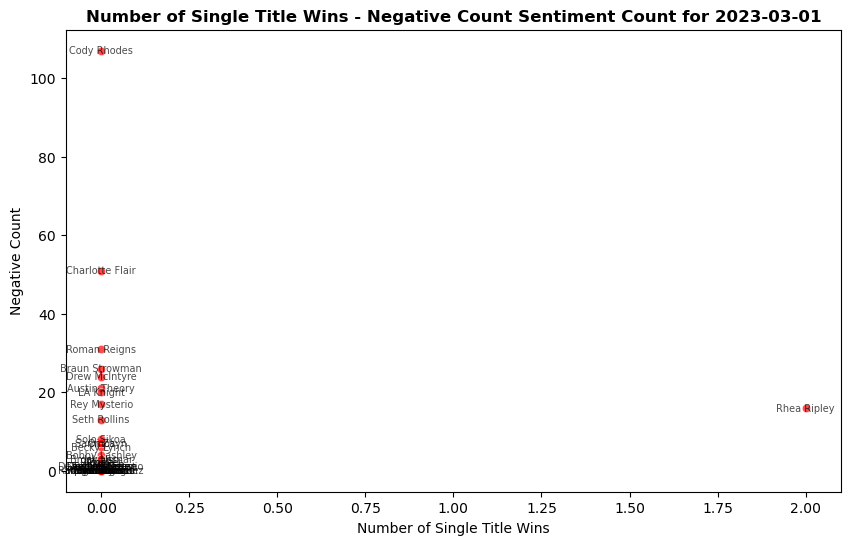

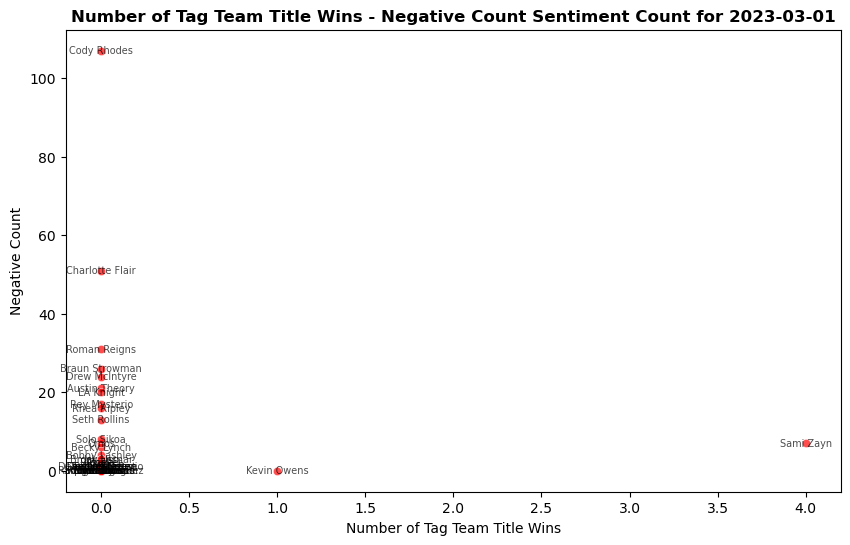

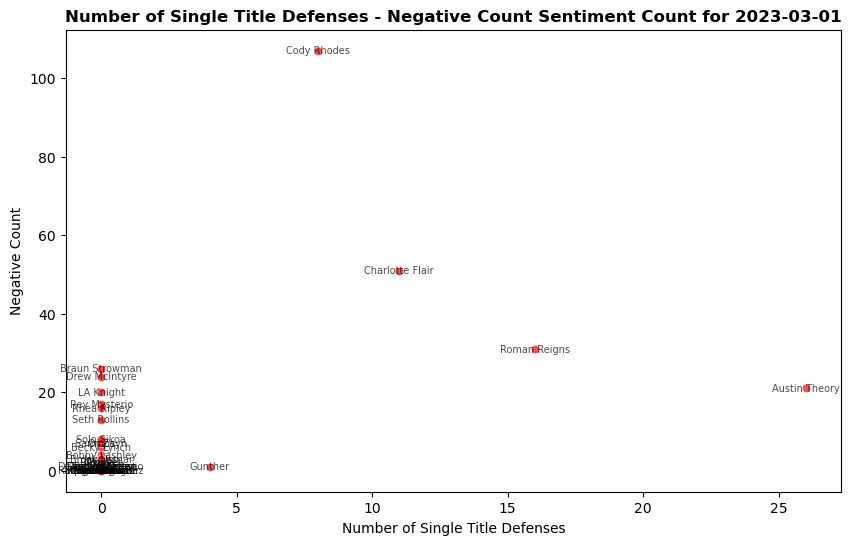

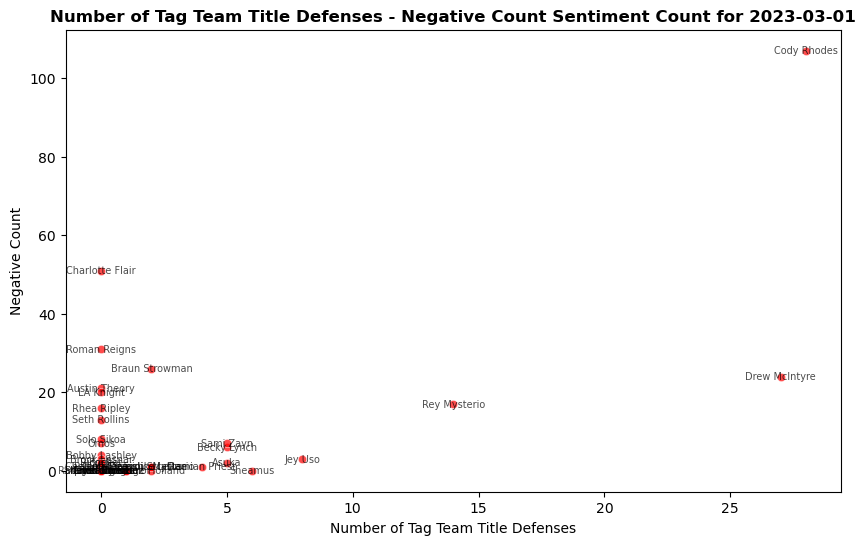

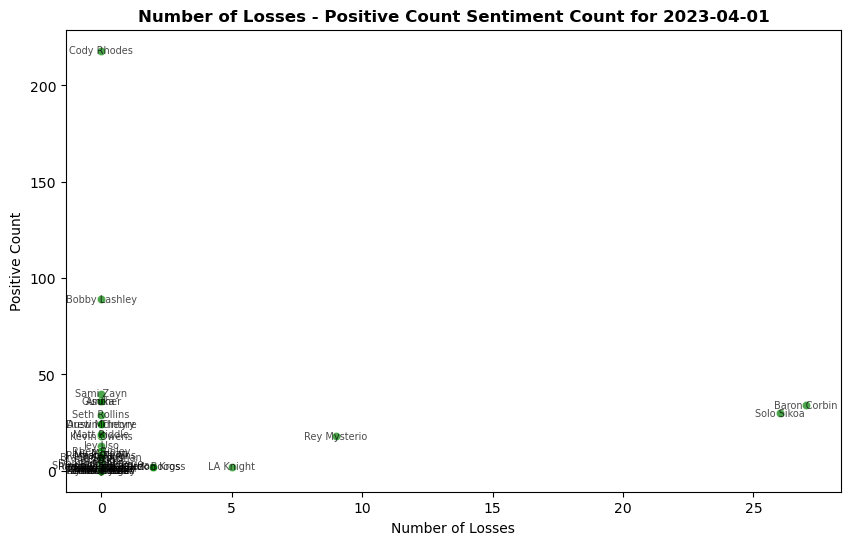

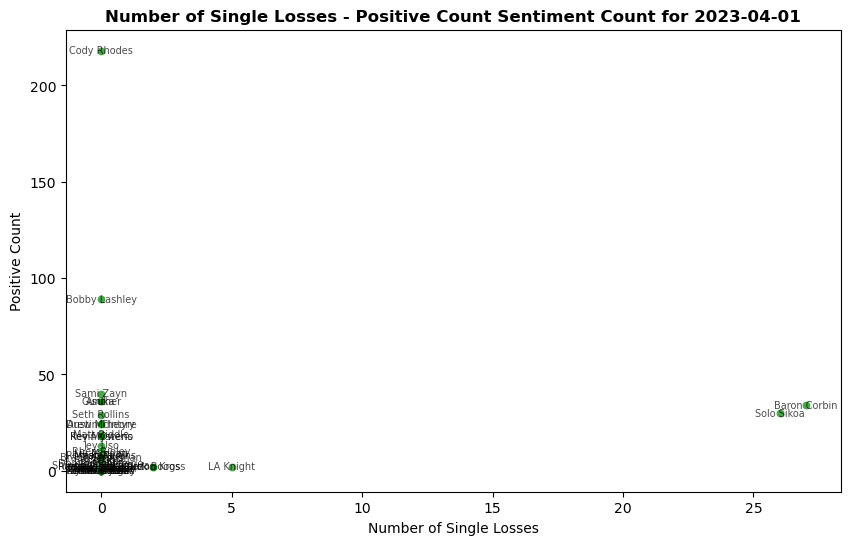

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

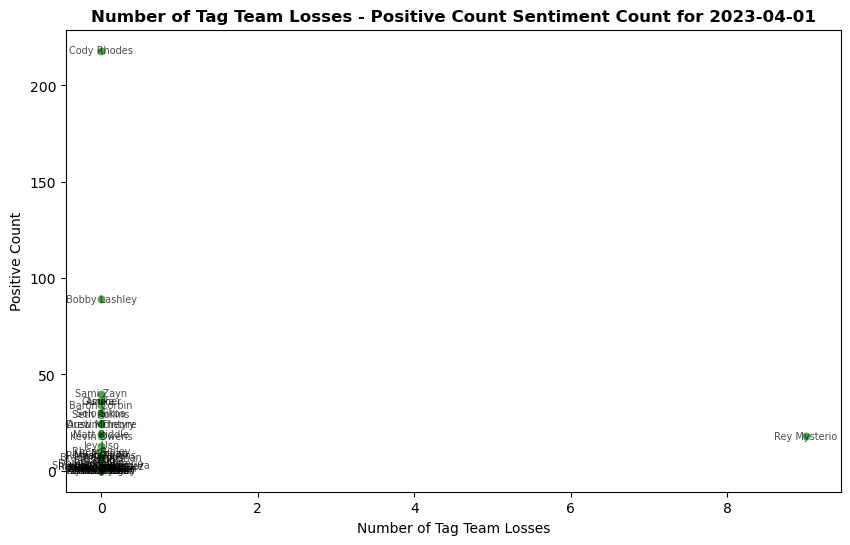

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

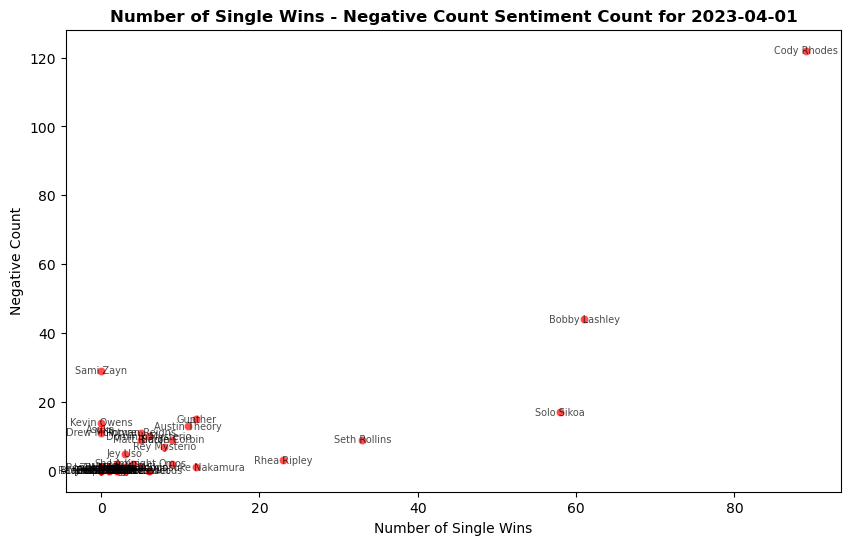

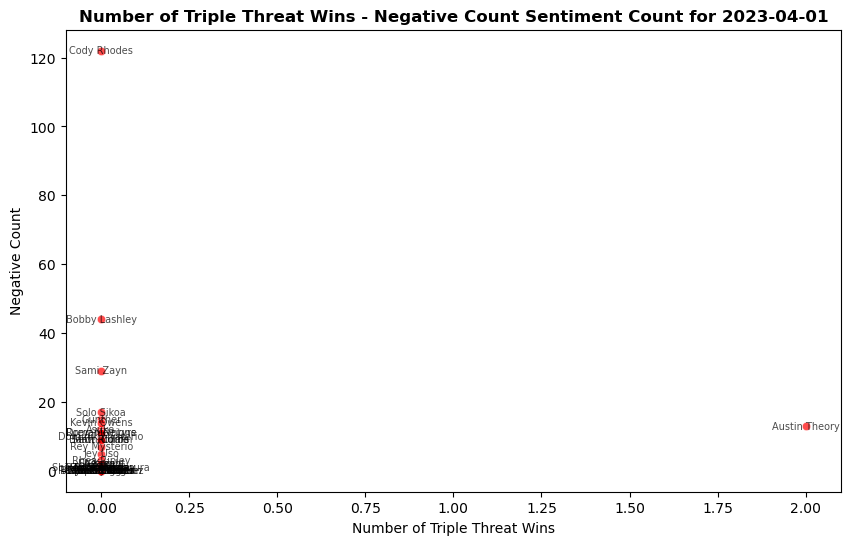

<Figure size 1000x600 with 0 Axes>

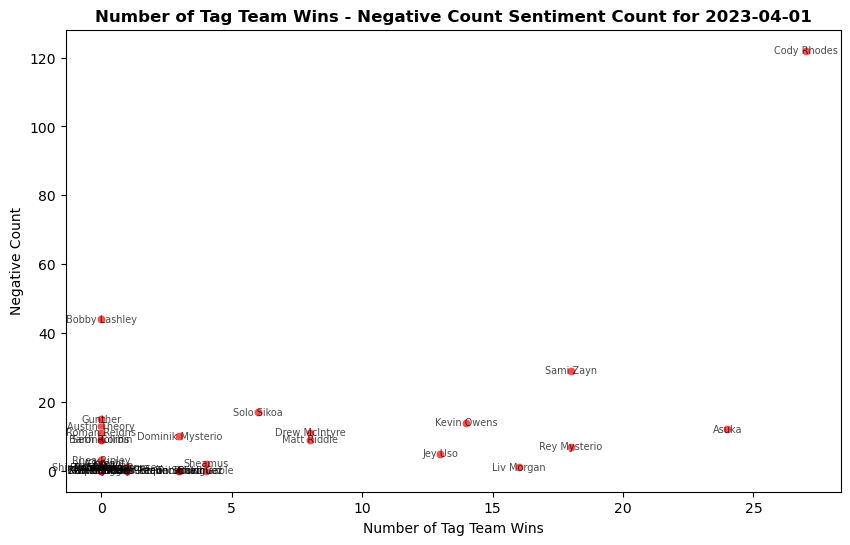

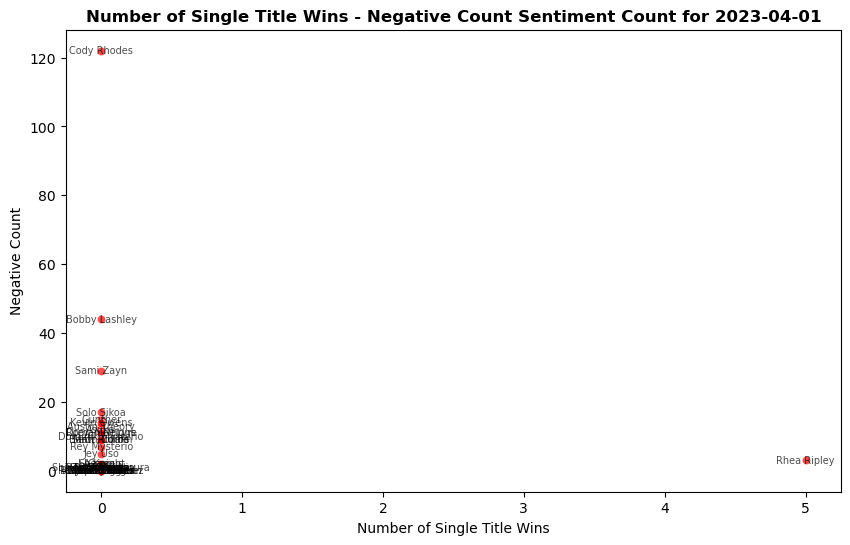

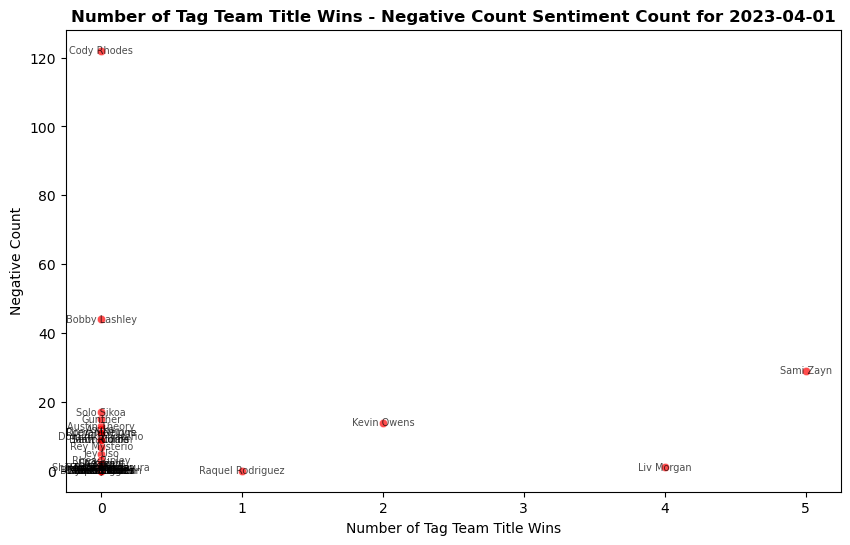

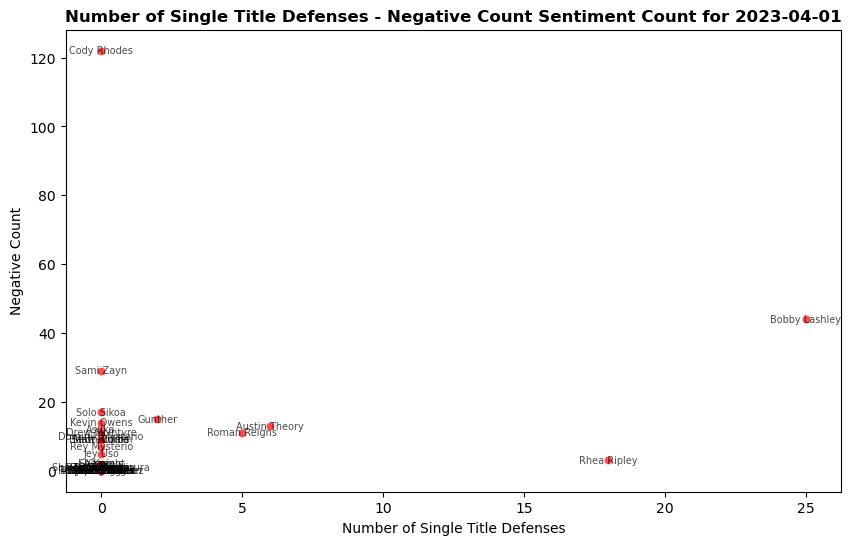

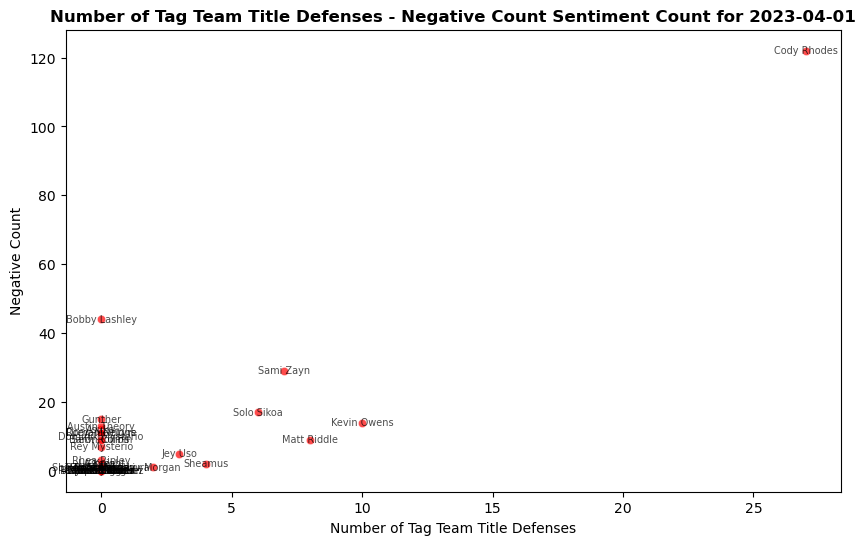

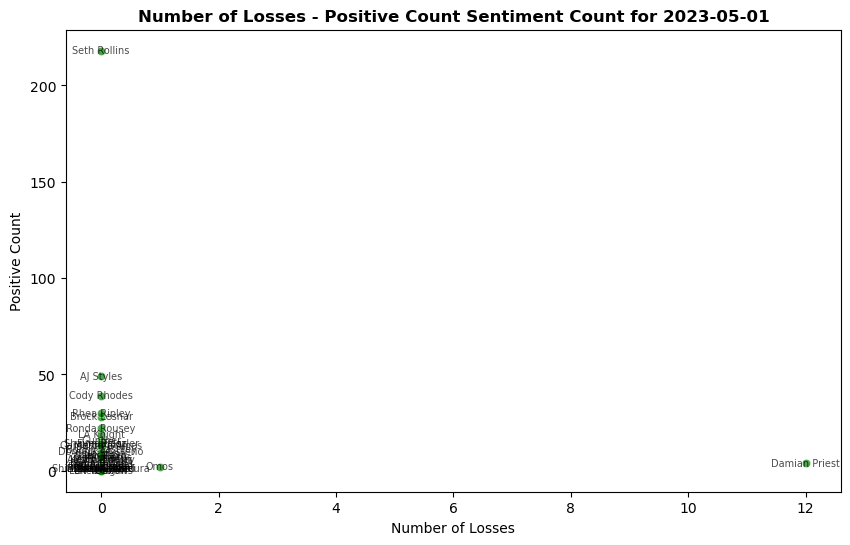

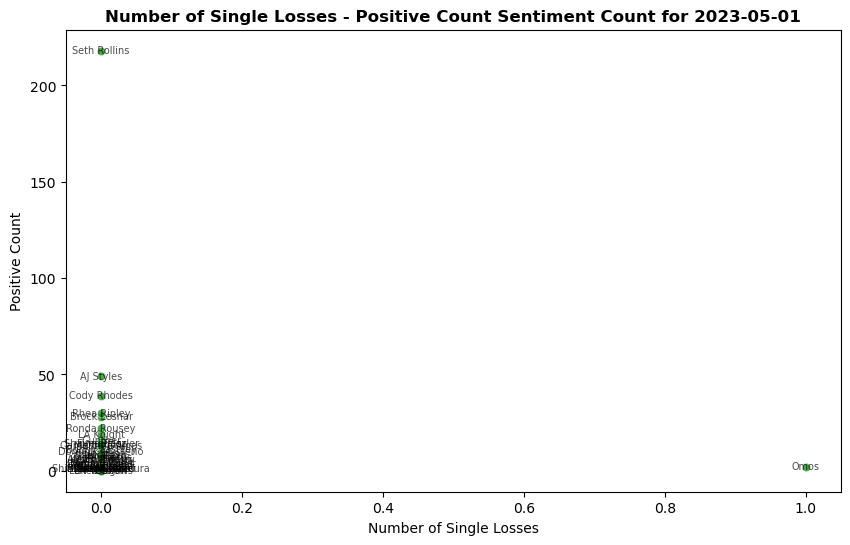

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

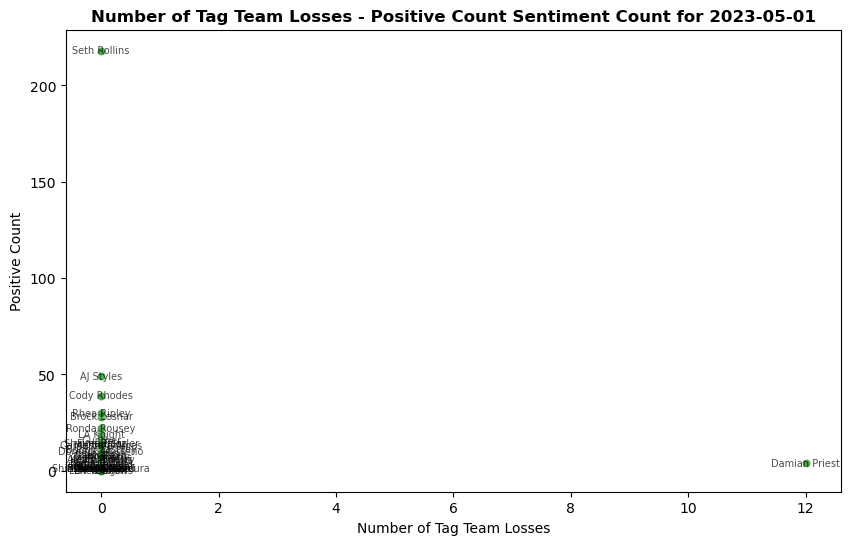

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

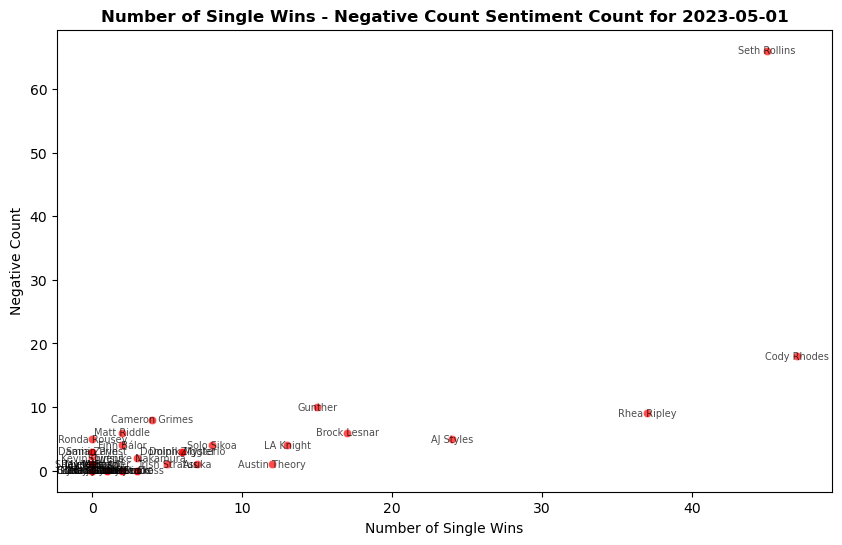

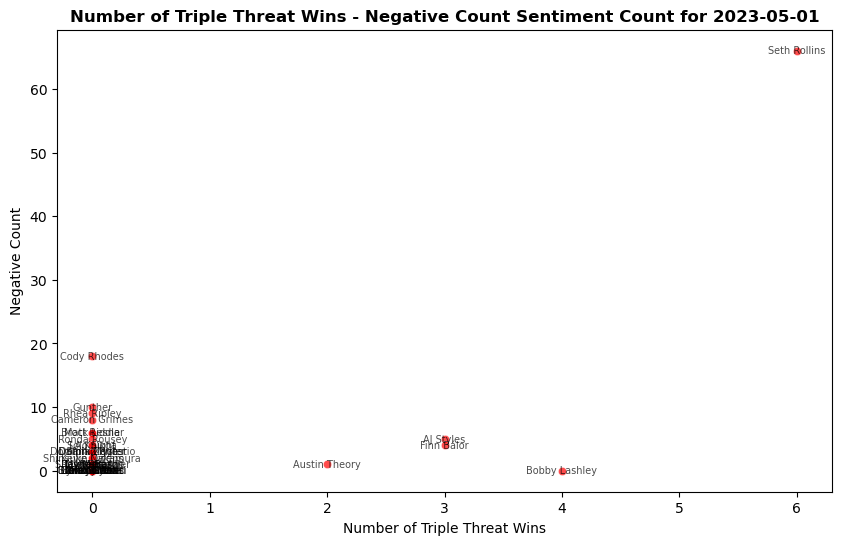

<Figure size 1000x600 with 0 Axes>

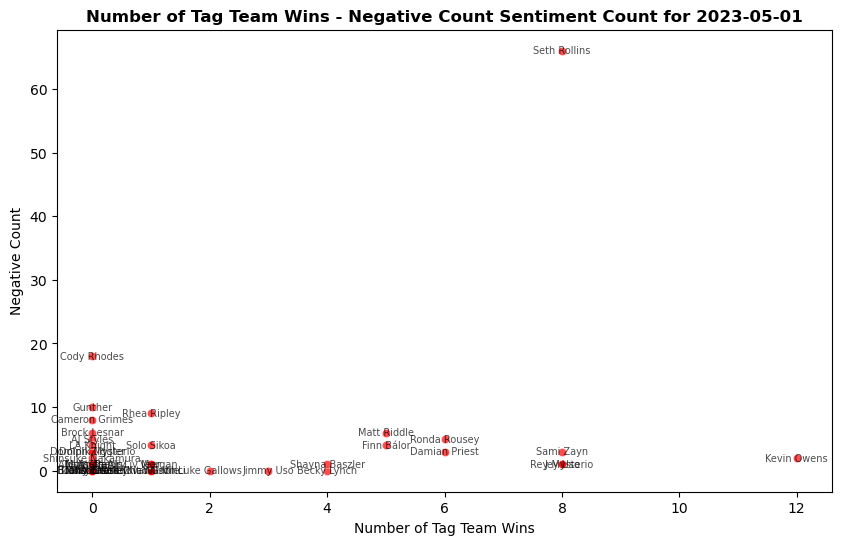

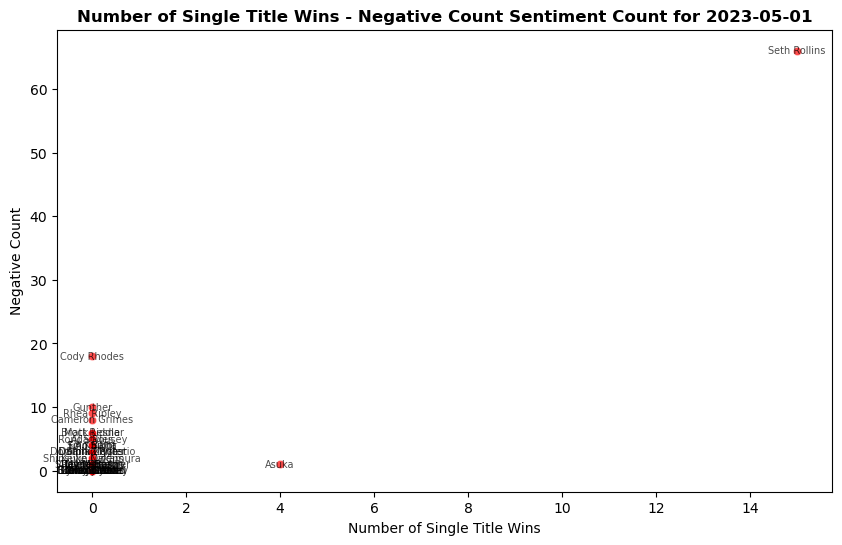

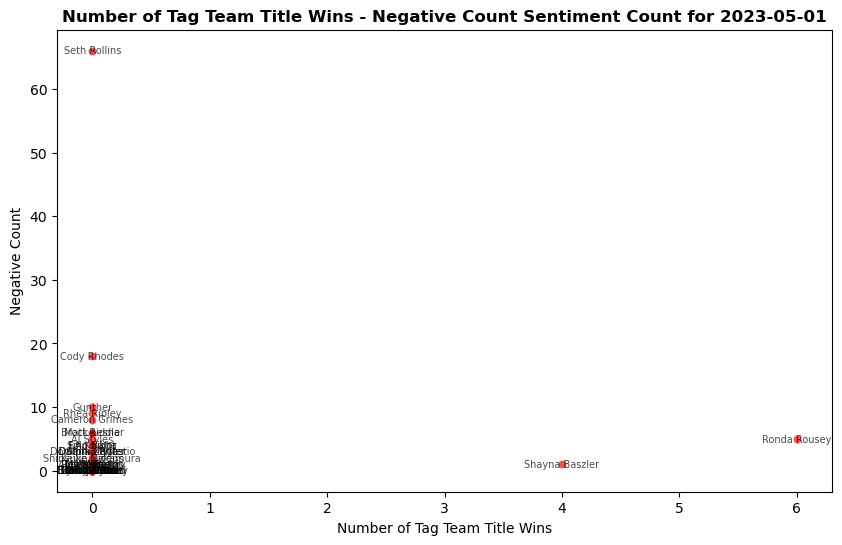

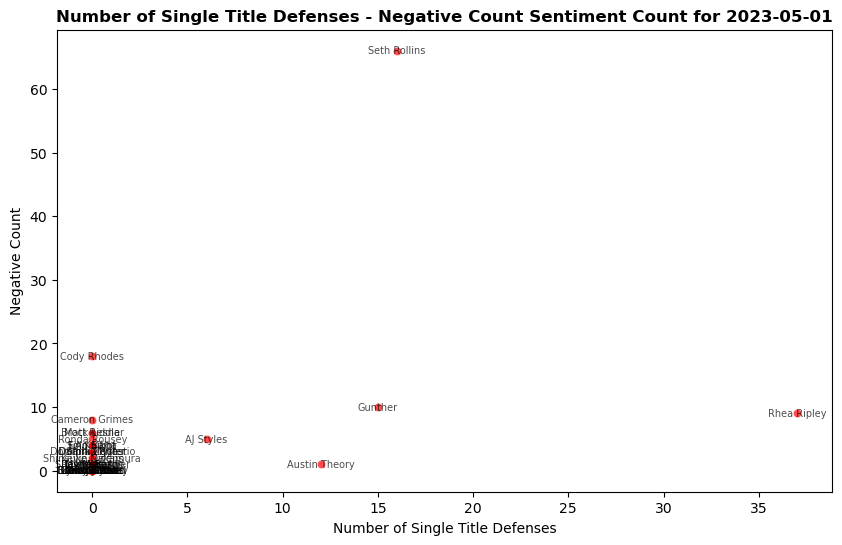

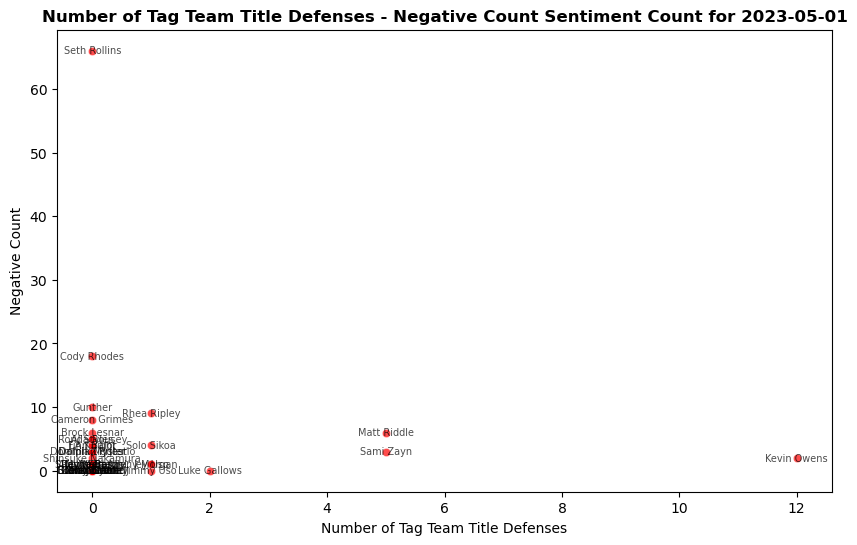

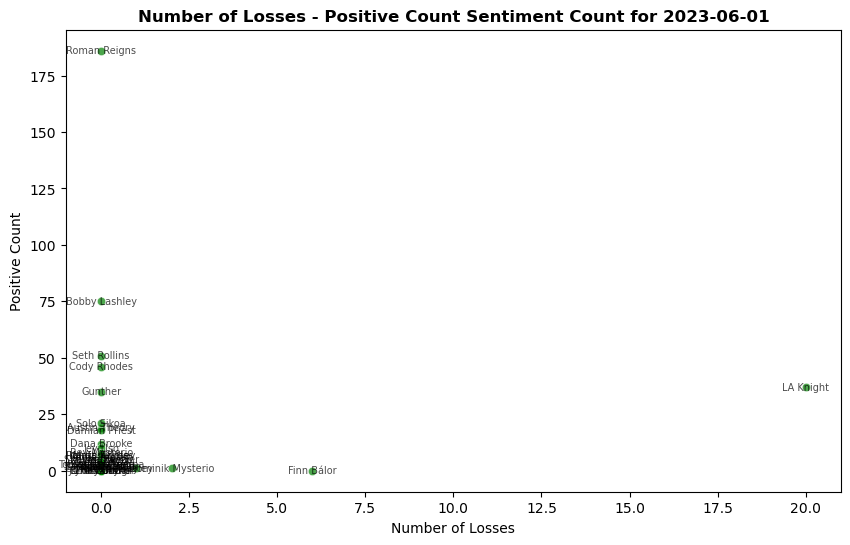

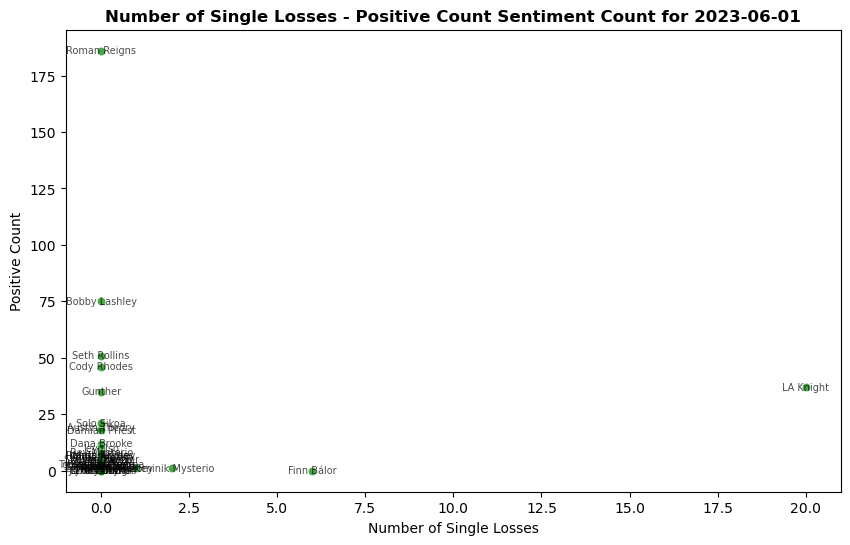

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

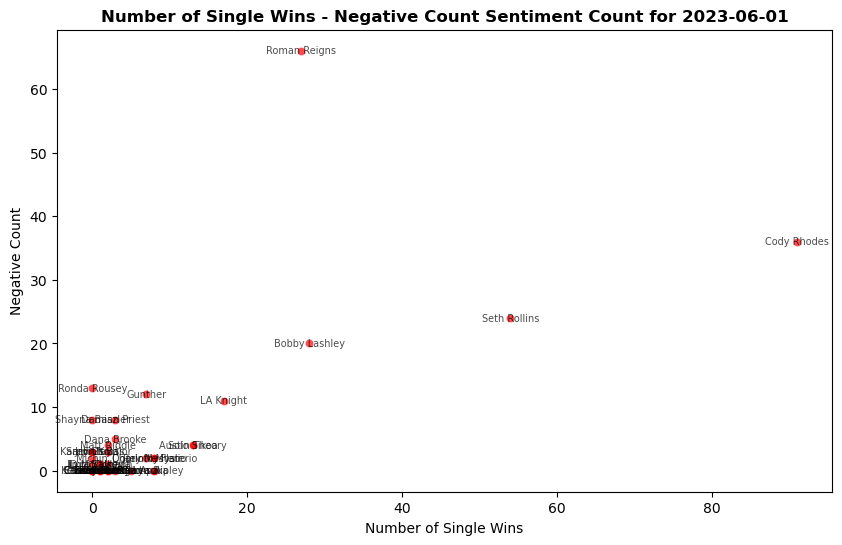

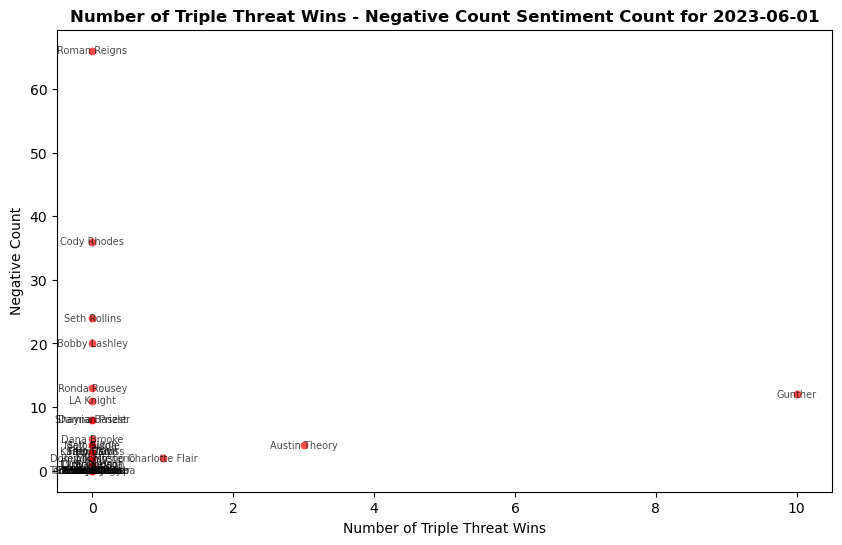

<Figure size 1000x600 with 0 Axes>

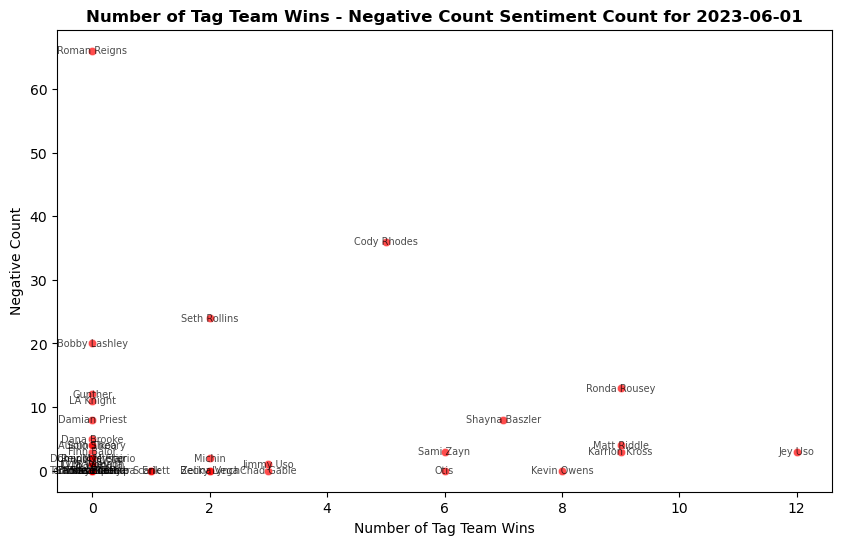

<Figure size 1000x600 with 0 Axes>

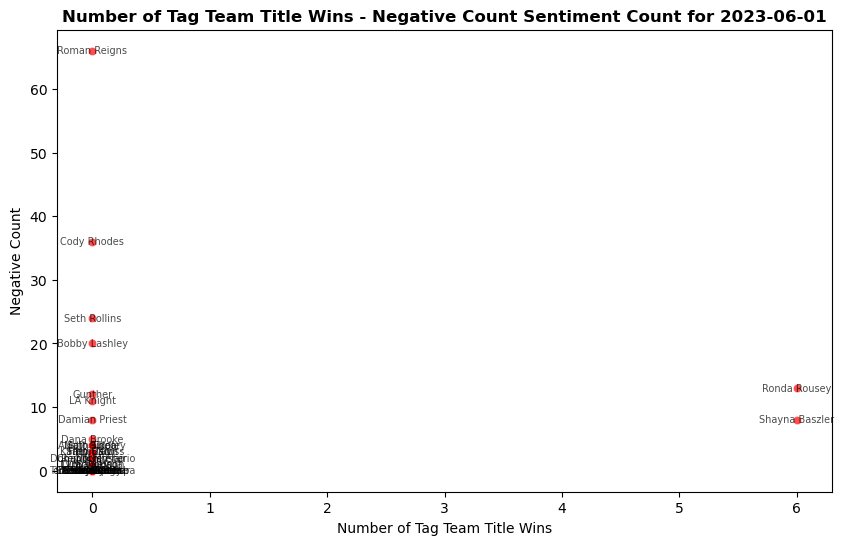

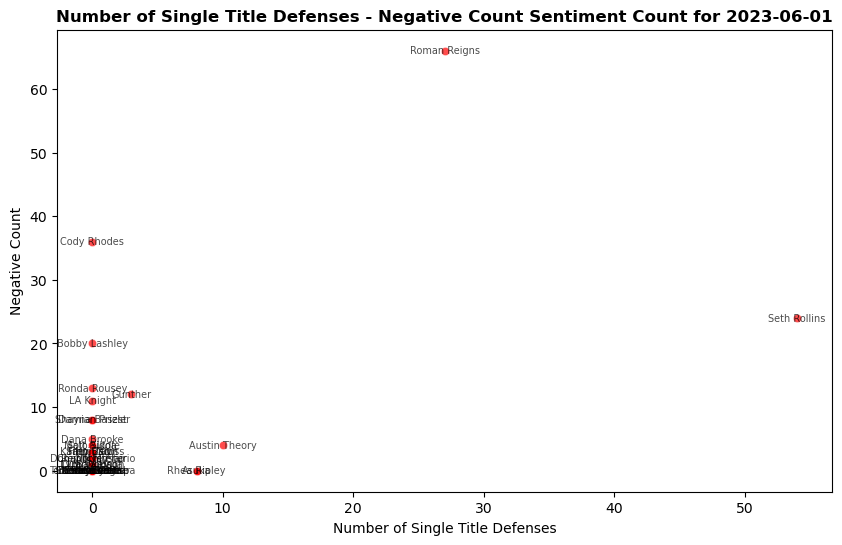

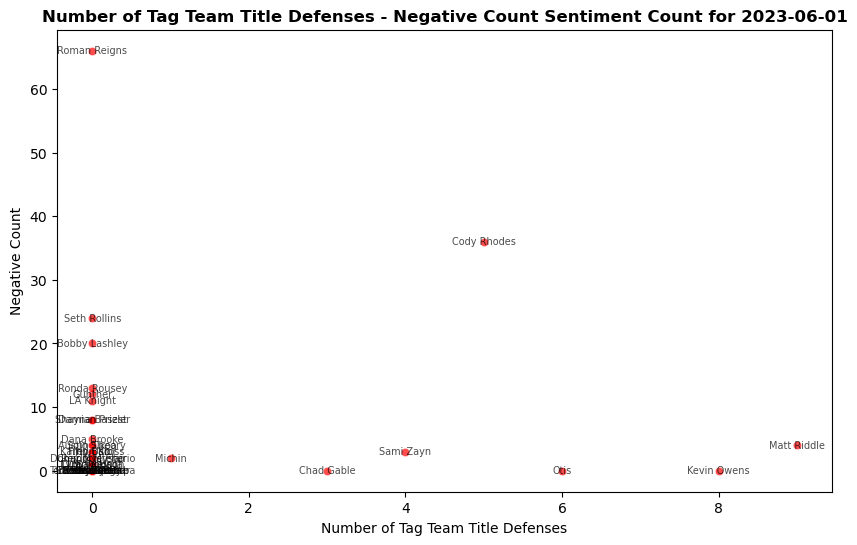

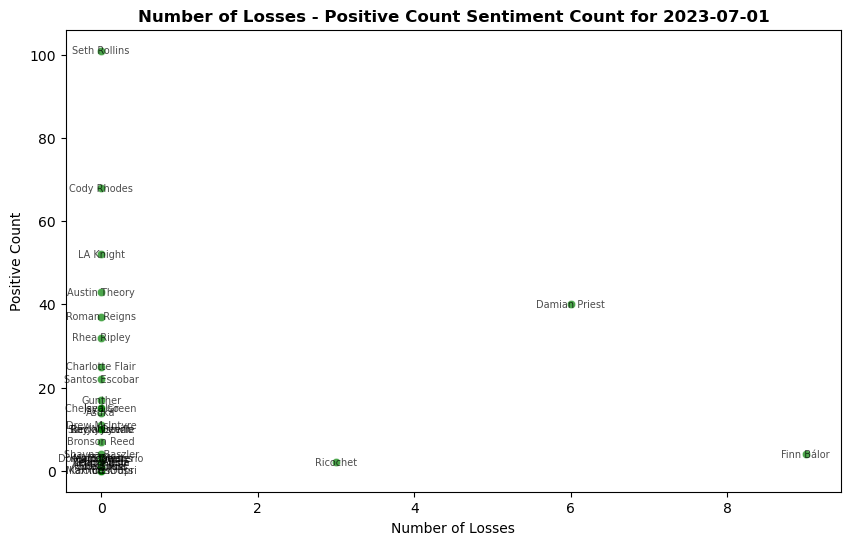

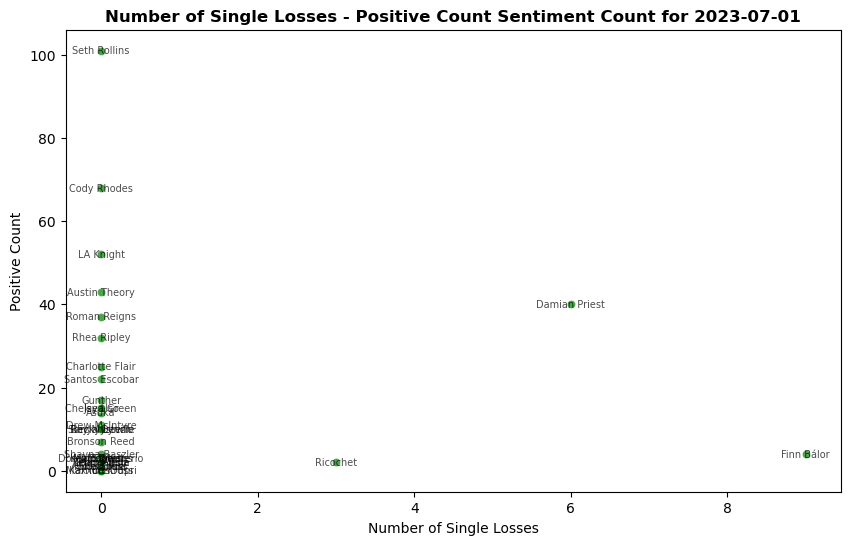

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

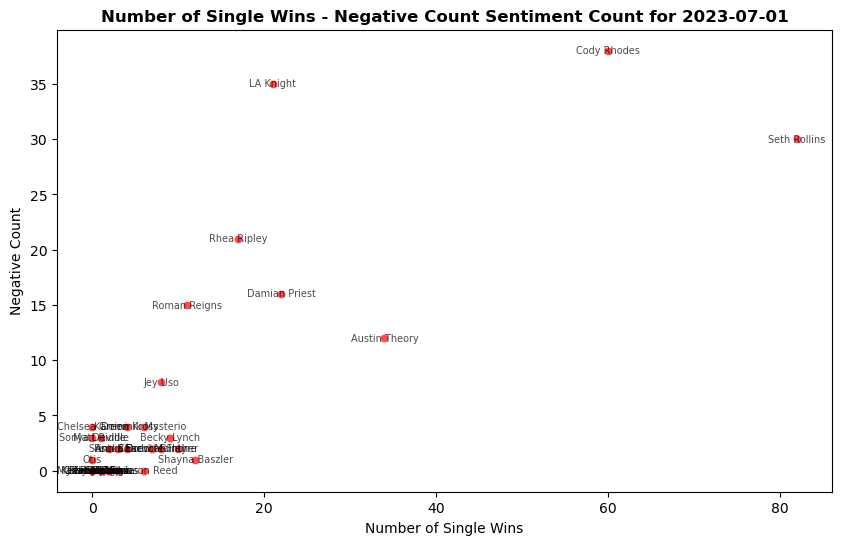

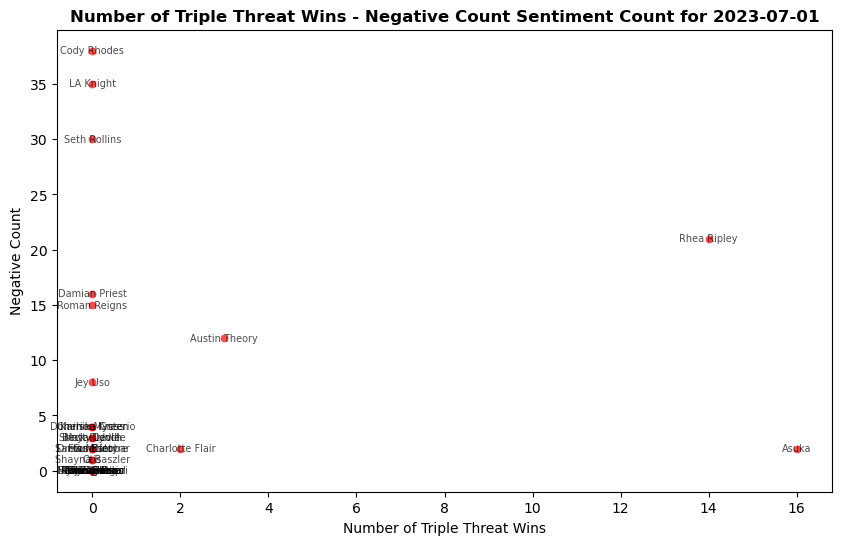

<Figure size 1000x600 with 0 Axes>

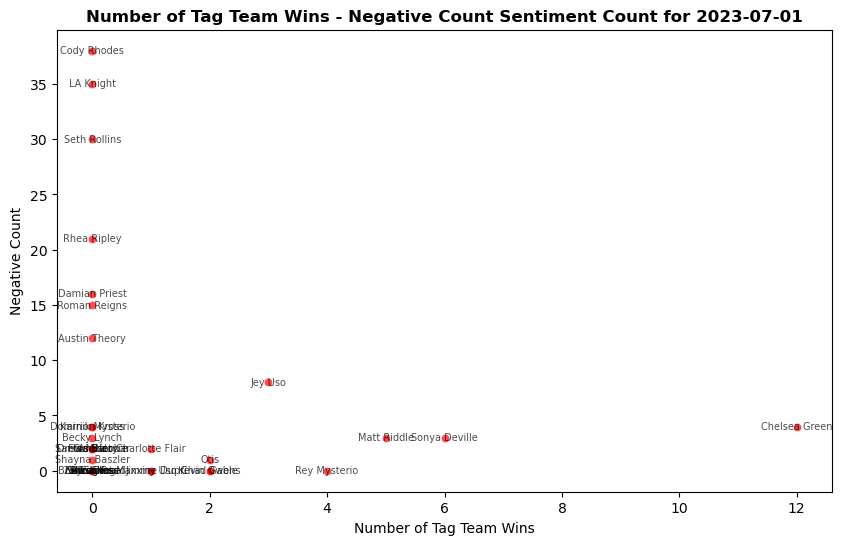

<Figure size 1000x600 with 0 Axes>

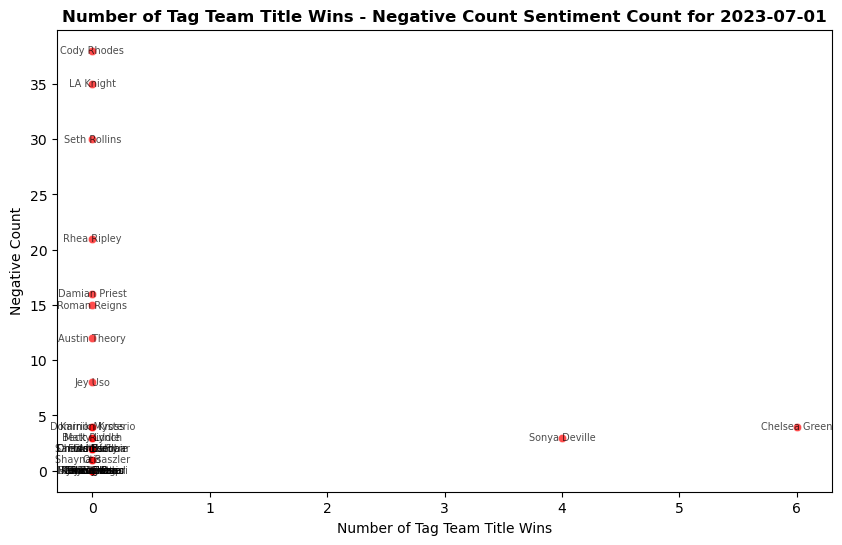

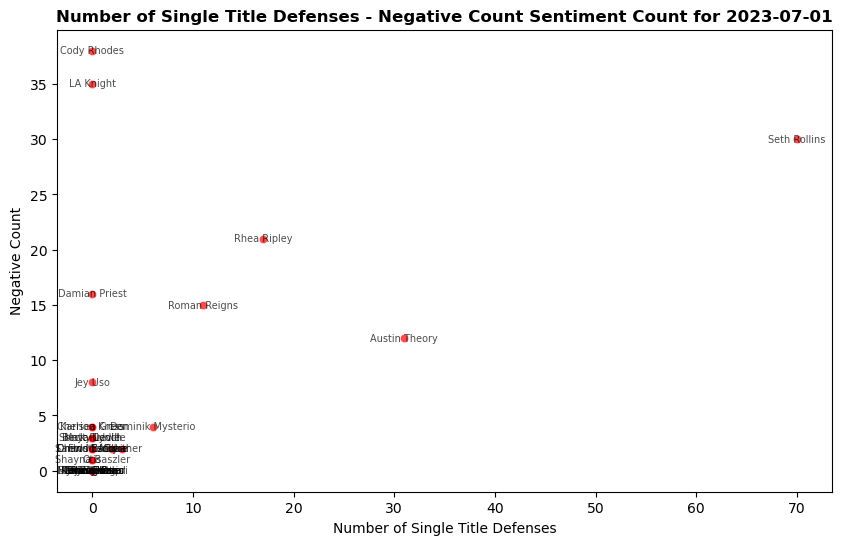

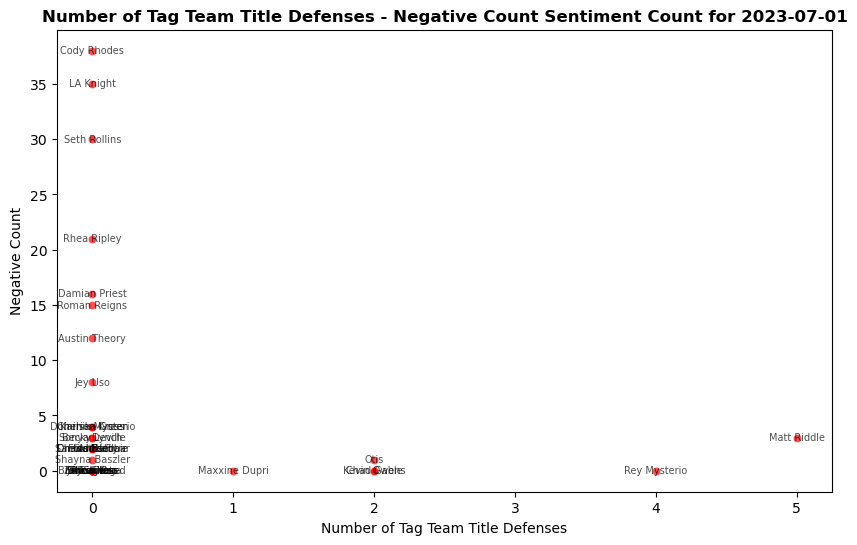

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

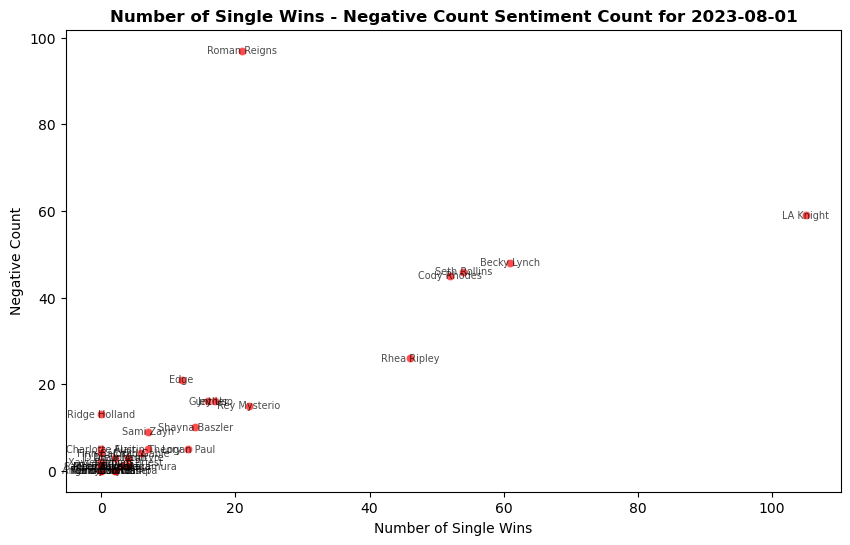

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

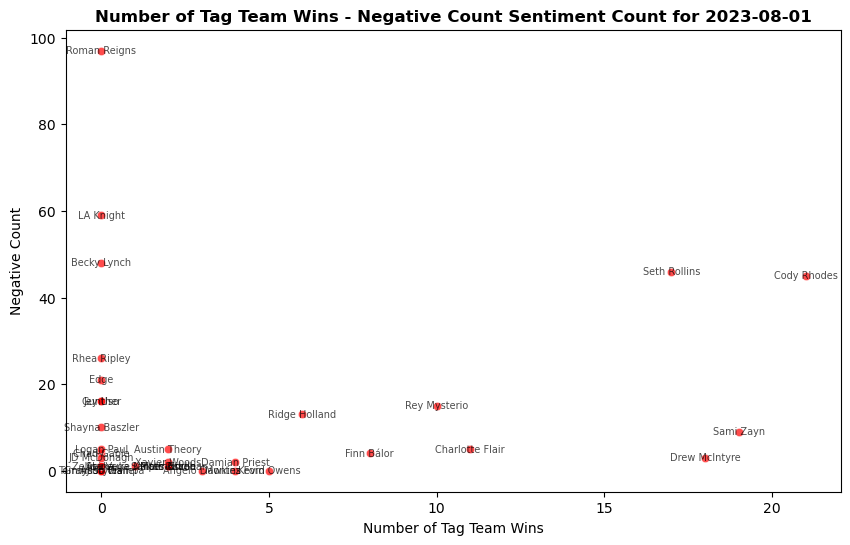

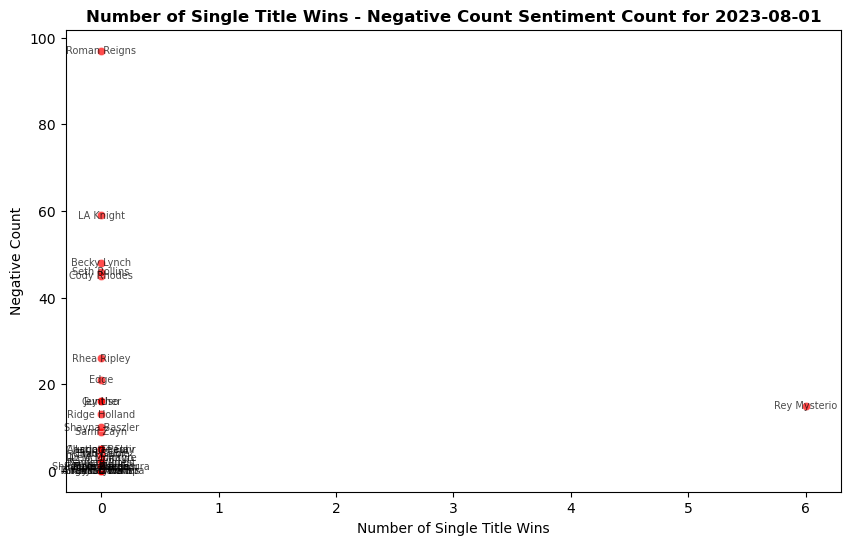

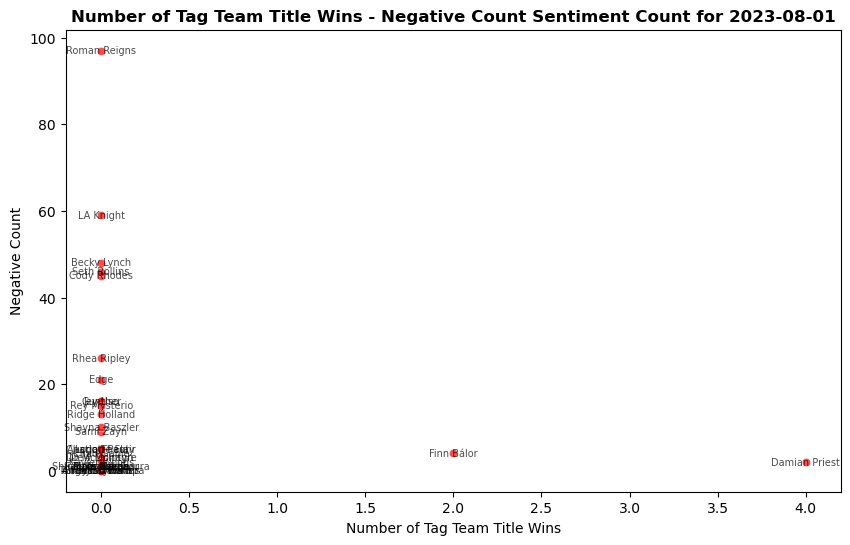

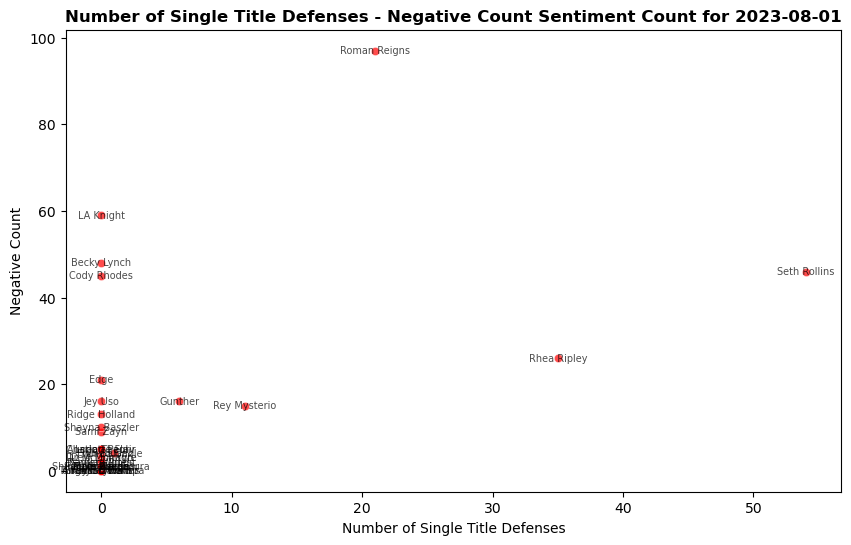

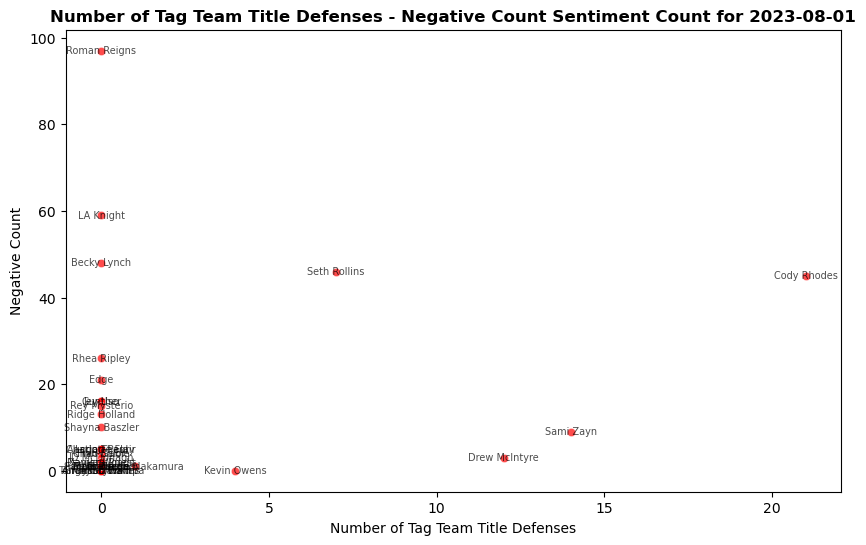

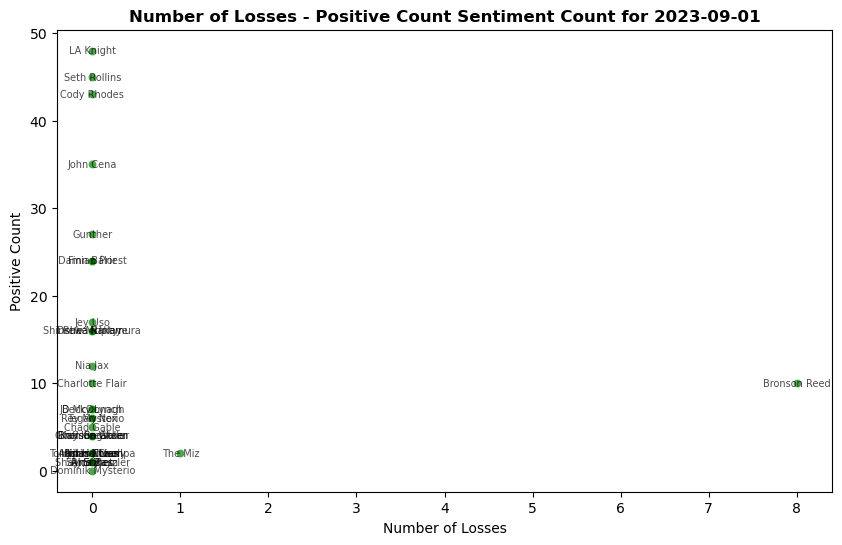

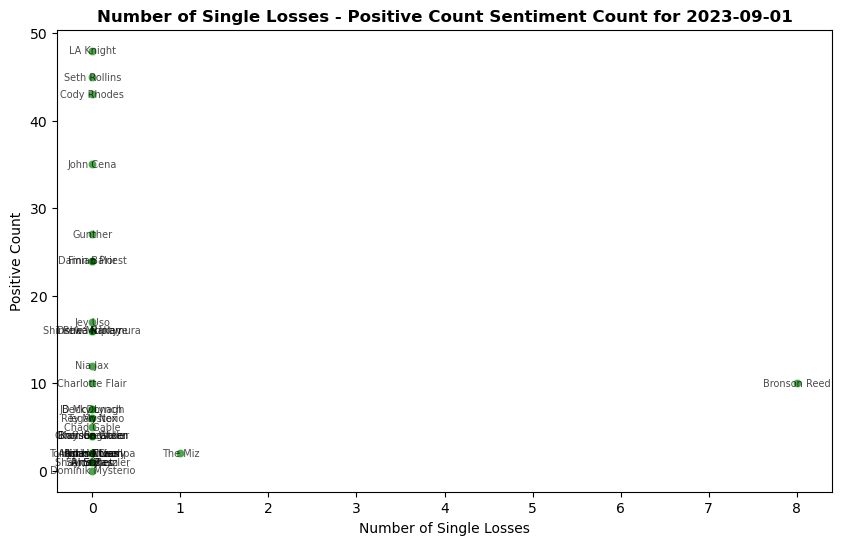

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

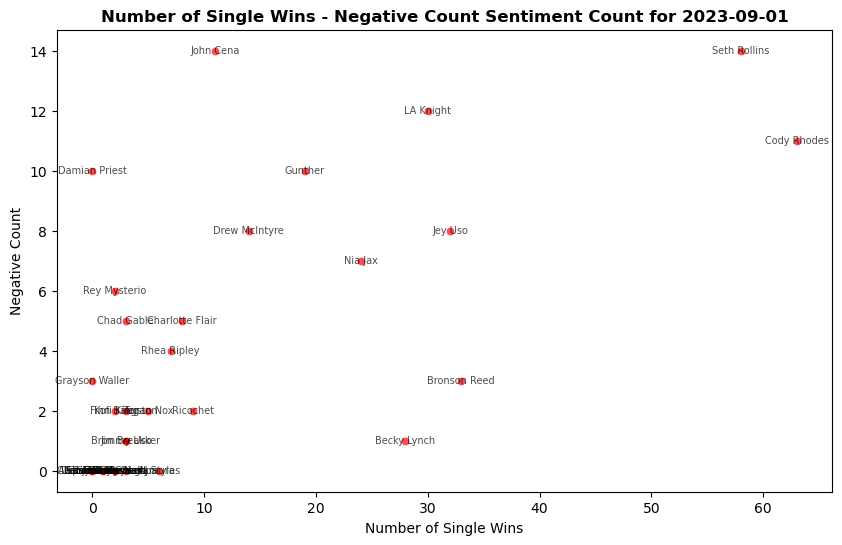

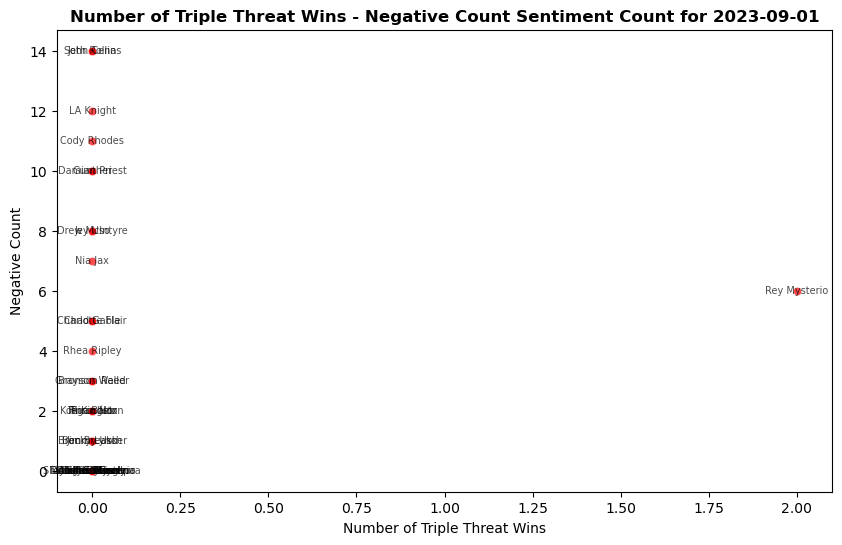

<Figure size 1000x600 with 0 Axes>

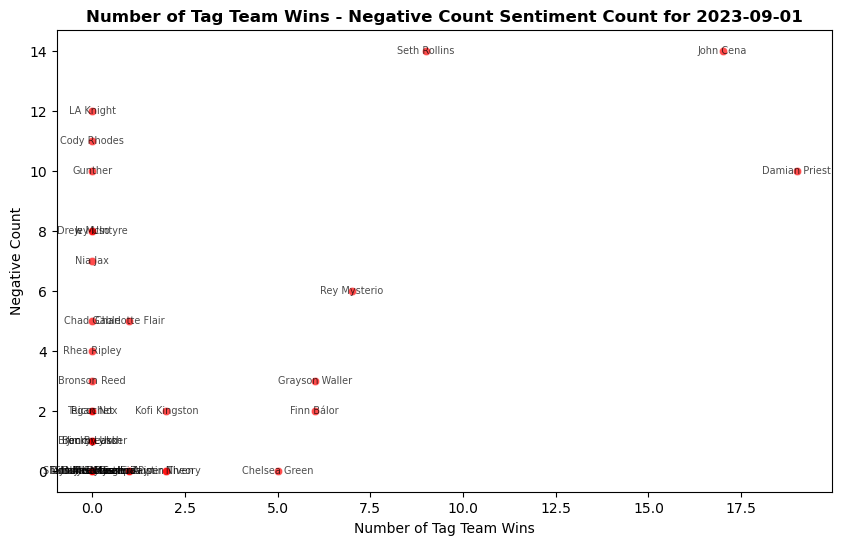

<Figure size 1000x600 with 0 Axes>

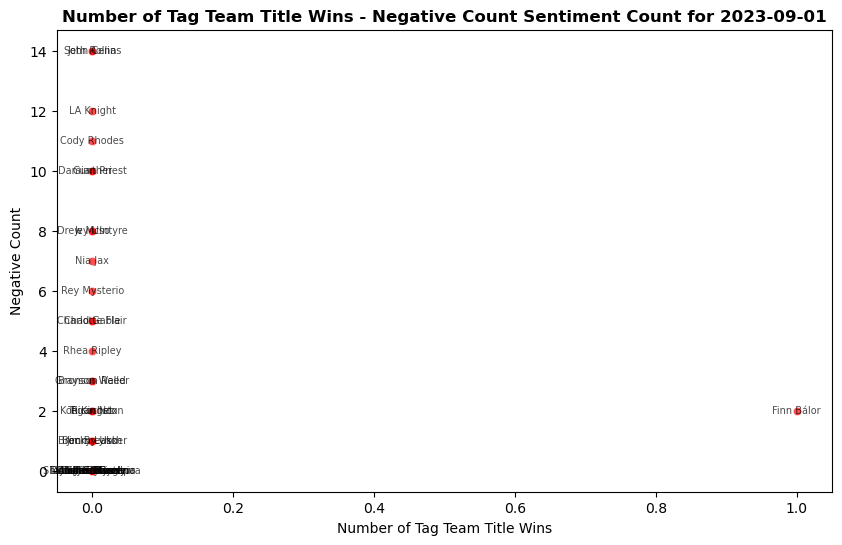

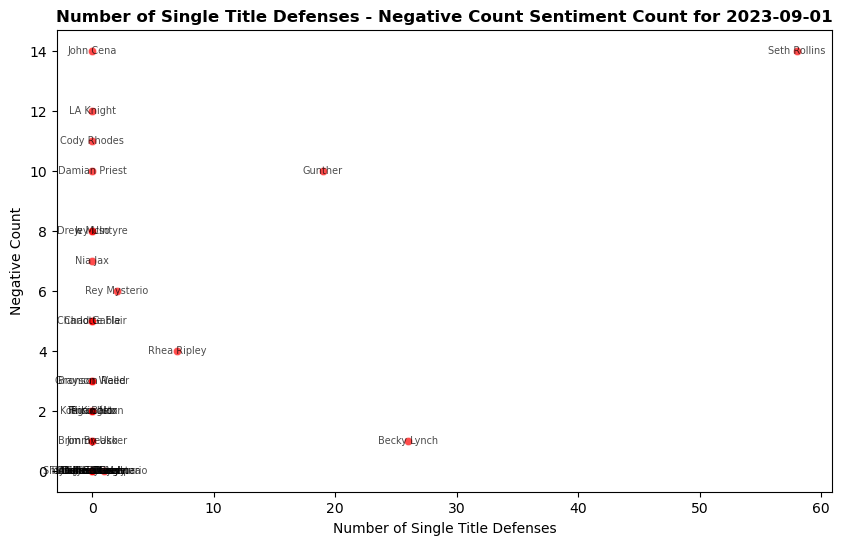

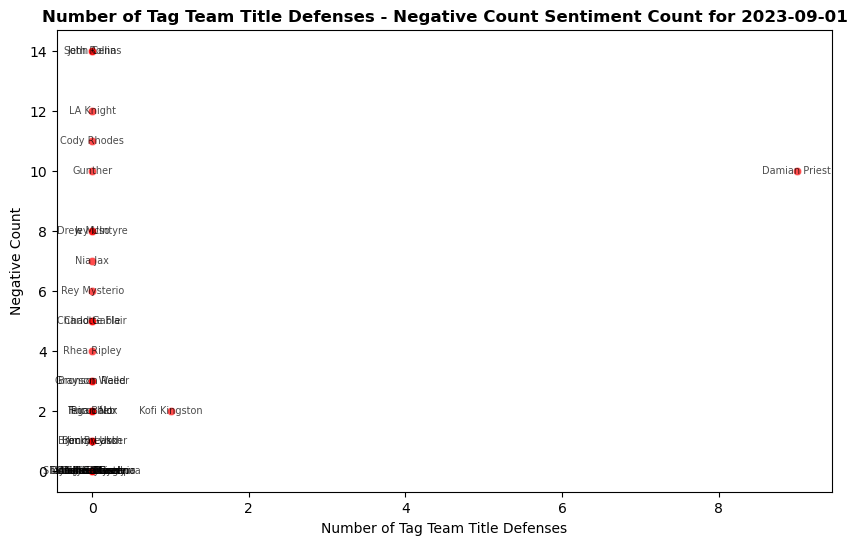

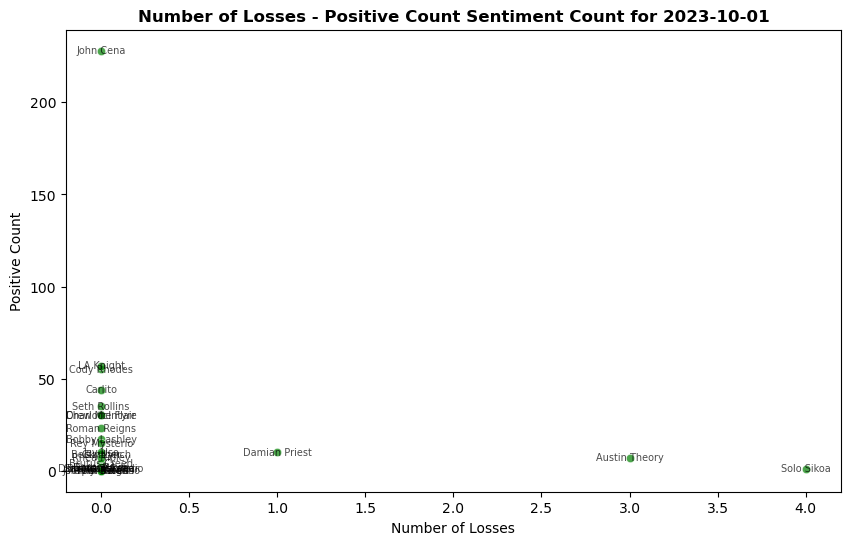

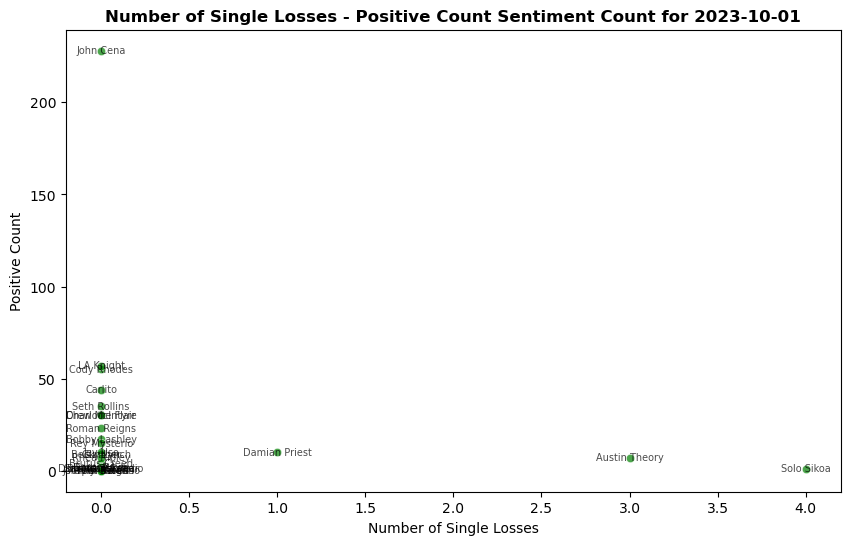

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

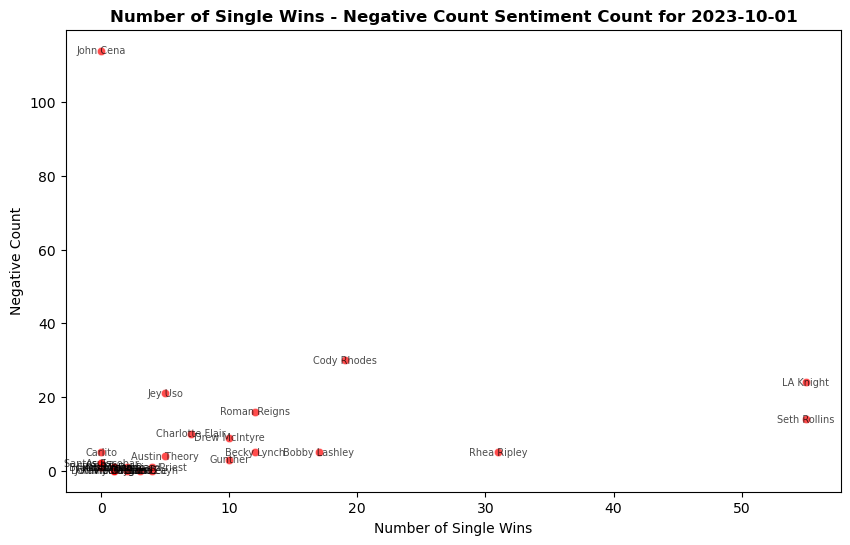

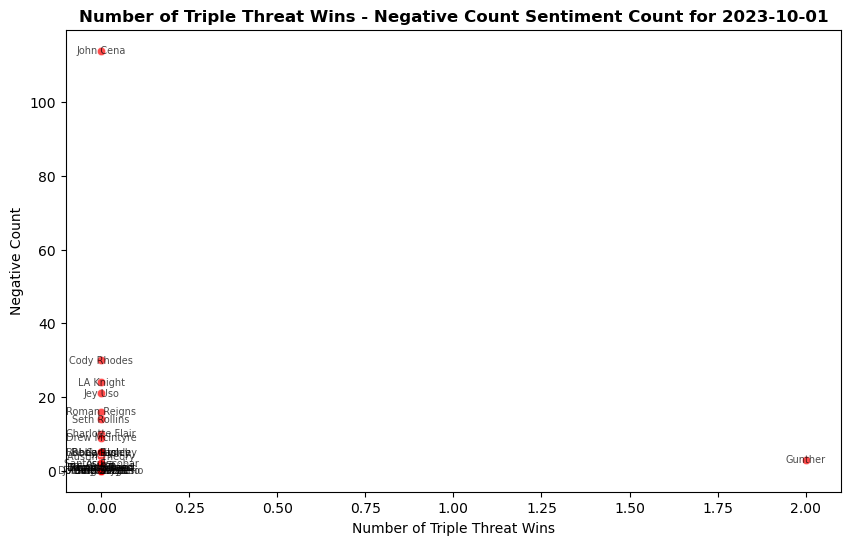

<Figure size 1000x600 with 0 Axes>

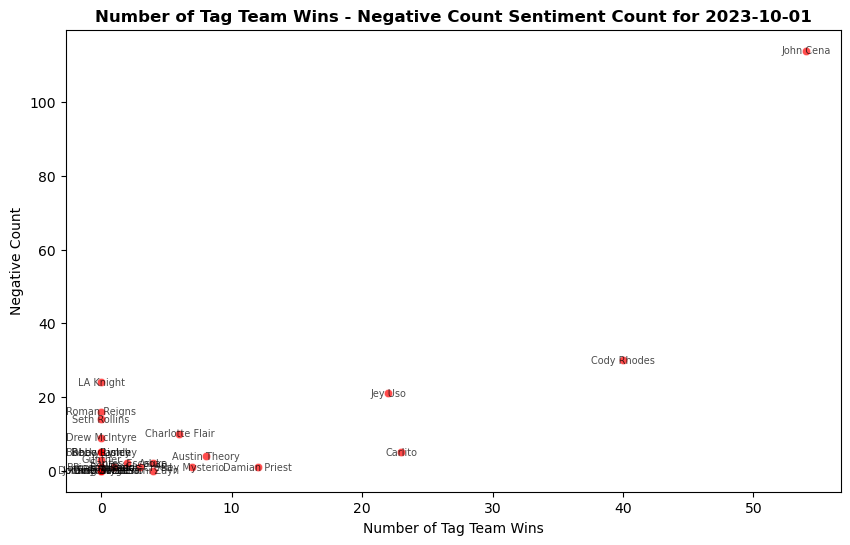

<Figure size 1000x600 with 0 Axes>

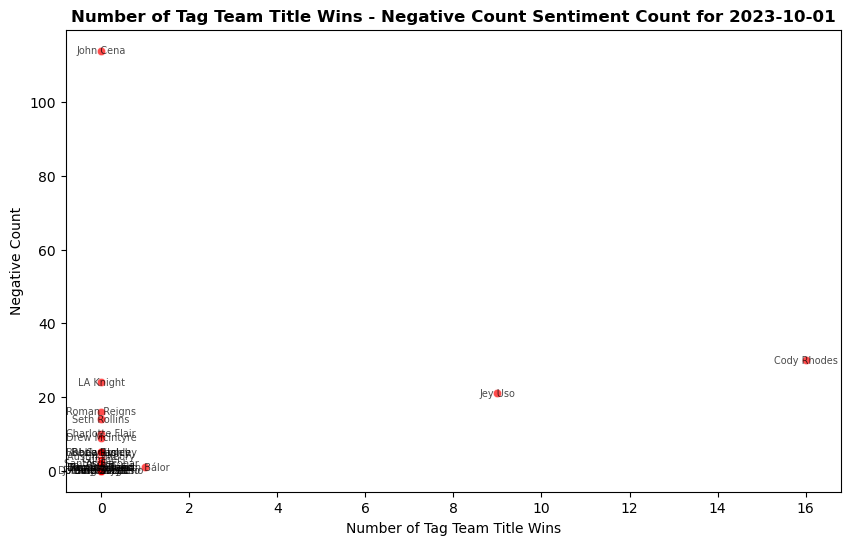

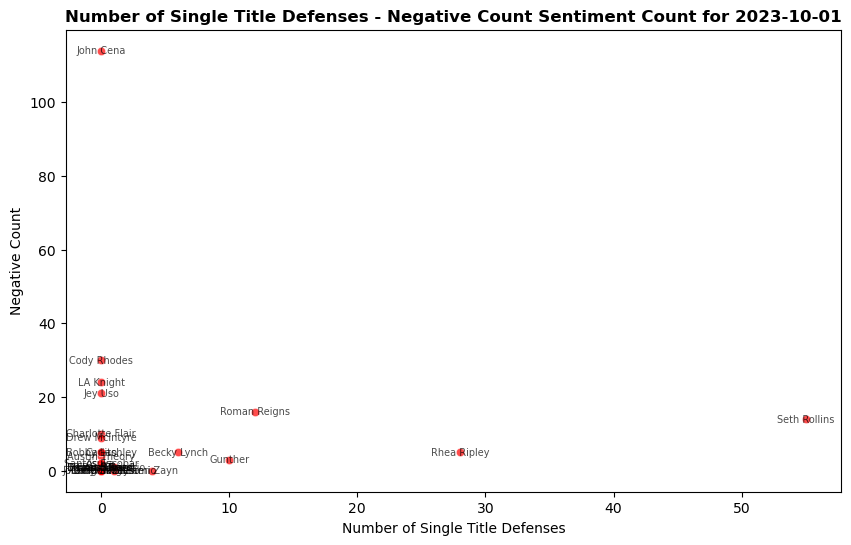

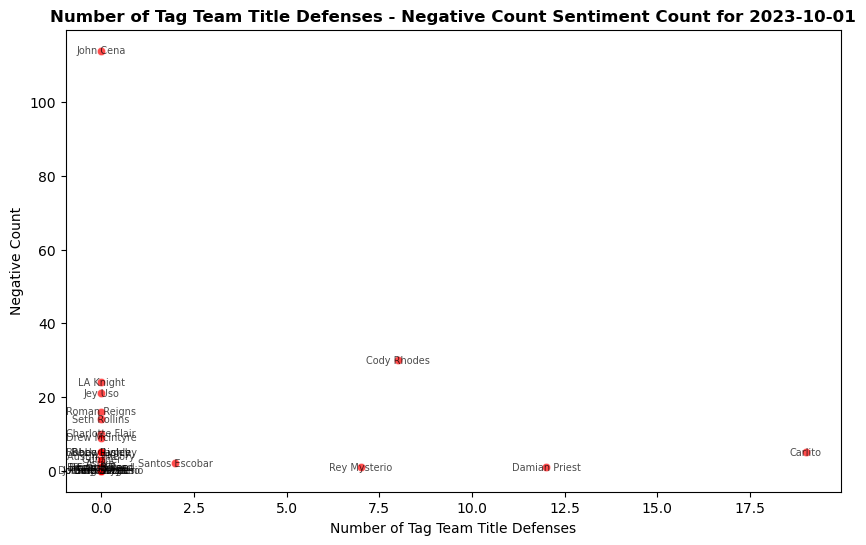

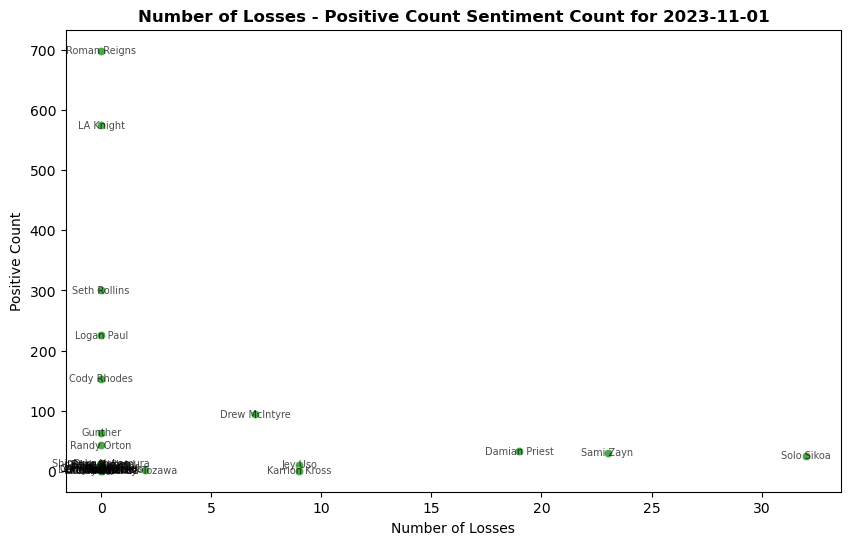

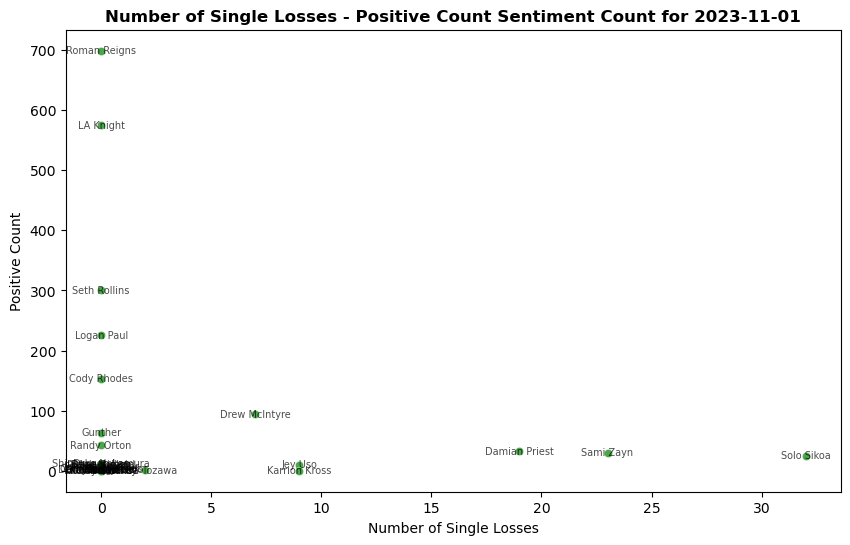

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

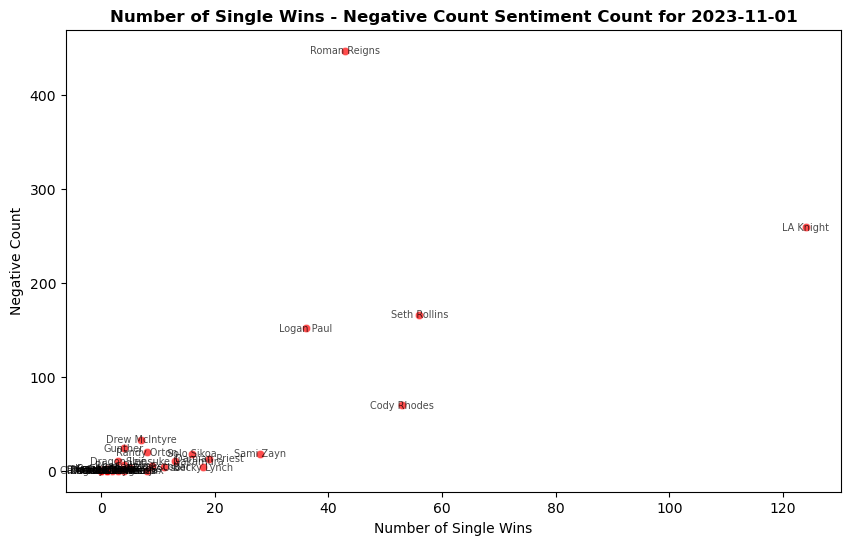

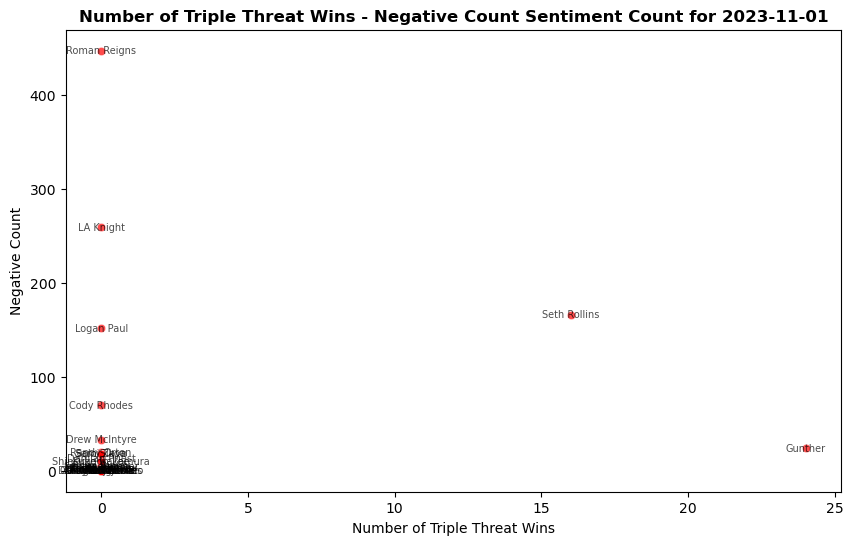

<Figure size 1000x600 with 0 Axes>

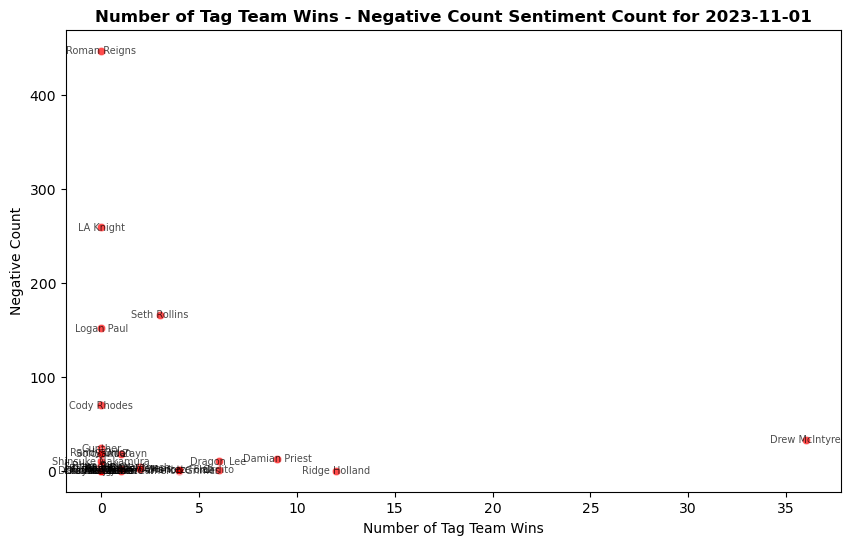

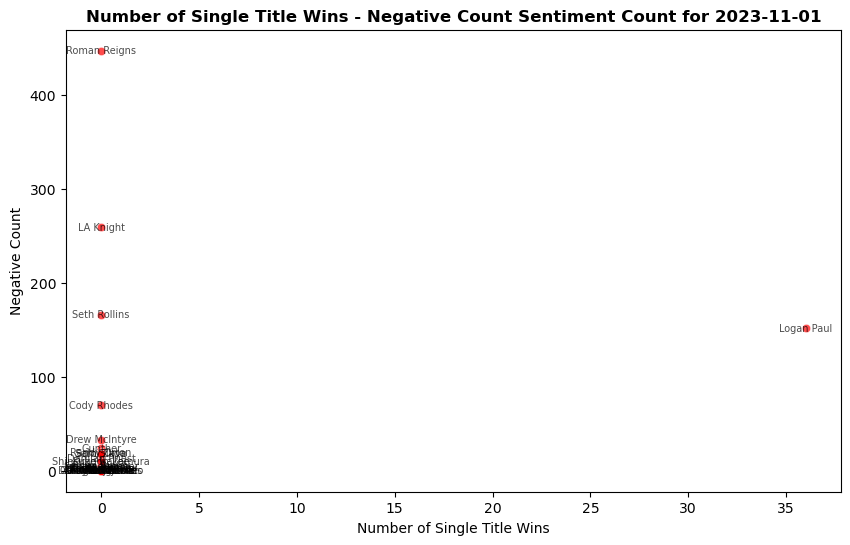

<Figure size 1000x600 with 0 Axes>

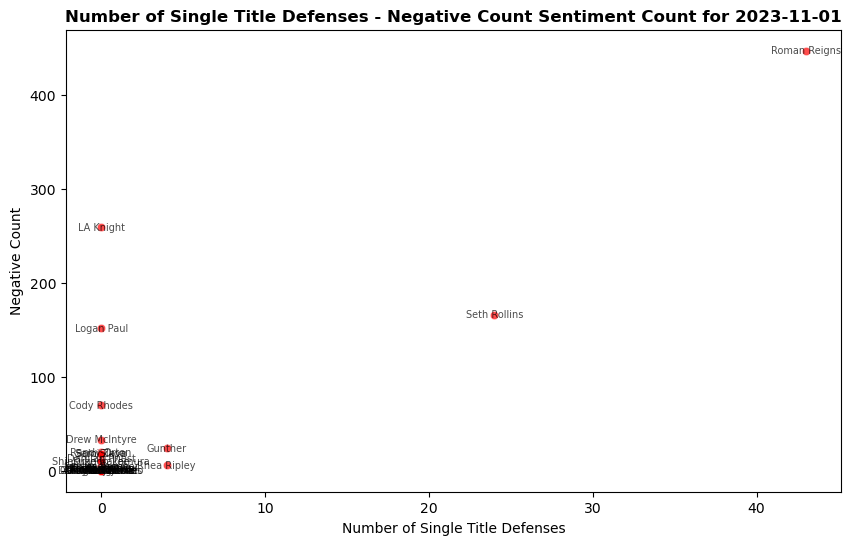

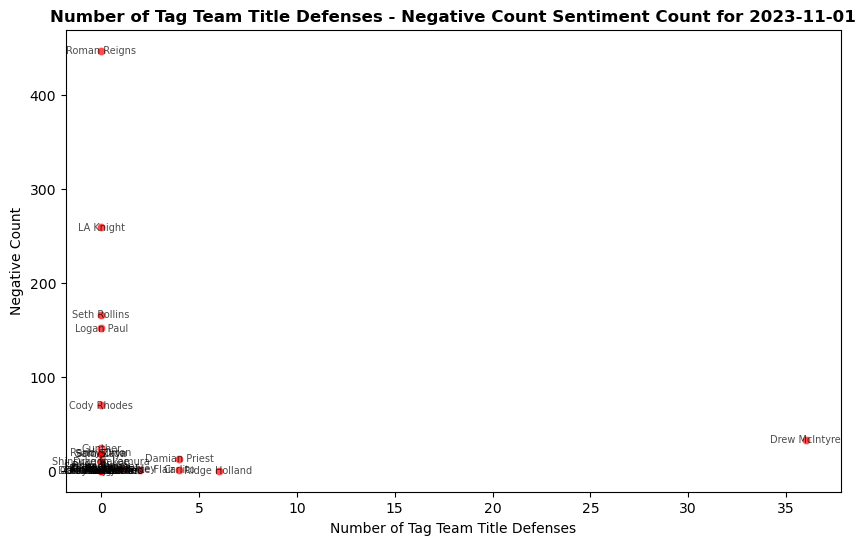

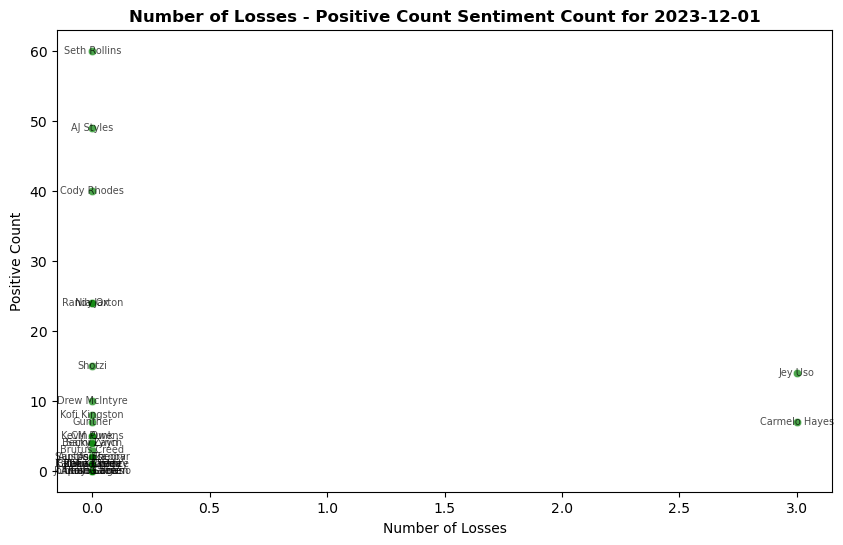

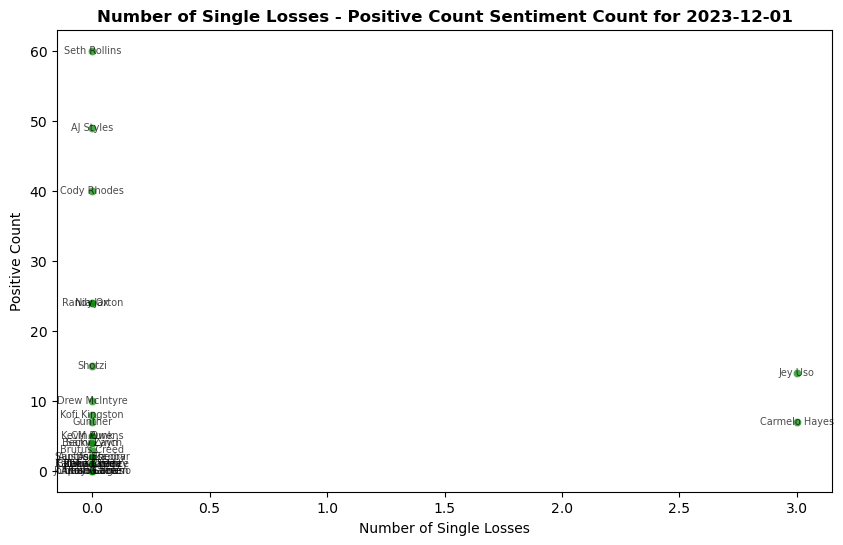

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

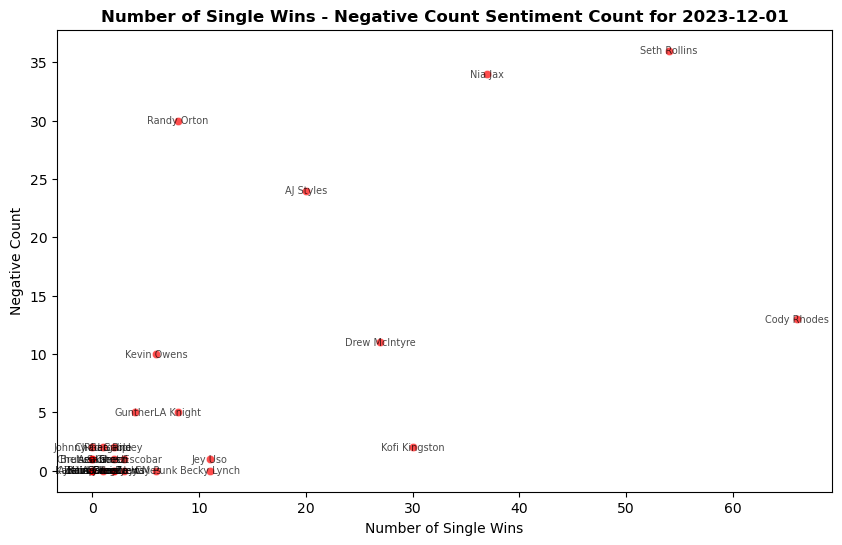

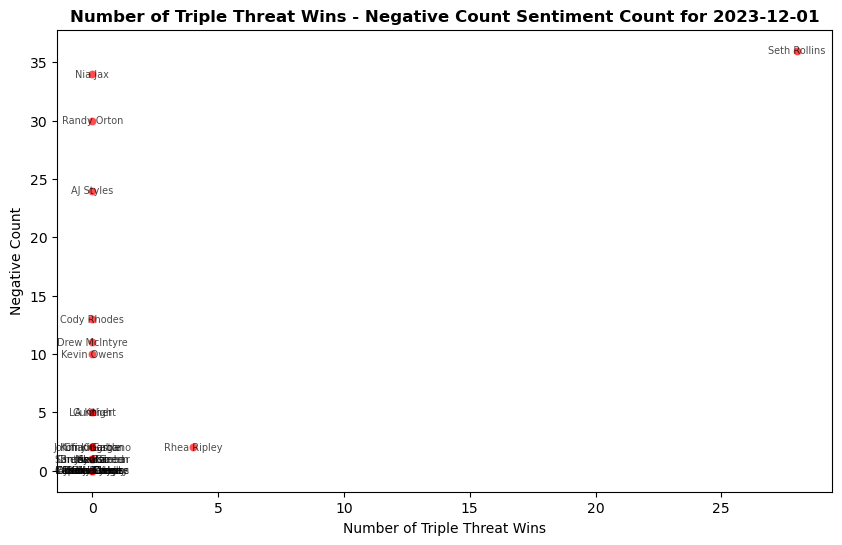

<Figure size 1000x600 with 0 Axes>

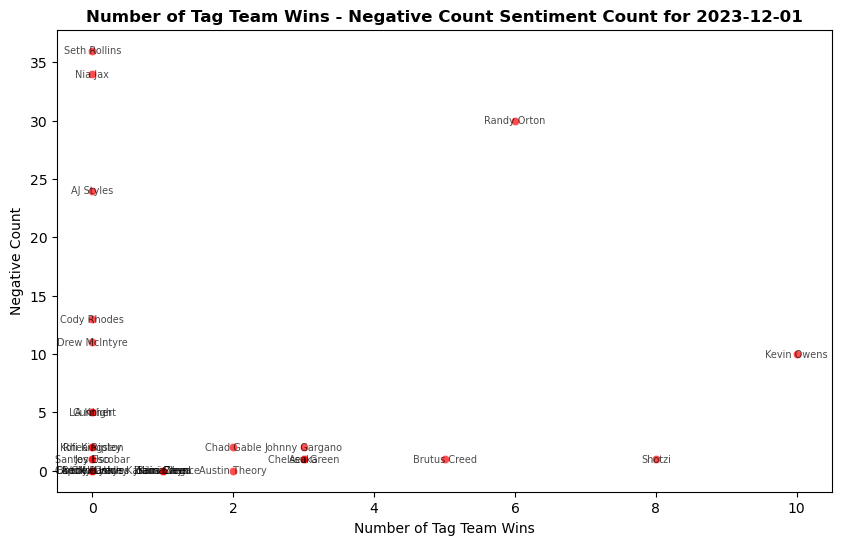

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

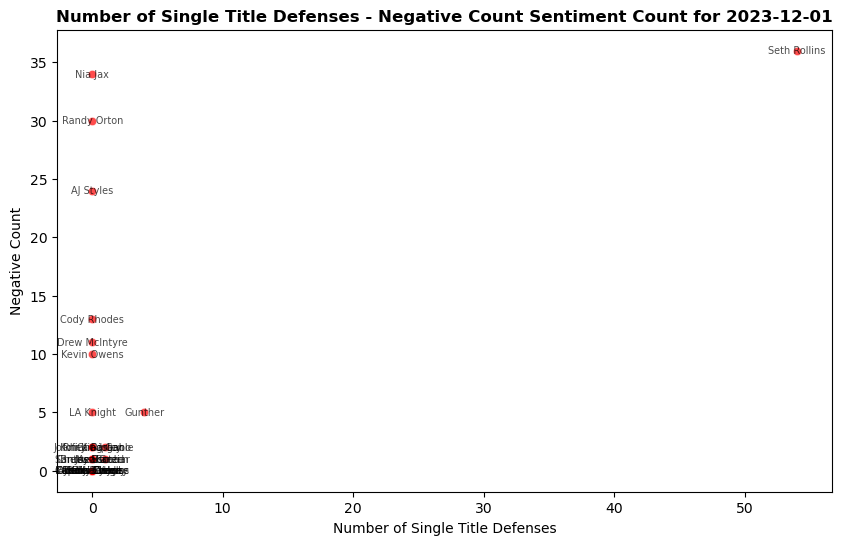

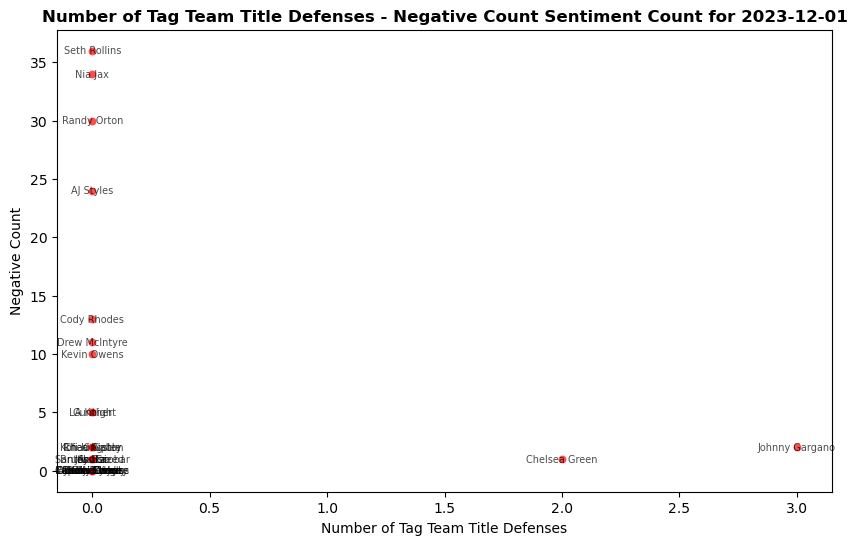

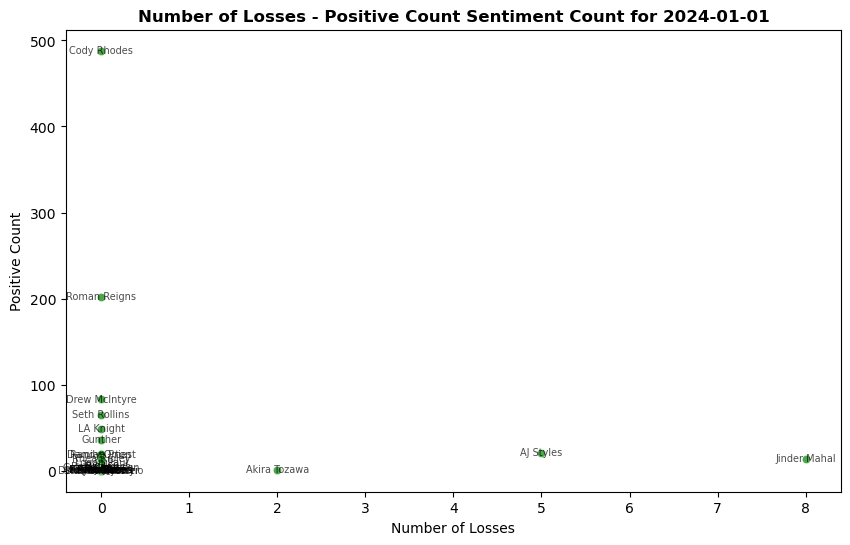

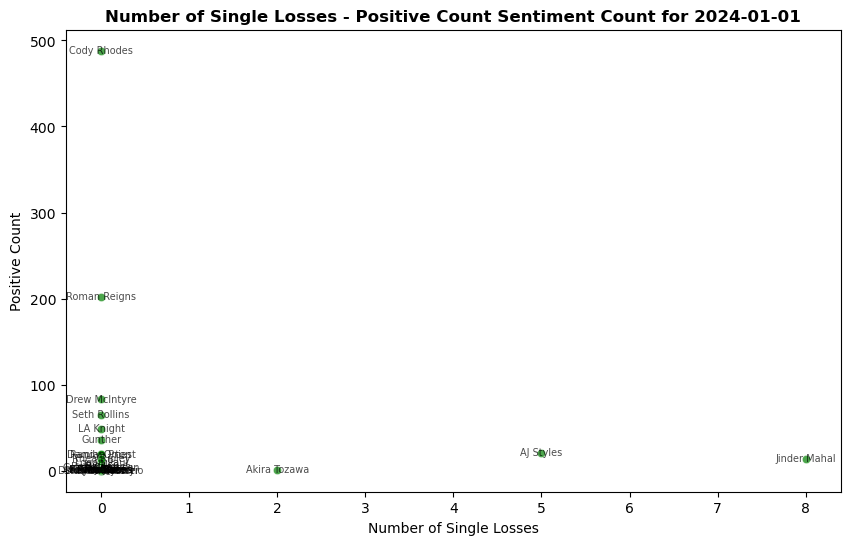

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

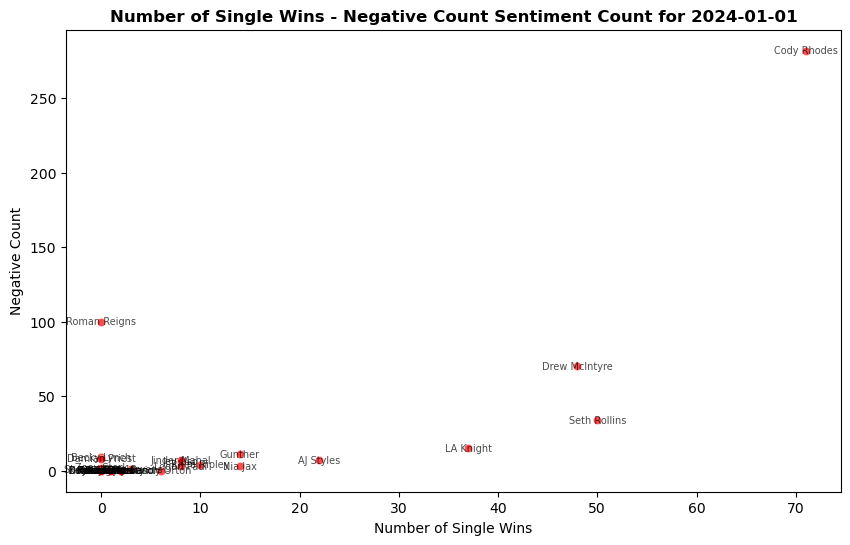

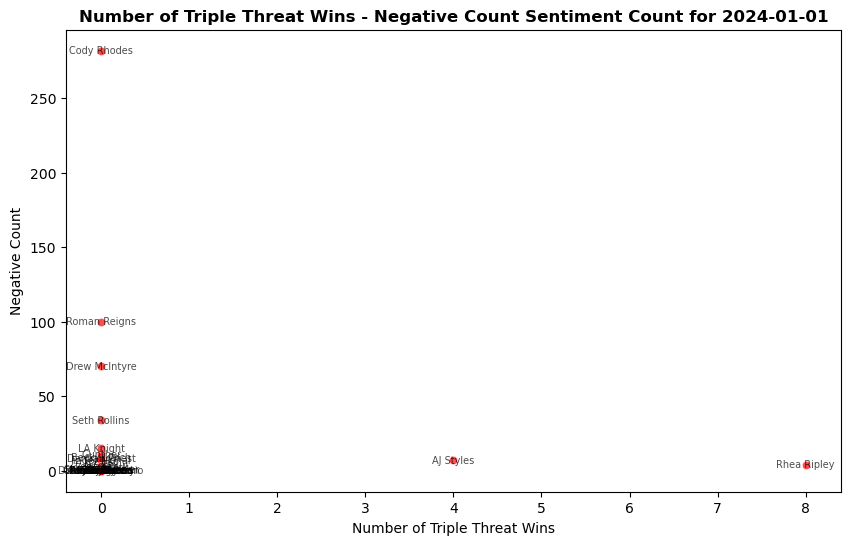

<Figure size 1000x600 with 0 Axes>

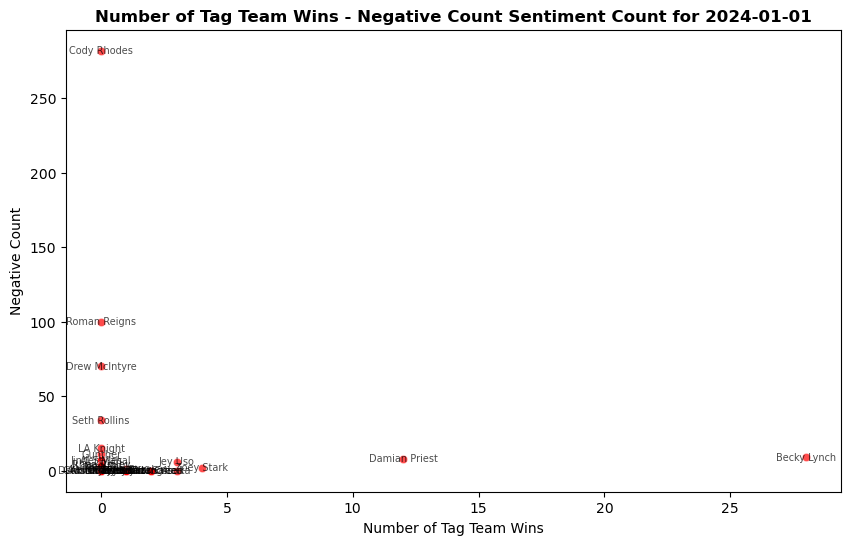

<Figure size 1000x600 with 0 Axes>

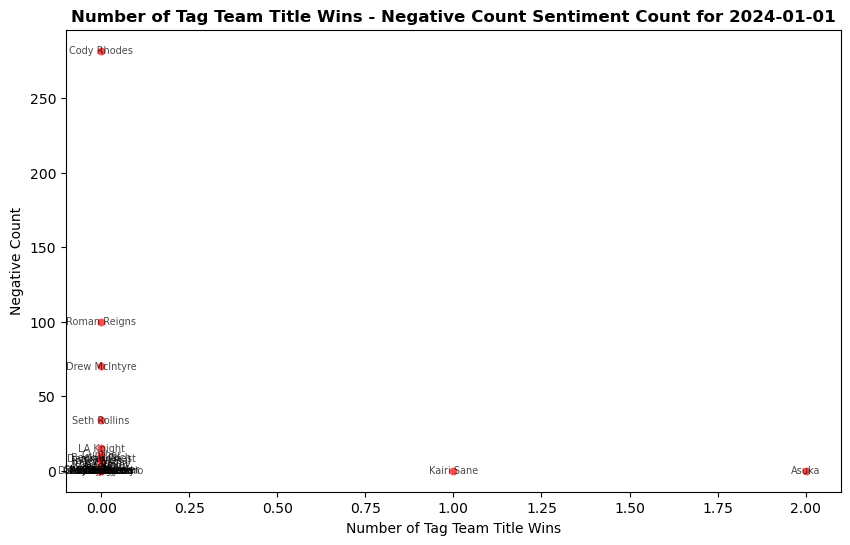

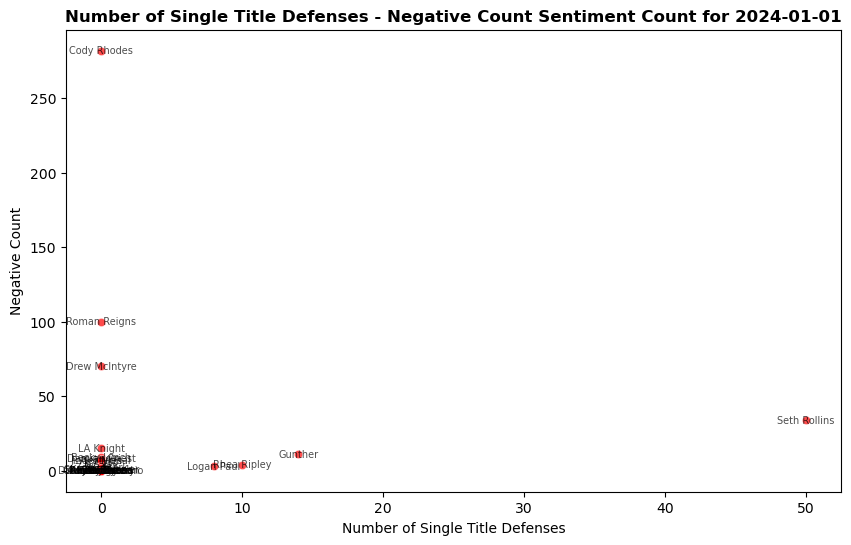

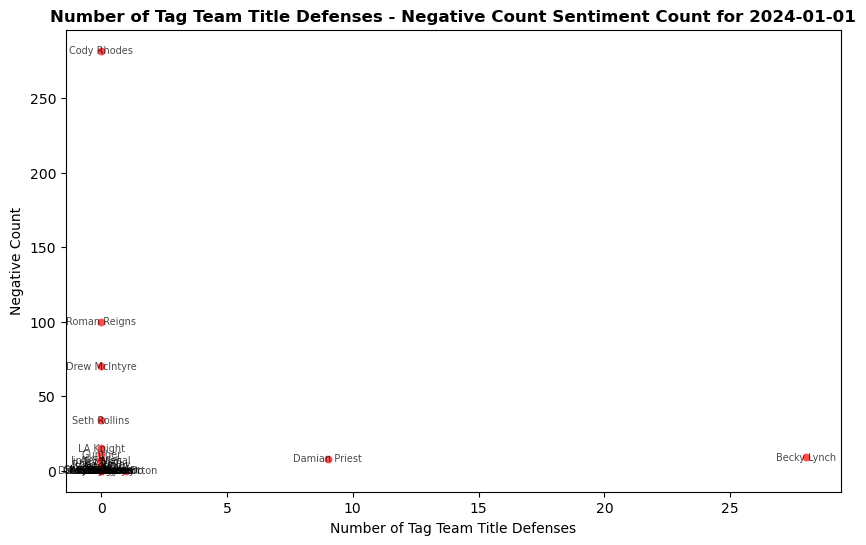

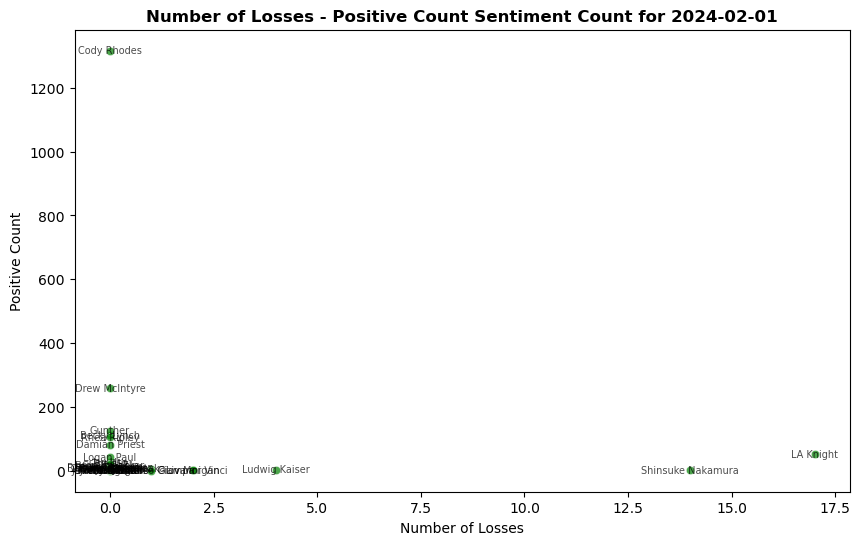

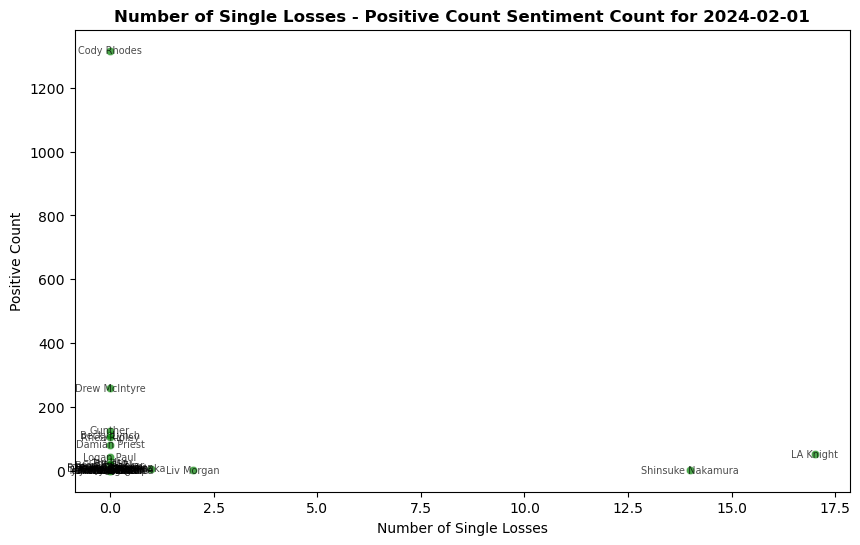

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

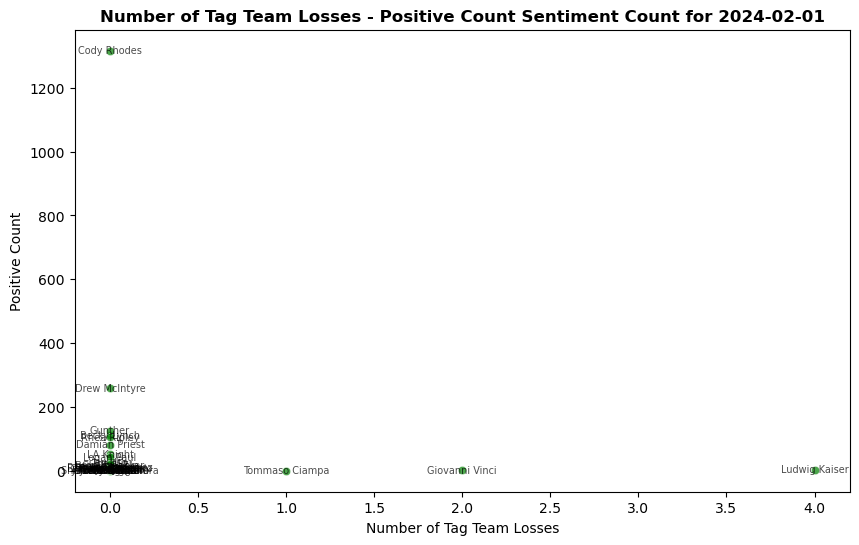

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

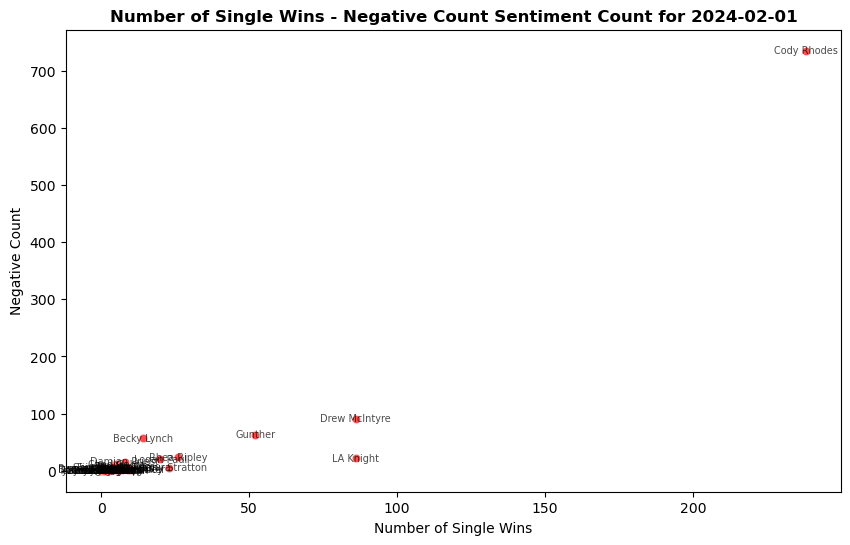

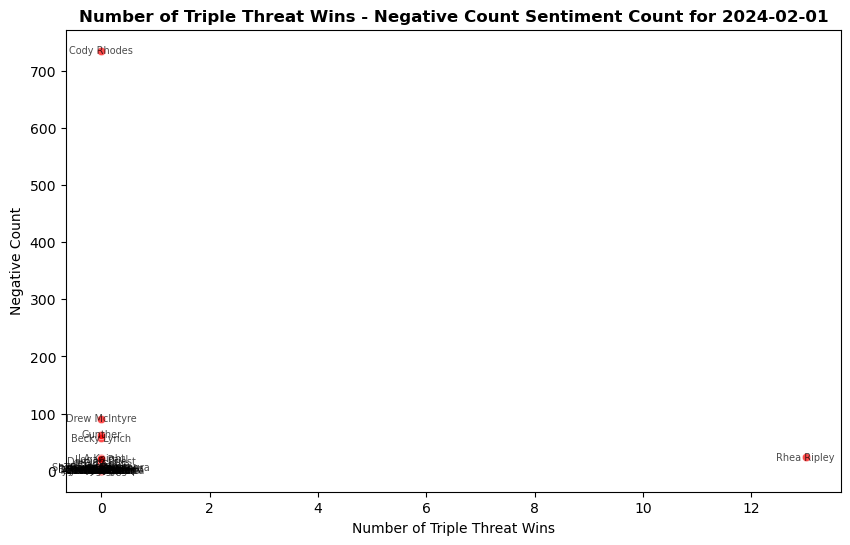

<Figure size 1000x600 with 0 Axes>

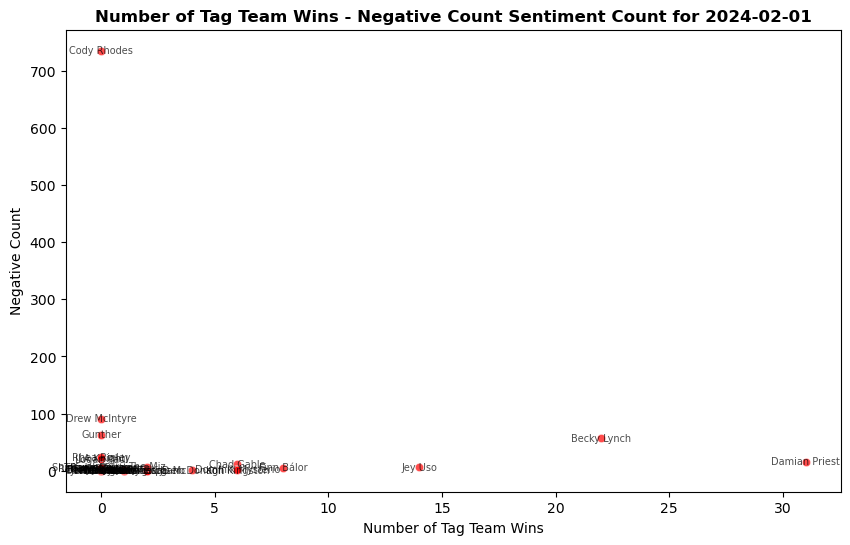

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

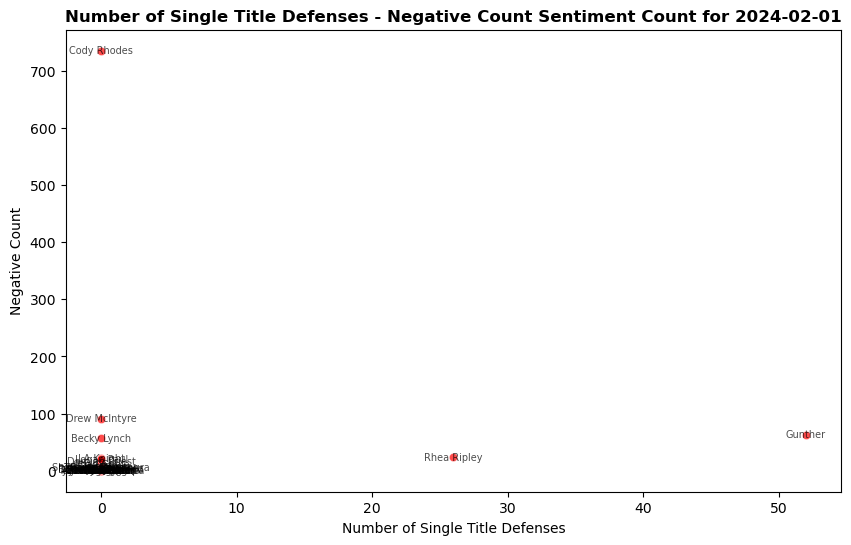

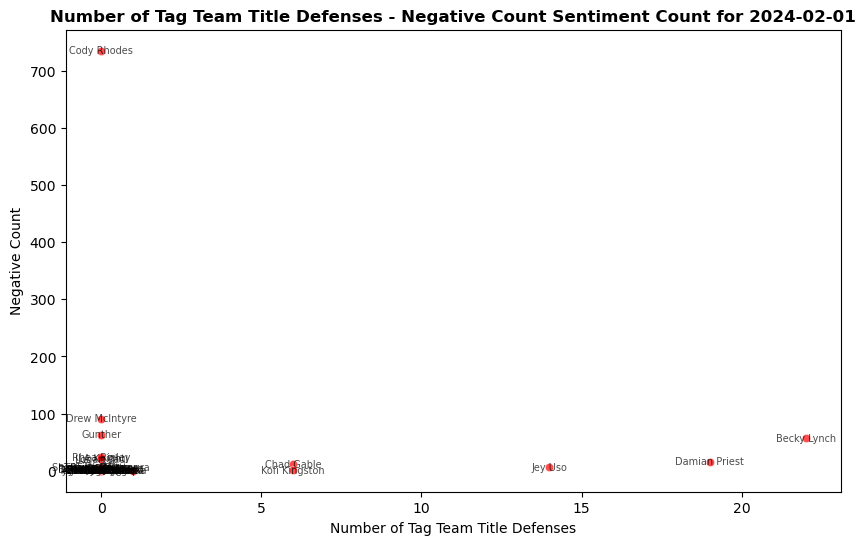

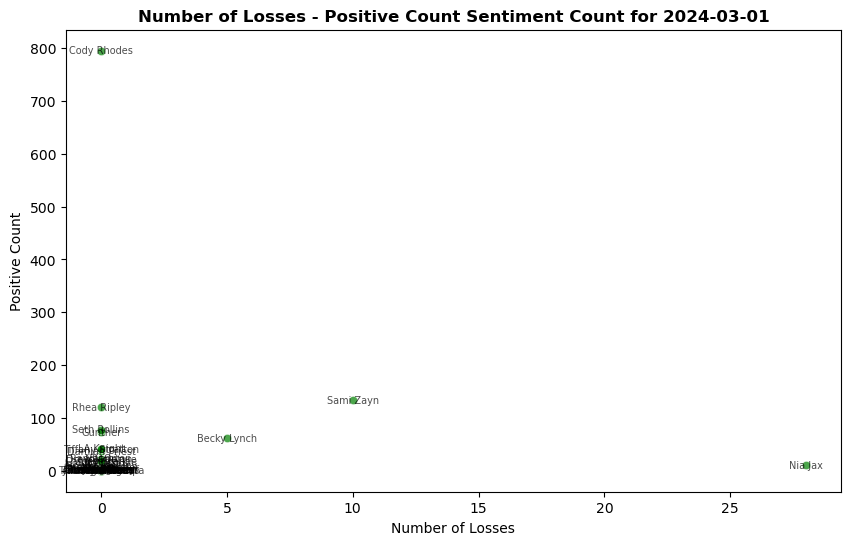

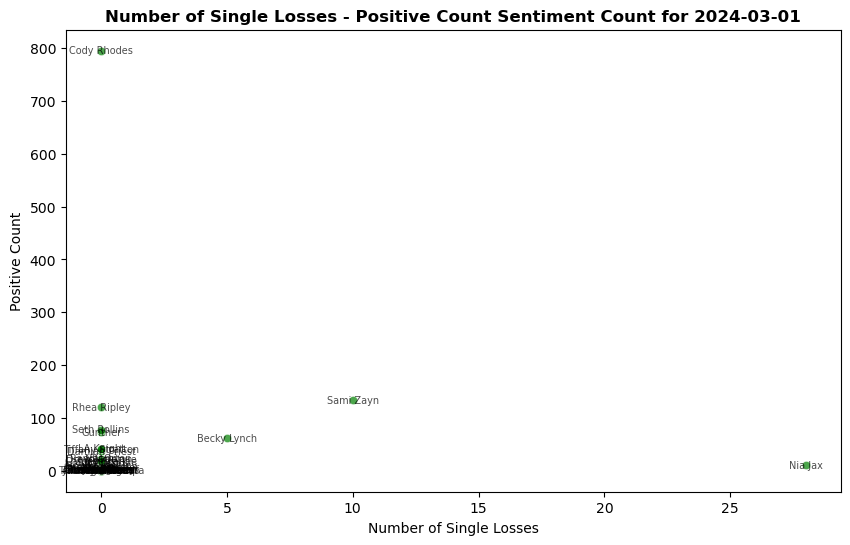

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

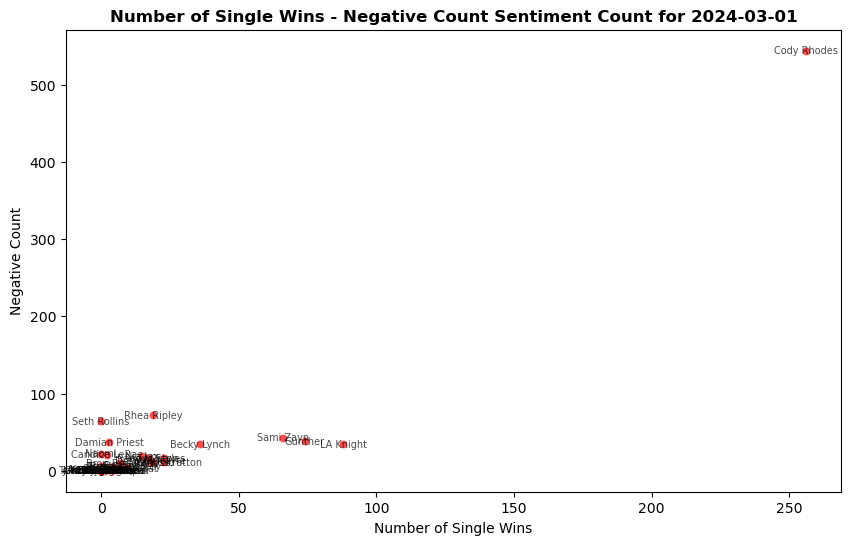

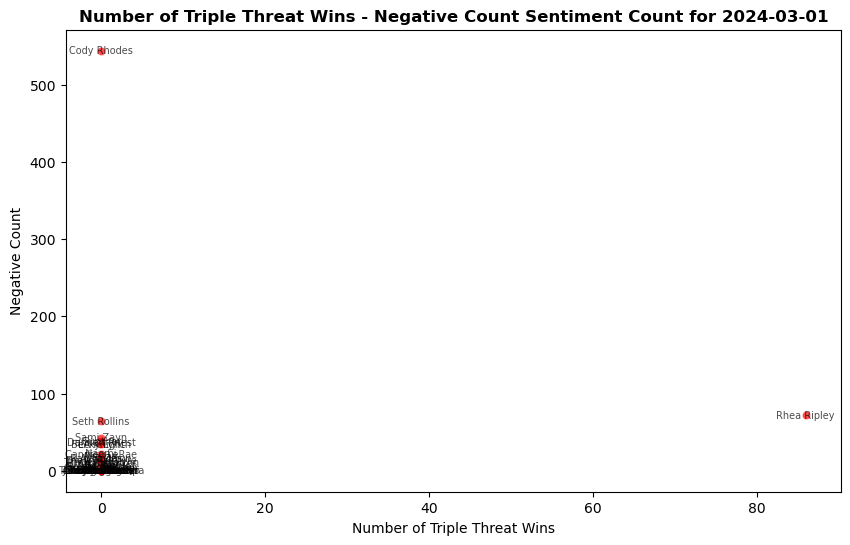

<Figure size 1000x600 with 0 Axes>

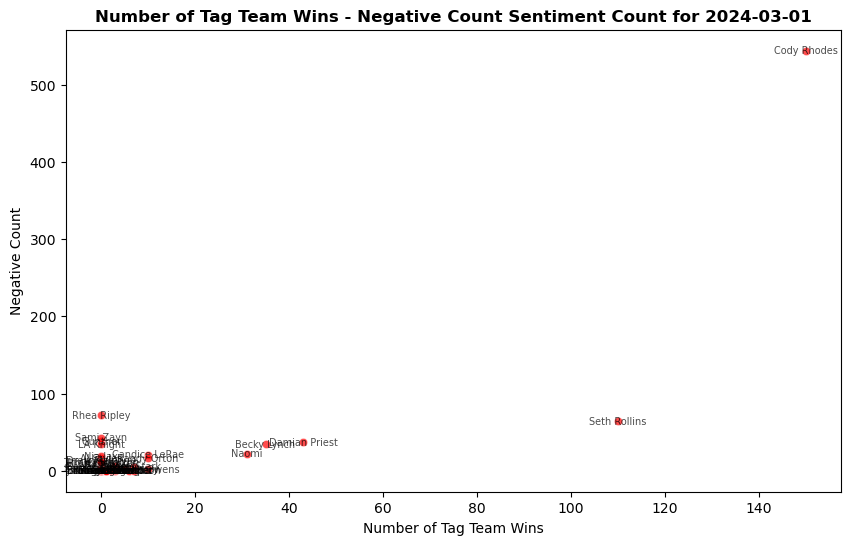

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

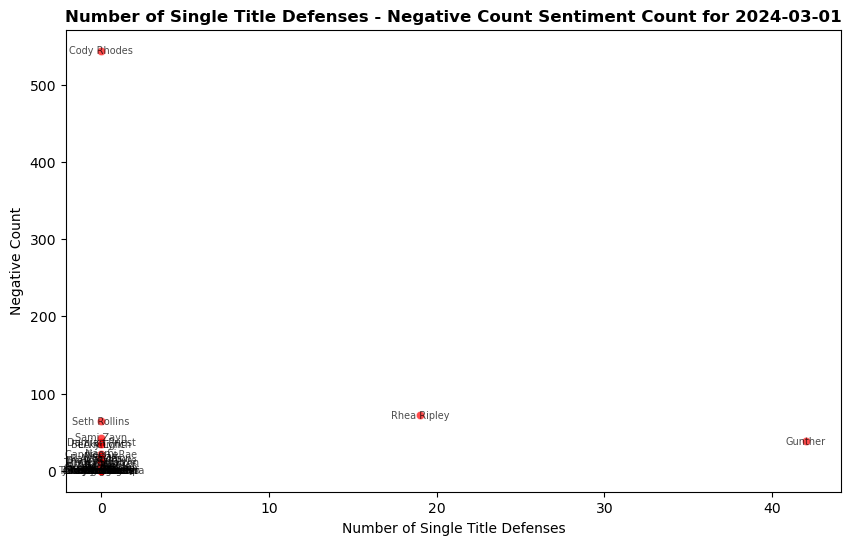

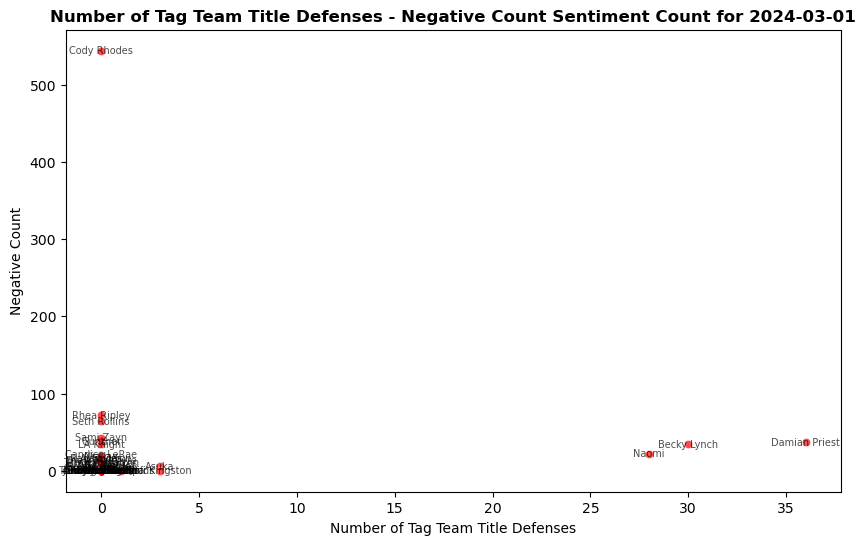

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

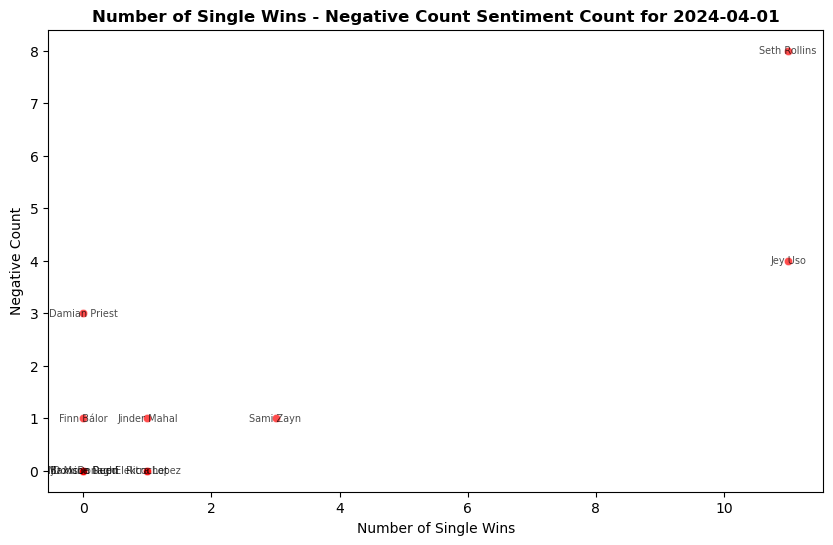

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

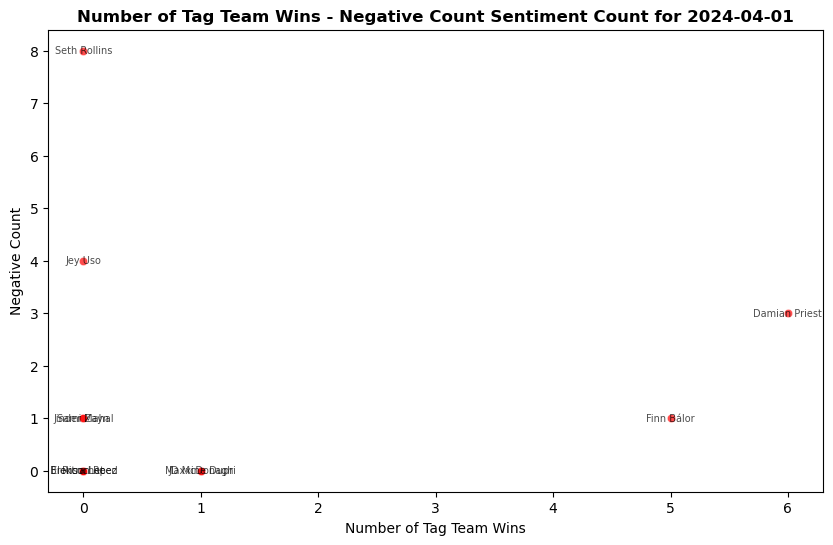

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

In [146]:
#neutral will give us no insights at this point, therefore we will exclude 
sentiments=['Positive Count','Negative Count']
dates=list(df_total_month['Date_Month'].unique())[:-1]
win=[]
loss=[]
cols=list(df_total_month.columns)[3:-1]
#getting a list of columns broken down by win and losses
for swi_col in cols:
    if 'Wins' in swi_col or 'Defenses' in swi_col:
        win.append(swi_col)
    else:
        loss.append(swi_col)

for d in dates:
    dev_com=df_total_month[(df_total_month['Date_Month']==d)]
    #getting the color value based on the selected value
    #getting the scatterplots
    for sent in sentiments:
        if sent == 'Positive Count':
            color='Green'
        else:
            color='Red'
        if sent == 'Positive Count':
            for sent_pos in loss[2:-2]:
                plt.figure(figsize=(10,6))
                if (dev_com[sent_pos]==0).all():#if every single value is 0 then return True
                    pos_df=dev_com.drop(columns=[sent_pos])
                else:
                    #here we want to make sure that we only use data points which have more positive comments
                    ##than negative comments
                    positive_com = dev_com
                    #if not positive_com.empty:
                        #here we check if the dataframe is not empty
                        #this line had to be entered otherwise we would have gotten out of bonce error for error
                    scatter_plot=sns.scatterplot(x=sent_pos, y=sent, color=color,alpha=0.7,
                                                 data=positive_com)
                    for line in range(0, positive_com.shape[0]):
                        wrestler='{}'.format(positive_com['Wrestler'].iloc[line])
                        scatter_plot.text(positive_com[sent_pos].iloc[line], #x-value coordinate
                                          positive_com[sent].iloc[line], #y-value coordinate
                                          wrestler, #value that will be placed on the data point
                                          horizontalalignment='center', 
                                          verticalalignment='center', 
                                          fontsize=7,
                                          position=(positive_com[sent_pos].iloc[line],
                                                    positive_com[sent].iloc[line]),
                                          color='black',
                                          alpha=0.7)
                    plt.title('{} - {} Sentiment Count for {}'.format(sent_pos,sent,d),size=12,fontweight='bold')
        else:
            for sent_neg in win:
                plt.figure(figsize=(10,6))
                if (dev_com[sent_neg]==0).all():
                    neg_df=dev_com.drop(columns=[sent_neg])
                else:
                    #here we want to make sure that we only use data points which have more negative comments
                    ##than positive comments
                    negative_com = dev_com
                    #if not negative_com.empty:#here we check if the dataframe is not empty
                        #this line had to be entered otherwise we would have gotten out of bonce error for error
                    scatter_plot=sns.scatterplot(x=sent_neg, y=sent, color=color,alpha=0.7,
                                                 data=negative_com)
                    for line in range(0, negative_com.shape[0]):
                        wrestler='{}'.format(negative_com['Wrestler'].iloc[line])
                        scatter_plot.text(negative_com[sent_neg].iloc[line], #x-value coordinate
                                          negative_com[sent].iloc[line], #y-value coordinate
                                          wrestler, #value that will be placed on the data point
                                          horizontalalignment='center', 
                                          verticalalignment='center', 
                                          fontsize=7,
                                          position=(negative_com[sent_neg].iloc[line],
                                                    negative_com[sent].iloc[line]),
                                          color='black',
                                          alpha=0.7)
                    plt.title('{} - {} Sentiment Count for {}'.format(sent_neg,sent,d),size=12,fontweight='bold')

As we analyze the different graphs one thing becomes obivous, we do not have enough data points/wrestlers where we have more negative than positive comments. Therefore our outlier analysis will focus on the relationships between the loss features and positive comments.

Next, we want to understand how the data is distributed and how each wrester perfomrs.

Starting point of the x-axis: 0
Ending point of the x-axis: 100


C:\Users\gandj\AppData\Local\Temp\ipykernel_6228\3249374764.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(12,8))


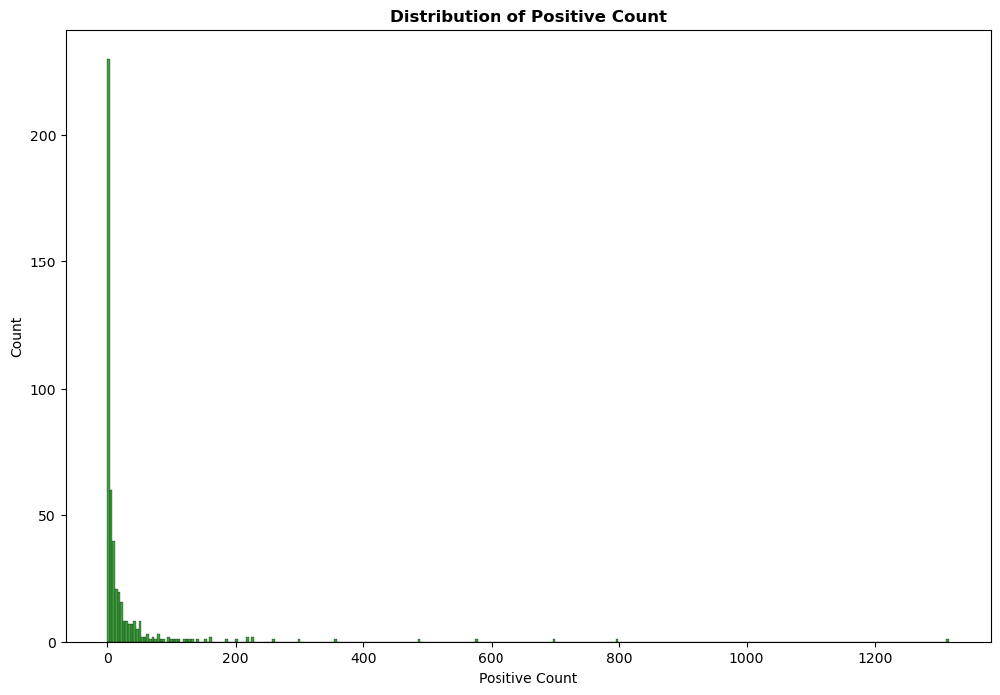

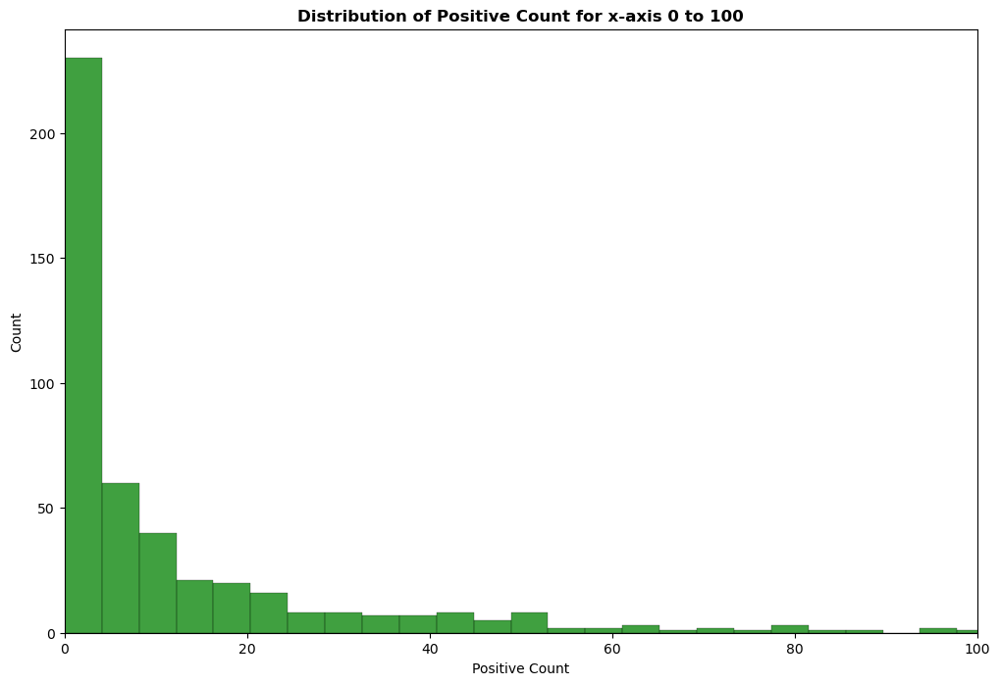

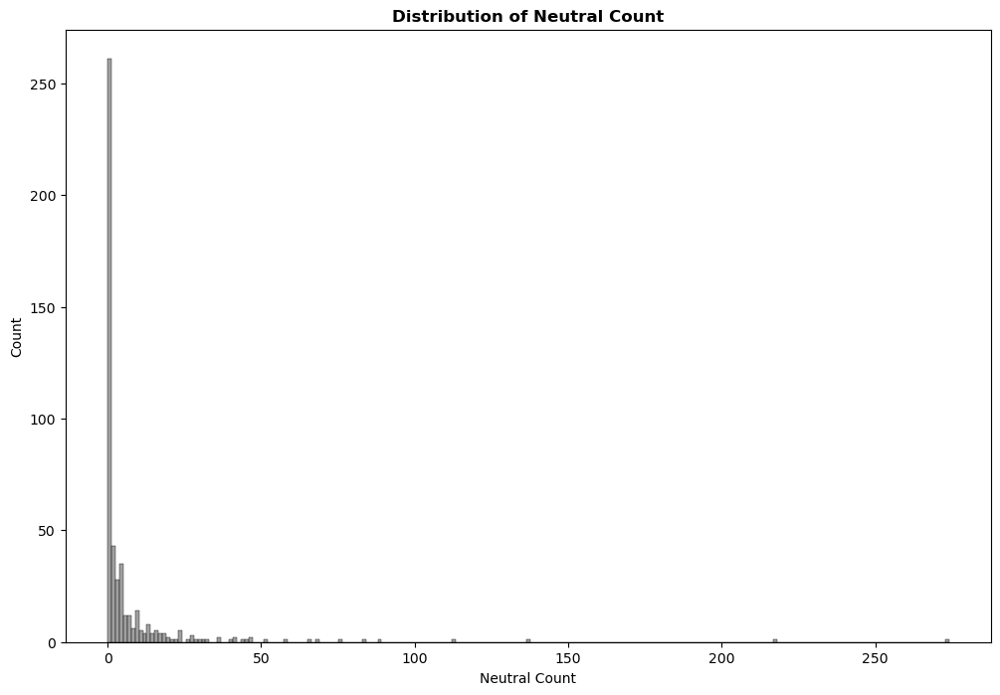

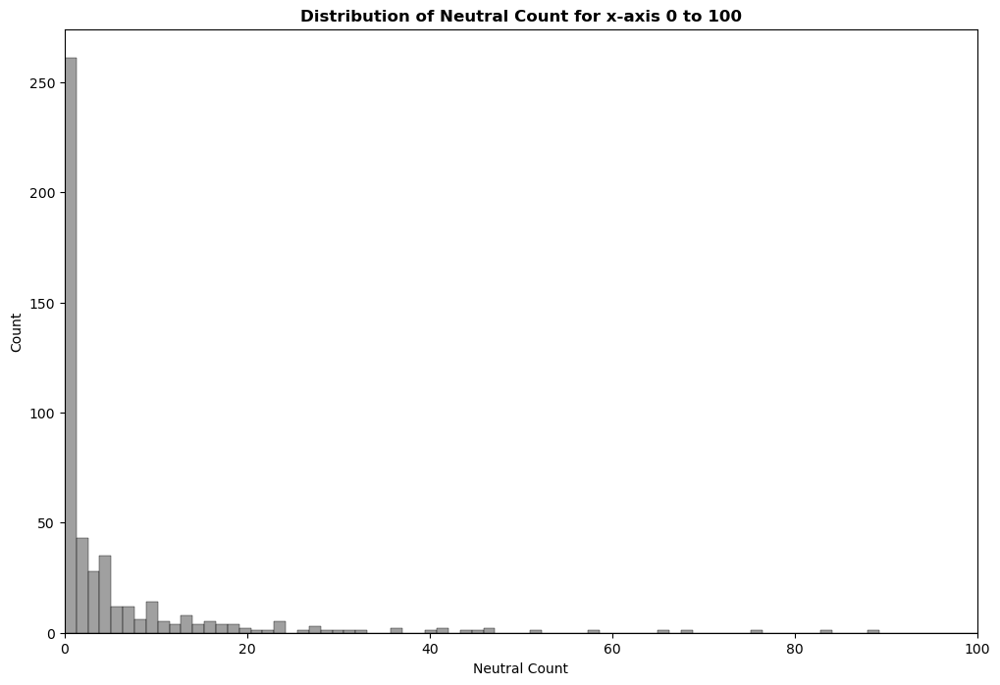

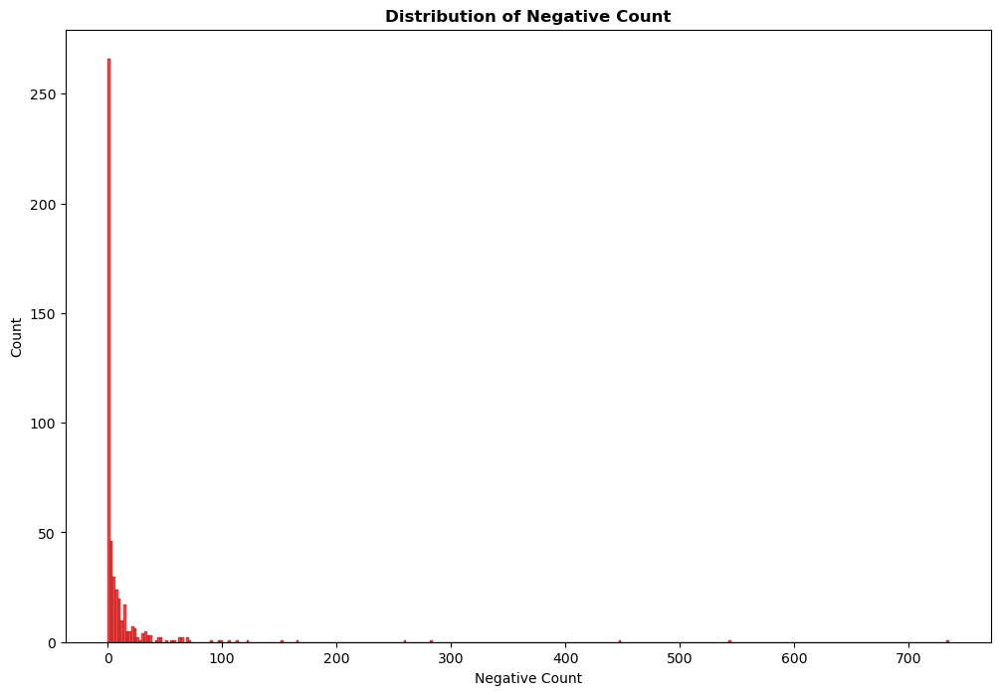

...

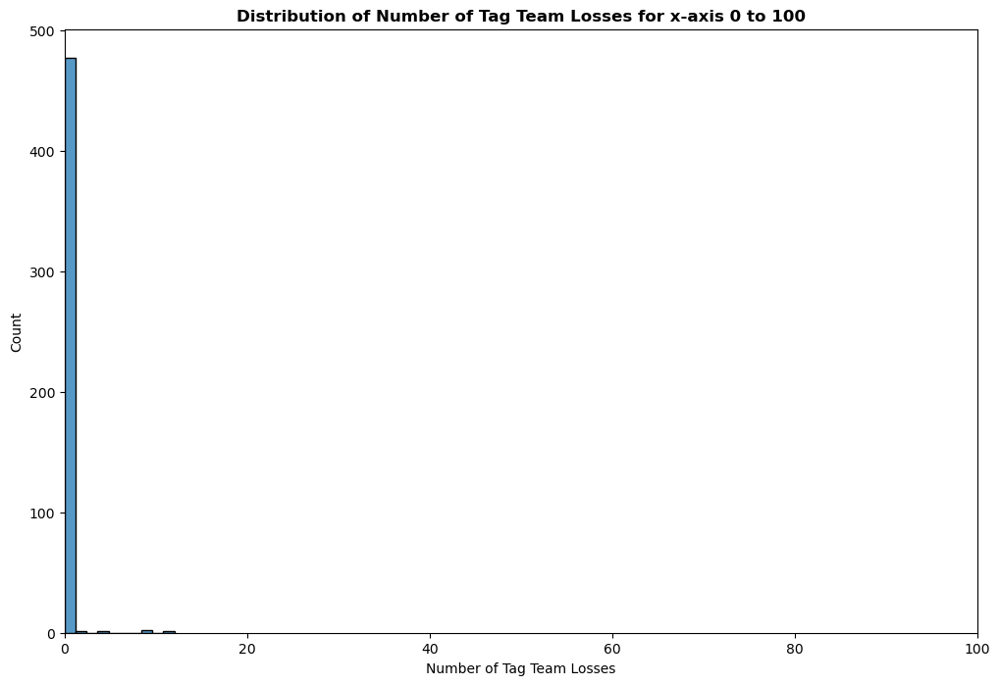

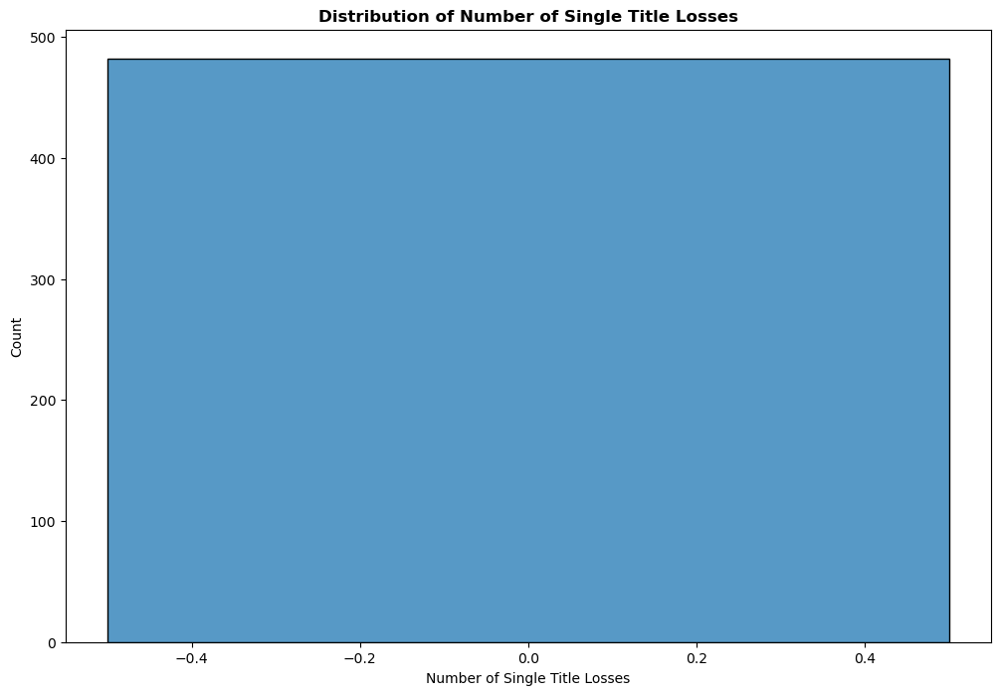

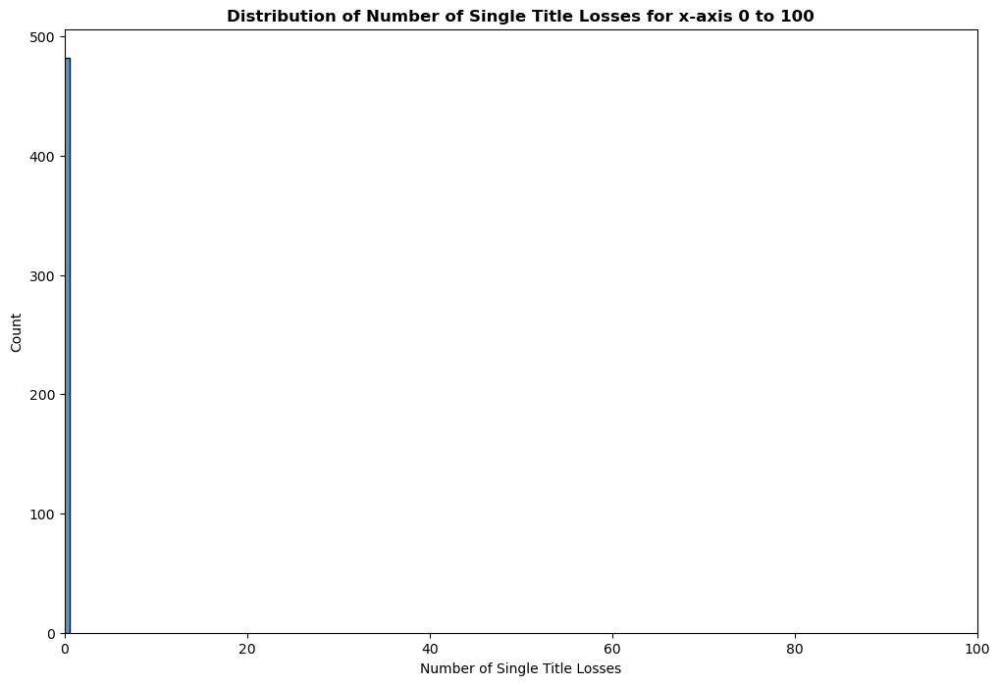

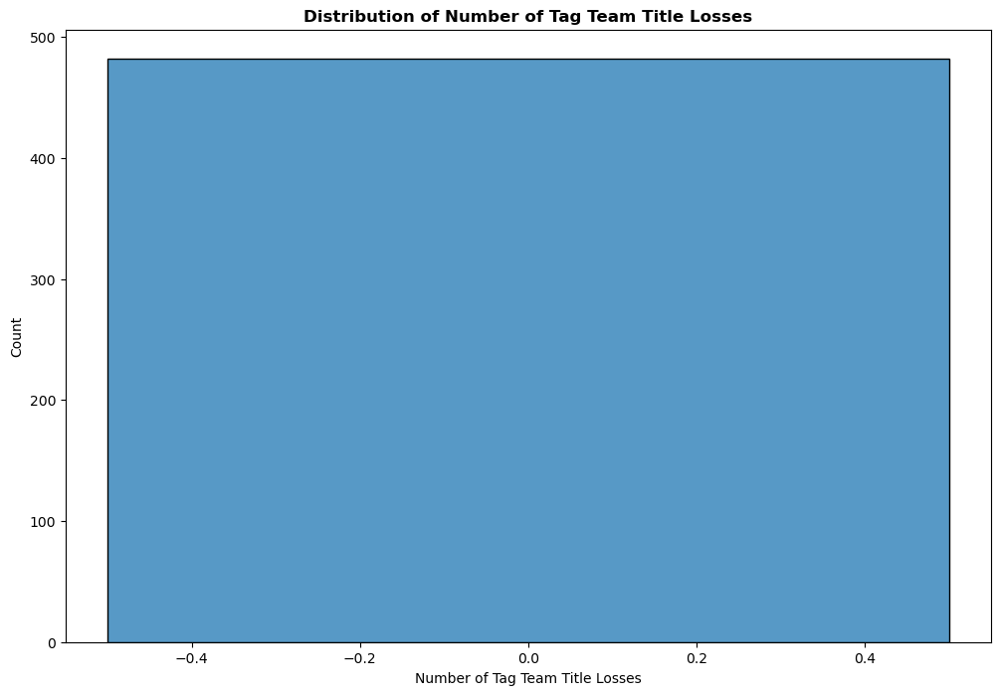

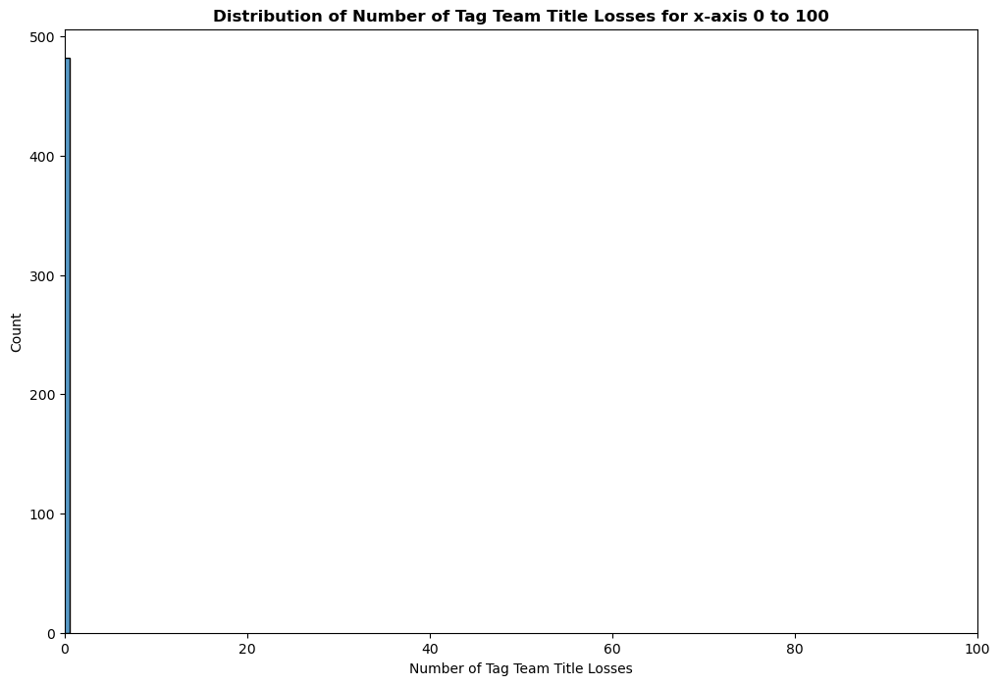

In [147]:
#histrograms when broken down by wrestler and month
sent_list=list(df_total_month.iloc[:,-3:].columns)
x_start=int(input('Starting point of the x-axis: '))
x_max=int(input('Ending point of the x-axis: '))

for sent_com in sent_list:
    if sent_com == 'Positive Count':
        color='Green'
    elif sent_com == 'Neutral Count':
        color='Gray'
    else:
        color='Red'
    plt.figure(figsize=(12,8))
    sns.histplot(x=sent_com,color=color,data=df_total_month[(df_total_month['Date_Month']!= 'No Comment')])
    plt.title('Distribution of {}'.format(sent_com),size=12,fontweight='bold')
    
    plt.figure(figsize=(12,8))
    sns.histplot(x=sent_com,color=color,data=df_total_month[df_total_month['Date_Month']!= 'No Comment'])
    plt.xlim(x_start,x_max)
    plt.title('Distribution of {} for x-axis {} to {}'.format(sent_com,x_start,x_max),size=12,fontweight='bold')

for w in win:
    plt.figure(figsize=(12,8))
    sns.histplot(x=w,data=df_total_month[(df_total_month['Date_Month']!= 'No Comment')])
    plt.title('Distribution of {}'.format(w),size=12,fontweight='bold')
    
    plt.figure(figsize=(12,8))
    sns.histplot(x=w,data=df_total_month[df_total_month['Date_Month']!= 'No Comment'])
    plt.xlim(x_start,x_max)
    plt.title('Distribution of {} for x-axis {} to {}'.format(w,x_start,x_max),size=12,fontweight='bold')

for l in loss[2:-2]:
    plt.figure(figsize=(12,8))
    sns.histplot(x=l,data=df_total_month[(df_total_month['Date_Month']!= 'No Comment')])
    plt.title('Distribution of {}'.format(l),size=12,fontweight='bold')
    
    plt.figure(figsize=(12,8))
    sns.histplot(x=l,data=df_total_month[df_total_month['Date_Month']!= 'No Comment'])
    plt.xlim(x_start,x_max)
    plt.title('Distribution of {} for x-axis {} to {}'.format(l,x_start,x_max),size=12,fontweight='bold')

Starting point of the x-axis: 0
Ending point of the x-axis: 100


C:\Users\gandj\AppData\Local\Temp\ipykernel_6228\1226756423.py:42: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(12,8))


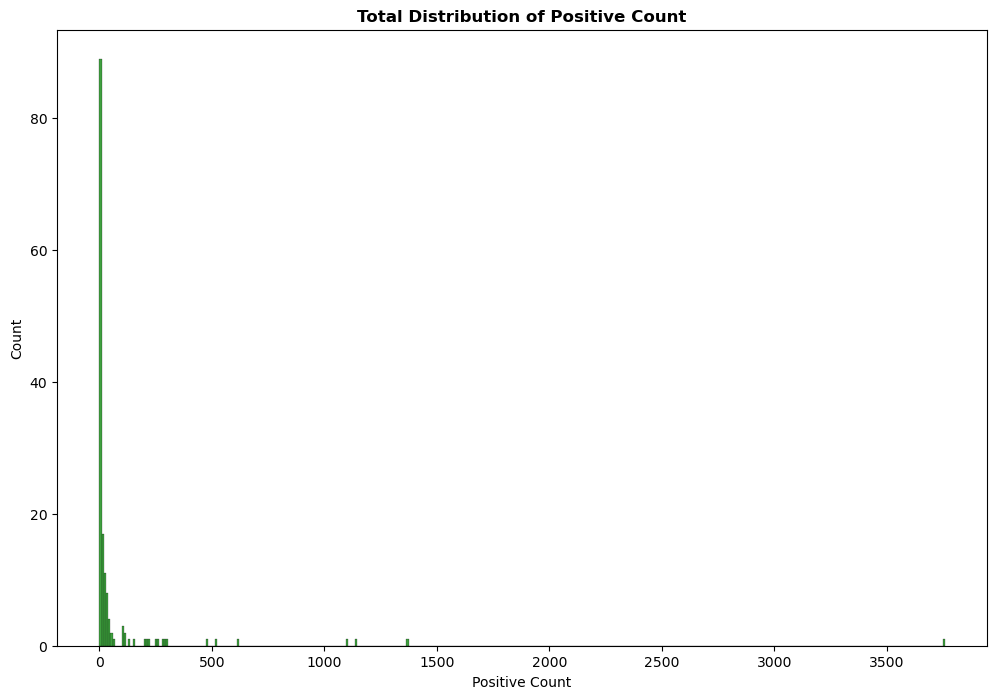

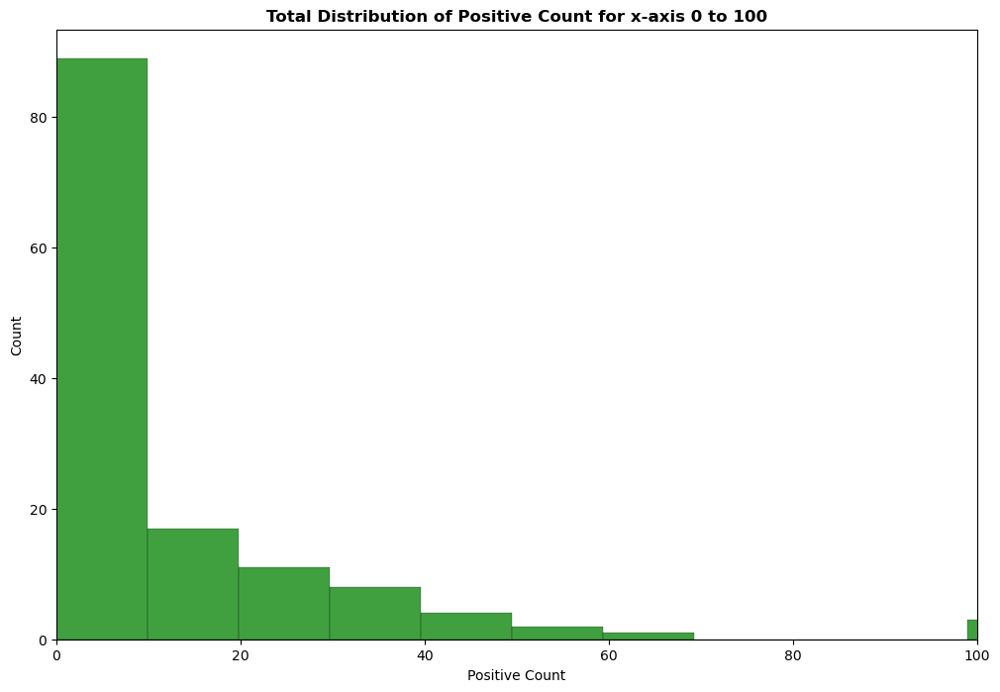

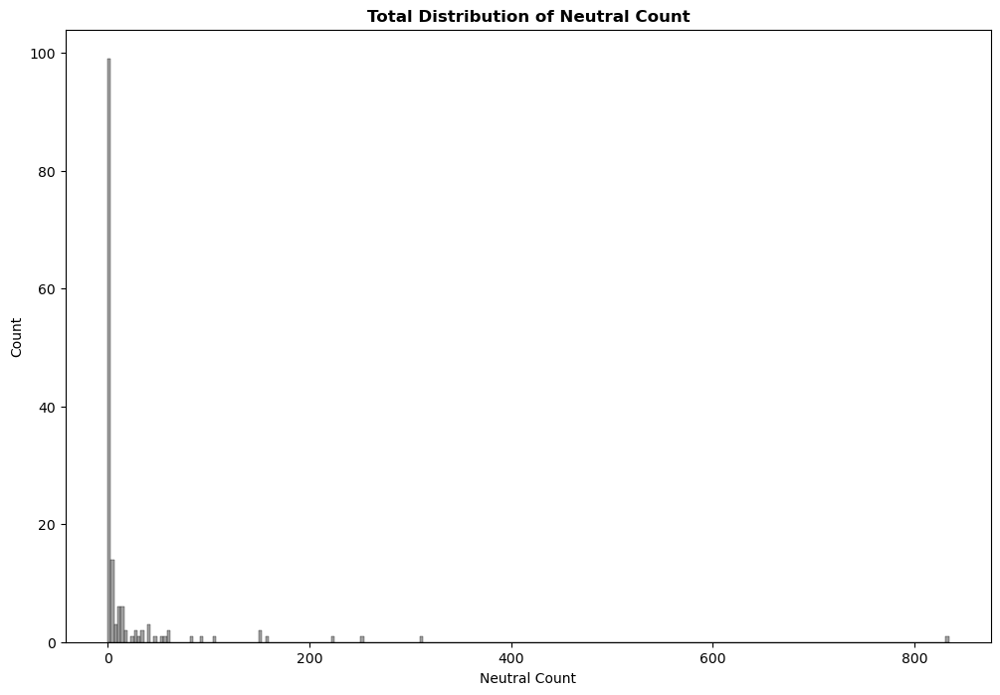

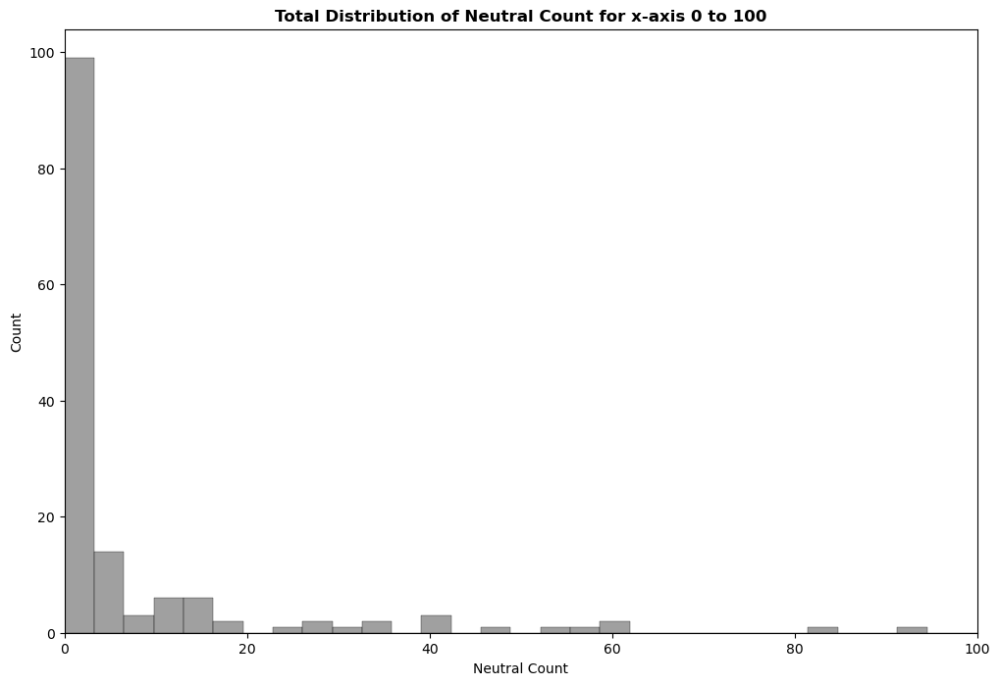

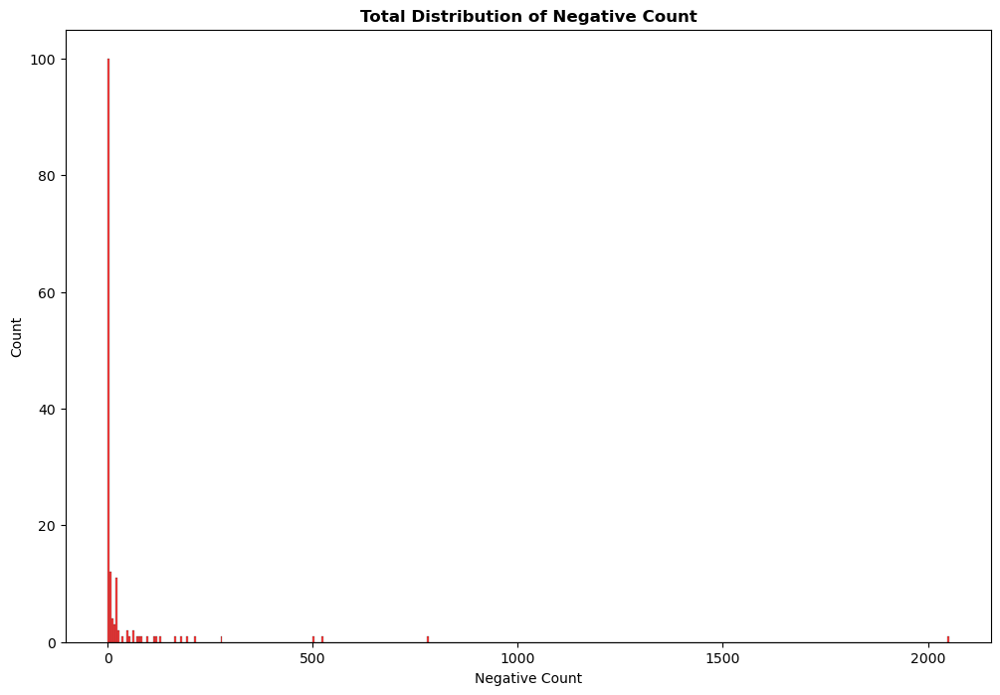

...

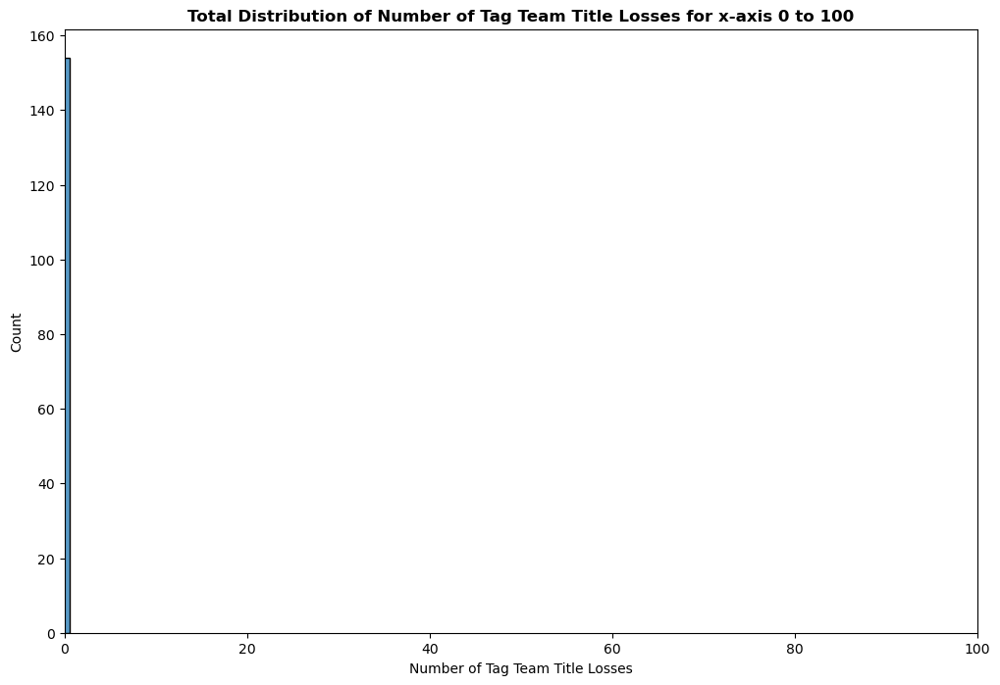

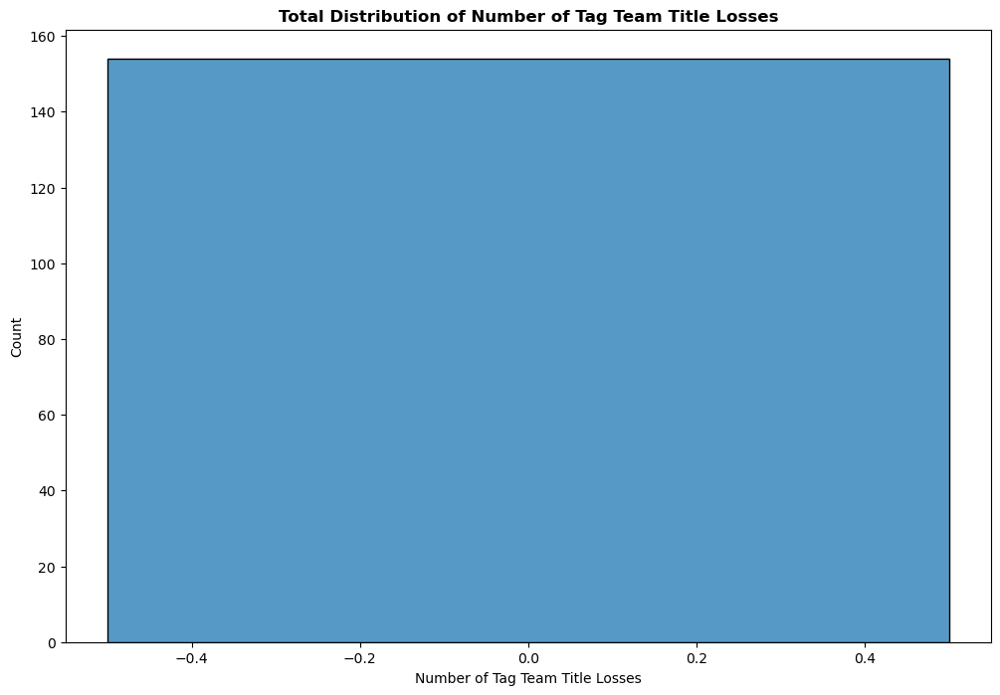

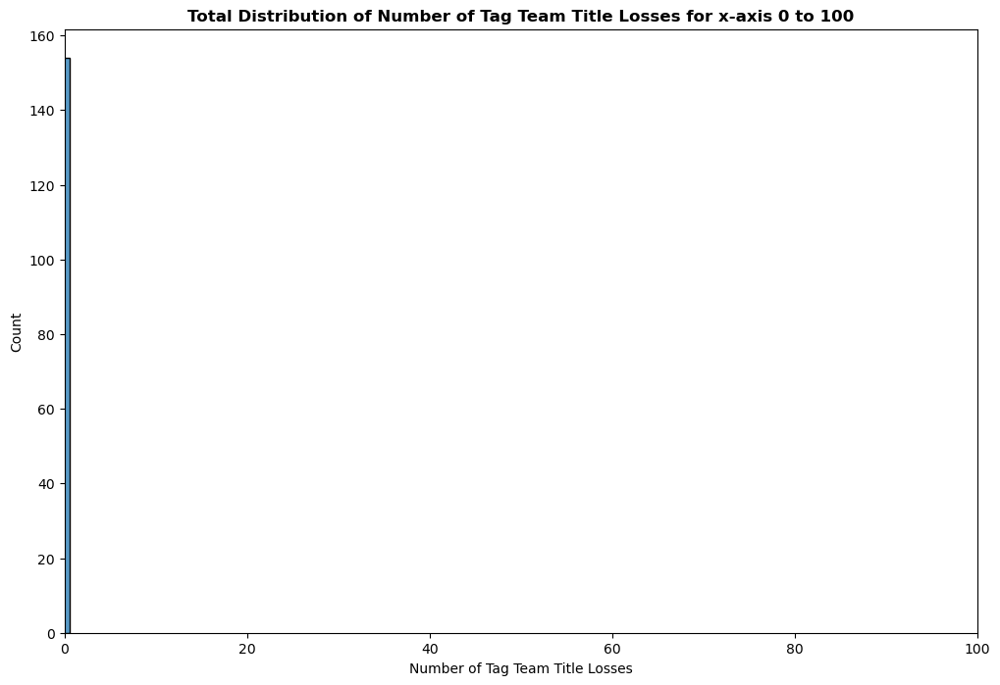

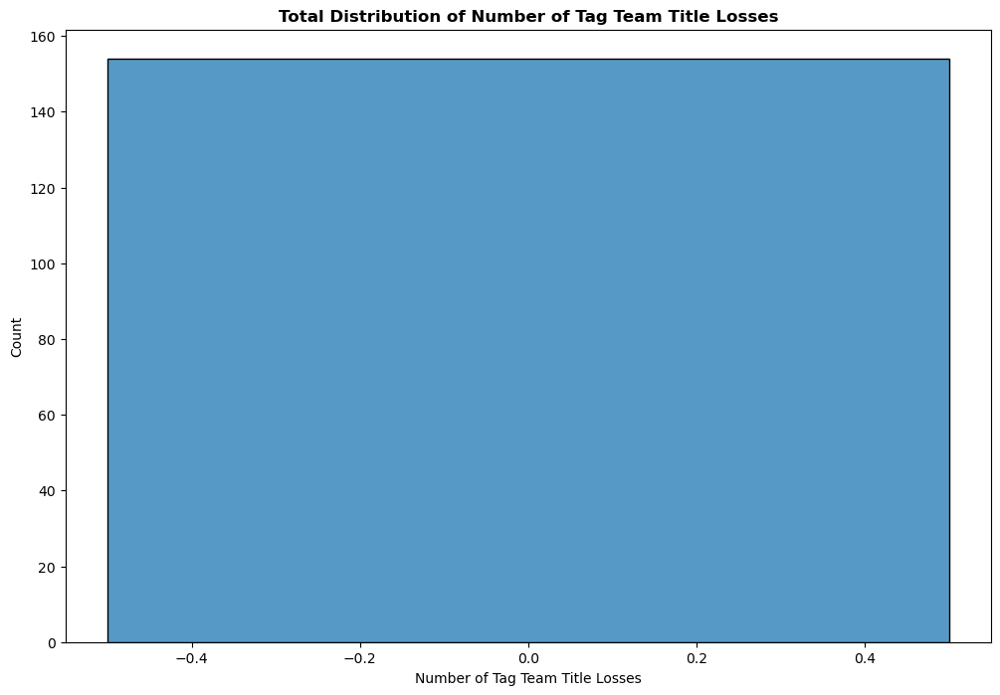

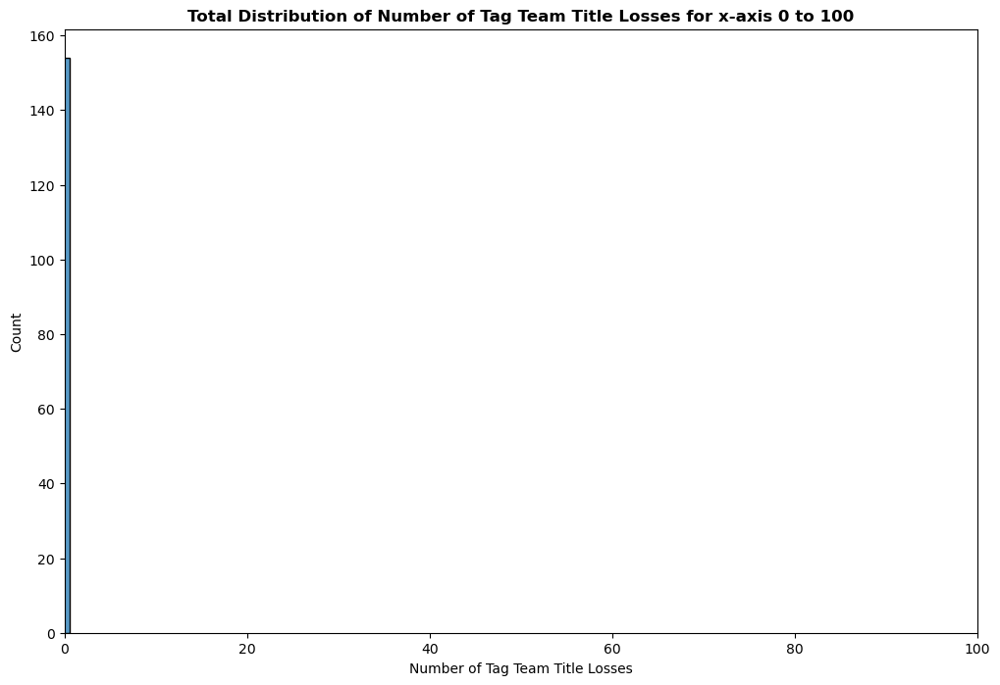

In [148]:
#histrograms when broken down by wrestler and month
total_distribution=df_total_month.groupby(['Wrestler'])[['Positive Count',
                                                         'Neutral Count','Negative Count']].sum().reset_index()

feat_total_distribution=df_total_month.groupby(['Wrestler'])[['Positive Count',
                                                         'Neutral Count','Negative Count','Number of Single Wins',
 'Number of Triple Threat Wins',
 'Number of Fata Fourway Wins',
 'Number of Tag Team Wins',
 'Number of Single Title Wins',
 'Number of Tag Team Title Wins',
 'Number of Single Title Defenses',
 'Number of Tag Team Title Defenses','Number of Losses',
 'Number of Single Losses',
 'Number of Triple Threat Losses',
 'Number of Fata Fourway Losses',
 'Number of Tag Team Losses',
 'Number of Single Title Losses',
 'Number of Tag Team Title Losses']].sum().reset_index()

sent_list=list(df_total_month.iloc[:,-3:].columns)
x_start=int(input('Starting point of the x-axis: '))
x_max=int(input('Ending point of the x-axis: '))

for sent_com in sent_list:
    if sent_com == 'Positive Count':
        color='Green'
    elif sent_com == 'Neutral Count':
        color='Gray'
    else:
        color='Red'
    plt.figure(figsize=(12,8))
    sns.histplot(x=sent_com,color=color,data=total_distribution)
    plt.title('Total Distribution of {}'.format(sent_com),size=12,fontweight='bold')
    
    plt.figure(figsize=(12,8))
    sns.histplot(x=sent_com,color=color,data=total_distribution)
    plt.xlim(x_start,x_max)
    plt.title('Total Distribution of {} for x-axis {} to {}'.format(sent_com,x_start,x_max),size=12,fontweight='bold')

for w in win:
    plt.figure(figsize=(12,8))
    sns.histplot(x=w,data=feat_total_distribution)
    plt.title('Total Distribution of {}'.format(w),size=12,fontweight='bold')
    
    plt.figure(figsize=(12,8))
    sns.histplot(x=w,data=feat_total_distribution)
    plt.xlim(x_start,x_max)
    plt.title('Total Distribution of {} for x-axis {} to {}'.format(w,x_start,x_max),size=12,fontweight='bold')
    
for lin in loss[2:-2]:
    plt.figure(figsize=(12,8))
    sns.histplot(x=l,data=feat_total_distribution)
    plt.title('Total Distribution of {}'.format(l),size=12,fontweight='bold')
    
    plt.figure(figsize=(12,8))
    sns.histplot(x=l,data=feat_total_distribution)
    plt.xlim(x_start,x_max)
    plt.title('Total Distribution of {} for x-axis {} to {}'.format(l,x_start,x_max),size=12,fontweight='bold')

By looking at both distributions total and broken down by month we can see that we are definitely dealing with outliers. For every comment-sentiment-category we are dealing with a left skewed/log normal distribution and we can see gaps and right hand side, these are big indicators that we are dealing with outliers.

C:\Users\gandj\AppData\Local\Temp\ipykernel_6228\2883917563.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(10,8))


<Axes: ylabel='Negative Count'>

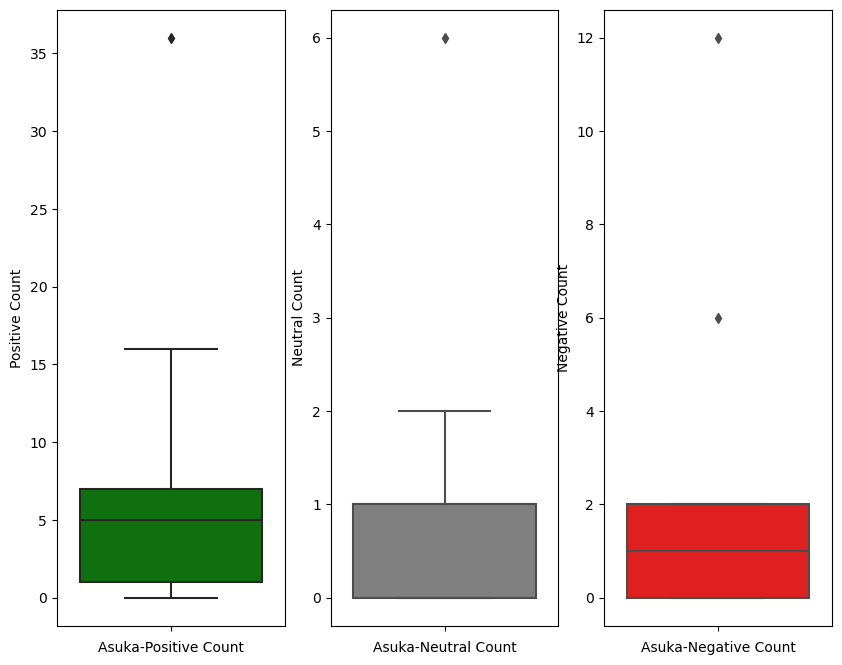

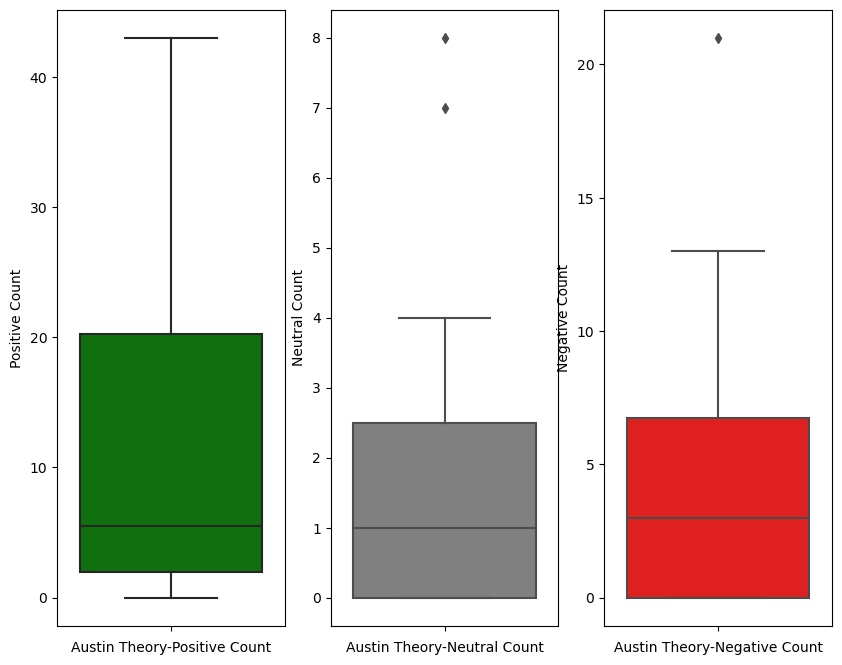

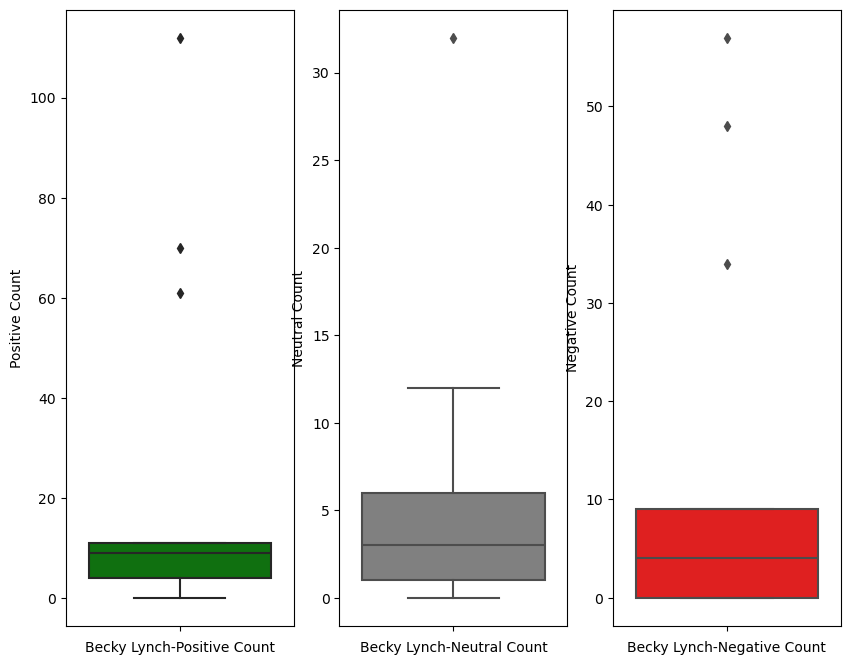

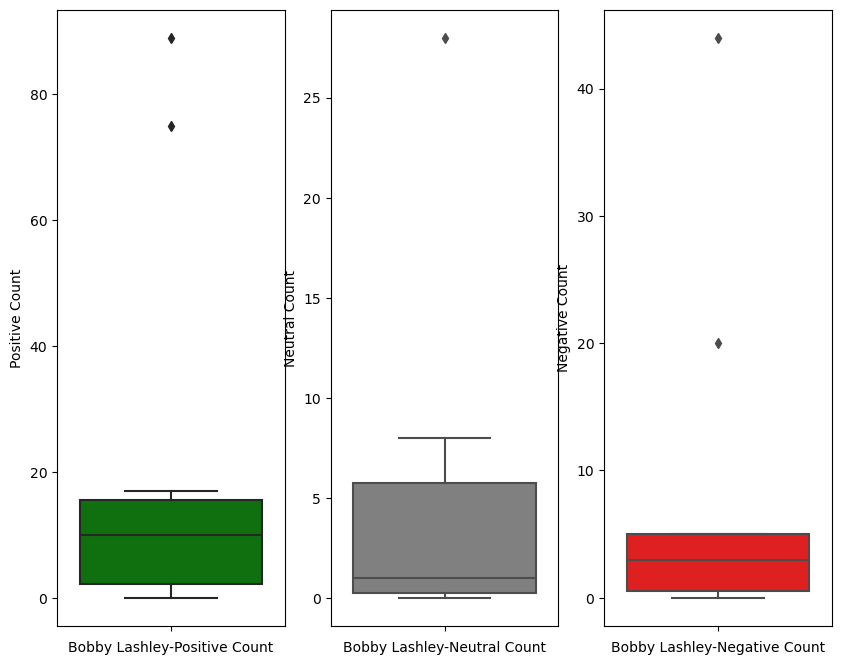

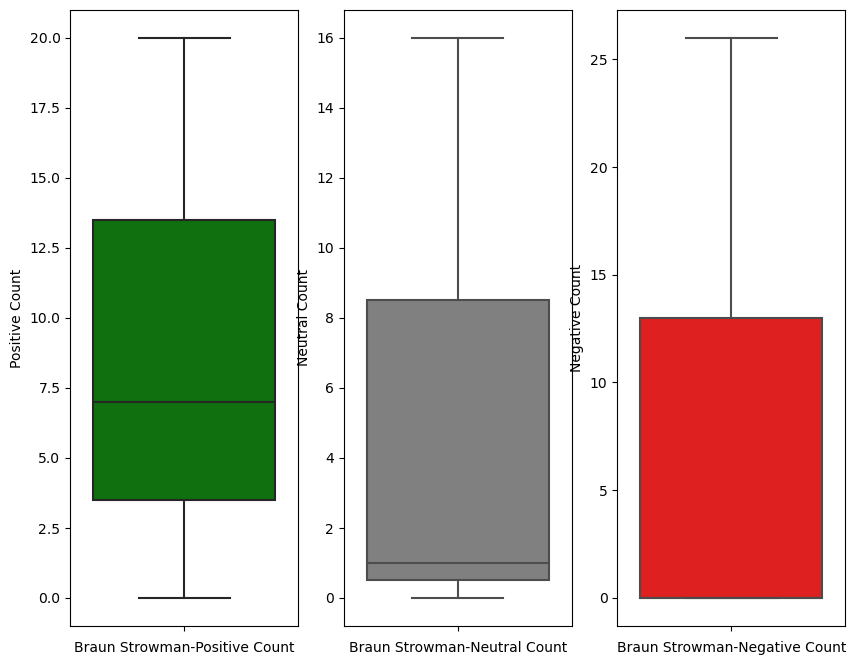

...

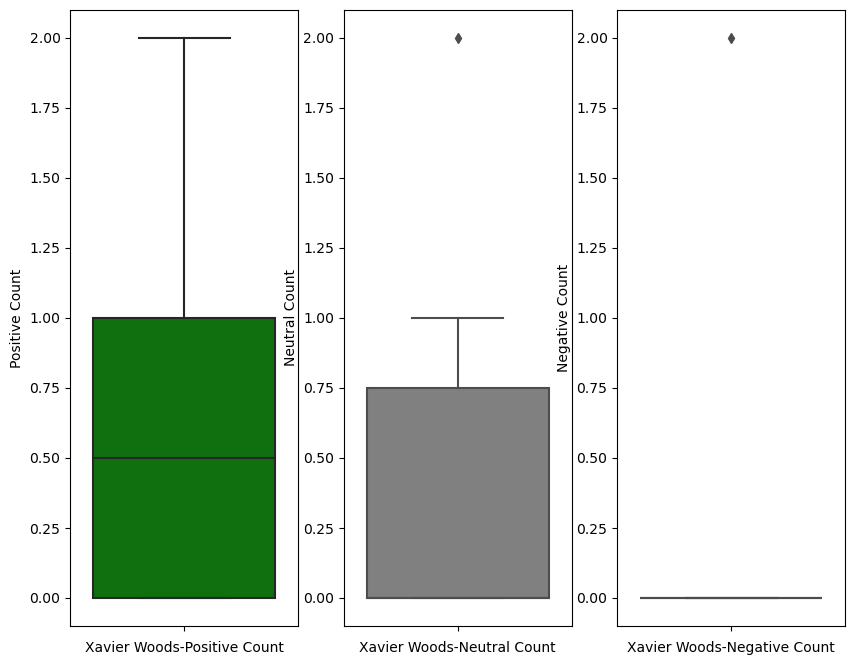

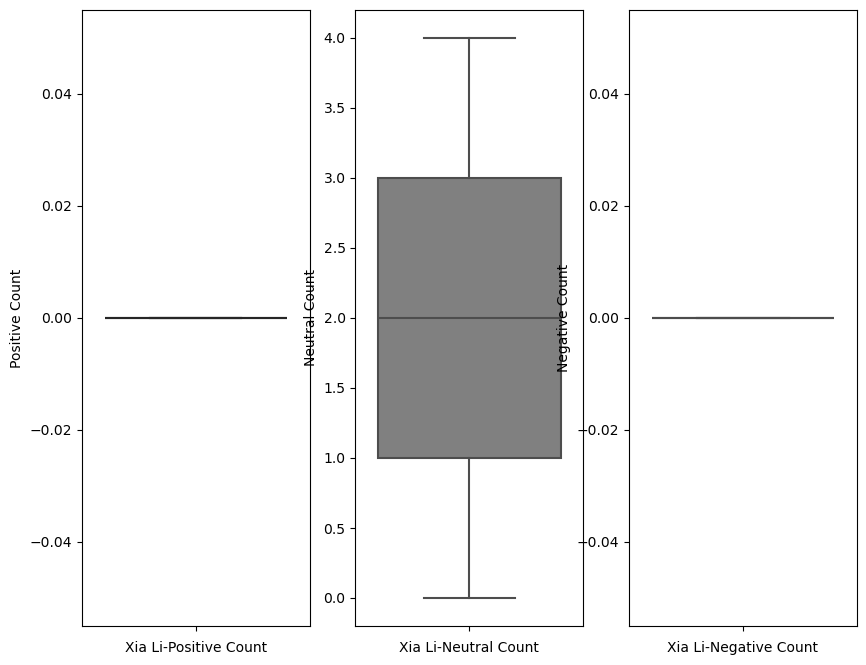

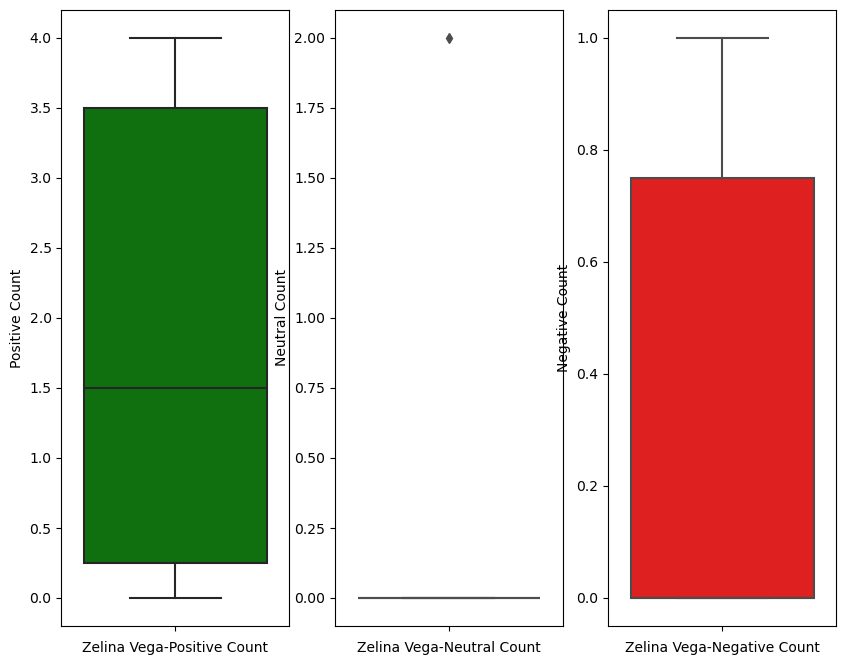

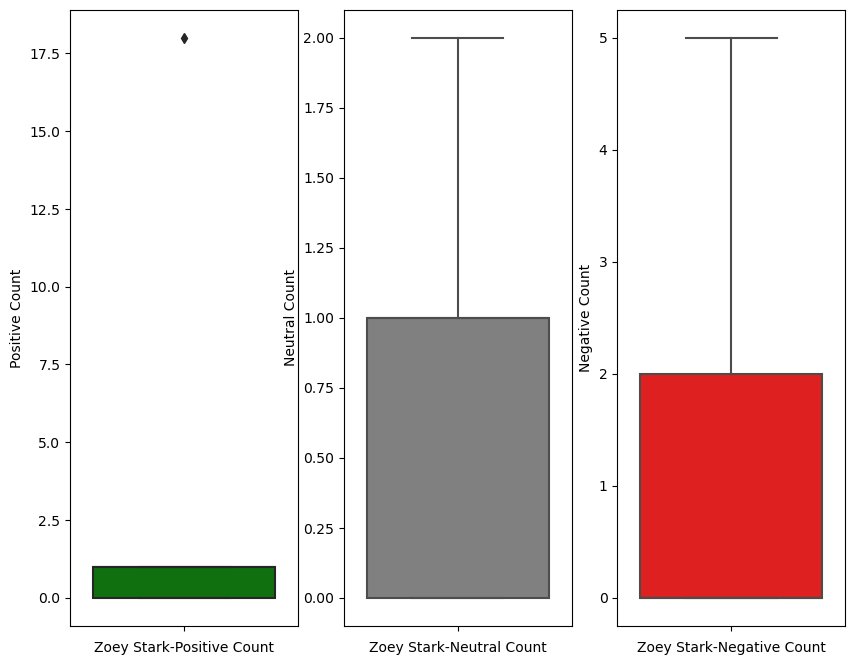

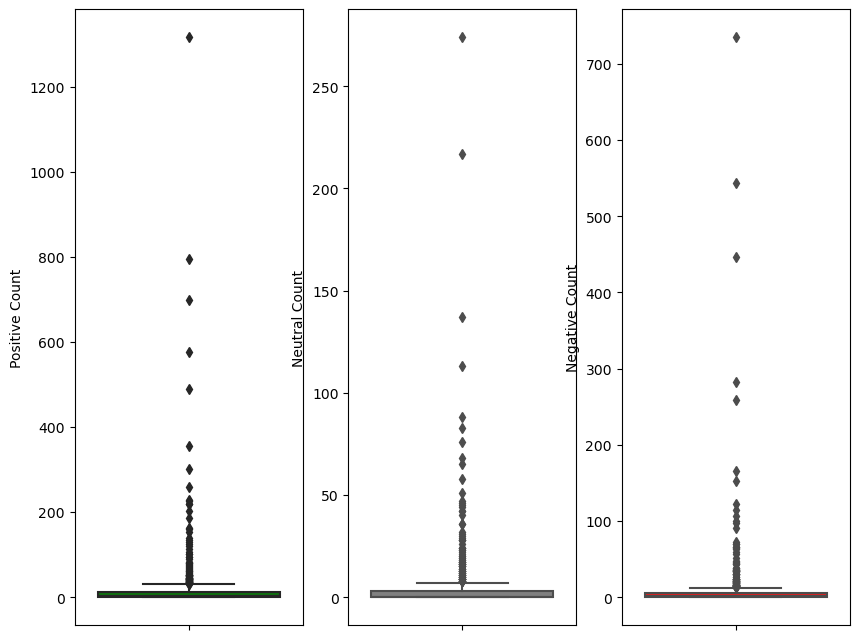

In [149]:
wrest=list(df_total_month['Wrestler'])

for w in wrest:
    plt.figure(figsize=(10,8))
    plt.subplot(1,3,1)
    sns.boxplot(y='Positive Count', color='Green', data=df_total_month[df_total_month['Wrestler']==w])
    plt.xlabel(w+'-Positive Count')
    plt.subplot(1,3,2)
    sns.boxplot(y='Neutral Count', color='Gray', data=df_total_month[df_total_month['Wrestler']==w])
    plt.xlabel(w+'-Neutral Count')
    plt.subplot(1,3,3)
    sns.boxplot(y='Negative Count', color='Red', data=df_total_month[df_total_month['Wrestler']==w])
    plt.xlabel(w+'-Negative Count')
    
plt.figure(figsize=(10,8))
plt.subplot(1,3,1)
sns.boxplot(y='Positive Count', color='Green', data=df_total_month)
plt.subplot(1,3,2)
sns.boxplot(y='Neutral Count', color='Gray', data=df_total_month)
plt.subplot(1,3,3)
sns.boxplot(y='Negative Count', color='Red', data=df_total_month)

Within each wrestlers mentionning count we can see that almost every wrestler has some outliers. In the next section, we want to find overall outliers, but finding a bunch of outleris whithin each wrestler is a great indicator that we are supposed to find outliers.

C:\Users\gandj\AppData\Local\Temp\ipykernel_6228\2364228036.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(12,8))


<Figure size 1200x800 with 0 Axes>

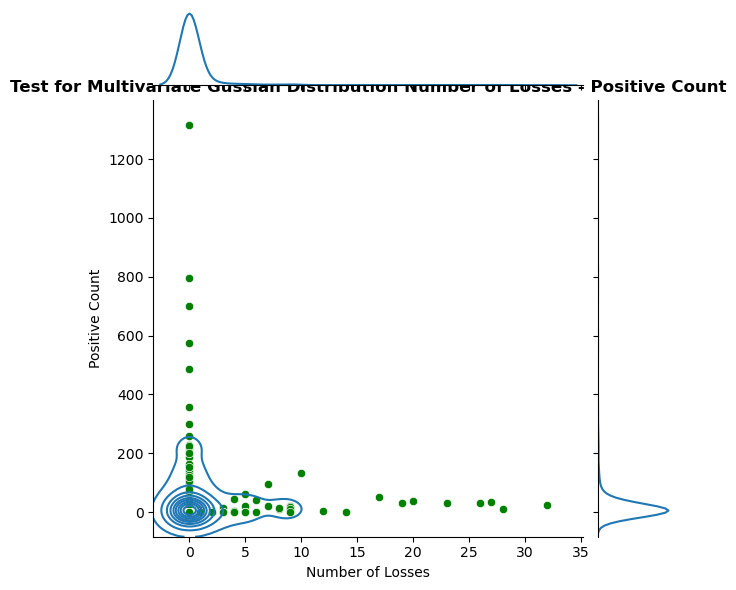

<Figure size 1200x800 with 0 Axes>

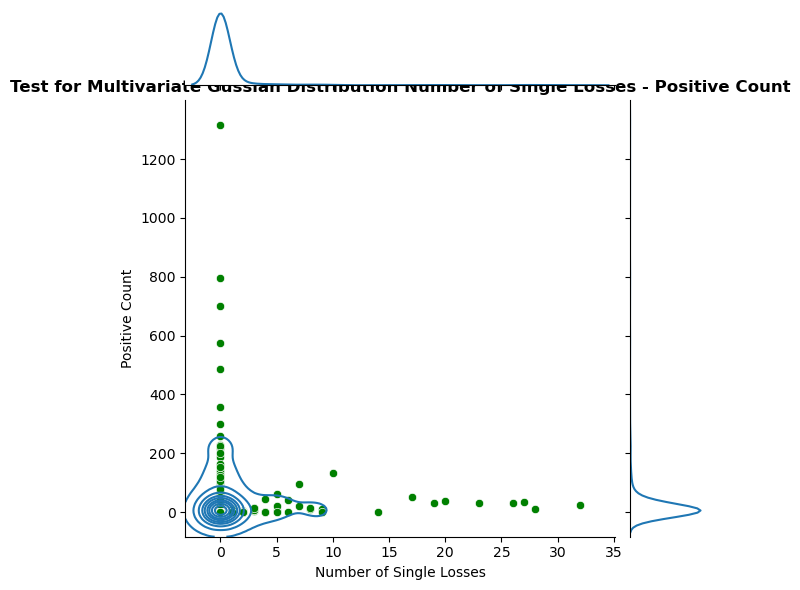

<Figure size 1200x800 with 0 Axes>

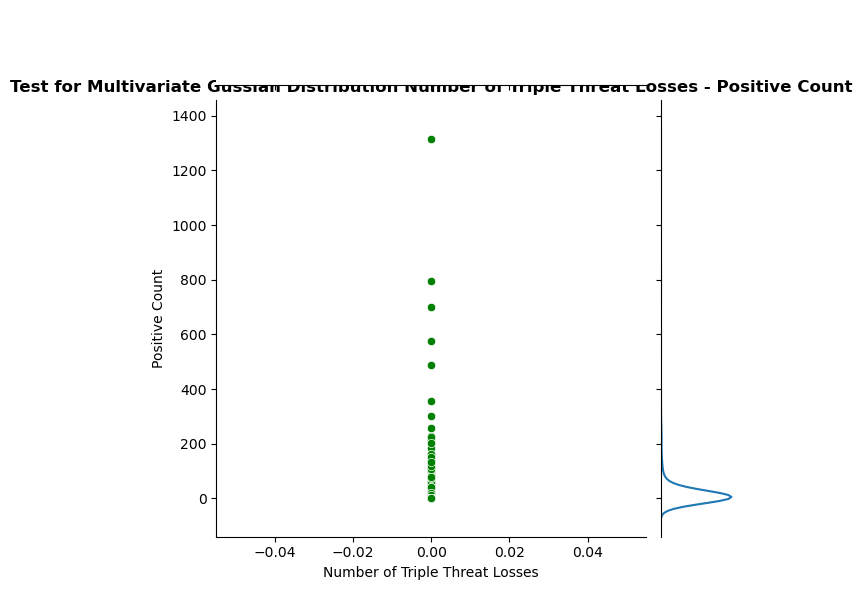

<Figure size 1200x800 with 0 Axes>

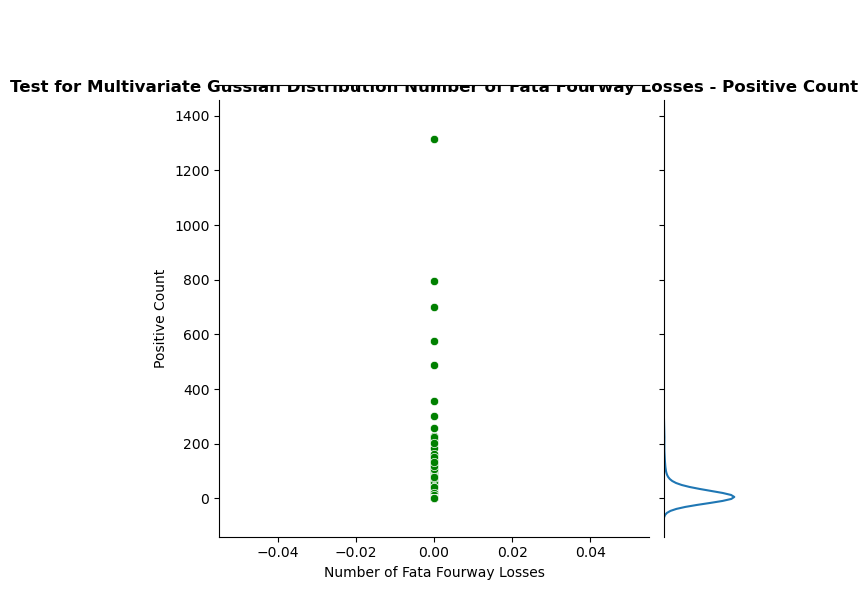

<Figure size 1200x800 with 0 Axes>

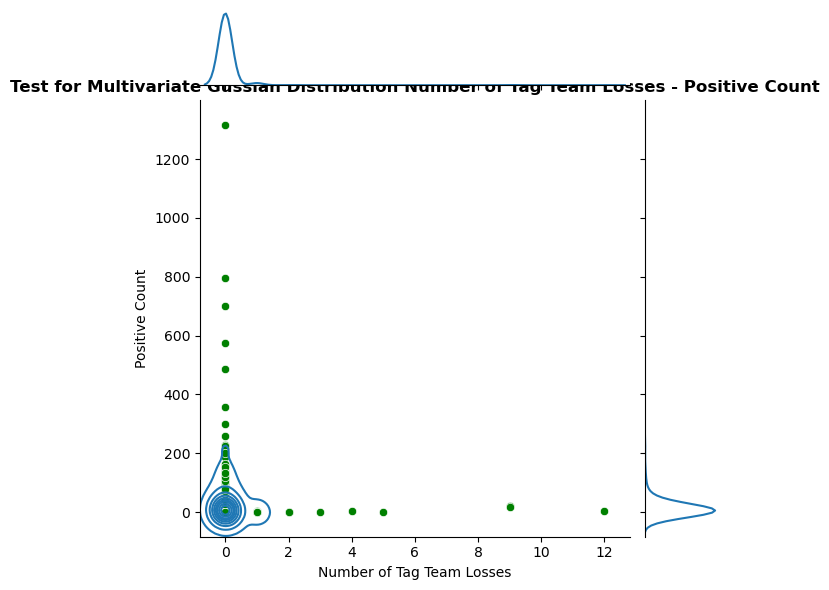

<Figure size 1200x800 with 0 Axes>

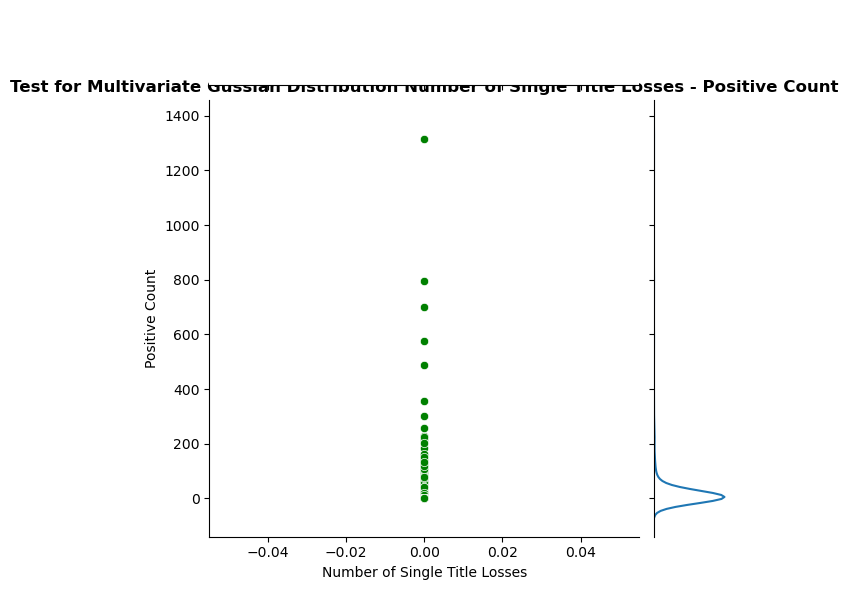

<Figure size 1200x800 with 0 Axes>

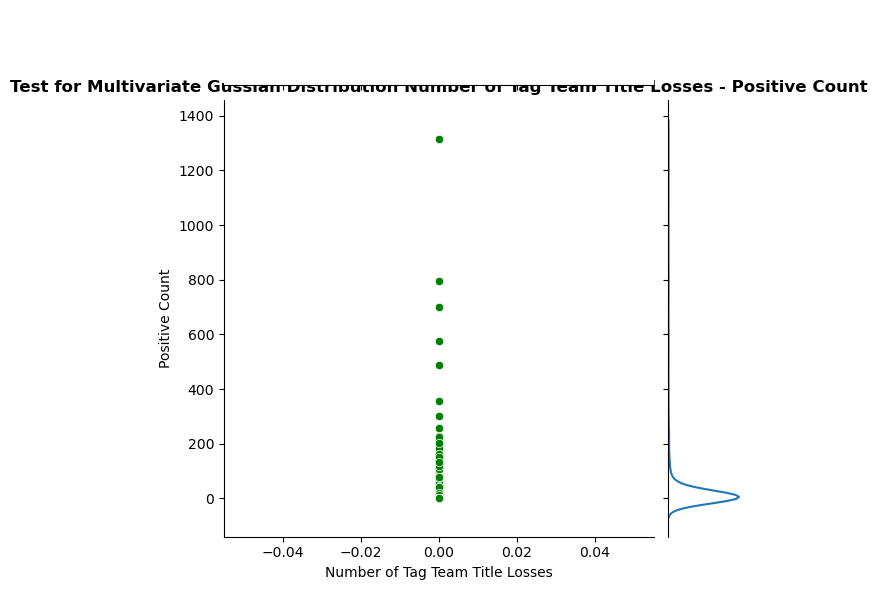

<Figure size 1200x800 with 0 Axes>

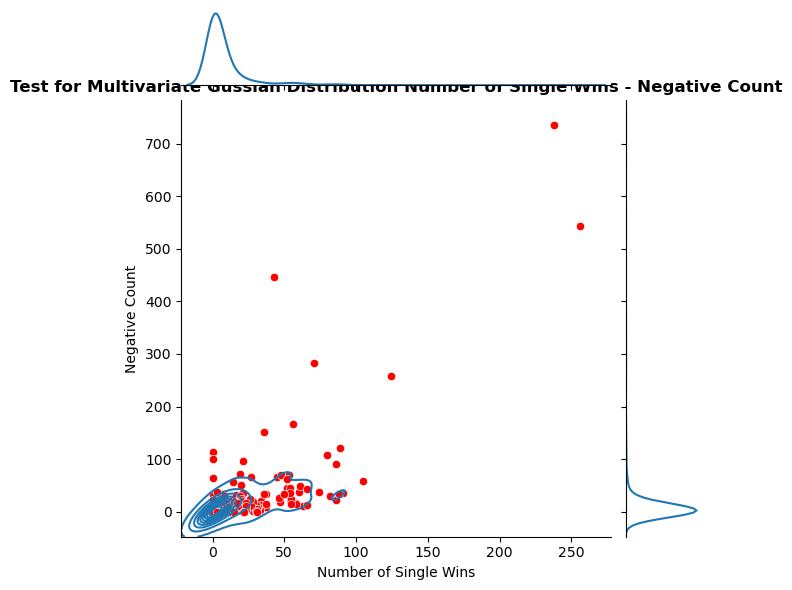

<Figure size 1200x800 with 0 Axes>

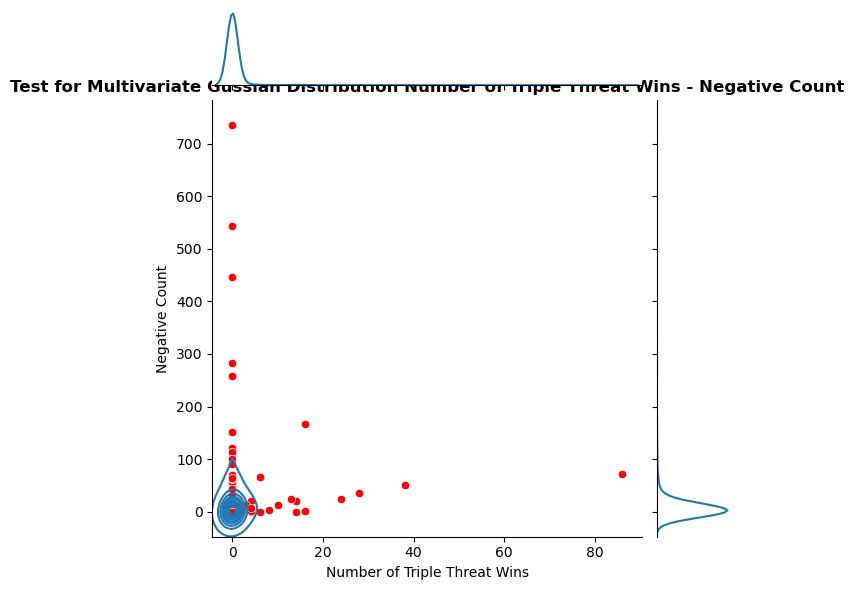

<Figure size 1200x800 with 0 Axes>

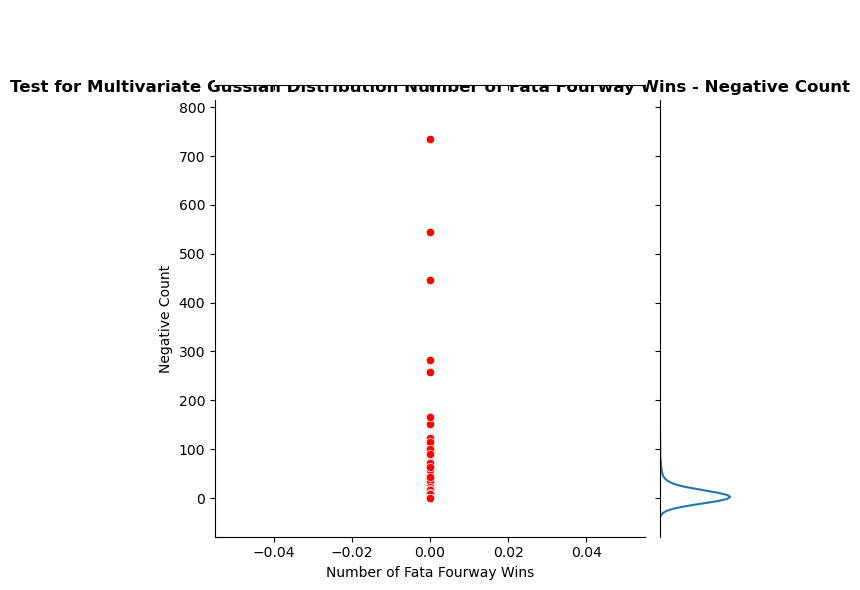

<Figure size 1200x800 with 0 Axes>

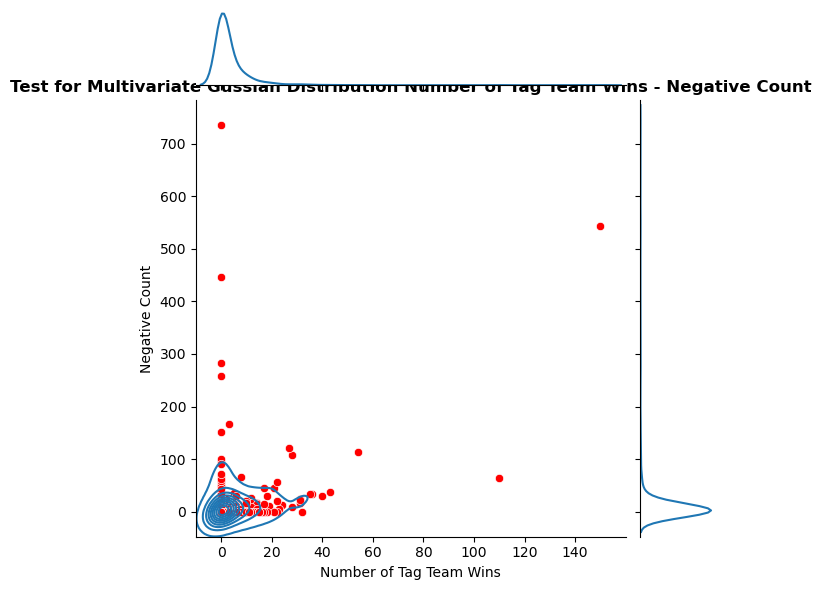

<Figure size 1200x800 with 0 Axes>

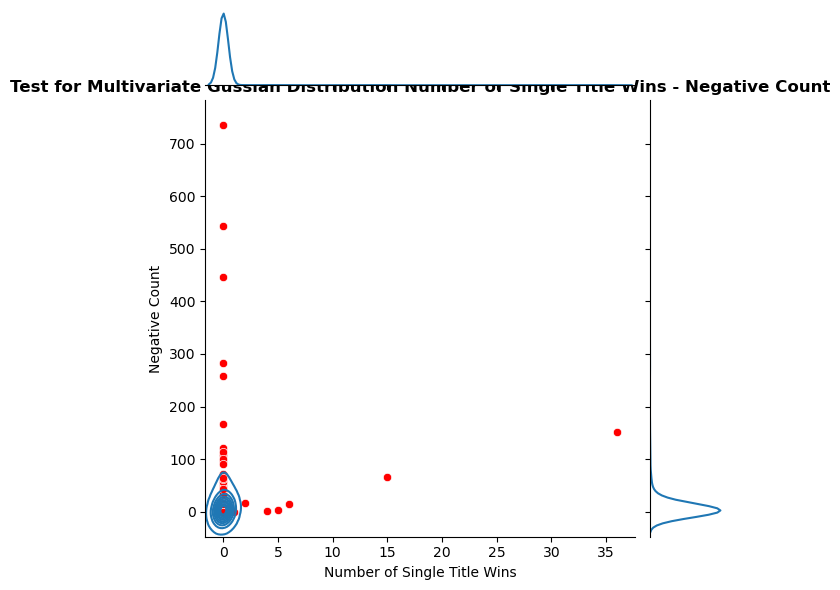

<Figure size 1200x800 with 0 Axes>

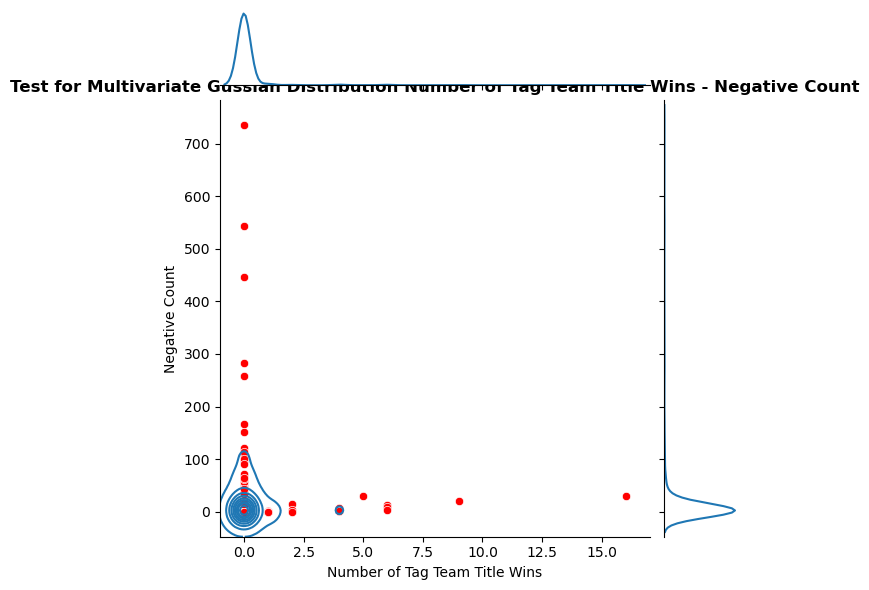

<Figure size 1200x800 with 0 Axes>

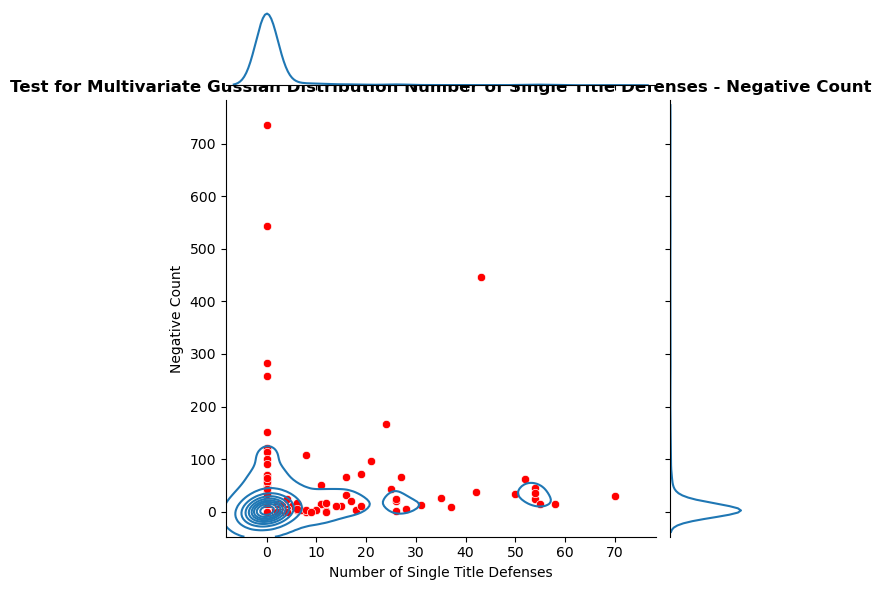

<Figure size 1200x800 with 0 Axes>

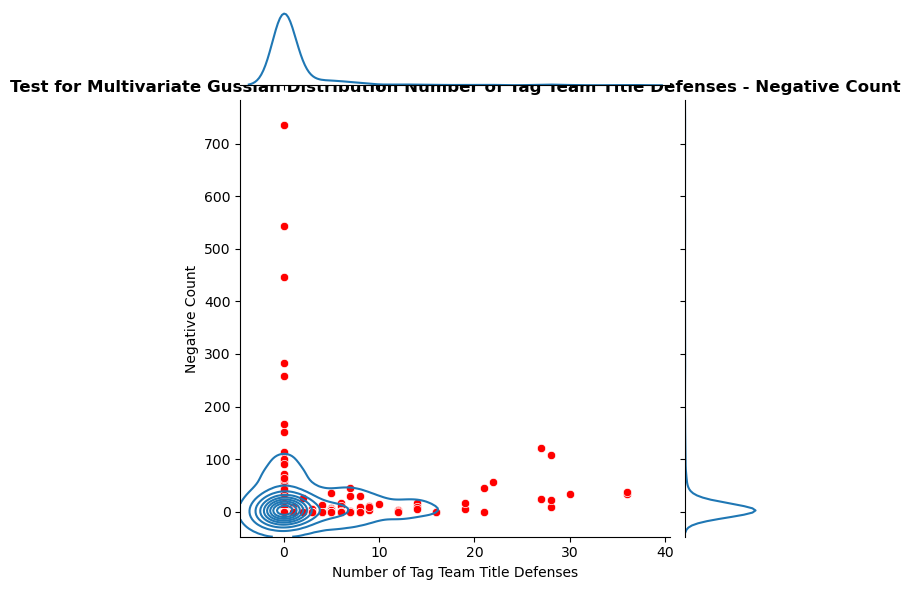

In [150]:
for l in loss[2:-2]:
    plt.figure(figsize=(12,8))
    sns.jointplot(x=l,y='Positive Count',kind='kde',data=df_total_month)
    sns.scatterplot(x=l,y='Positive Count',color='green',
                    data=df_total_month)
    plt.title('Test for Multivariate Gussian Distribution {} - Positive Count'.format(l),size=12,fontweight='bold')
    
for w in win:
    plt.figure(figsize=(12,8))
    sns.jointplot(x=w,y='Negative Count',kind='kde',data=df_total_month)
    sns.scatterplot(x=w,y='Negative Count',color='red',data=df_total_month)
    plt.title('Test for Multivariate Gussian Distribution {} - Negative Count'.format(w),size=12,fontweight='bold')

The intention of using the KDE plot was to see if the data followed a multivariate Gaussian distribution. This is the case when the density plots are around the mean of the data points and take the shape of an oval.

This is not the case for these data. The next section discusses what the results of the exploratory analysis mean for the actual analysis.

In summary, in the next section we will perform an outlier analysis for the combination of positive comments and losses to determine the overall outliers. This decision was made because we do not have enough cases where wrestlers have more negative than positive comments.
We have found that our data does not follow a normal or multivariate distribution and we are dealing with outliers.